<center><h1>1-ab: Introduction to Neural Networks</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
!unzip -j 2-ab.zip
!wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

--2025-11-11 17:08:50--  https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip [following]
--2025-11-11 17:08:50--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/2-ab.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13423991 (13M) [application/zip]
Saving to: ‘2-ab.zip.2’

2-ab.zip.2          100%[===================>]  12.80M  79.8MB/s    in 0.2s    

2025-11-11 17:08:51 (79.8 MB/s) - ‘2-ab.zip.2’ saved [13423991/13423991]

Archive:  2-ab.zip
replace ._2-ab? [y]es, [n]

In [ ]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'

<Figure size 640x480 with 0 Axes>

# Part 1 : Forward and backward passes "by hands"

In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by

    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["bh"] = torch.zeros(nh)
    params["by"] = torch.zeros(ny)

    ####################
    ##      END        #
    ####################
    return params

In [ ]:
x = torch.tensor(np.array([[3,5,-3, -1, 0], [3,2,-1, 0.1, 8], [3,-4,-8, 1, 2]])).float()
y = torch.tensor(np.array([[1,0.4], [3,-8], [2,-1]])).float()
print(x.size())
print(y.size())
params = init_params(5,4,2)
print('Wh size : ', params['Wh'].size())
print('Wy size : ', params['Wy'].size())
print('bh size : ', params['bh'].size())
print('by size : ', params['by'].size())

torch.Size([3, 5])
torch.Size([3, 2])
Wh size :  torch.Size([4, 5])
Wy size :  torch.Size([2, 4])
bh size :  torch.Size([4])
by size :  torch.Size([2])


In [ ]:
from scipy.special import softmax

a = np.ones(3)
a[1] = 5
a[2] = 7
print(5*a)
b = np.tile(a, (14,1))
print(b)
c = np.sum(b, axis = 1)
print(c)
d = np.mean(c)
print(d)
print(c.shape)
print(b)
print(softmax(b, axis = 1))


[ 5. 25. 35.]
[[1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]]
[13. 13. 13. 13. 13. 13. 13. 13. 13. 13. 13. 13. 13. 13.]
13.0
(14,)
[[1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]
 [1. 5. 7.]]
[[0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]
 [0.00217852 0.11894324 0.87887824]]


In [ ]:
from scipy.special import softmax

def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for X, htilde, h, ytilde, yhat

    outputs["X"] = X
    outputs["htilde"] = X.mm(params["Wh"].t()) + params["bh"]
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = outputs["h"].mm(params["Wy"].t()) + params["by"]
    outputs["yhat"] = torch.softmax(outputs["ytilde"], dim=1)

    ####################
    ##      END        #
    ####################

    return outputs['yhat'], outputs

In [ ]:
_, outputs = forward(params, x)
for cle in outputs.keys():
  print(f'{cle} size : {outputs[cle].size()}')
  print(outputs[cle])

X size : torch.Size([3, 5])
tensor([[ 3.0000,  5.0000, -3.0000, -1.0000,  0.0000],
        [ 3.0000,  2.0000, -1.0000,  0.1000,  8.0000],
        [ 3.0000, -4.0000, -8.0000,  1.0000,  2.0000]])
htilde size : torch.Size([3, 4])
tensor([[-2.8366, -0.9628,  2.3387,  0.6843],
        [-3.3736, -3.9824, -0.6192,  1.9011],
        [-6.1770, -6.3153, -1.5149,  2.9273]])
h size : torch.Size([3, 4])
tensor([[-0.9931, -0.7455,  0.9816,  0.5943],
        [-0.9977, -0.9993, -0.5506,  0.9563],
        [-1.0000, -1.0000, -0.9078,  0.9943]])
ytilde size : torch.Size([3, 2])
tensor([[-0.0508,  0.0058],
        [-0.2165,  0.5137],
        [-0.2196,  0.6100]])
yhat size : torch.Size([3, 2])
tensor([[0.4858, 0.5142],
        [0.3252, 0.6748],
        [0.3037, 0.6963]])


In [ ]:
def loss_accuracy(Yhat, Y):

    #####################
    ## Your code here  ##
    #####################

    eps = 1e-9  #in case of zero value
    L = -torch.mean(torch.sum(Y * torch.log(Yhat + eps), dim=1))
    Yhatpred = torch.argmax(Yhat, dim=1)
    Ytrue = torch.argmax(Y, dim=1)
    acc = torch.mean((Yhatpred == Ytrue).float())

    ####################
    ##      END        #
    ####################

    return L, acc

In [ ]:
print(loss_accuracy(outputs['yhat'], y))

(tensor(1.0777), tensor(0.))


In [ ]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wy, Wh, by, bh

    Yhat = outputs["yhat"]
    X = outputs["X"]
    h = outputs["h"]

    dytilde = (Yhat - Y) / bsize
    grads["Wy"] = dytilde.t().mm(h)
    grads["by"] = torch.sum(dytilde, dim=0)
    dh = dytilde.mm(params["Wy"])
    dhtilde = dh * (1 - h ** 2)
    grads["Wh"] = dhtilde.t().mm(X)
    grads["bh"] = torch.sum(dhtilde, dim=0)

    ####################
    ##      END        #
    ####################
    return grads

In [ ]:
grads = backward(params, outputs, y)
for cle in grads.keys():
  print(f'{cle} size : {grads[cle].size()}')
  print(grads[cle])


Wy size : torch.Size([2, 4])
tensor([[ 1.6251,  1.5842,  0.8360, -1.5167],
        [-3.4880, -3.4834, -2.0680,  3.3502]])
by size : torch.Size([2])
tensor([-1.6284,  3.4951])
Wh size : torch.Size([4, 5])
tensor([[ 1.0194e-02,  1.0052e-02, -5.6212e-03, -8.6020e-04,  1.8397e-02],
        [-2.3188e-02, -3.5409e-02,  2.1053e-02,  6.5450e-03, -8.5862e-03],
        [-1.4681e+00, -8.6569e-01,  6.2096e-01, -6.5923e-02, -3.8024e+00],
        [ 5.3954e-01,  5.7467e-01, -3.8442e-01, -6.8078e-02,  7.4300e-01]])
bh size : torch.Size([4])
tensor([ 0.0034, -0.0077, -0.4894,  0.1798])


In [ ]:
def sgd(params, grads, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the params values

    params["Wh"] -= eta * grads["Wh"]
    params["Wy"] -= eta * grads["Wy"]
    params["bh"] -= eta * grads["bh"]
    params["by"] -= eta * grads["by"]

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure "by hands"

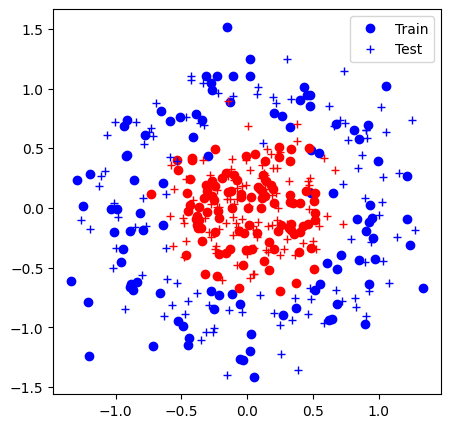

Iter 0: Acc train 0.6% (0.70), acc test 0.5% (0.70)


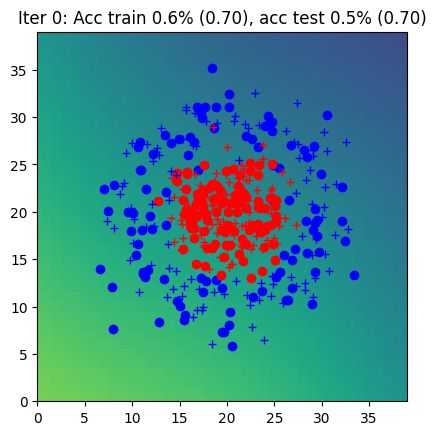

Iter 1: Acc train 0.5% (0.69), acc test 0.5% (0.69)


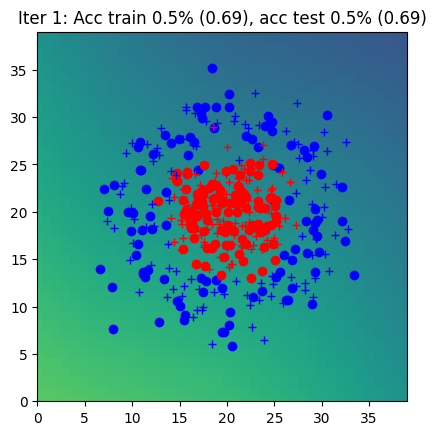

Iter 2: Acc train 0.6% (0.69), acc test 0.5% (0.69)


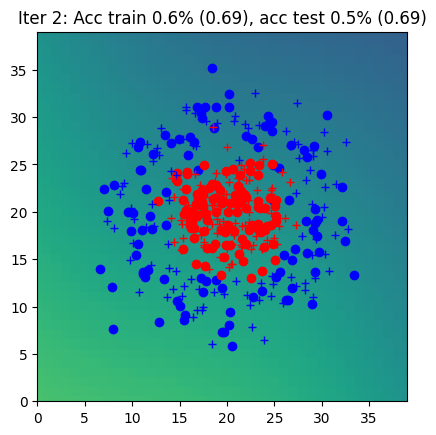

Iter 3: Acc train 0.5% (0.69), acc test 0.5% (0.69)


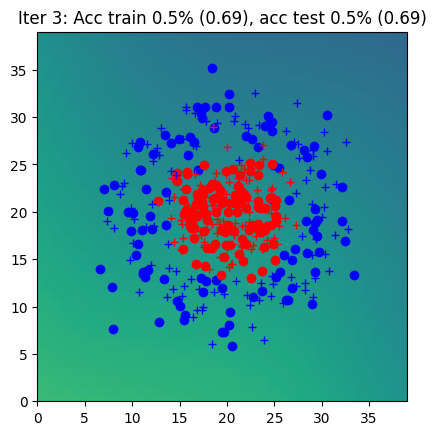

Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)


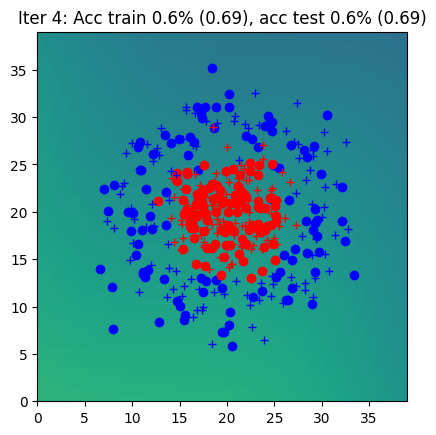

Iter 5: Acc train 0.5% (0.69), acc test 0.5% (0.69)


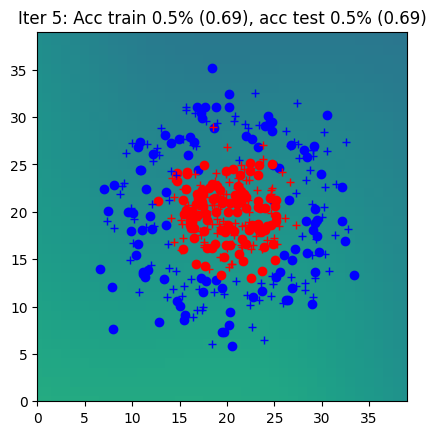

Iter 6: Acc train 0.6% (0.69), acc test 0.6% (0.69)


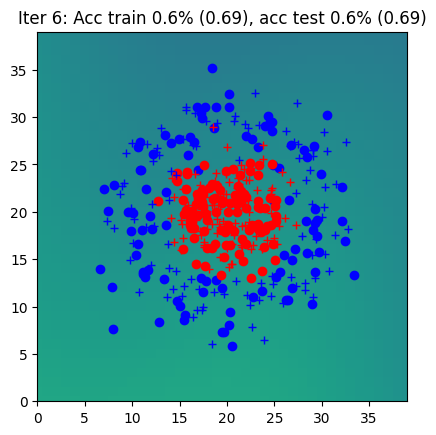

Iter 7: Acc train 0.5% (0.69), acc test 0.5% (0.69)


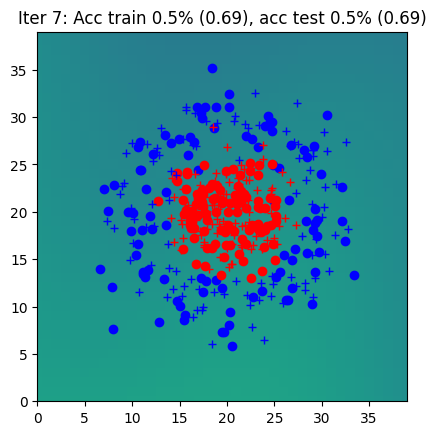

Iter 8: Acc train 0.6% (0.69), acc test 0.6% (0.69)


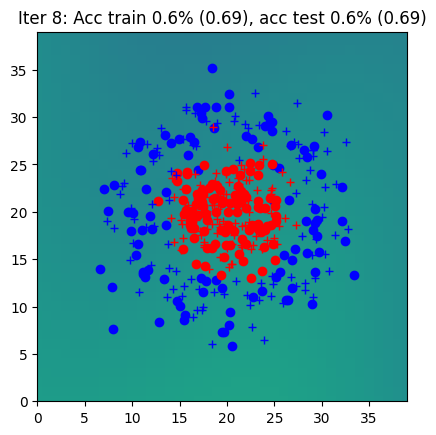

Iter 9: Acc train 0.6% (0.69), acc test 0.6% (0.69)


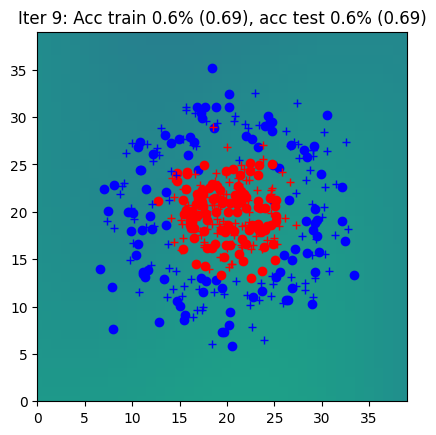

Iter 10: Acc train 0.6% (0.69), acc test 0.6% (0.69)


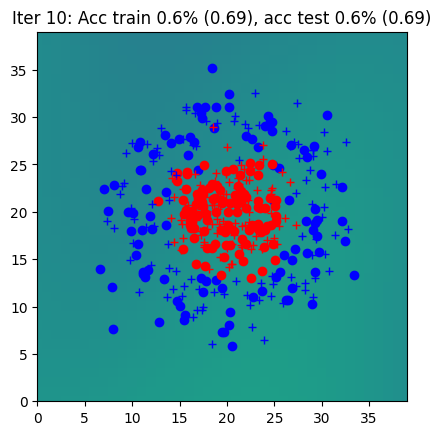

Iter 11: Acc train 0.6% (0.69), acc test 0.6% (0.69)


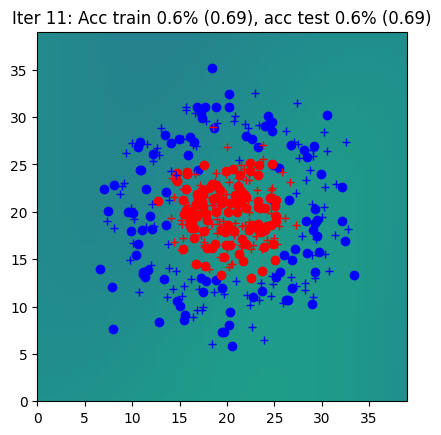

Iter 12: Acc train 0.6% (0.69), acc test 0.6% (0.69)


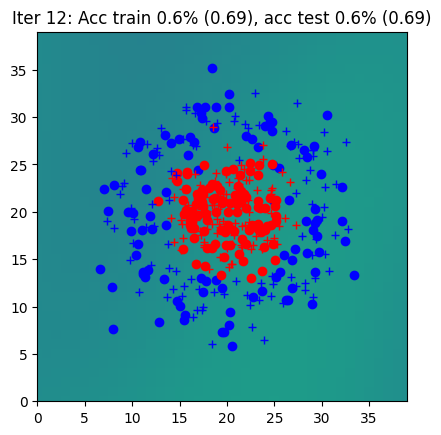

Iter 13: Acc train 0.6% (0.69), acc test 0.6% (0.69)


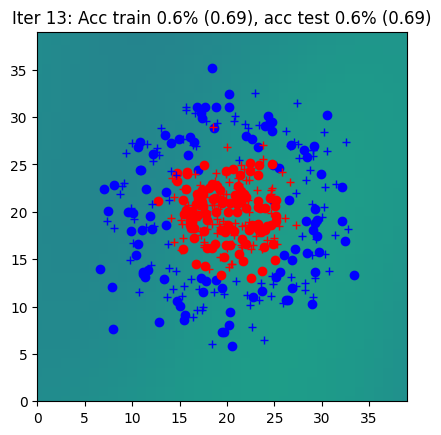

Iter 14: Acc train 0.6% (0.69), acc test 0.6% (0.69)


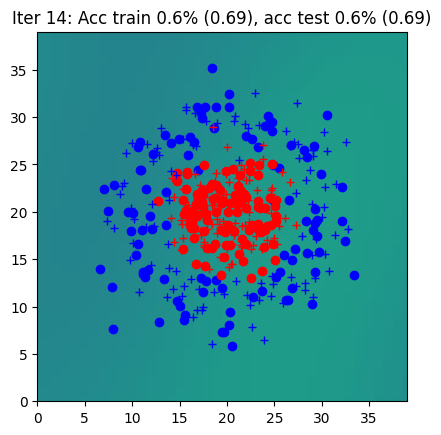

Iter 15: Acc train 0.6% (0.69), acc test 0.6% (0.69)


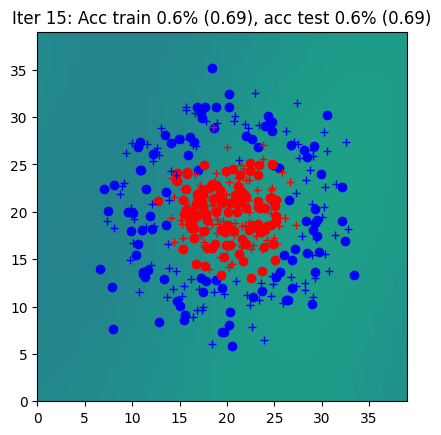

Iter 16: Acc train 0.6% (0.69), acc test 0.6% (0.69)


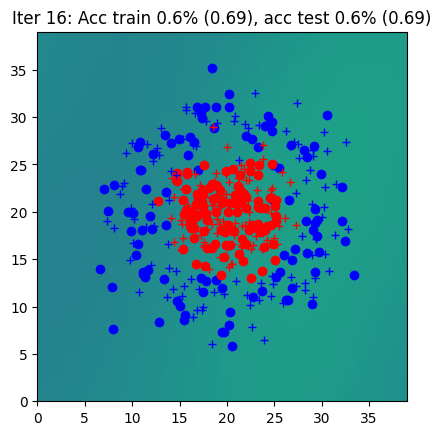

Iter 17: Acc train 0.6% (0.69), acc test 0.6% (0.69)


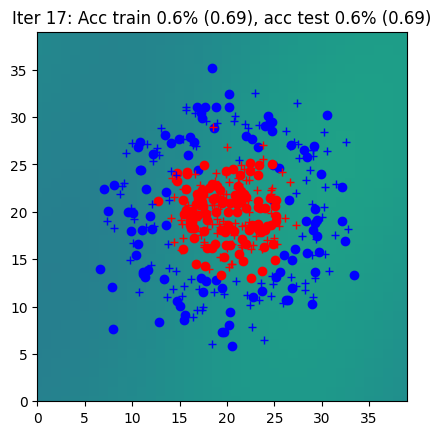

Iter 18: Acc train 0.6% (0.69), acc test 0.6% (0.69)


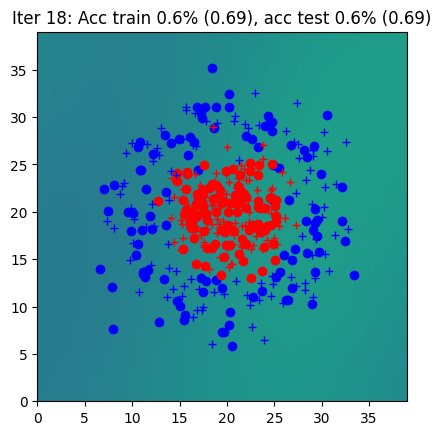

Iter 19: Acc train 0.6% (0.69), acc test 0.6% (0.69)


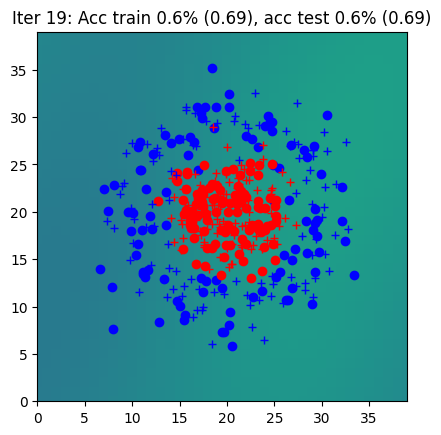

Iter 20: Acc train 0.6% (0.69), acc test 0.6% (0.69)


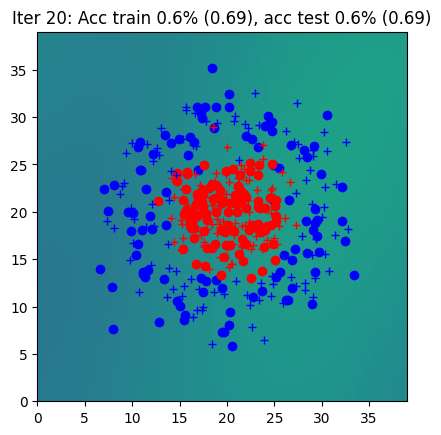

Iter 21: Acc train 0.6% (0.69), acc test 0.6% (0.69)


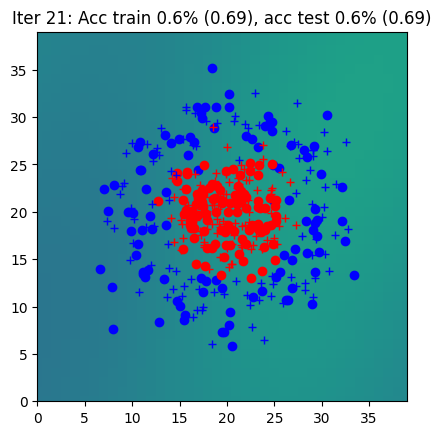

Iter 22: Acc train 0.6% (0.69), acc test 0.6% (0.69)


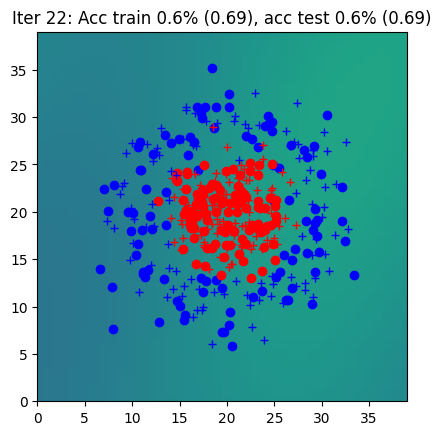

Iter 23: Acc train 0.6% (0.69), acc test 0.6% (0.69)


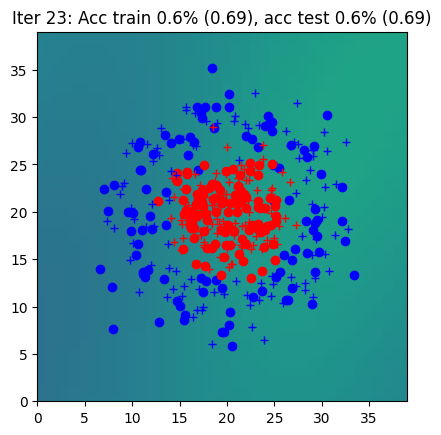

Iter 24: Acc train 0.6% (0.69), acc test 0.6% (0.69)


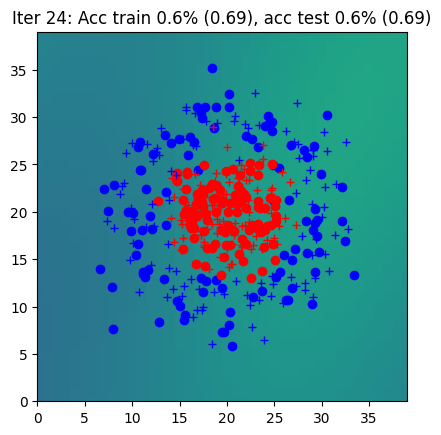

Iter 25: Acc train 0.6% (0.69), acc test 0.6% (0.69)


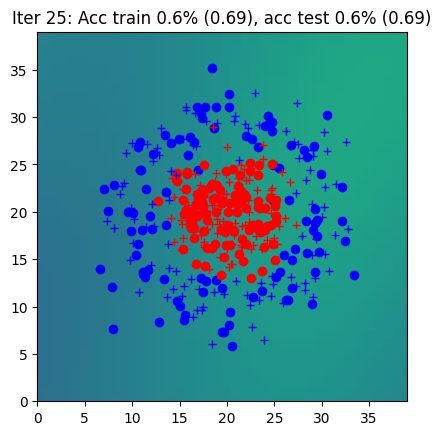

Iter 26: Acc train 0.6% (0.69), acc test 0.6% (0.69)


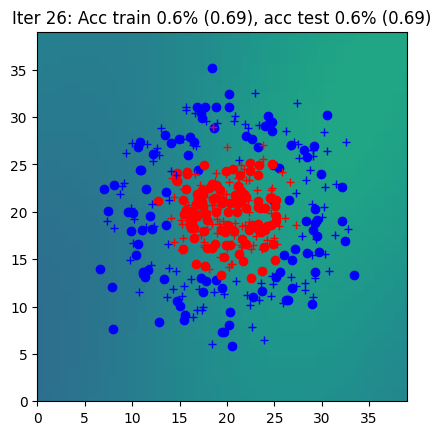

Iter 27: Acc train 0.6% (0.69), acc test 0.6% (0.69)


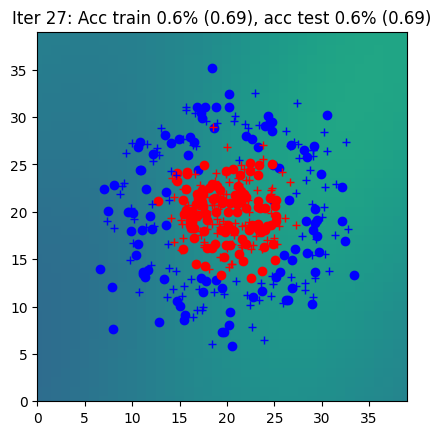

Iter 28: Acc train 0.6% (0.69), acc test 0.6% (0.69)


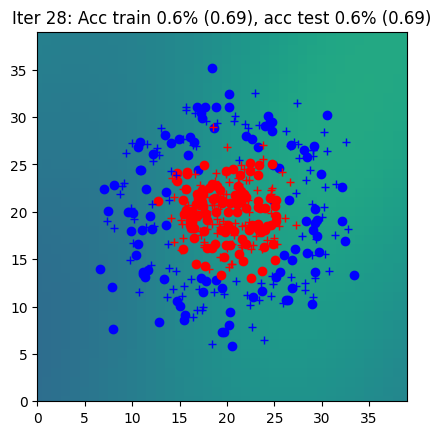

Iter 29: Acc train 0.6% (0.69), acc test 0.7% (0.69)


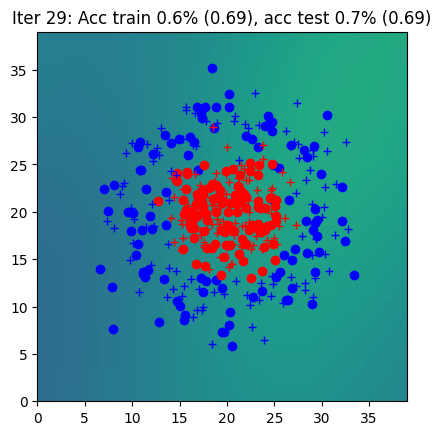

Iter 30: Acc train 0.6% (0.69), acc test 0.6% (0.69)


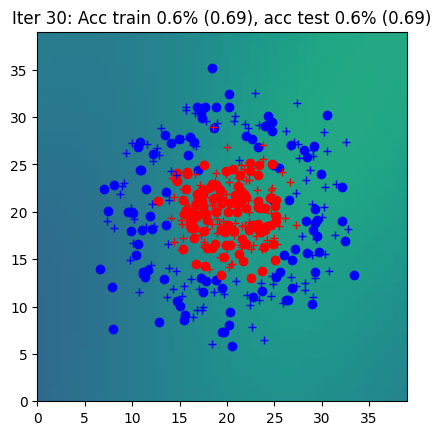

Iter 31: Acc train 0.6% (0.69), acc test 0.6% (0.69)


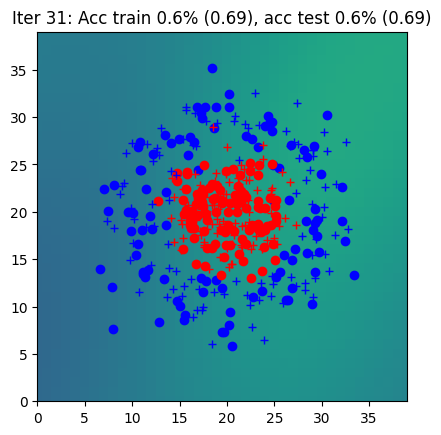

Iter 32: Acc train 0.6% (0.69), acc test 0.6% (0.69)


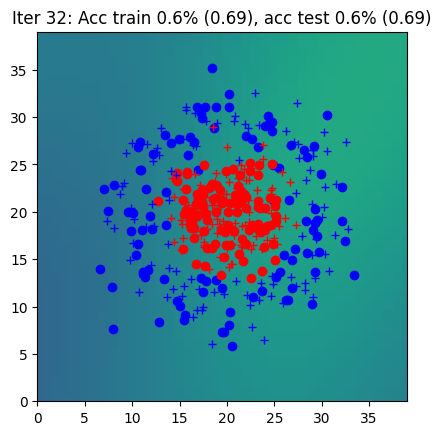

Iter 33: Acc train 0.6% (0.69), acc test 0.6% (0.69)


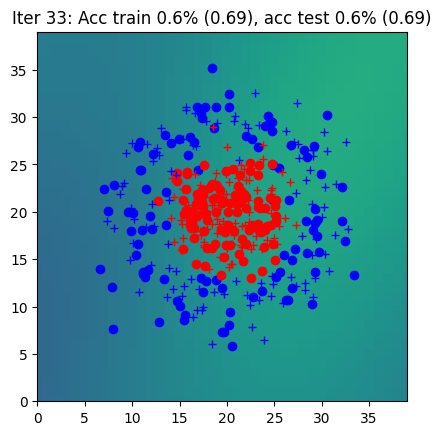

Iter 34: Acc train 0.6% (0.68), acc test 0.6% (0.69)


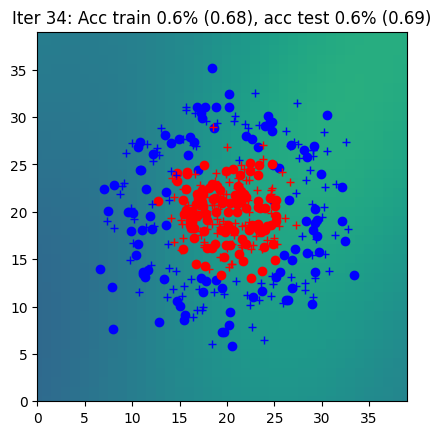

Iter 35: Acc train 0.6% (0.68), acc test 0.6% (0.69)


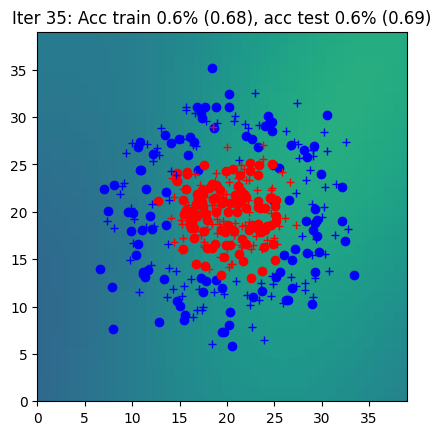

Iter 36: Acc train 0.6% (0.68), acc test 0.6% (0.69)


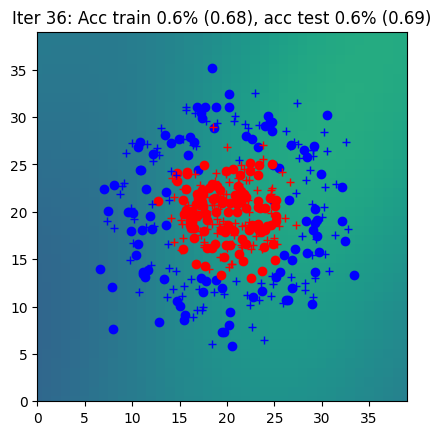

Iter 37: Acc train 0.6% (0.68), acc test 0.6% (0.69)


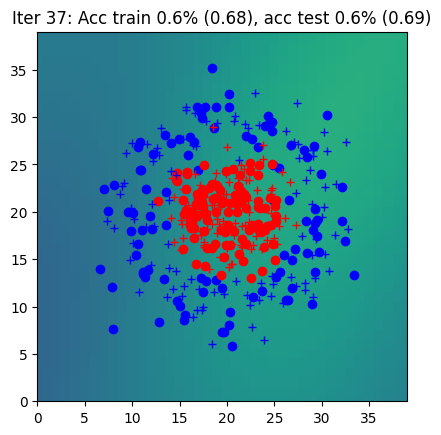

Iter 38: Acc train 0.6% (0.68), acc test 0.6% (0.68)


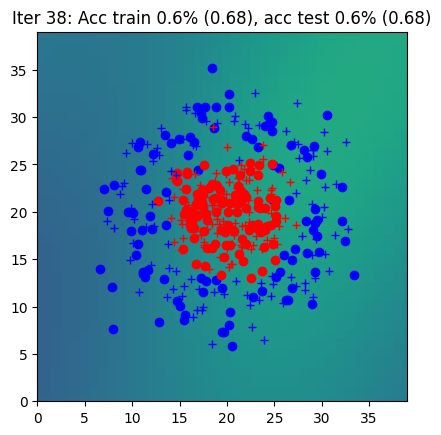

Iter 39: Acc train 0.6% (0.68), acc test 0.6% (0.68)


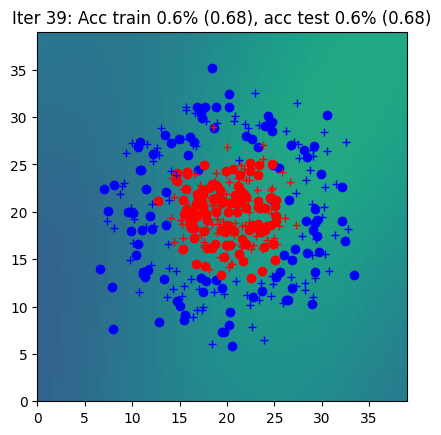

Iter 40: Acc train 0.6% (0.68), acc test 0.7% (0.68)


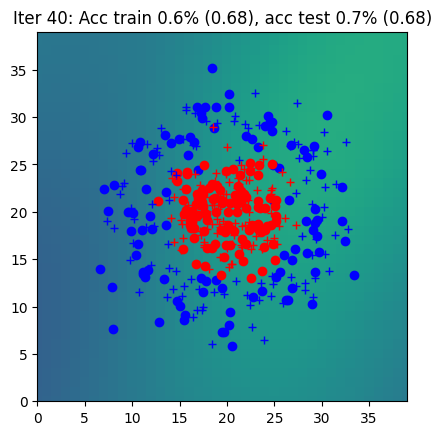

Iter 41: Acc train 0.6% (0.68), acc test 0.6% (0.68)


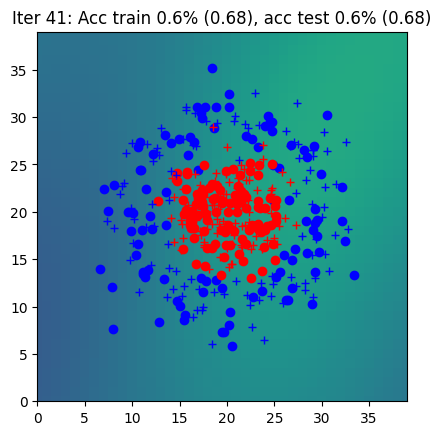

Iter 42: Acc train 0.6% (0.68), acc test 0.7% (0.68)


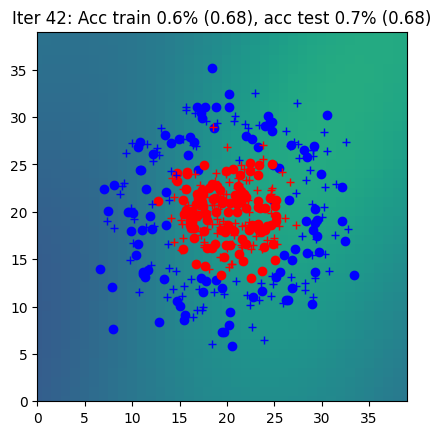

Iter 43: Acc train 0.6% (0.68), acc test 0.6% (0.68)


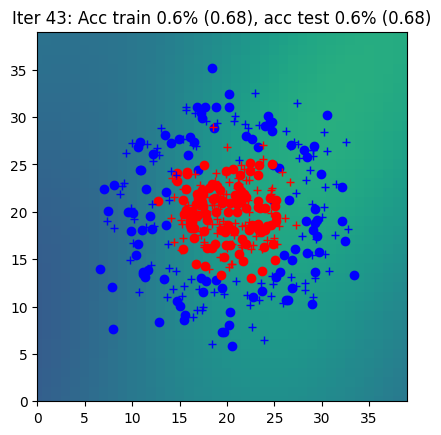

Iter 44: Acc train 0.6% (0.68), acc test 0.6% (0.68)


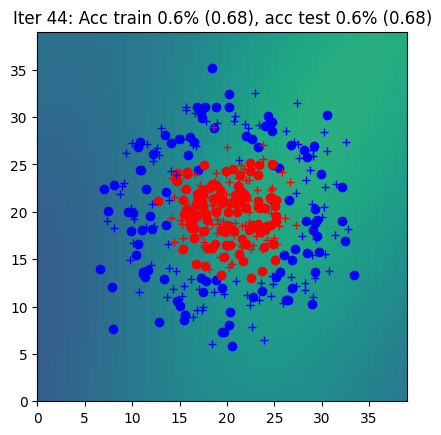

Iter 45: Acc train 0.6% (0.68), acc test 0.6% (0.68)


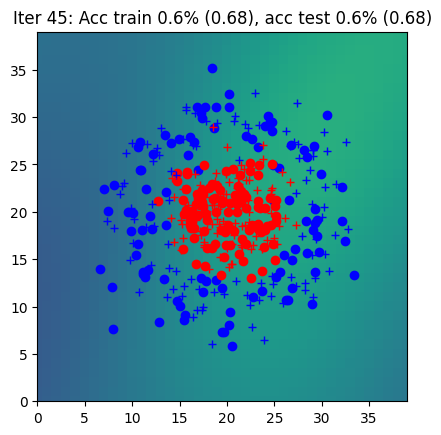

Iter 46: Acc train 0.6% (0.68), acc test 0.6% (0.68)


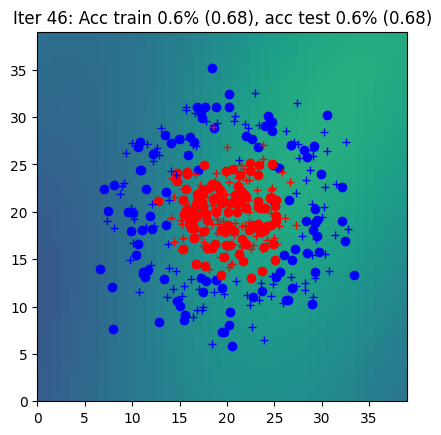

Iter 47: Acc train 0.6% (0.68), acc test 0.6% (0.68)


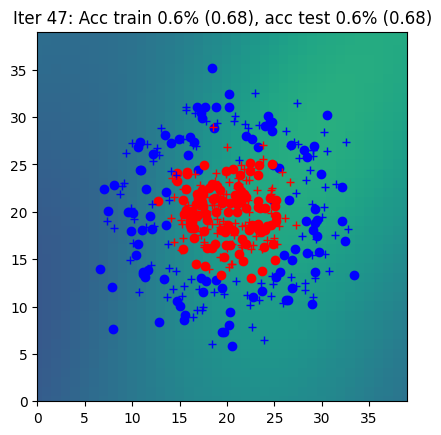

Iter 48: Acc train 0.6% (0.68), acc test 0.6% (0.68)


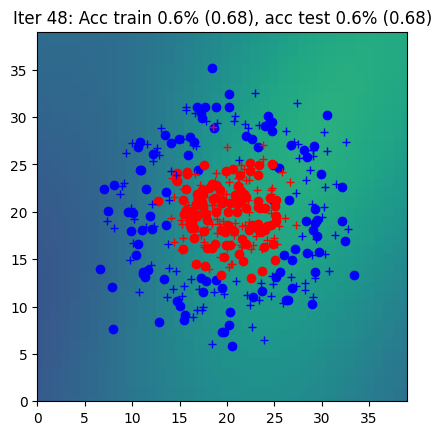

Iter 49: Acc train 0.6% (0.68), acc test 0.7% (0.68)


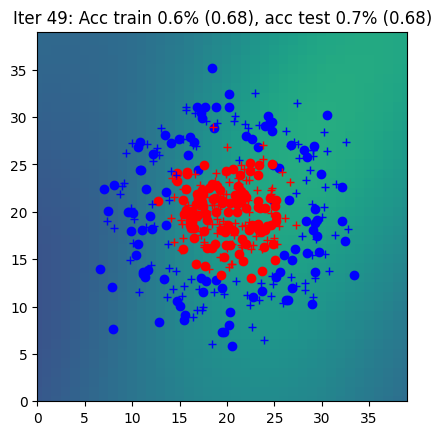

Iter 50: Acc train 0.6% (0.68), acc test 0.6% (0.68)


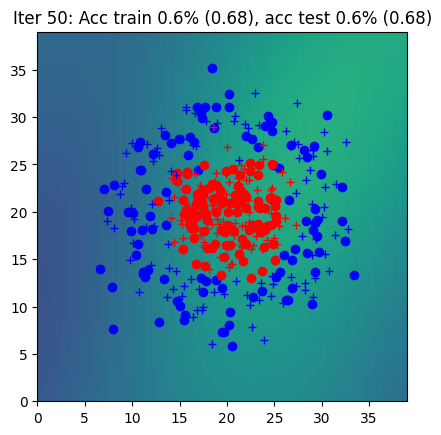

Iter 51: Acc train 0.6% (0.68), acc test 0.6% (0.68)


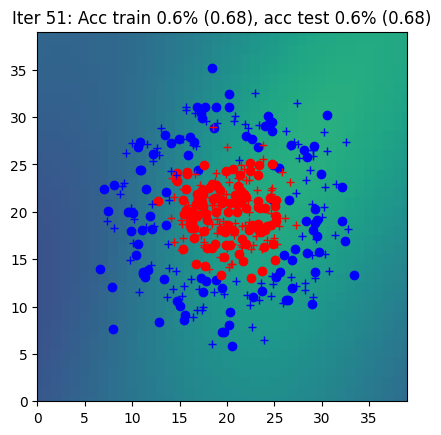

Iter 52: Acc train 0.7% (0.67), acc test 0.6% (0.68)


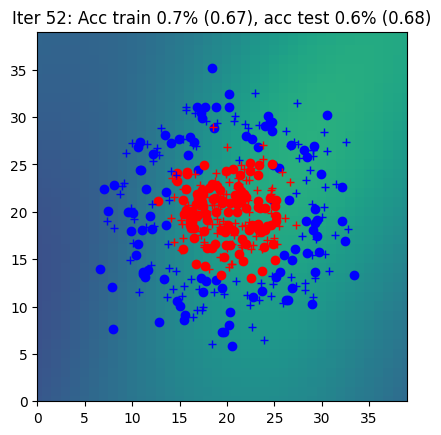

Iter 53: Acc train 0.7% (0.67), acc test 0.6% (0.68)


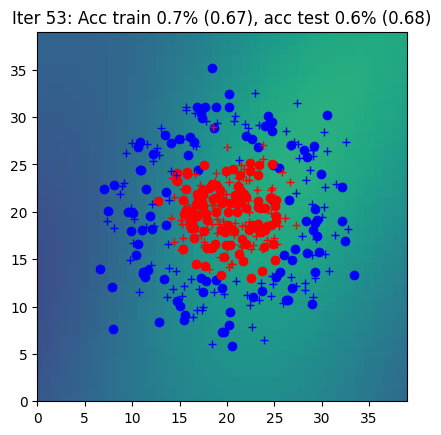

Iter 54: Acc train 0.7% (0.67), acc test 0.6% (0.67)


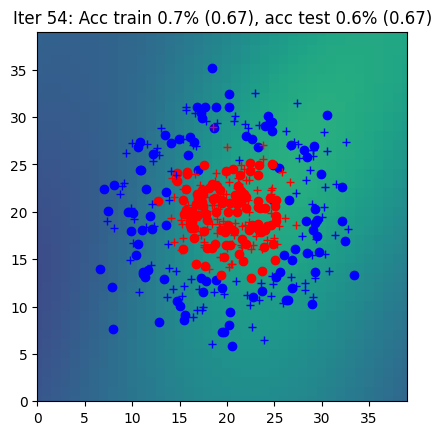

Iter 55: Acc train 0.7% (0.67), acc test 0.6% (0.67)


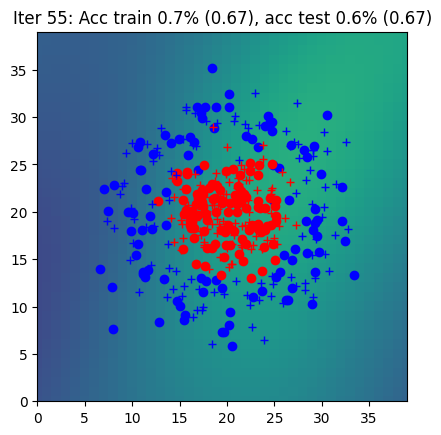

Iter 56: Acc train 0.6% (0.67), acc test 0.6% (0.67)


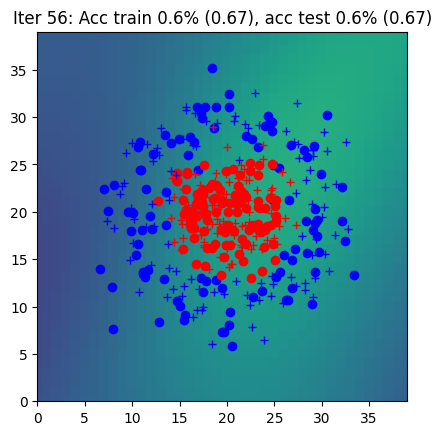

Iter 57: Acc train 0.6% (0.67), acc test 0.6% (0.67)


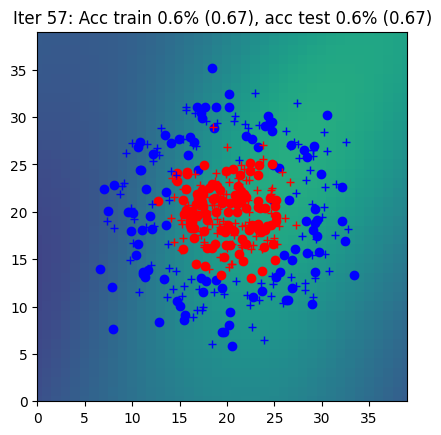

Iter 58: Acc train 0.6% (0.67), acc test 0.7% (0.67)


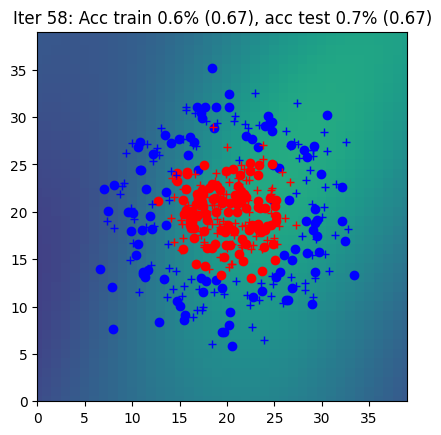

Iter 59: Acc train 0.6% (0.67), acc test 0.6% (0.67)


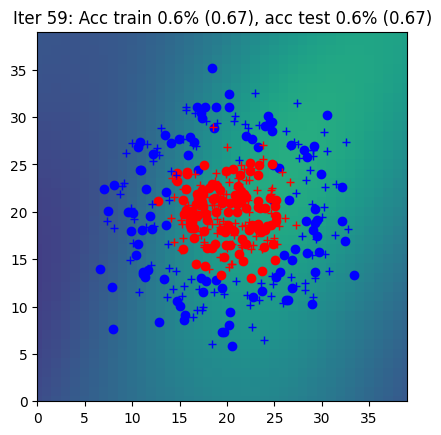

Iter 60: Acc train 0.6% (0.67), acc test 0.7% (0.67)


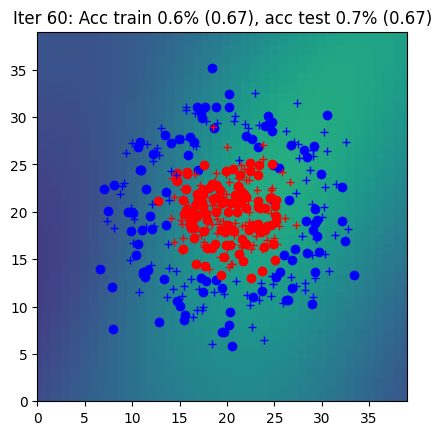

Iter 61: Acc train 0.7% (0.67), acc test 0.6% (0.67)


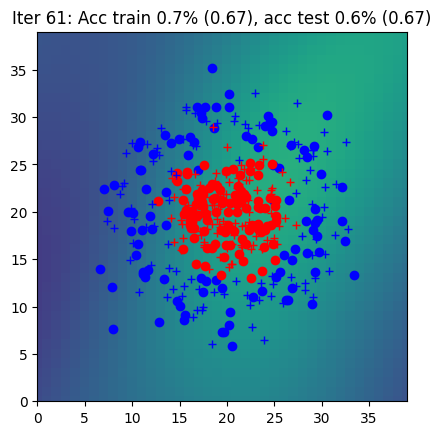

Iter 62: Acc train 0.7% (0.67), acc test 0.7% (0.67)


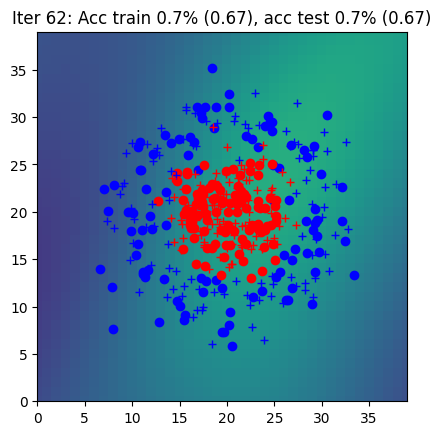

Iter 63: Acc train 0.7% (0.66), acc test 0.7% (0.67)


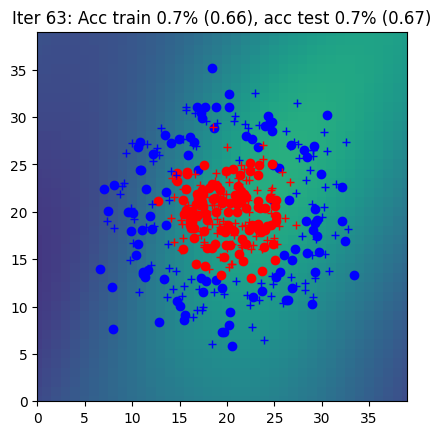

Iter 64: Acc train 0.7% (0.66), acc test 0.6% (0.66)


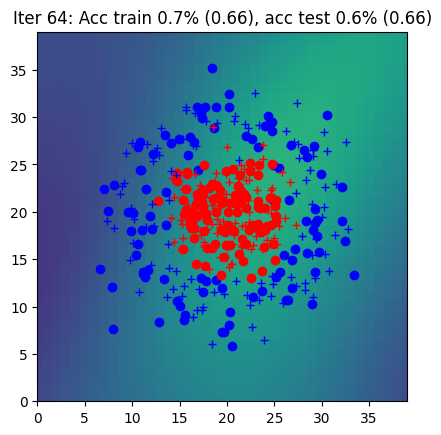

Iter 65: Acc train 0.7% (0.66), acc test 0.6% (0.66)


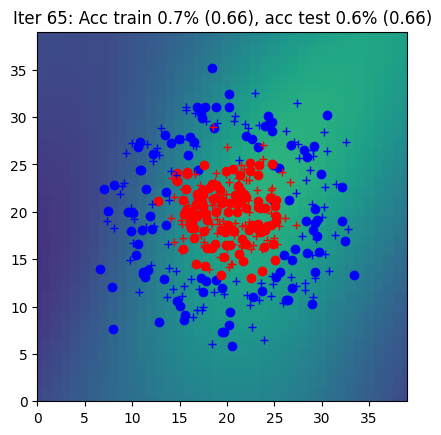

Iter 66: Acc train 0.7% (0.66), acc test 0.6% (0.66)


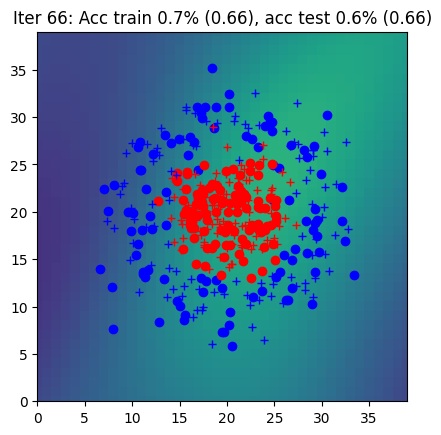

Iter 67: Acc train 0.7% (0.66), acc test 0.6% (0.66)


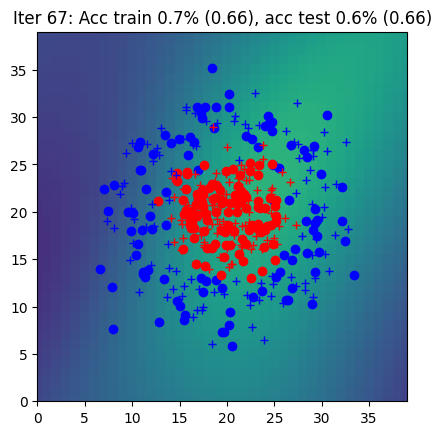

Iter 68: Acc train 0.7% (0.66), acc test 0.7% (0.66)


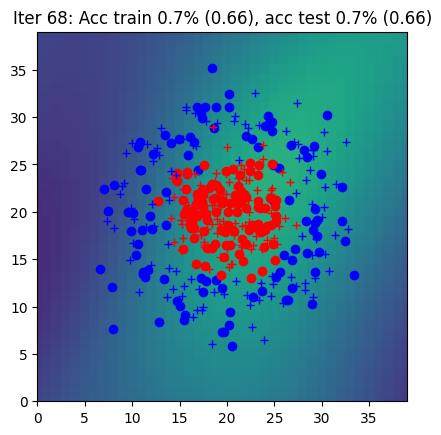

Iter 69: Acc train 0.7% (0.66), acc test 0.7% (0.66)


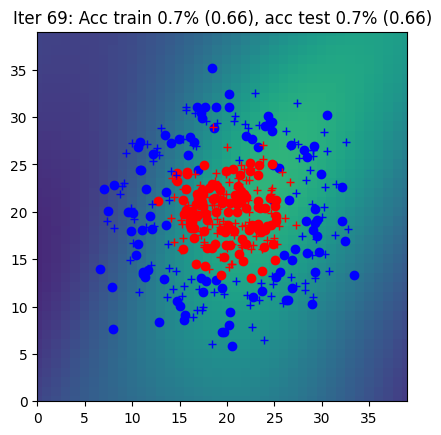

Iter 70: Acc train 0.7% (0.65), acc test 0.7% (0.66)


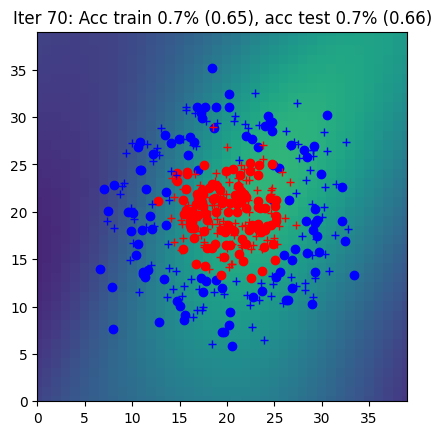

Iter 71: Acc train 0.7% (0.65), acc test 0.7% (0.65)


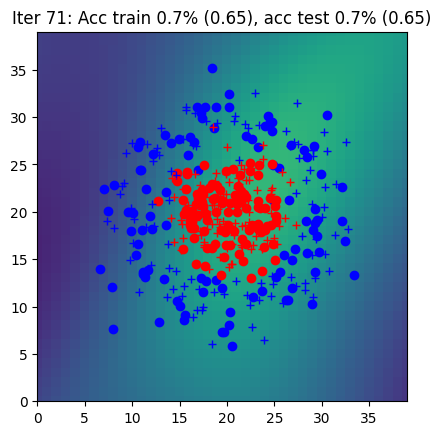

Iter 72: Acc train 0.7% (0.65), acc test 0.7% (0.65)


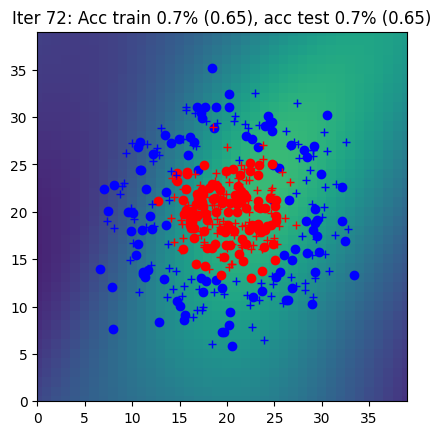

Iter 73: Acc train 0.7% (0.65), acc test 0.7% (0.65)


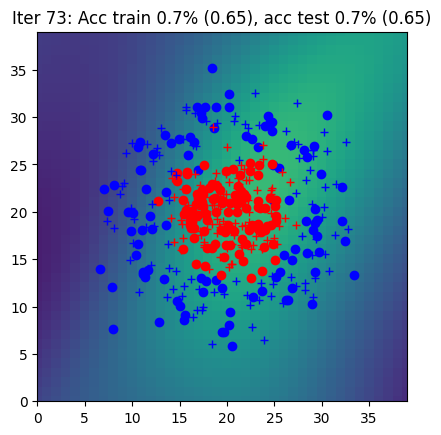

Iter 74: Acc train 0.7% (0.65), acc test 0.7% (0.65)


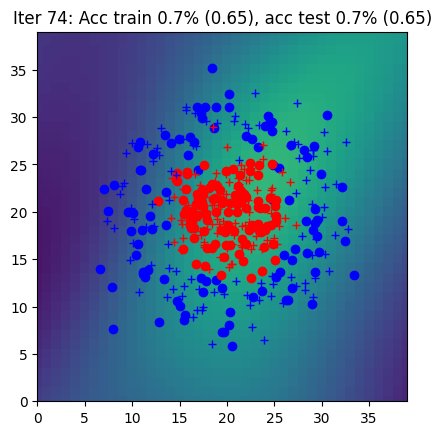

Iter 75: Acc train 0.7% (0.64), acc test 0.7% (0.65)


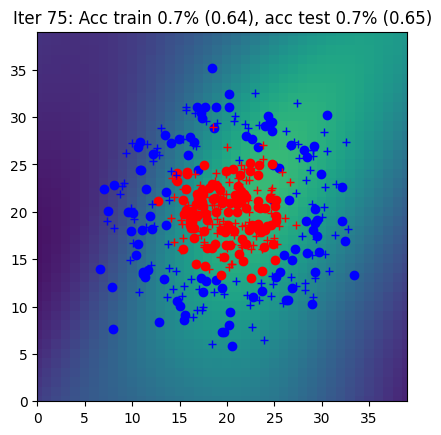

Iter 76: Acc train 0.7% (0.64), acc test 0.7% (0.64)


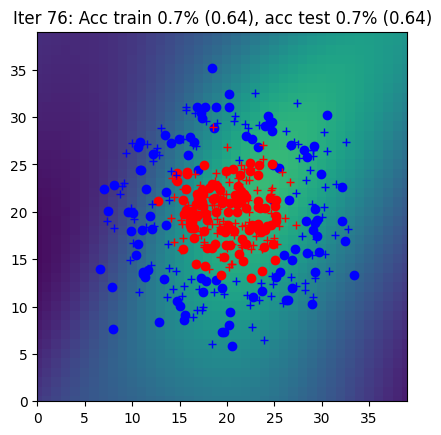

Iter 77: Acc train 0.8% (0.64), acc test 0.7% (0.64)


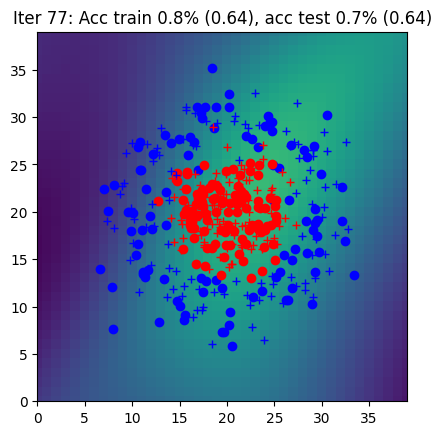

Iter 78: Acc train 0.7% (0.64), acc test 0.7% (0.64)


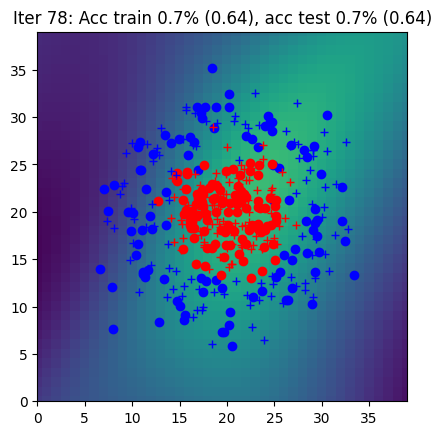

Iter 79: Acc train 0.8% (0.64), acc test 0.7% (0.64)


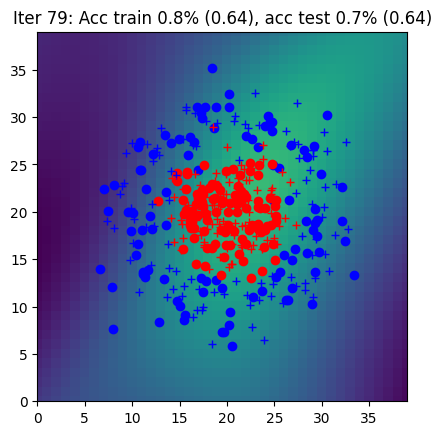

Iter 80: Acc train 0.7% (0.63), acc test 0.7% (0.63)


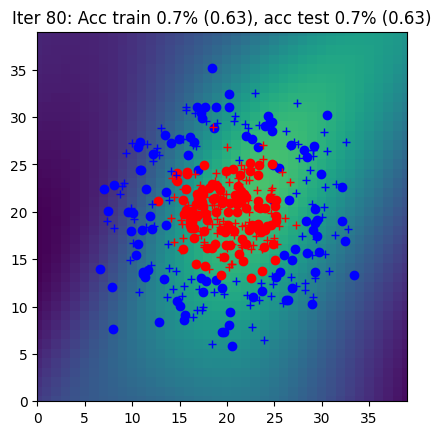

Iter 81: Acc train 0.8% (0.63), acc test 0.7% (0.63)


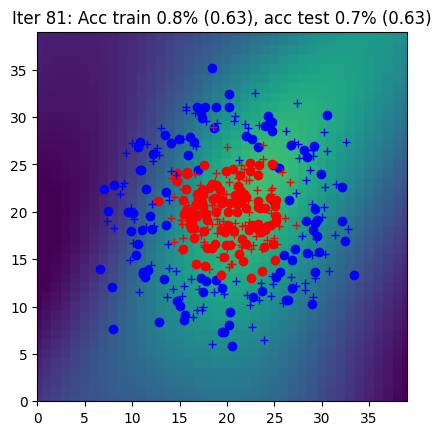

Iter 82: Acc train 0.7% (0.63), acc test 0.7% (0.63)


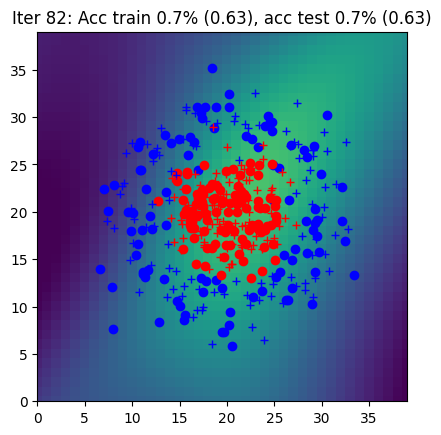

Iter 83: Acc train 0.8% (0.63), acc test 0.7% (0.63)


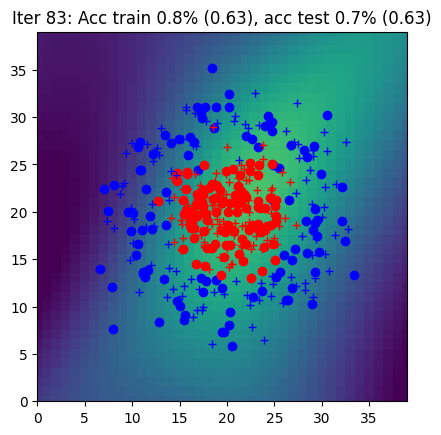

Iter 84: Acc train 0.8% (0.62), acc test 0.7% (0.62)


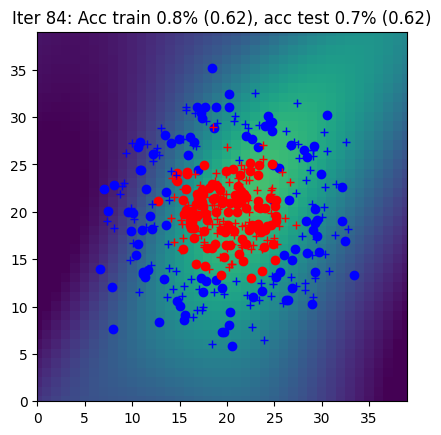

Iter 85: Acc train 0.8% (0.62), acc test 0.7% (0.62)


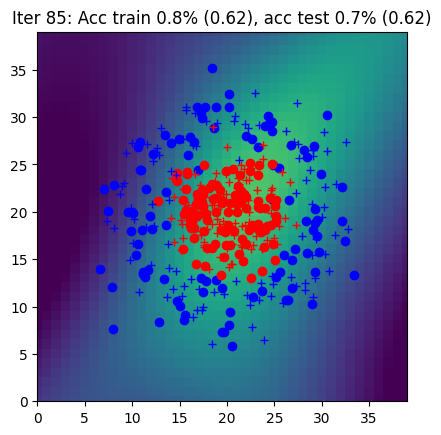

Iter 86: Acc train 0.8% (0.62), acc test 0.7% (0.62)


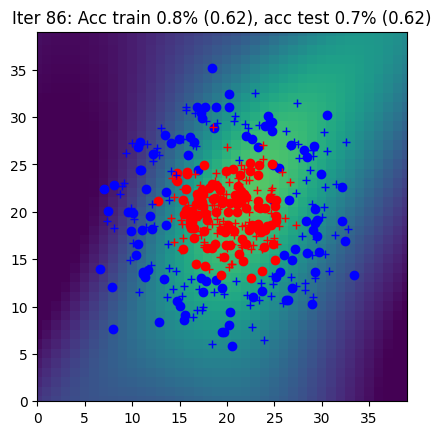

Iter 87: Acc train 0.8% (0.61), acc test 0.7% (0.61)


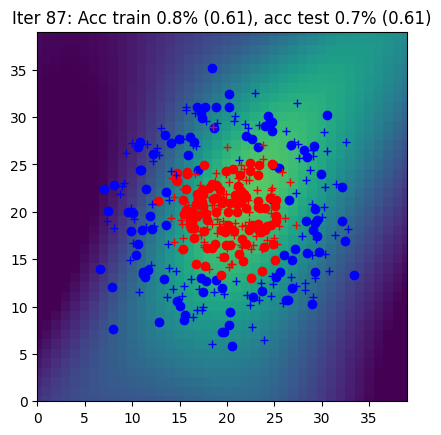

Iter 88: Acc train 0.8% (0.61), acc test 0.8% (0.61)


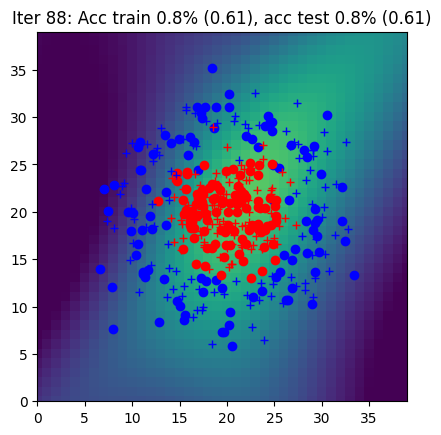

Iter 89: Acc train 0.8% (0.61), acc test 0.8% (0.61)


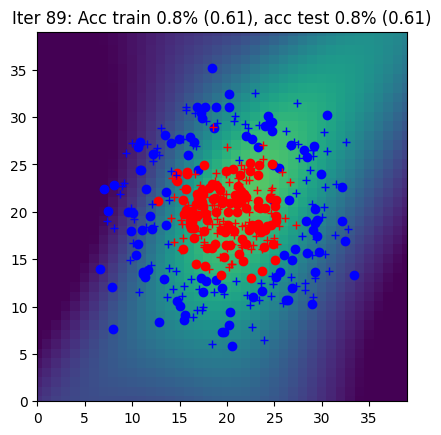

Iter 90: Acc train 0.8% (0.61), acc test 0.7% (0.60)


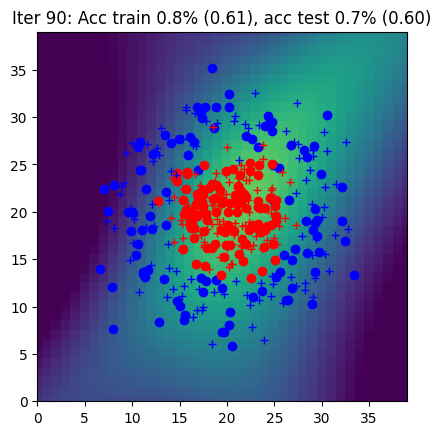

Iter 91: Acc train 0.8% (0.60), acc test 0.8% (0.60)


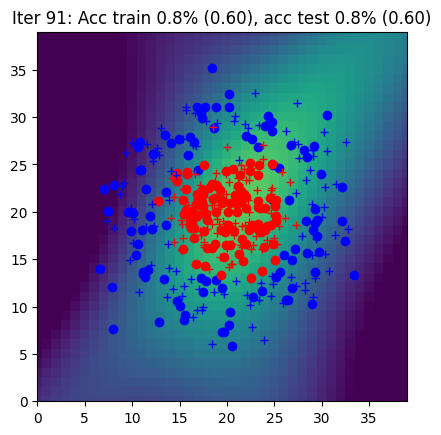

Iter 92: Acc train 0.8% (0.60), acc test 0.8% (0.60)


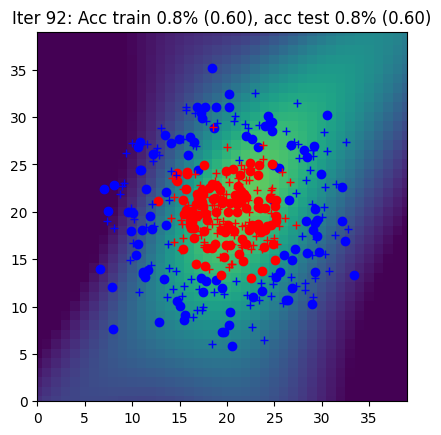

Iter 93: Acc train 0.8% (0.59), acc test 0.8% (0.59)


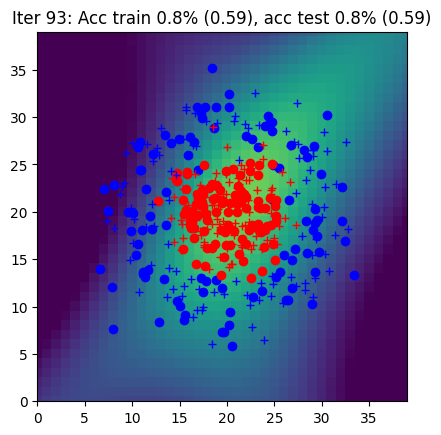

Iter 94: Acc train 0.8% (0.59), acc test 0.8% (0.59)


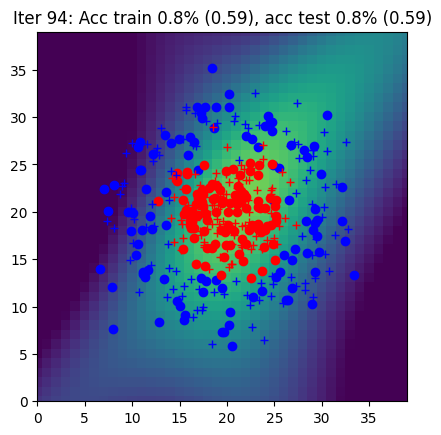

Iter 95: Acc train 0.8% (0.59), acc test 0.8% (0.59)


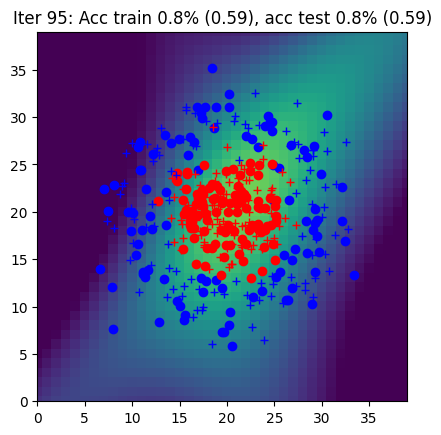

Iter 96: Acc train 0.8% (0.58), acc test 0.8% (0.58)


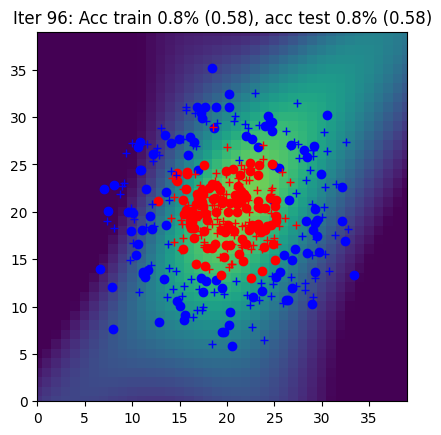

Iter 97: Acc train 0.8% (0.58), acc test 0.8% (0.58)


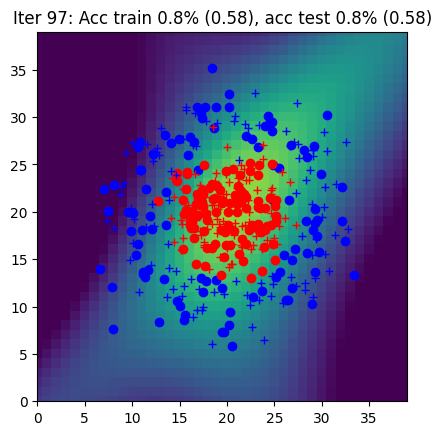

Iter 98: Acc train 0.8% (0.58), acc test 0.8% (0.57)


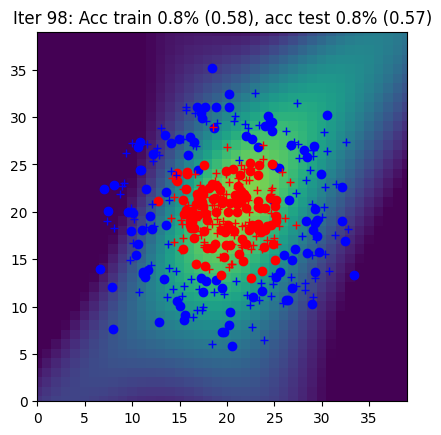

Iter 99: Acc train 0.8% (0.57), acc test 0.8% (0.57)


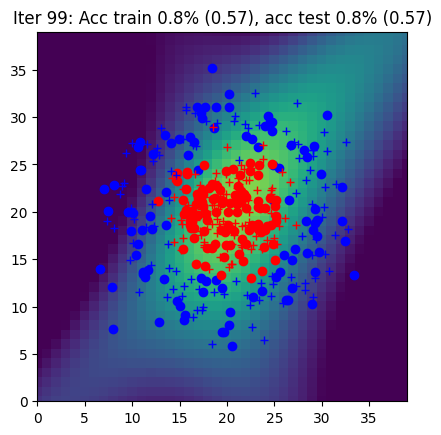

Iter 100: Acc train 0.8% (0.57), acc test 0.8% (0.57)


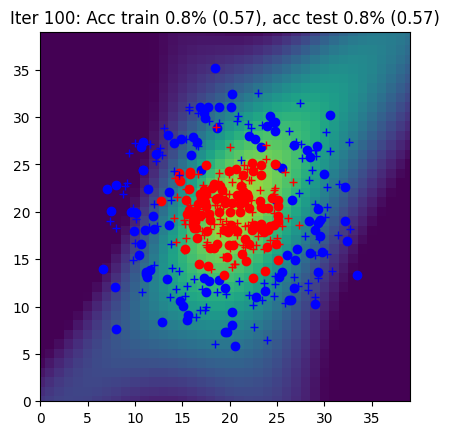

Iter 101: Acc train 0.8% (0.56), acc test 0.8% (0.56)


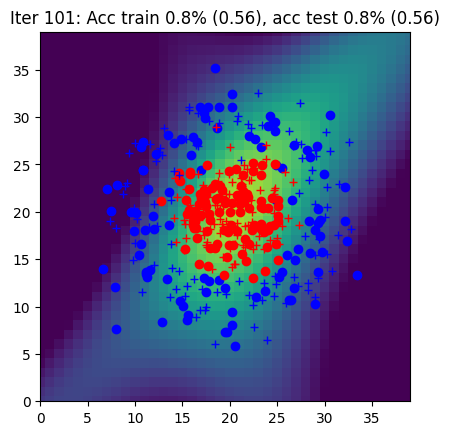

Iter 102: Acc train 0.8% (0.56), acc test 0.8% (0.56)


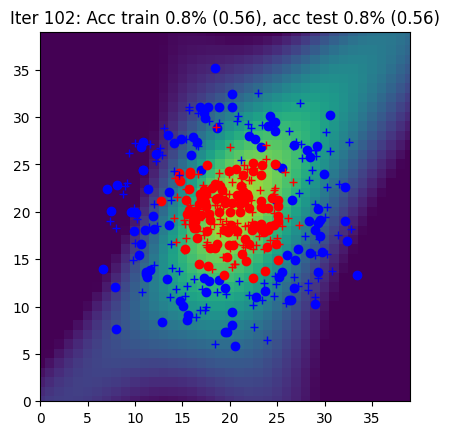

Iter 103: Acc train 0.9% (0.55), acc test 0.8% (0.55)


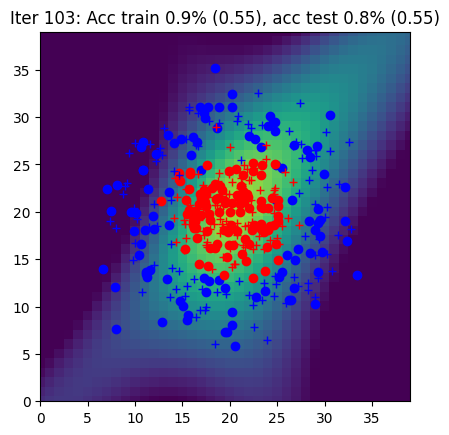

Iter 104: Acc train 0.9% (0.55), acc test 0.8% (0.55)


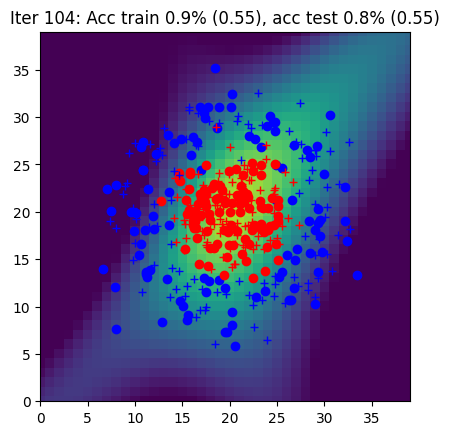

Iter 105: Acc train 0.9% (0.54), acc test 0.8% (0.54)


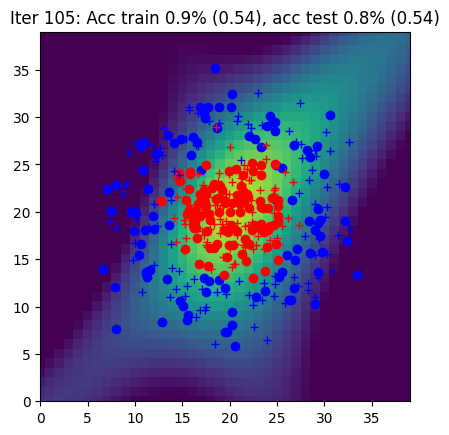

Iter 106: Acc train 0.9% (0.54), acc test 0.8% (0.54)


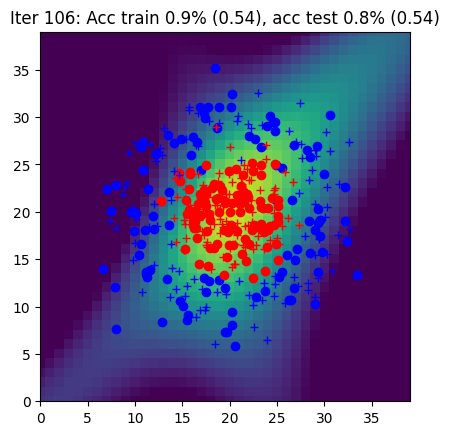

Iter 107: Acc train 0.9% (0.53), acc test 0.8% (0.53)


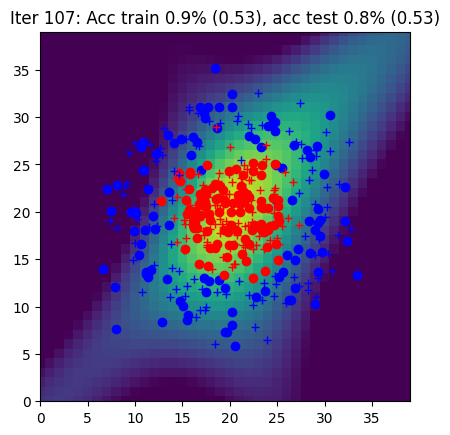

Iter 108: Acc train 0.9% (0.53), acc test 0.8% (0.53)


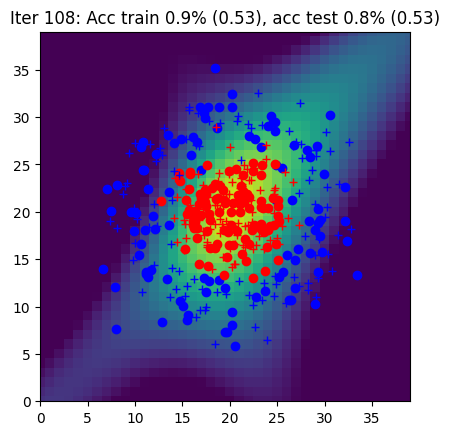

Iter 109: Acc train 0.9% (0.52), acc test 0.8% (0.52)


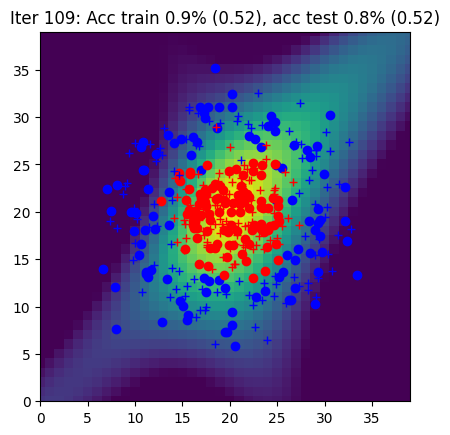

Iter 110: Acc train 0.9% (0.52), acc test 0.8% (0.52)


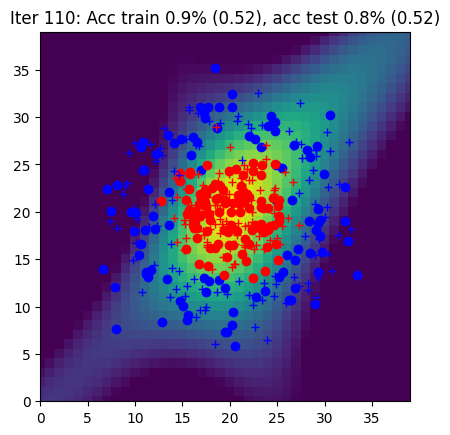

Iter 111: Acc train 0.9% (0.51), acc test 0.8% (0.51)


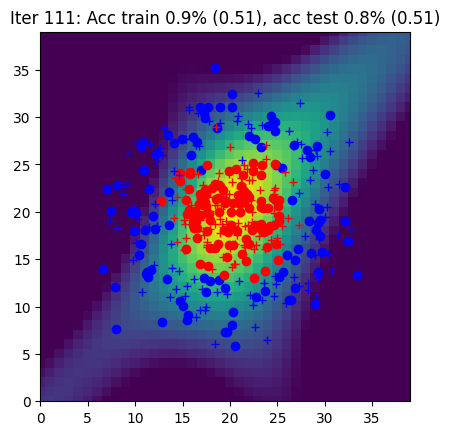

Iter 112: Acc train 0.9% (0.51), acc test 0.8% (0.51)


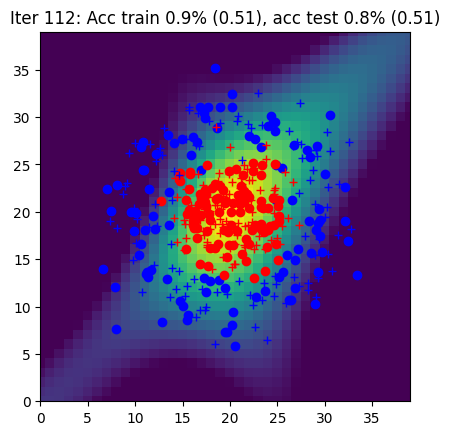

Iter 113: Acc train 0.9% (0.50), acc test 0.9% (0.50)


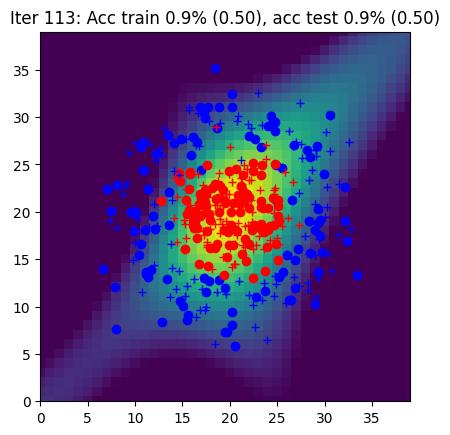

Iter 114: Acc train 0.9% (0.50), acc test 0.9% (0.50)


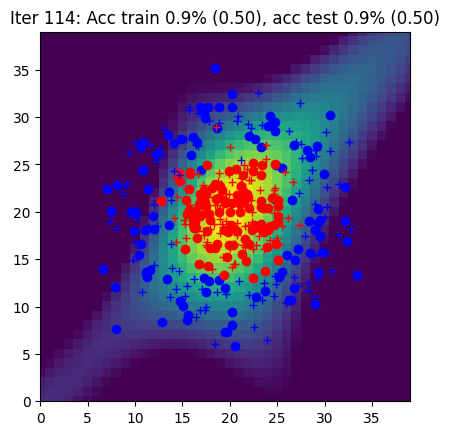

Iter 115: Acc train 0.9% (0.49), acc test 0.9% (0.49)


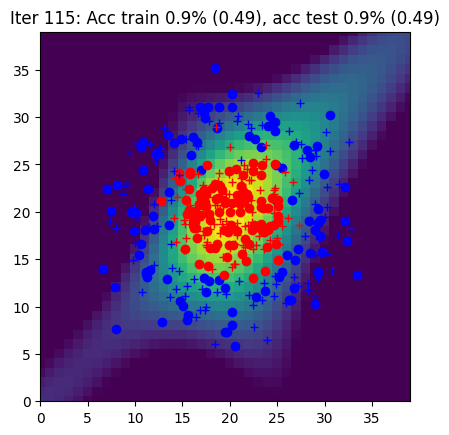

Iter 116: Acc train 0.9% (0.49), acc test 0.9% (0.49)


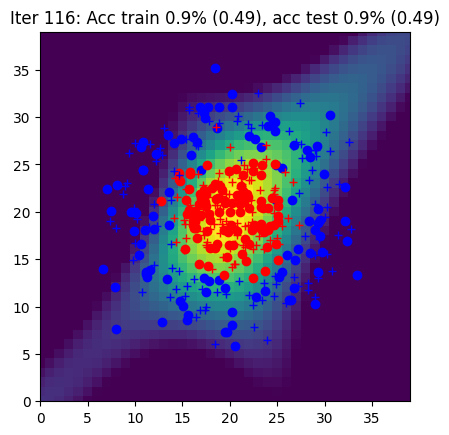

Iter 117: Acc train 0.9% (0.48), acc test 0.9% (0.48)


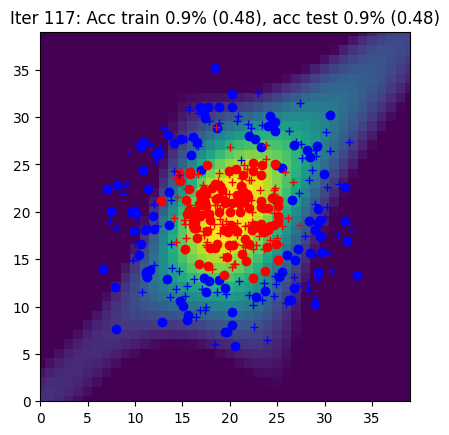

Iter 118: Acc train 0.9% (0.48), acc test 0.9% (0.48)


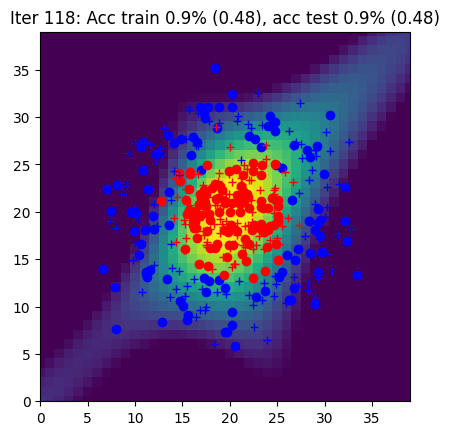

Iter 119: Acc train 0.9% (0.47), acc test 0.9% (0.47)


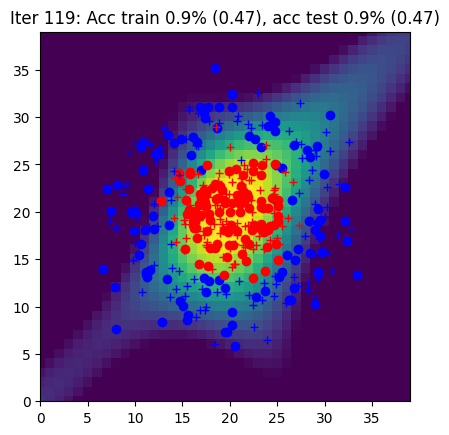

Iter 120: Acc train 0.9% (0.46), acc test 0.9% (0.46)


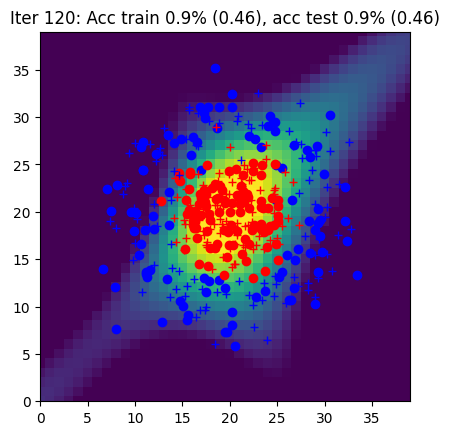

Iter 121: Acc train 0.9% (0.46), acc test 0.9% (0.46)


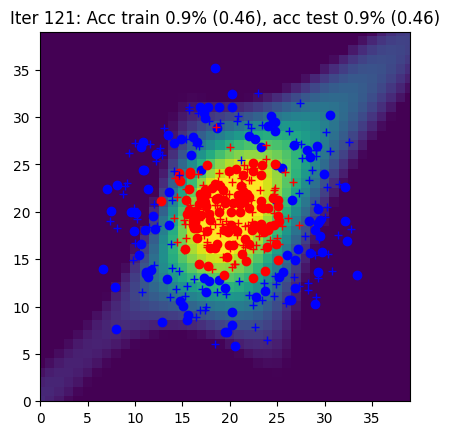

Iter 122: Acc train 0.9% (0.45), acc test 0.9% (0.45)


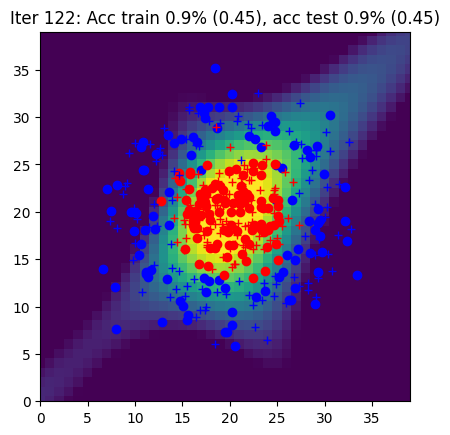

Iter 123: Acc train 0.9% (0.45), acc test 0.9% (0.45)


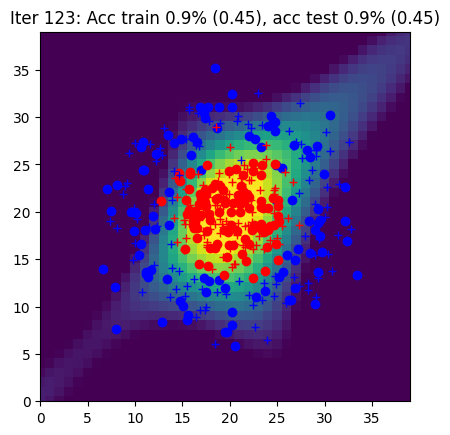

Iter 124: Acc train 0.9% (0.44), acc test 0.9% (0.44)


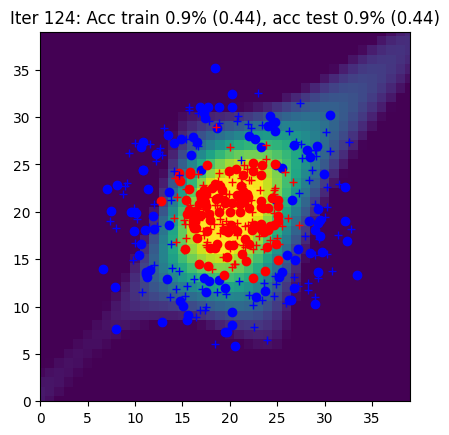

Iter 125: Acc train 0.9% (0.44), acc test 0.9% (0.44)


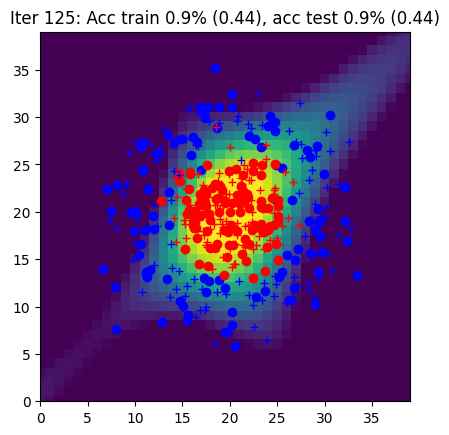

Iter 126: Acc train 0.9% (0.43), acc test 0.9% (0.43)


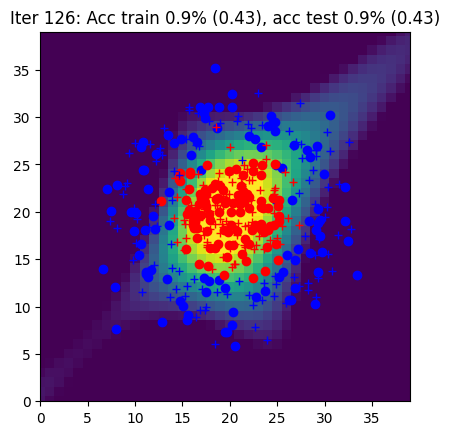

Iter 127: Acc train 0.9% (0.42), acc test 0.9% (0.43)


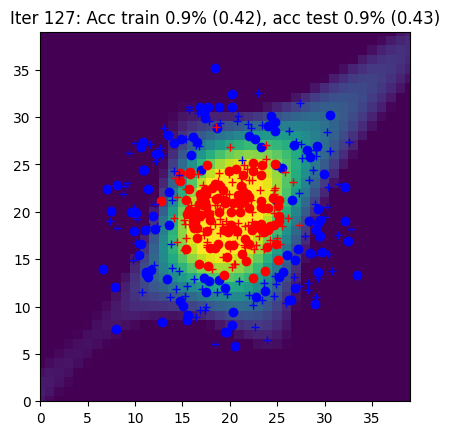

Iter 128: Acc train 0.9% (0.42), acc test 0.9% (0.42)


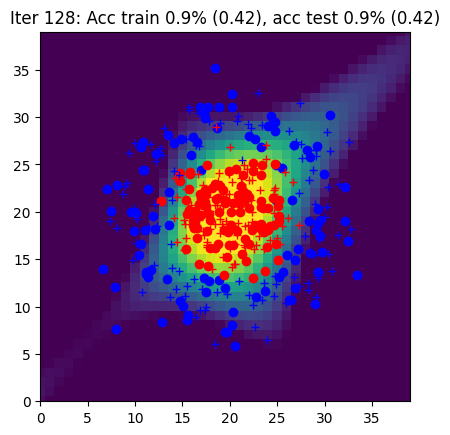

Iter 129: Acc train 0.9% (0.41), acc test 0.9% (0.42)


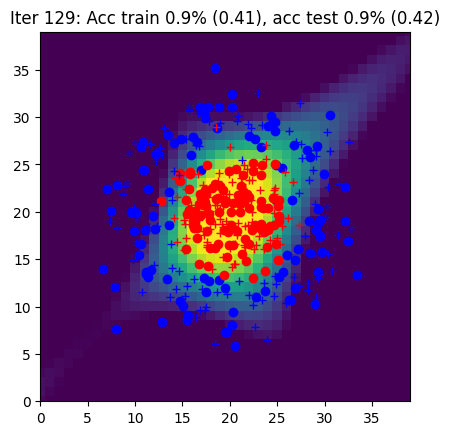

Iter 130: Acc train 0.9% (0.41), acc test 0.9% (0.41)


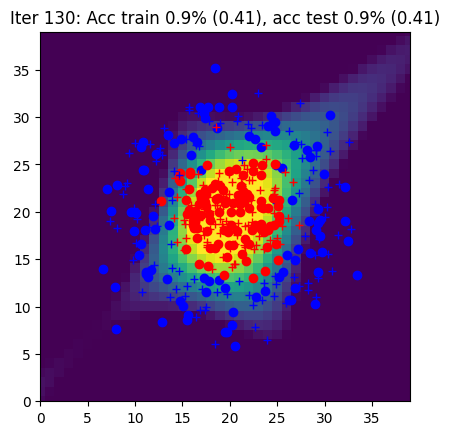

Iter 131: Acc train 0.9% (0.40), acc test 0.9% (0.41)


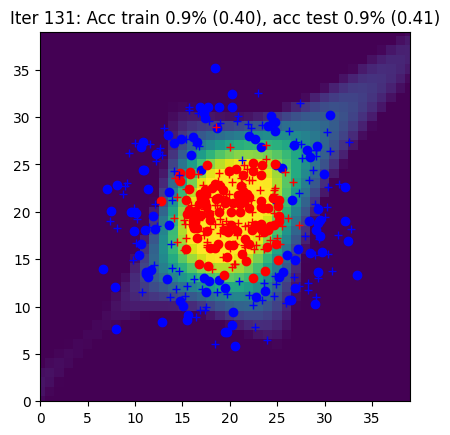

Iter 132: Acc train 0.9% (0.40), acc test 0.9% (0.40)


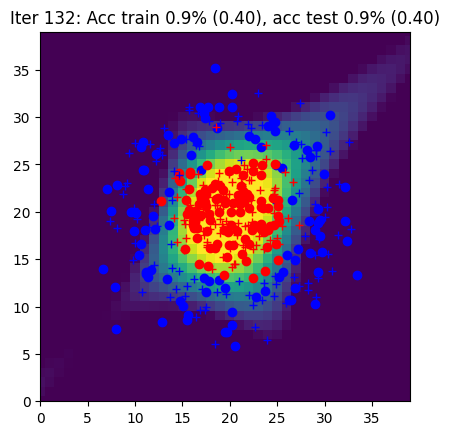

Iter 133: Acc train 0.9% (0.39), acc test 0.9% (0.40)


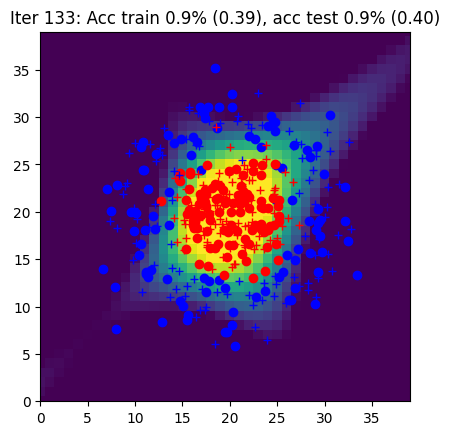

Iter 134: Acc train 0.9% (0.39), acc test 0.9% (0.39)


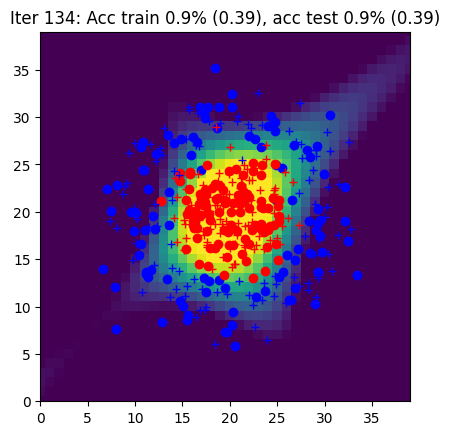

Iter 135: Acc train 0.9% (0.38), acc test 1.0% (0.39)


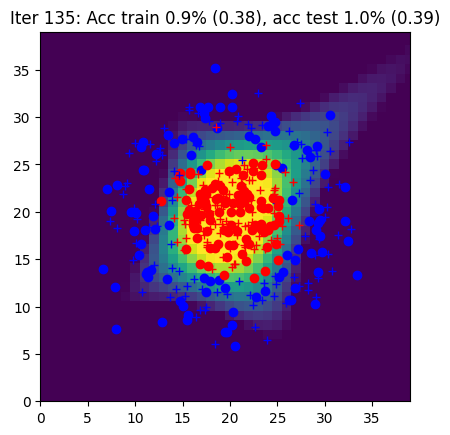

Iter 136: Acc train 0.9% (0.38), acc test 1.0% (0.38)


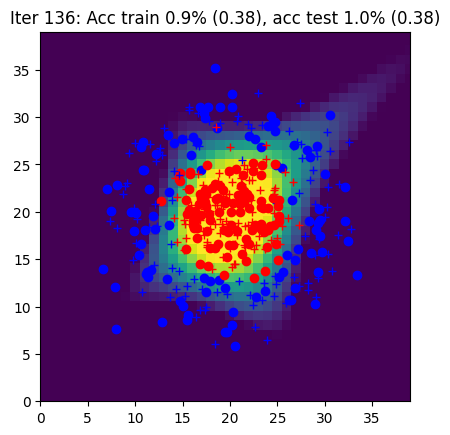

Iter 137: Acc train 0.9% (0.37), acc test 1.0% (0.38)


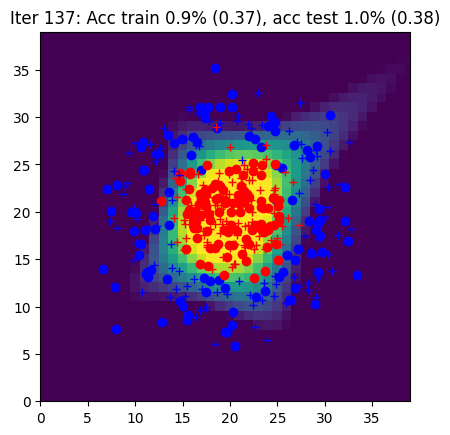

Iter 138: Acc train 0.9% (0.37), acc test 1.0% (0.37)


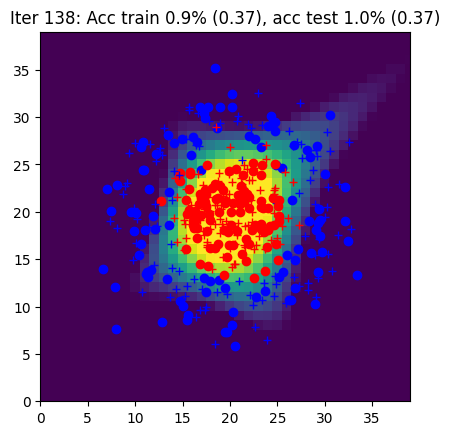

Iter 139: Acc train 0.9% (0.36), acc test 1.0% (0.37)


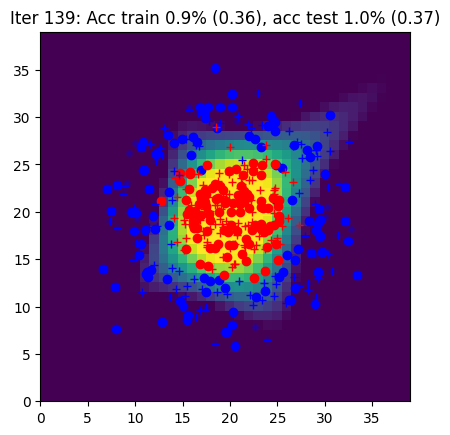

Iter 140: Acc train 0.9% (0.36), acc test 1.0% (0.36)


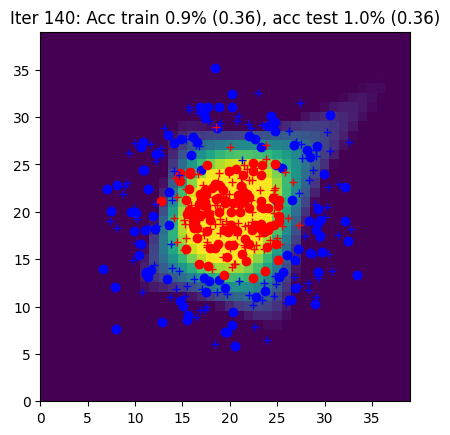

Iter 141: Acc train 0.9% (0.35), acc test 1.0% (0.36)


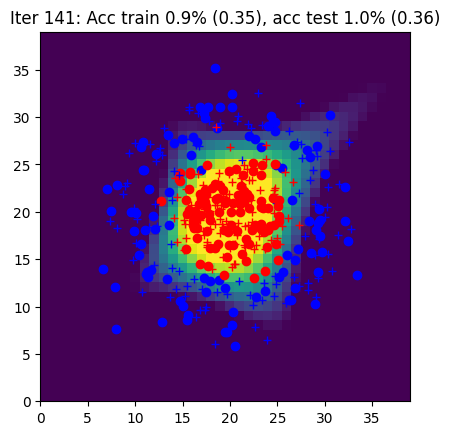

Iter 142: Acc train 0.9% (0.35), acc test 1.0% (0.35)


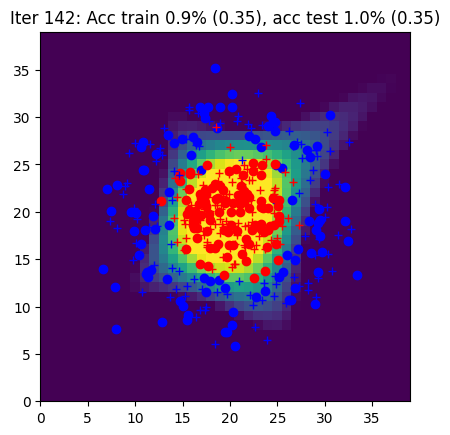

Iter 143: Acc train 0.9% (0.34), acc test 1.0% (0.35)


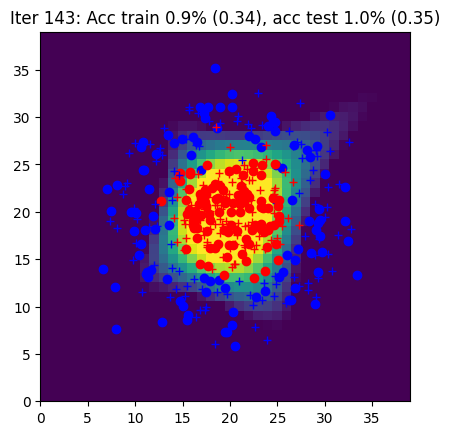

Iter 144: Acc train 0.9% (0.34), acc test 1.0% (0.35)


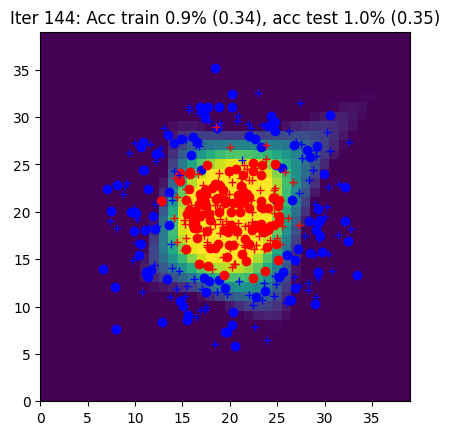

Iter 145: Acc train 0.9% (0.33), acc test 1.0% (0.34)


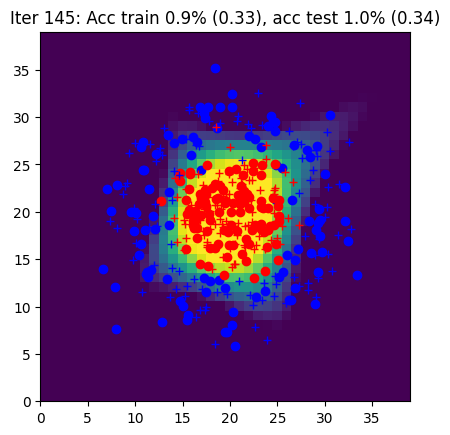

Iter 146: Acc train 1.0% (0.33), acc test 1.0% (0.34)


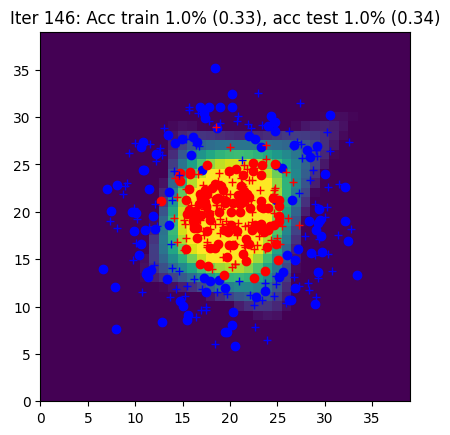

Iter 147: Acc train 0.9% (0.32), acc test 0.9% (0.33)


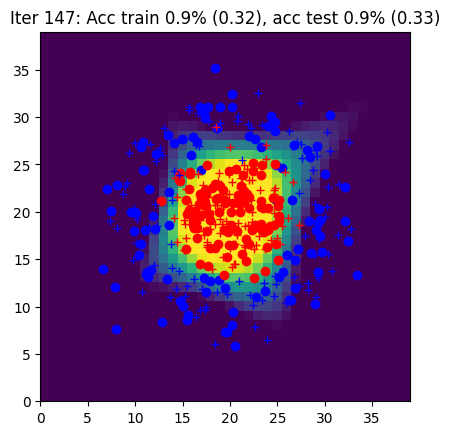

Iter 148: Acc train 0.9% (0.32), acc test 0.9% (0.33)


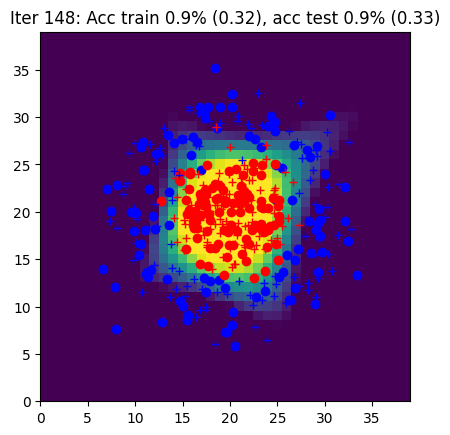

Iter 149: Acc train 0.9% (0.32), acc test 0.9% (0.33)


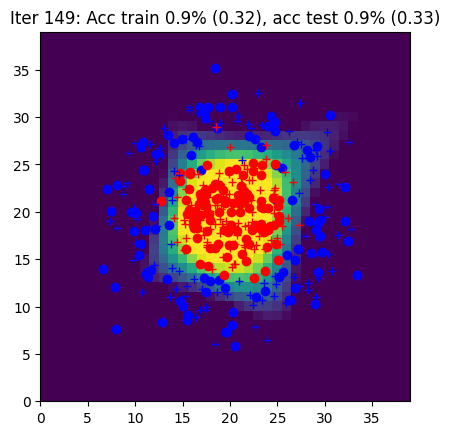

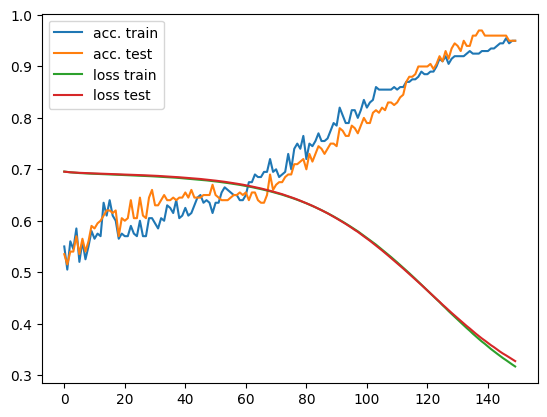

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, backward, sgd
        Yhat, outputs = forward(params, X)
        L, acc = loss_accuracy(Yhat, Y)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 2 : Simplification of the backward pass with `torch.autograd`



In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by
    # activaye autograd on the network weights

    params["Wh"] = torch.randn(nh, nx, requires_grad=True)
    params["Wy"] = torch.randn(ny, nh, requires_grad=True)
    params["bh"] = torch.zeros(nh, requires_grad=True)
    params["by"] = torch.zeros(ny, requires_grad=True)


    ####################
    ##      END        #
    ####################
    return params

The function `forward` remains unchanged from previous part.

The function `backward` is no longer used because of "autograd".

In [ ]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators
    with torch.no_grad():
      params["Wh"] -= eta*params["Wh"].grad
      params["Wy"] -= eta*params["Wy"].grad
      params["bh"] -= eta*params["bh"].grad
      params["by"] -= eta*params["by"].grad
      params["Wh"].grad.zero_()
      params["Wy"].grad.zero_()
      params["bh"].grad.zero_()
      params["by"].grad.zero_()

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure with autograd

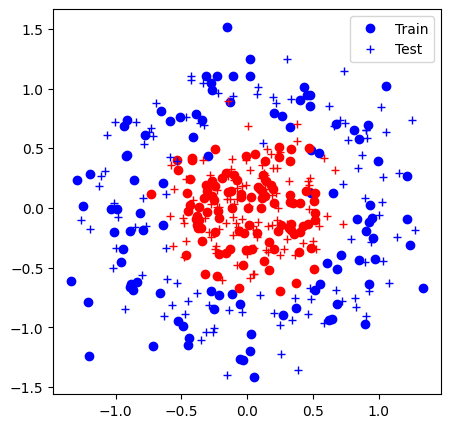

Iter 0: Acc train 0.6% (0.95), acc test 0.6% (0.93)


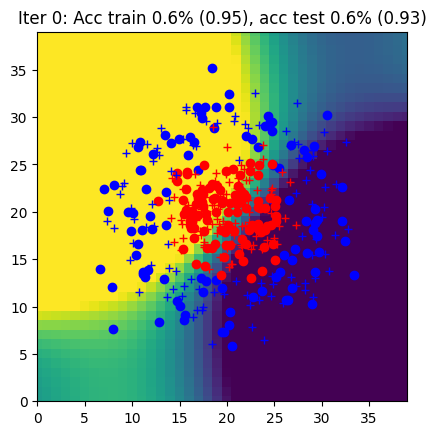

Iter 1: Acc train 0.6% (0.71), acc test 0.7% (0.70)


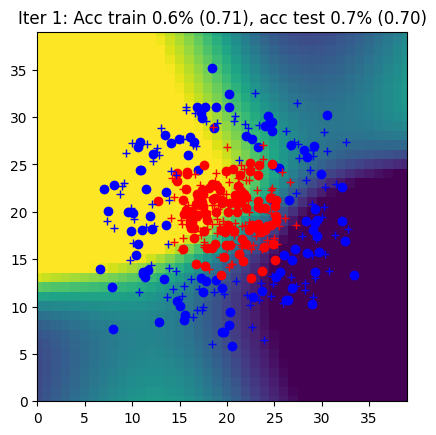

Iter 2: Acc train 0.7% (0.63), acc test 0.7% (0.63)


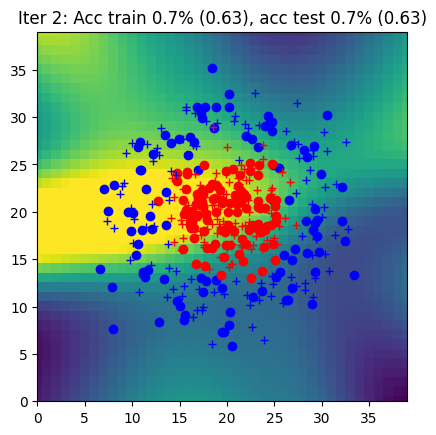

Iter 3: Acc train 0.8% (0.61), acc test 0.8% (0.61)


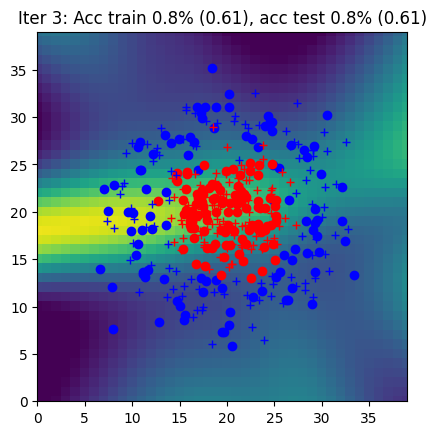

Iter 4: Acc train 0.8% (0.59), acc test 0.8% (0.59)


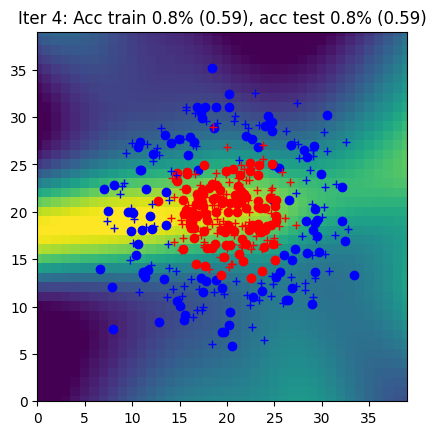

Iter 5: Acc train 0.8% (0.57), acc test 0.8% (0.58)


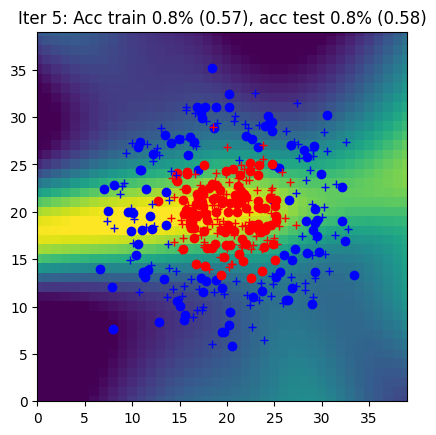

Iter 6: Acc train 0.8% (0.56), acc test 0.8% (0.57)


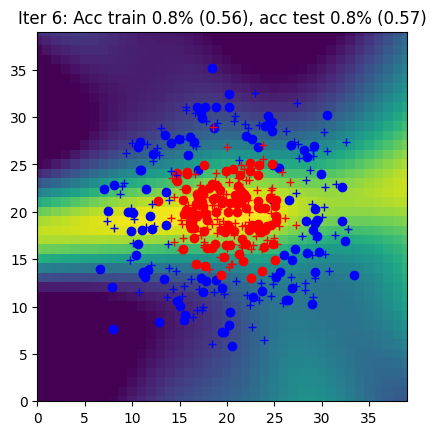

Iter 7: Acc train 0.8% (0.55), acc test 0.8% (0.55)


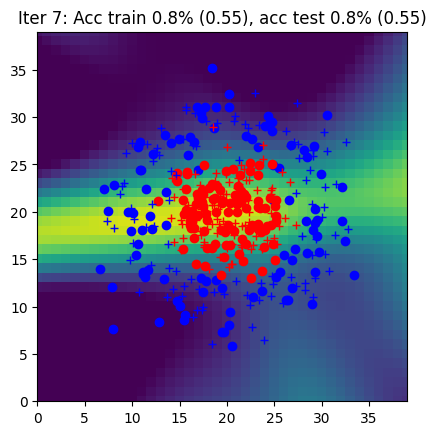

Iter 8: Acc train 0.8% (0.54), acc test 0.8% (0.54)


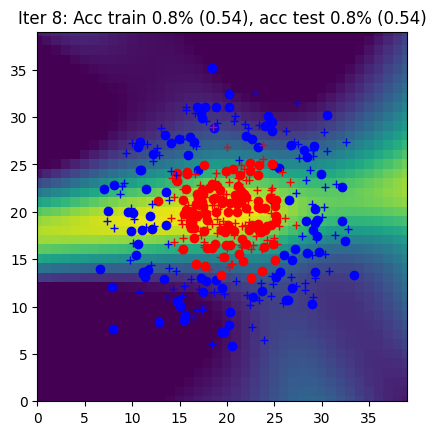

Iter 9: Acc train 0.8% (0.53), acc test 0.8% (0.54)


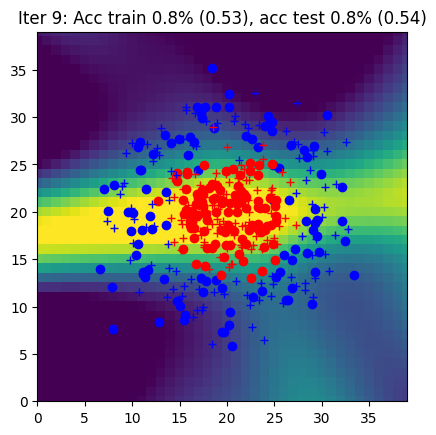

Iter 10: Acc train 0.8% (0.52), acc test 0.8% (0.52)


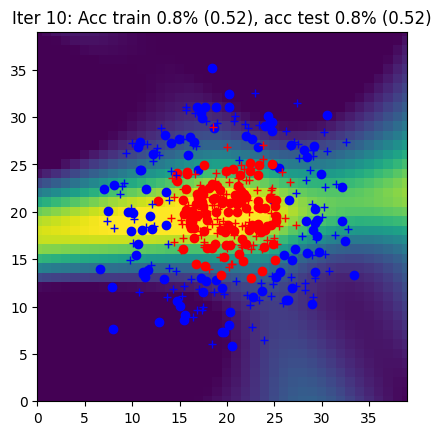

Iter 11: Acc train 0.8% (0.51), acc test 0.8% (0.51)


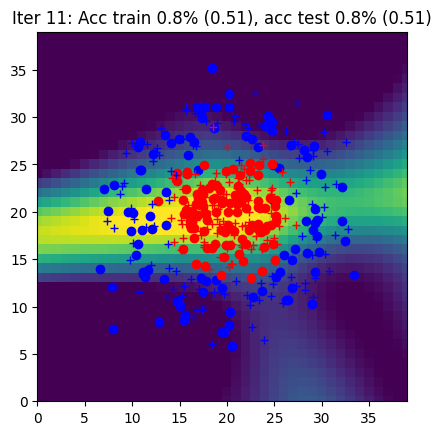

Iter 12: Acc train 0.8% (0.50), acc test 0.8% (0.50)


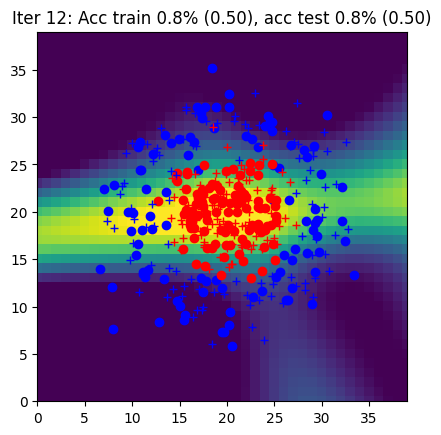

Iter 13: Acc train 0.8% (0.49), acc test 0.9% (0.49)


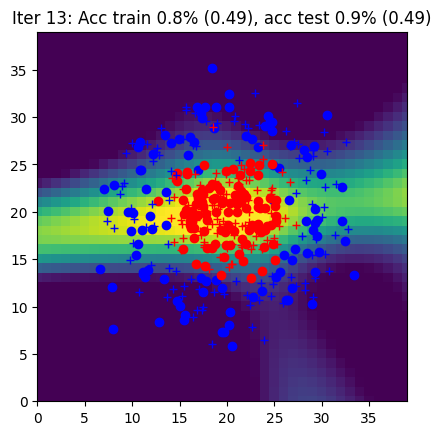

Iter 14: Acc train 0.8% (0.49), acc test 0.8% (0.49)


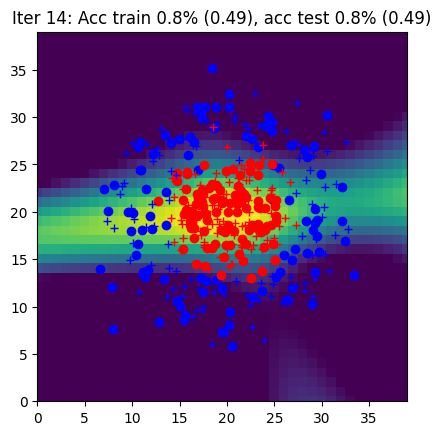

Iter 15: Acc train 0.8% (0.47), acc test 0.9% (0.47)


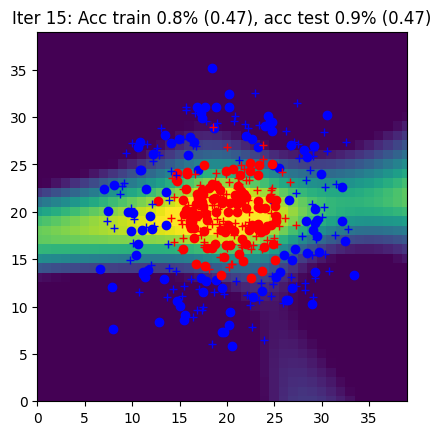

Iter 16: Acc train 0.8% (0.46), acc test 0.9% (0.46)


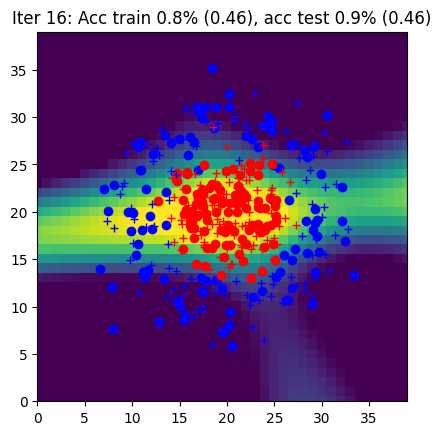

Iter 17: Acc train 0.8% (0.46), acc test 0.9% (0.46)


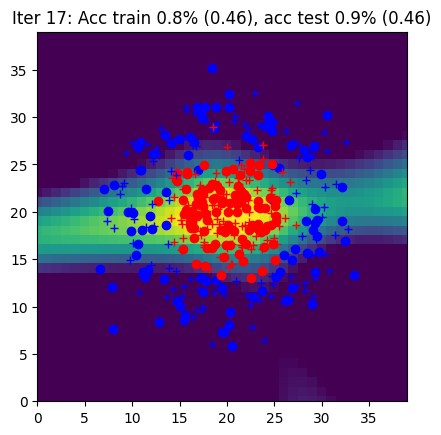

Iter 18: Acc train 0.9% (0.45), acc test 0.9% (0.45)


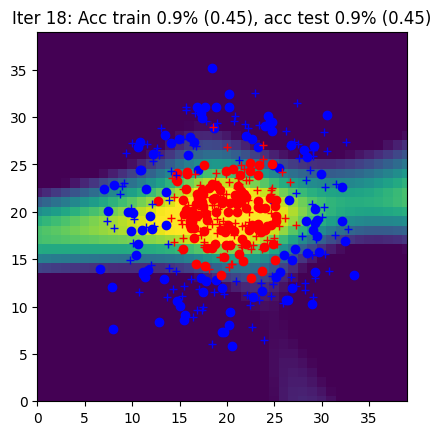

Iter 19: Acc train 0.9% (0.44), acc test 0.9% (0.44)


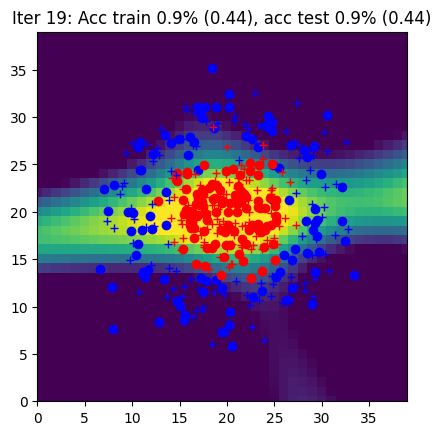

Iter 20: Acc train 0.9% (0.43), acc test 0.9% (0.43)


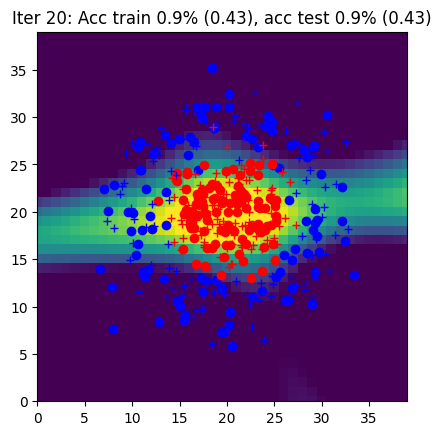

Iter 21: Acc train 0.9% (0.42), acc test 0.9% (0.42)


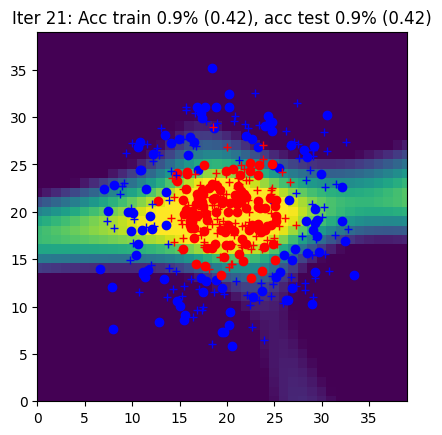

Iter 22: Acc train 0.9% (0.41), acc test 0.9% (0.42)


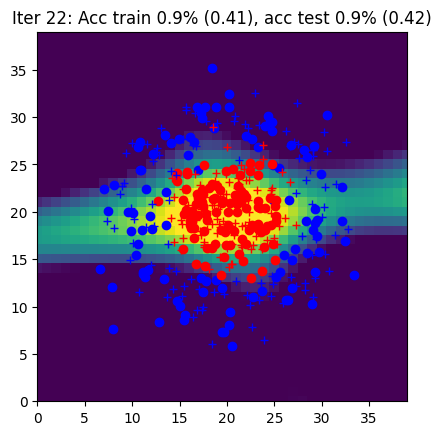

Iter 23: Acc train 0.9% (0.41), acc test 0.9% (0.41)


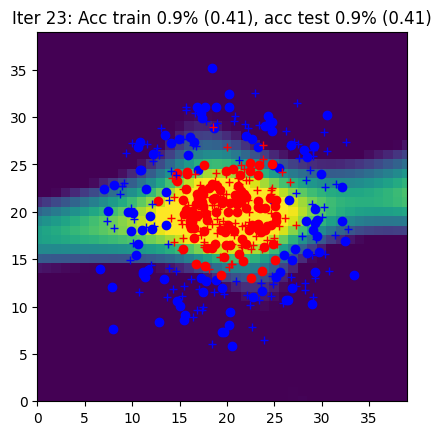

Iter 24: Acc train 0.9% (0.40), acc test 0.9% (0.40)


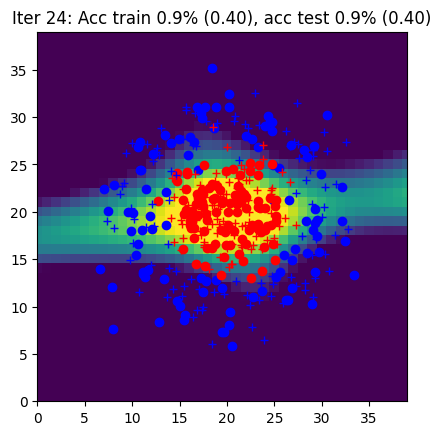

Iter 25: Acc train 0.9% (0.39), acc test 0.9% (0.39)


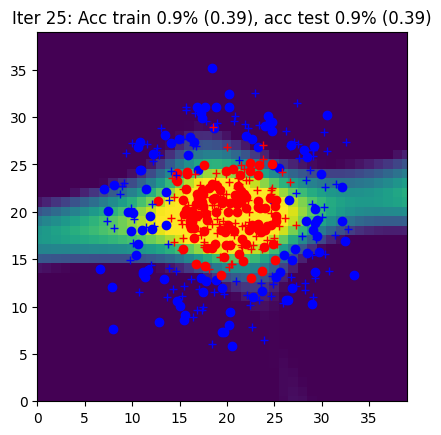

Iter 26: Acc train 0.9% (0.39), acc test 0.9% (0.39)


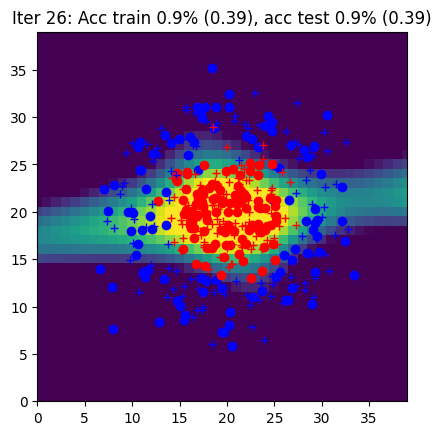

Iter 27: Acc train 0.9% (0.38), acc test 0.9% (0.38)


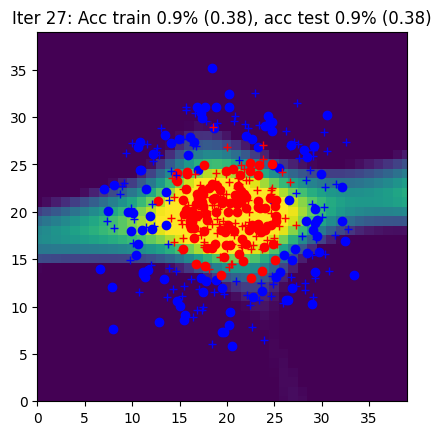

Iter 28: Acc train 0.9% (0.37), acc test 0.9% (0.38)


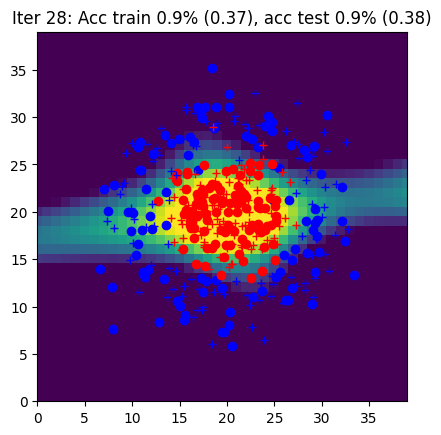

Iter 29: Acc train 0.9% (0.37), acc test 0.9% (0.37)


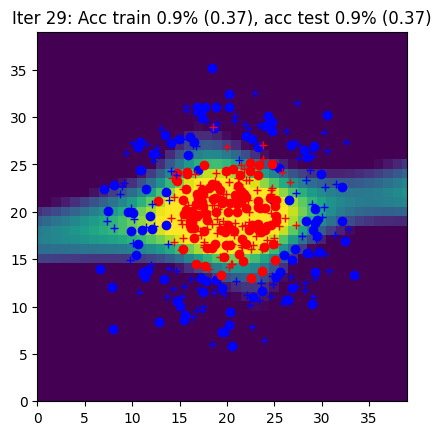

Iter 30: Acc train 0.9% (0.36), acc test 0.9% (0.36)


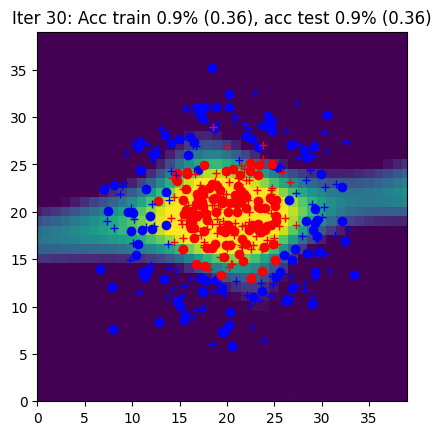

Iter 31: Acc train 0.9% (0.35), acc test 0.9% (0.36)


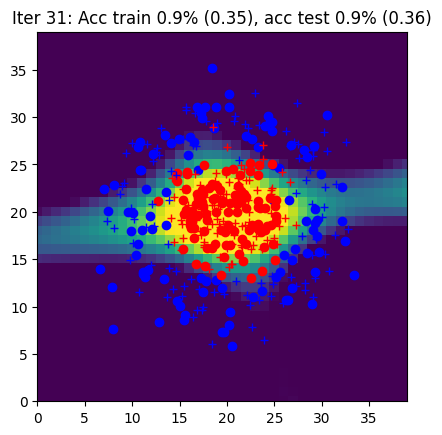

Iter 32: Acc train 0.9% (0.35), acc test 0.9% (0.35)


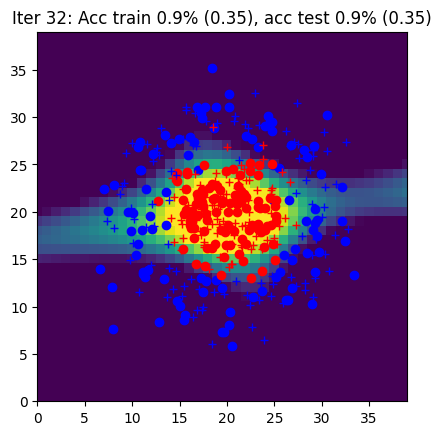

Iter 33: Acc train 0.9% (0.34), acc test 0.9% (0.35)


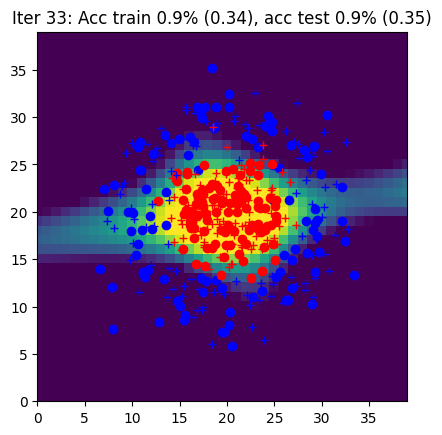

Iter 34: Acc train 0.9% (0.34), acc test 0.9% (0.34)


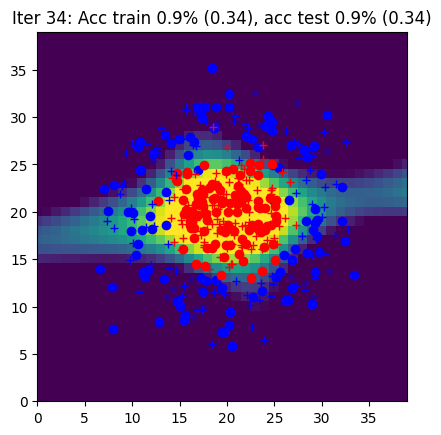

Iter 35: Acc train 0.9% (0.33), acc test 0.9% (0.34)


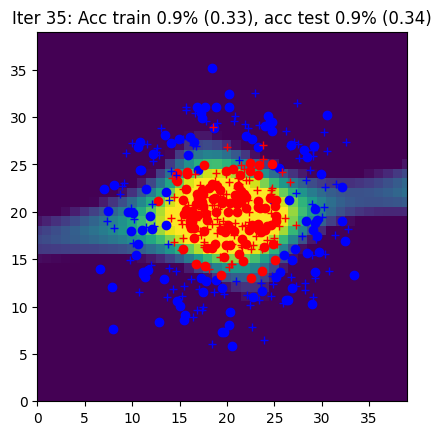

Iter 36: Acc train 0.9% (0.33), acc test 0.9% (0.33)


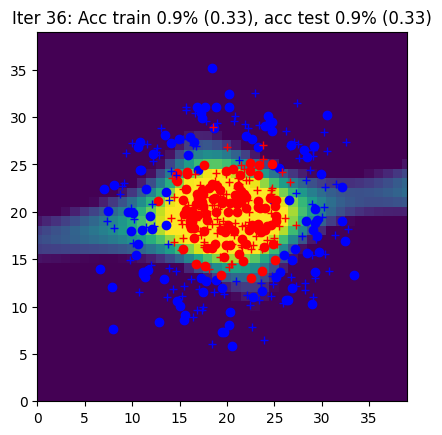

Iter 37: Acc train 0.9% (0.32), acc test 0.9% (0.33)


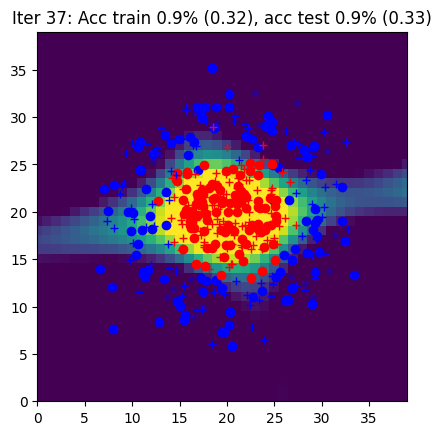

Iter 38: Acc train 0.9% (0.32), acc test 0.9% (0.32)


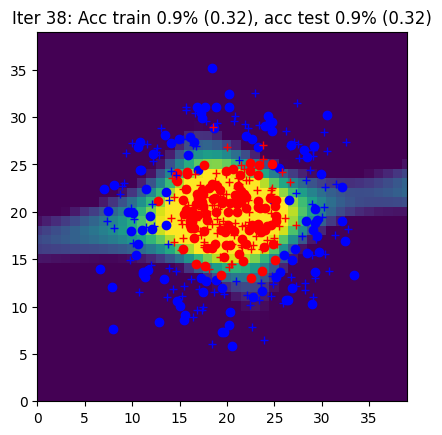

Iter 39: Acc train 0.9% (0.32), acc test 0.9% (0.32)


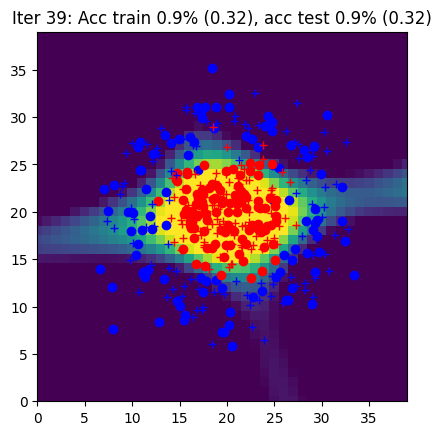

Iter 40: Acc train 0.9% (0.31), acc test 0.9% (0.31)


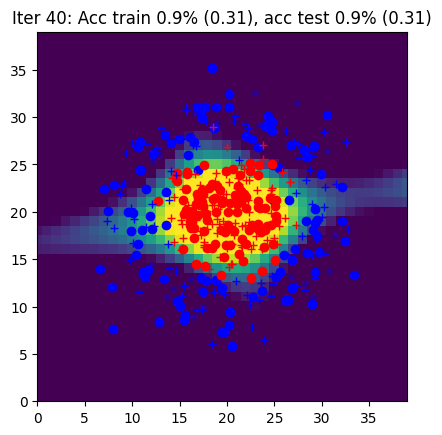

Iter 41: Acc train 0.9% (0.31), acc test 0.9% (0.31)


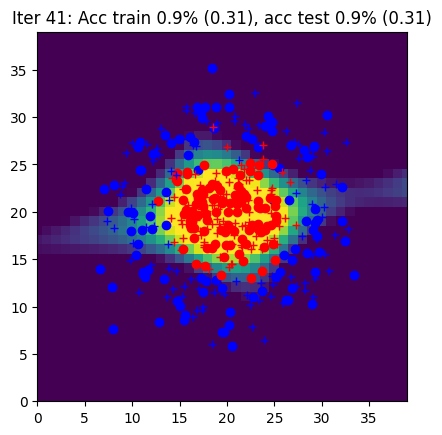

Iter 42: Acc train 0.9% (0.30), acc test 0.9% (0.30)


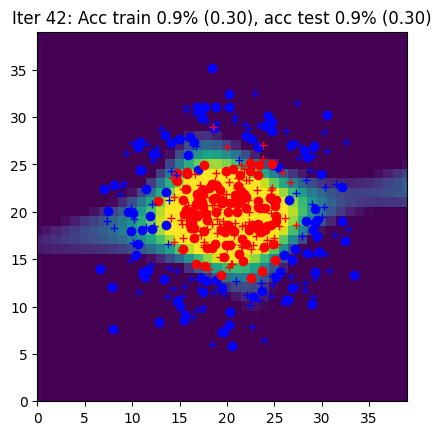

Iter 43: Acc train 0.9% (0.30), acc test 0.9% (0.30)


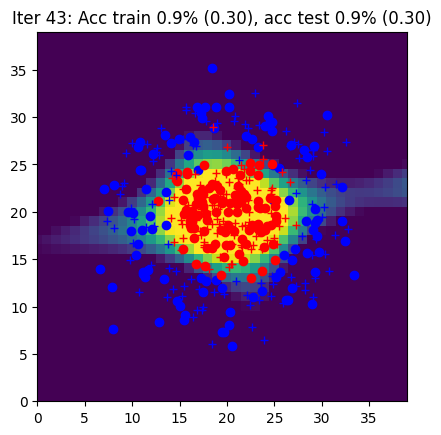

Iter 44: Acc train 0.9% (0.29), acc test 0.9% (0.30)


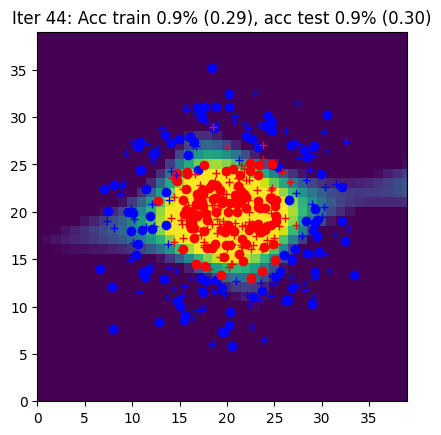

Iter 45: Acc train 0.9% (0.29), acc test 0.9% (0.29)


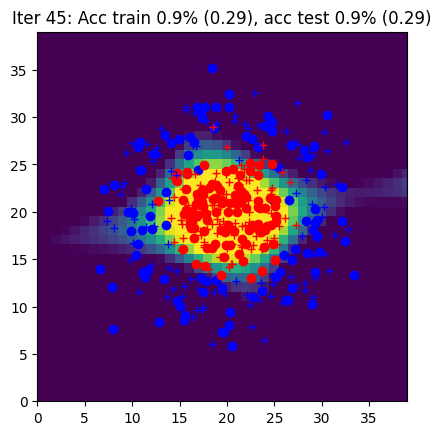

Iter 46: Acc train 0.9% (0.29), acc test 0.9% (0.29)


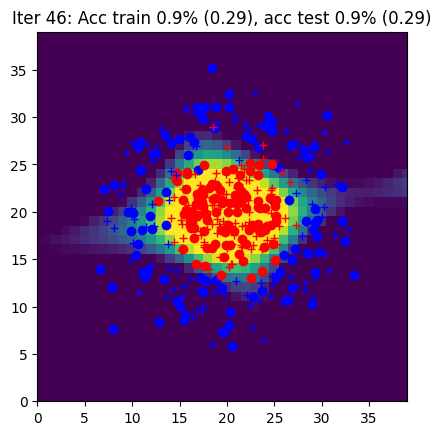

Iter 47: Acc train 0.9% (0.28), acc test 0.9% (0.29)


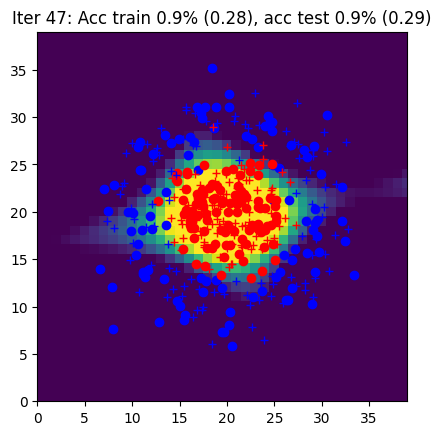

Iter 48: Acc train 0.9% (0.28), acc test 0.9% (0.28)


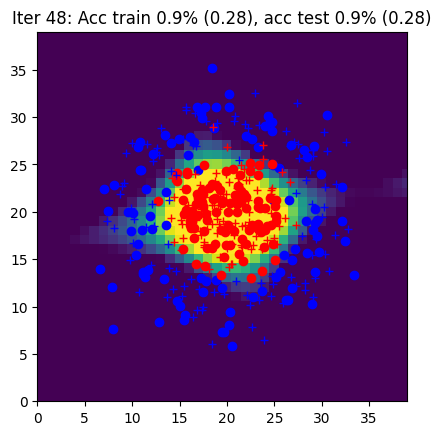

Iter 49: Acc train 0.9% (0.28), acc test 0.9% (0.28)


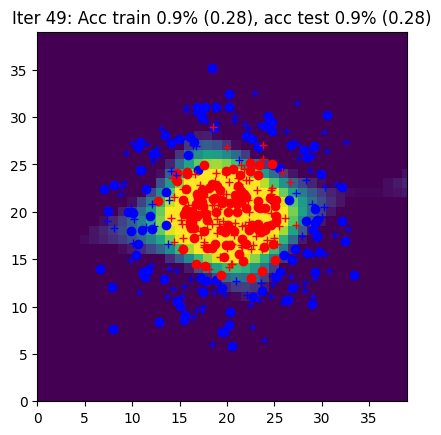

Iter 50: Acc train 0.9% (0.27), acc test 0.9% (0.28)


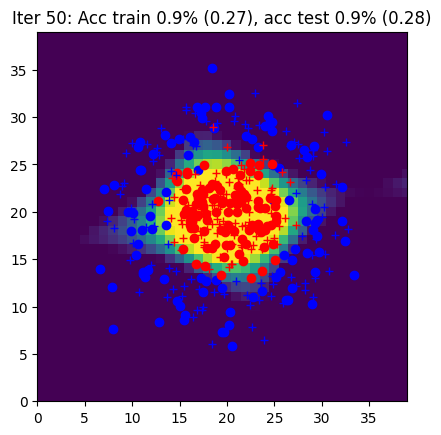

Iter 51: Acc train 0.9% (0.27), acc test 0.9% (0.27)


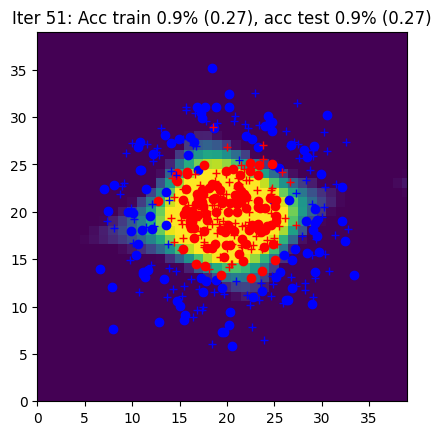

Iter 52: Acc train 0.9% (0.27), acc test 0.9% (0.27)


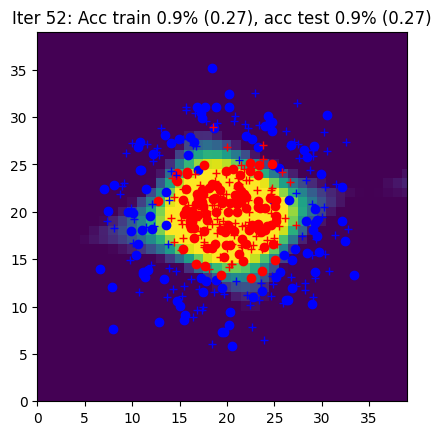

Iter 53: Acc train 0.9% (0.26), acc test 0.9% (0.27)


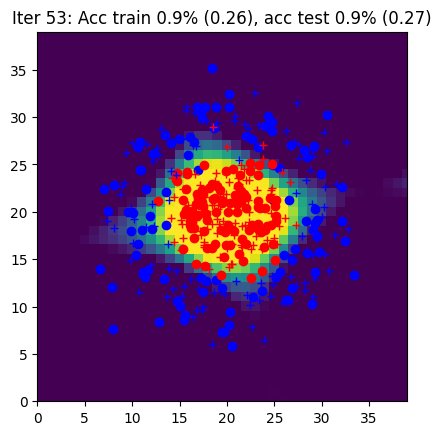

Iter 54: Acc train 0.9% (0.26), acc test 0.9% (0.27)


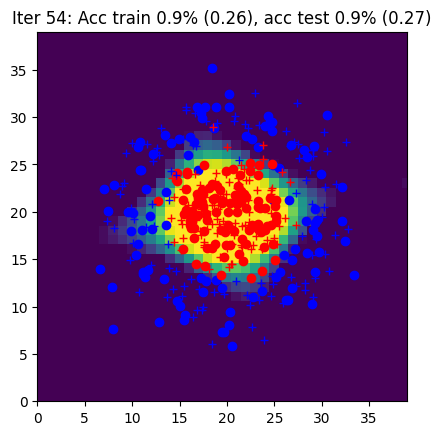

Iter 55: Acc train 0.9% (0.26), acc test 0.9% (0.26)


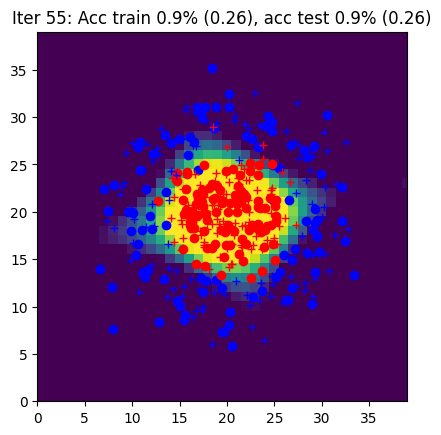

Iter 56: Acc train 0.9% (0.25), acc test 0.9% (0.26)


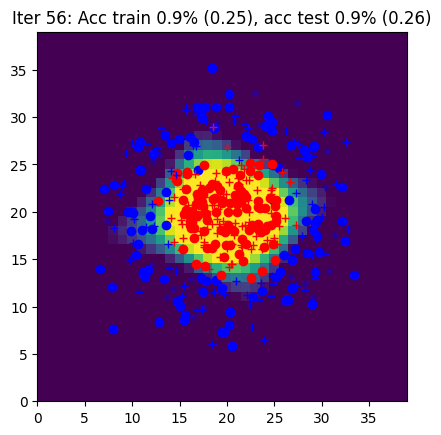

Iter 57: Acc train 0.9% (0.25), acc test 0.9% (0.26)


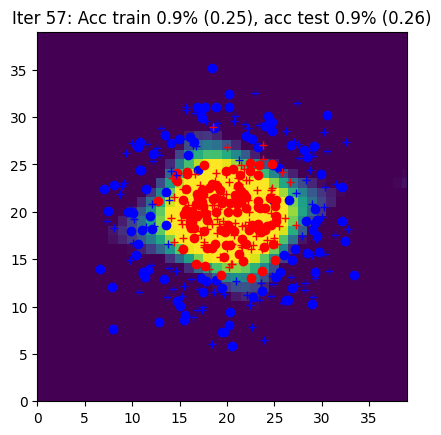

Iter 58: Acc train 0.9% (0.25), acc test 0.9% (0.25)


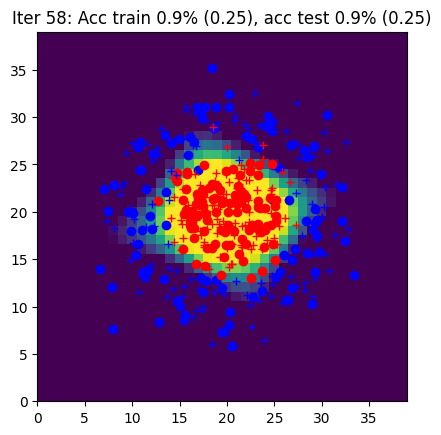

Iter 59: Acc train 0.9% (0.25), acc test 0.9% (0.25)


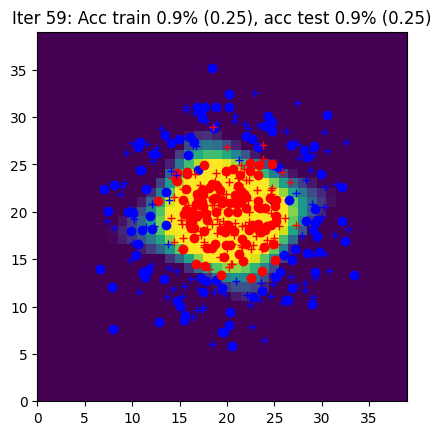

Iter 60: Acc train 0.9% (0.24), acc test 0.9% (0.25)


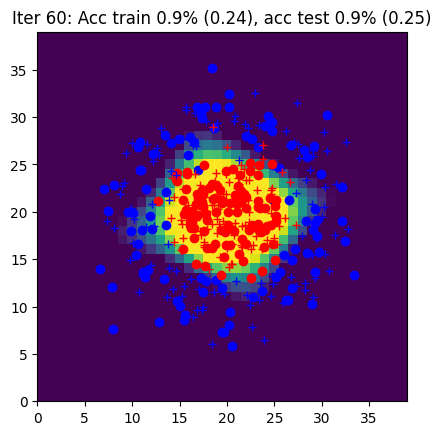

Iter 61: Acc train 0.9% (0.24), acc test 0.9% (0.25)


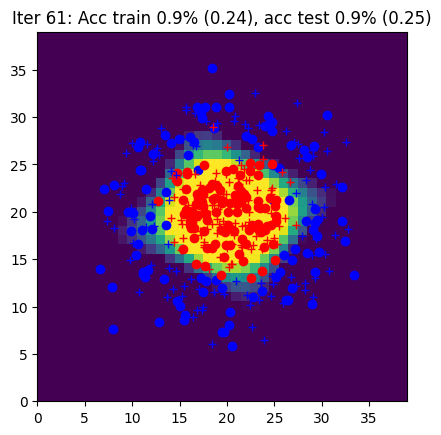

Iter 62: Acc train 0.9% (0.24), acc test 0.9% (0.24)


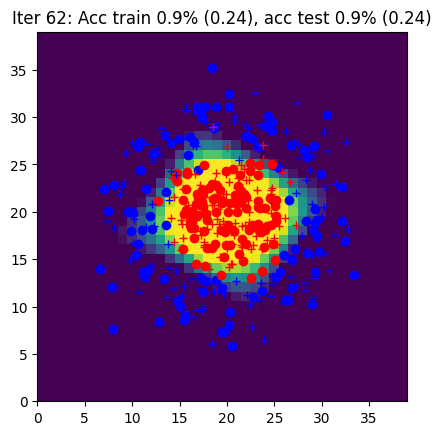

Iter 63: Acc train 0.9% (0.24), acc test 0.9% (0.24)


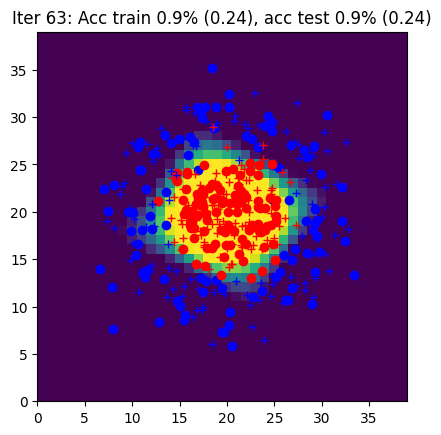

Iter 64: Acc train 0.9% (0.24), acc test 0.9% (0.24)


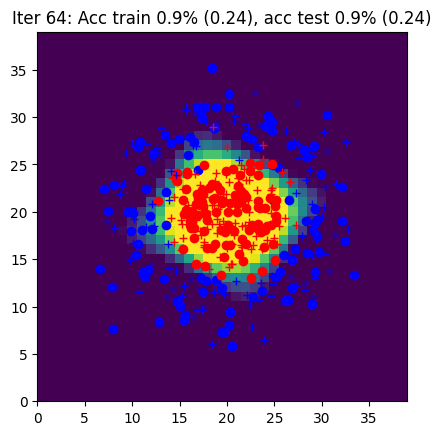

Iter 65: Acc train 0.9% (0.23), acc test 0.9% (0.24)


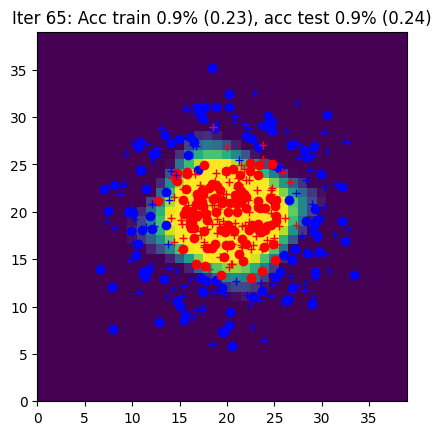

Iter 66: Acc train 0.9% (0.23), acc test 0.9% (0.24)


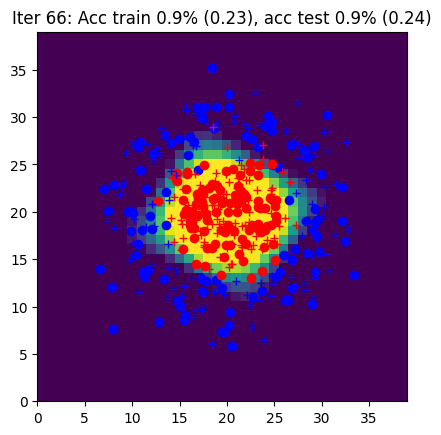

Iter 67: Acc train 0.9% (0.23), acc test 0.9% (0.24)


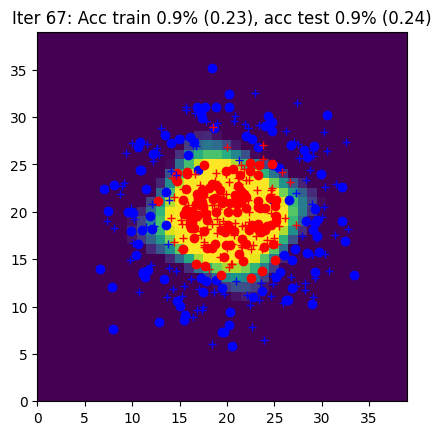

Iter 68: Acc train 0.9% (0.23), acc test 0.9% (0.23)


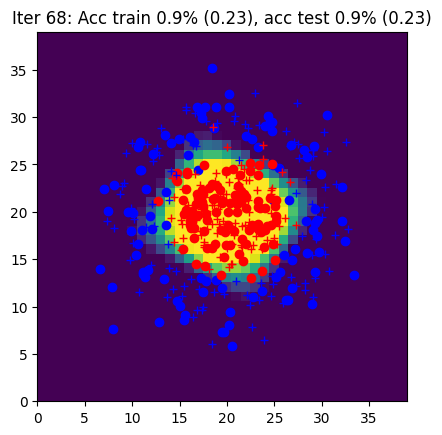

Iter 69: Acc train 0.9% (0.23), acc test 0.9% (0.23)


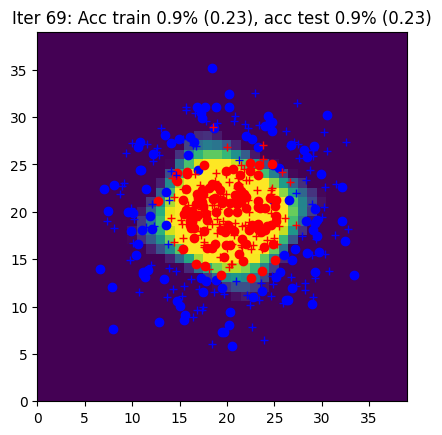

Iter 70: Acc train 0.9% (0.22), acc test 0.9% (0.23)


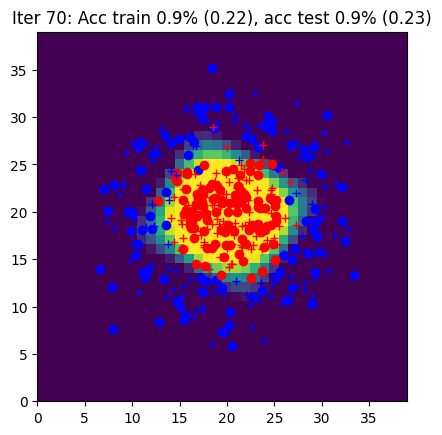

Iter 71: Acc train 0.9% (0.22), acc test 0.9% (0.23)


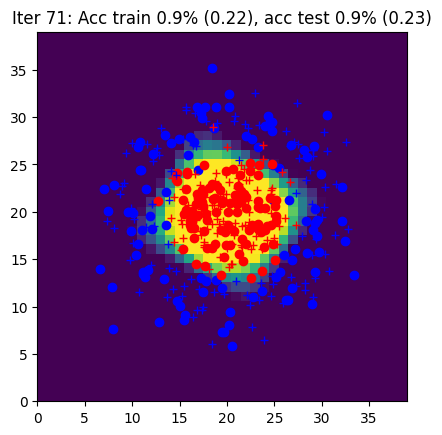

Iter 72: Acc train 0.9% (0.22), acc test 0.9% (0.23)


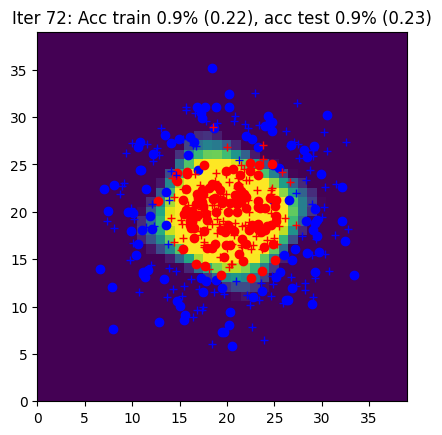

Iter 73: Acc train 0.9% (0.22), acc test 0.9% (0.22)


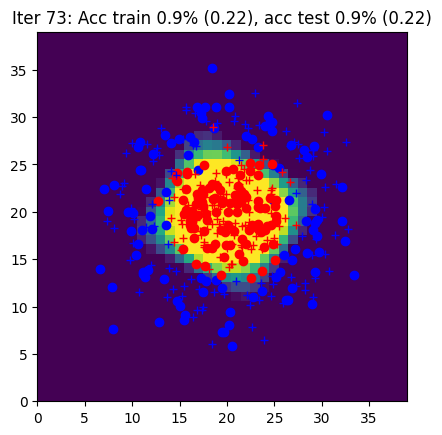

Iter 74: Acc train 0.9% (0.22), acc test 0.9% (0.22)


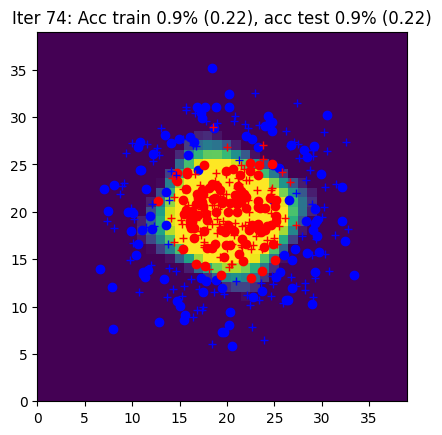

Iter 75: Acc train 0.9% (0.22), acc test 0.9% (0.22)


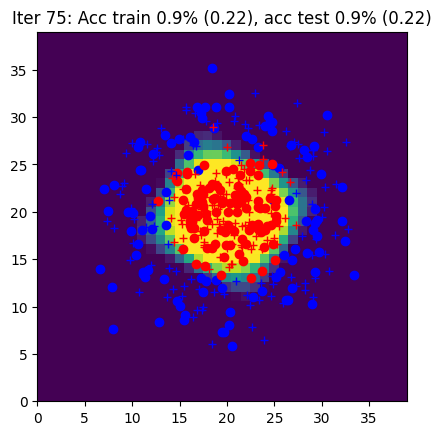

Iter 76: Acc train 0.9% (0.21), acc test 0.9% (0.22)


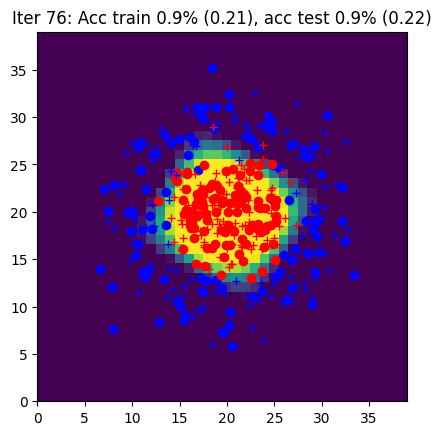

Iter 77: Acc train 0.9% (0.21), acc test 0.9% (0.22)


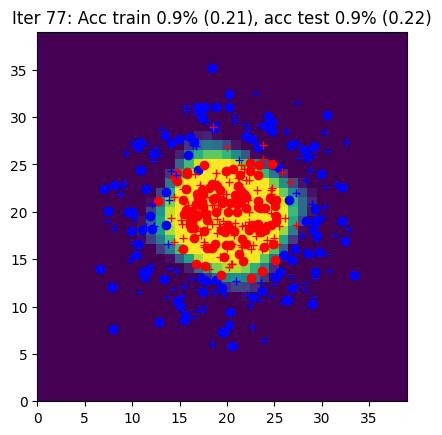

Iter 78: Acc train 0.9% (0.21), acc test 0.9% (0.22)


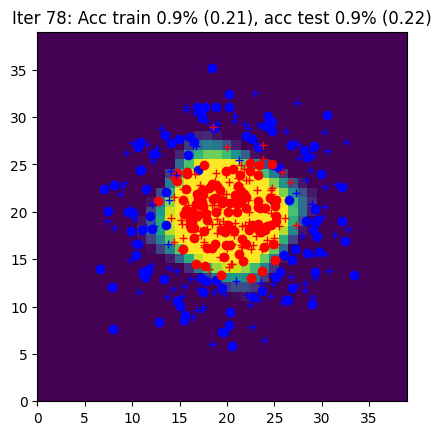

Iter 79: Acc train 0.9% (0.21), acc test 0.9% (0.22)


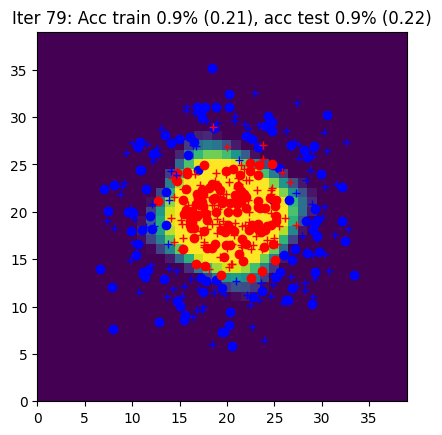

Iter 80: Acc train 0.9% (0.21), acc test 0.9% (0.21)


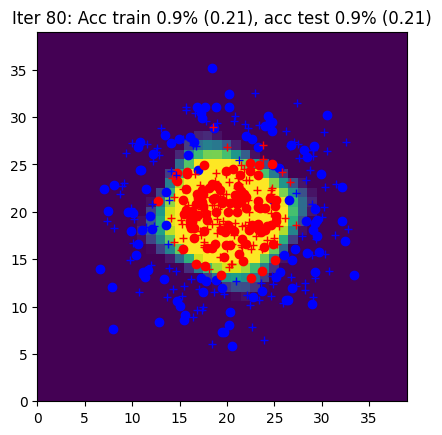

Iter 81: Acc train 0.9% (0.21), acc test 0.9% (0.21)


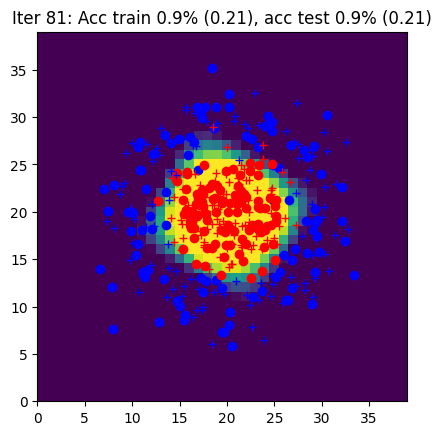

Iter 82: Acc train 0.9% (0.21), acc test 0.9% (0.21)


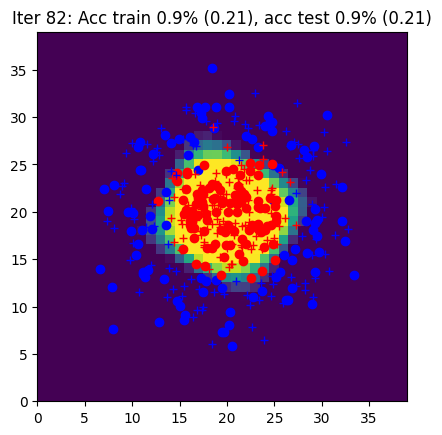

Iter 83: Acc train 0.9% (0.20), acc test 0.9% (0.21)


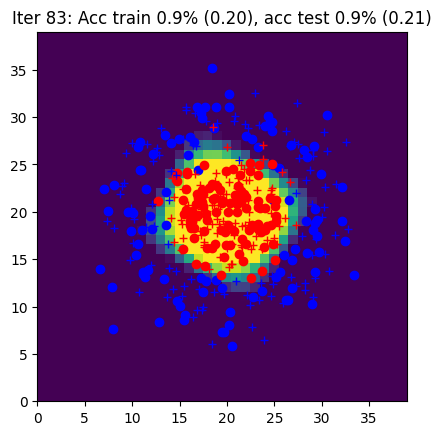

Iter 84: Acc train 0.9% (0.20), acc test 0.9% (0.21)


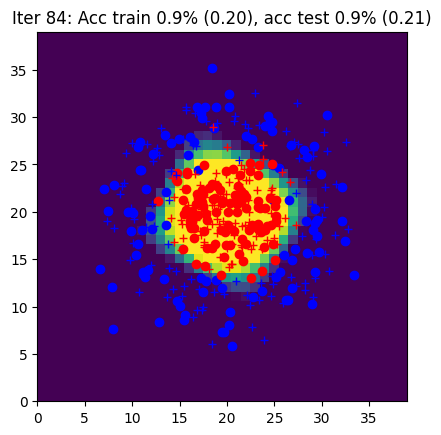

Iter 85: Acc train 0.9% (0.20), acc test 0.9% (0.21)


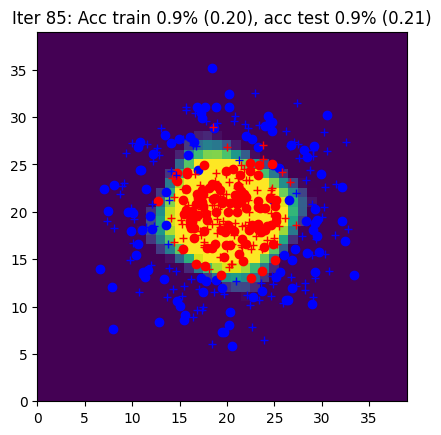

Iter 86: Acc train 0.9% (0.20), acc test 0.9% (0.21)


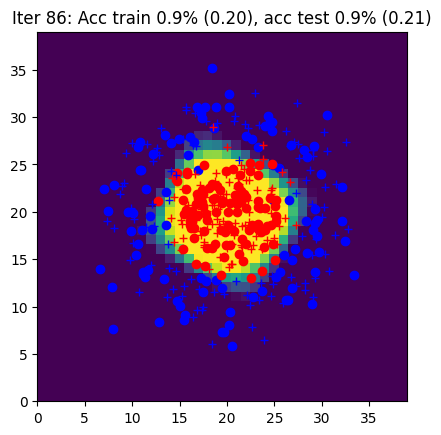

Iter 87: Acc train 0.9% (0.20), acc test 0.9% (0.21)


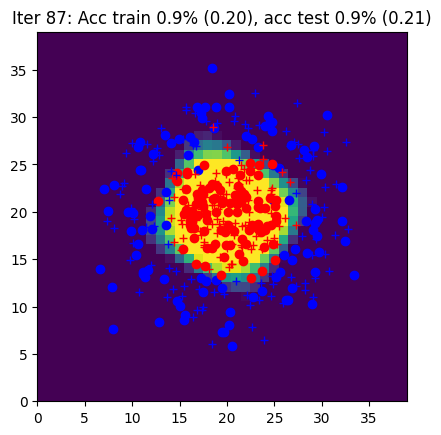

Iter 88: Acc train 0.9% (0.20), acc test 0.9% (0.21)


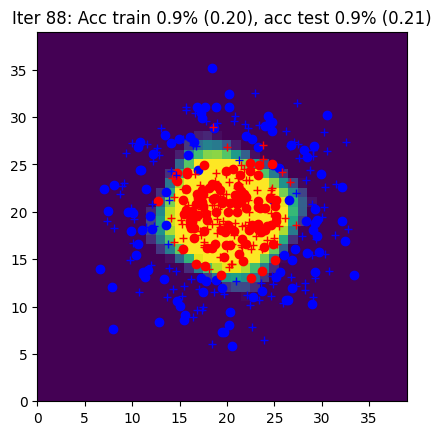

Iter 89: Acc train 0.9% (0.20), acc test 0.9% (0.20)


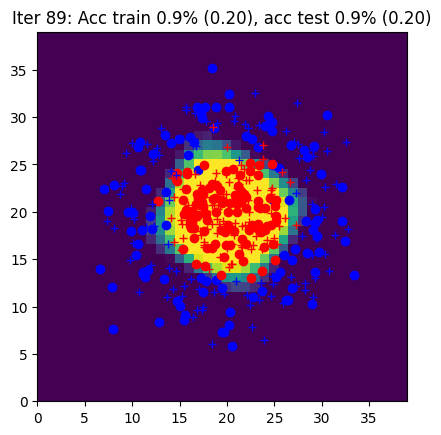

Iter 90: Acc train 0.9% (0.20), acc test 0.9% (0.20)


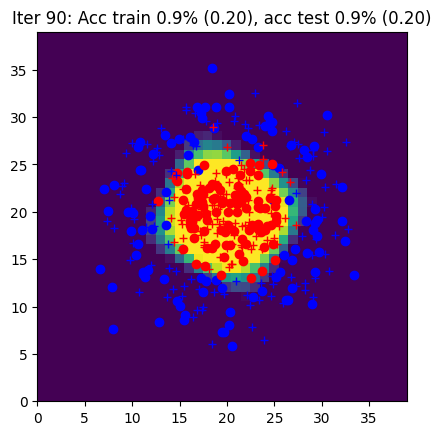

Iter 91: Acc train 0.9% (0.20), acc test 0.9% (0.20)


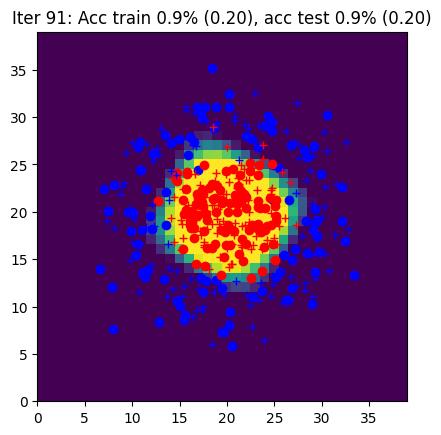

Iter 92: Acc train 0.9% (0.19), acc test 0.9% (0.20)


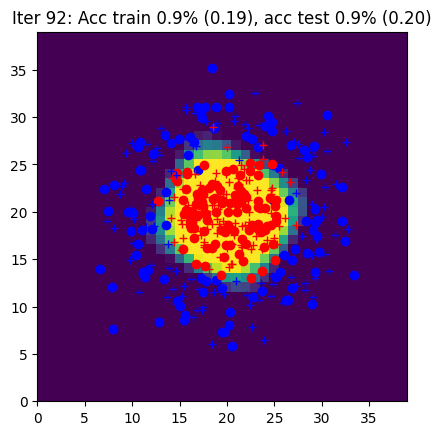

Iter 93: Acc train 0.9% (0.19), acc test 0.9% (0.20)


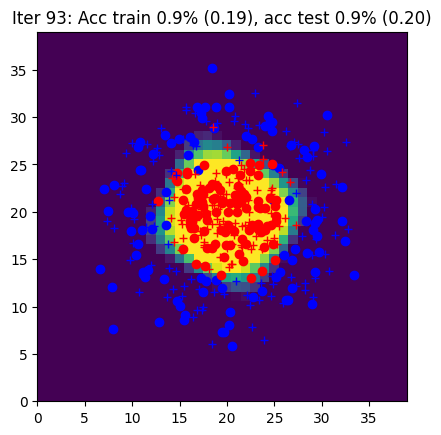

Iter 94: Acc train 0.9% (0.19), acc test 0.9% (0.20)


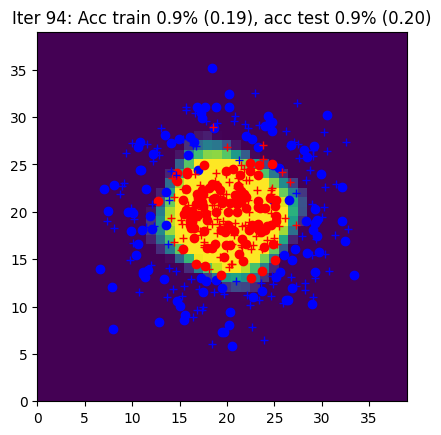

Iter 95: Acc train 0.9% (0.19), acc test 0.9% (0.20)


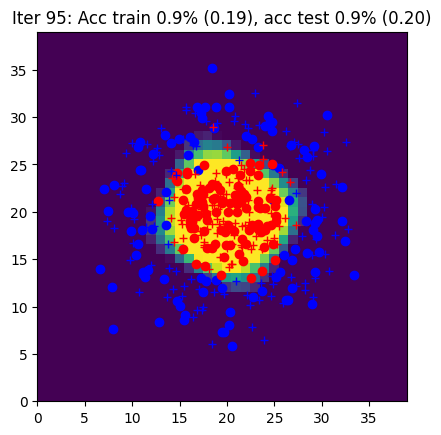

Iter 96: Acc train 1.0% (0.19), acc test 0.9% (0.20)


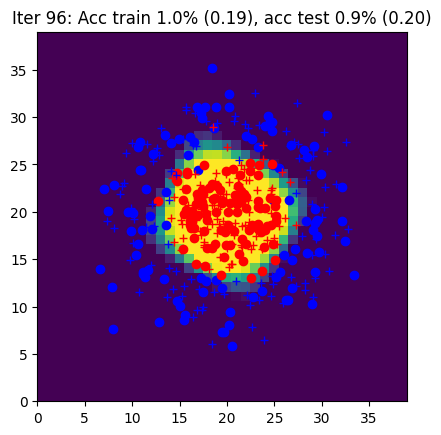

Iter 97: Acc train 0.9% (0.19), acc test 0.9% (0.20)


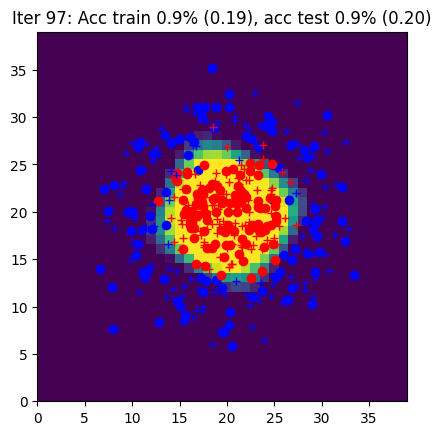

Iter 98: Acc train 0.9% (0.19), acc test 0.9% (0.20)


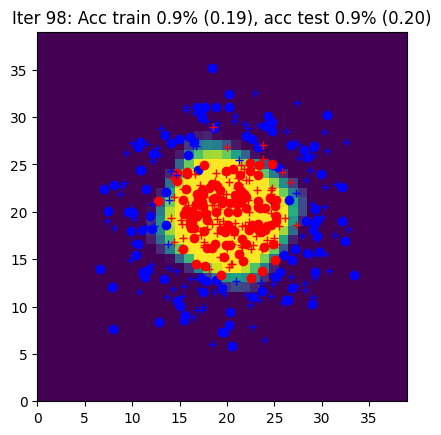

Iter 99: Acc train 0.9% (0.19), acc test 0.9% (0.20)


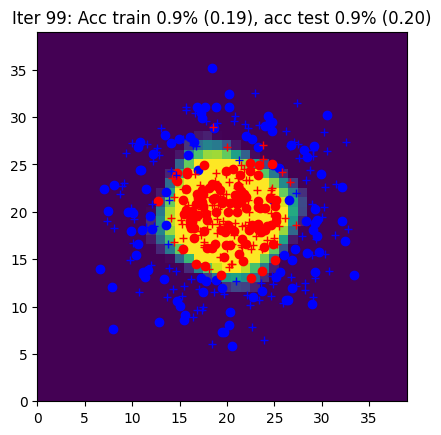

Iter 100: Acc train 0.9% (0.19), acc test 0.9% (0.19)


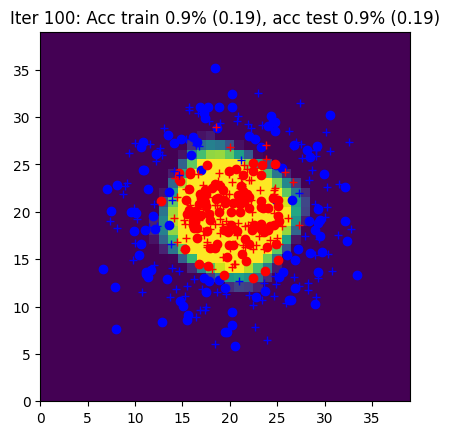

Iter 101: Acc train 0.9% (0.19), acc test 0.9% (0.19)


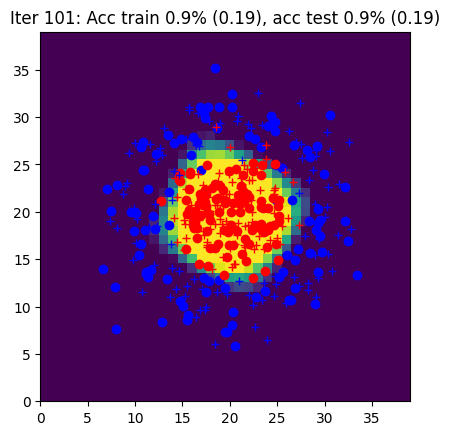

Iter 102: Acc train 0.9% (0.18), acc test 0.9% (0.19)


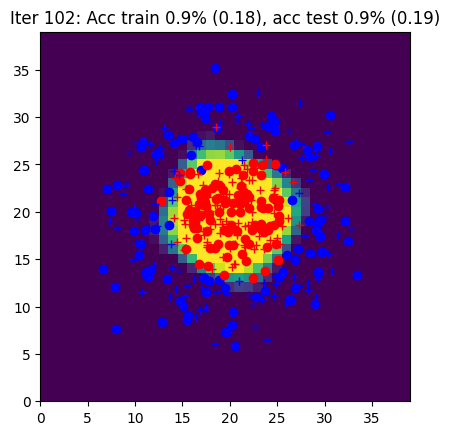

Iter 103: Acc train 0.9% (0.18), acc test 0.9% (0.19)


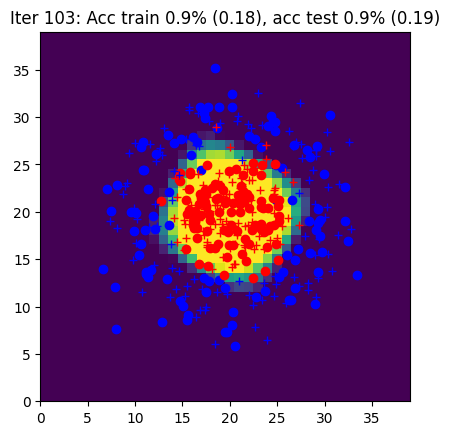

Iter 104: Acc train 0.9% (0.18), acc test 0.9% (0.19)


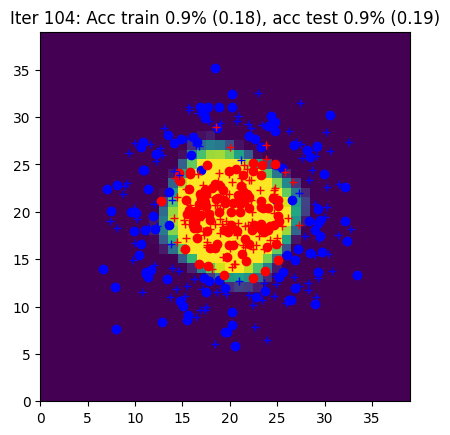

Iter 105: Acc train 1.0% (0.18), acc test 0.9% (0.19)


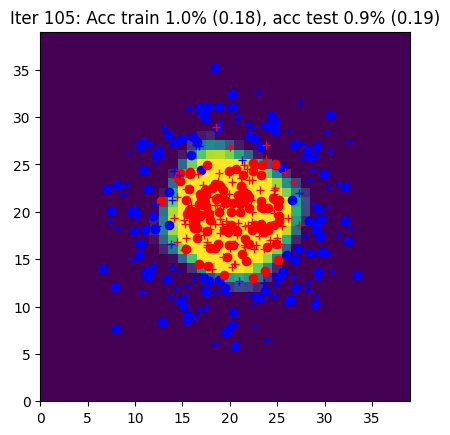

Iter 106: Acc train 1.0% (0.18), acc test 0.9% (0.19)


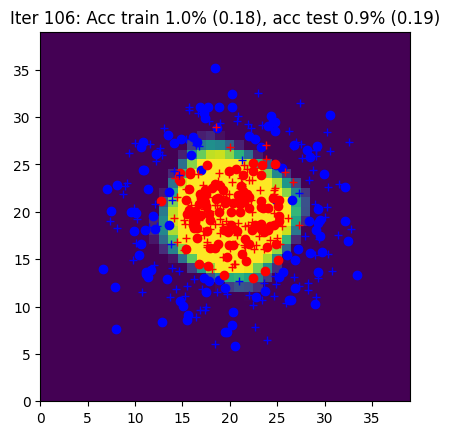

Iter 107: Acc train 1.0% (0.18), acc test 0.9% (0.19)


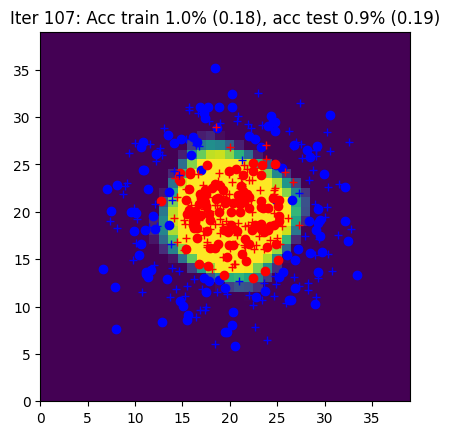

Iter 108: Acc train 0.9% (0.18), acc test 0.9% (0.19)


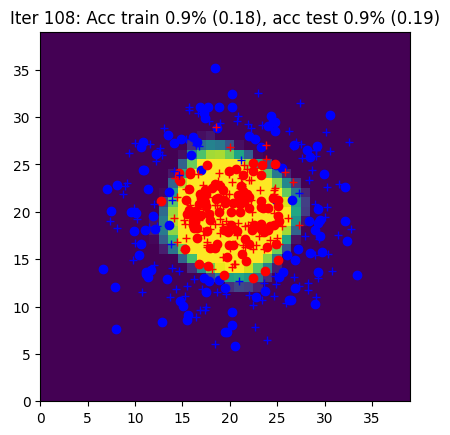

Iter 109: Acc train 1.0% (0.18), acc test 0.9% (0.19)


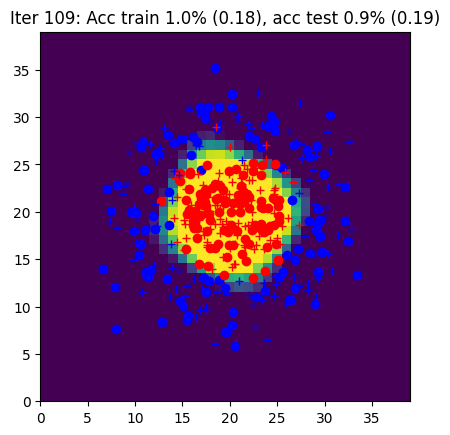

Iter 110: Acc train 0.9% (0.18), acc test 0.9% (0.19)


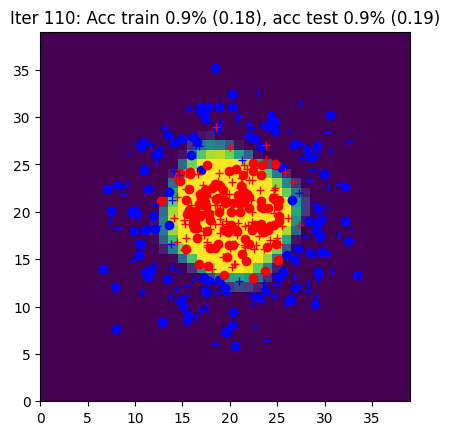

Iter 111: Acc train 0.9% (0.18), acc test 0.9% (0.19)


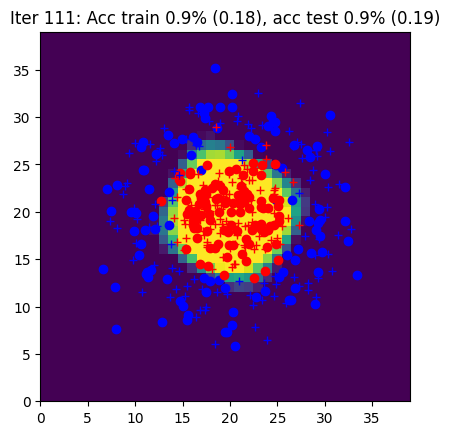

Iter 112: Acc train 1.0% (0.18), acc test 0.9% (0.18)


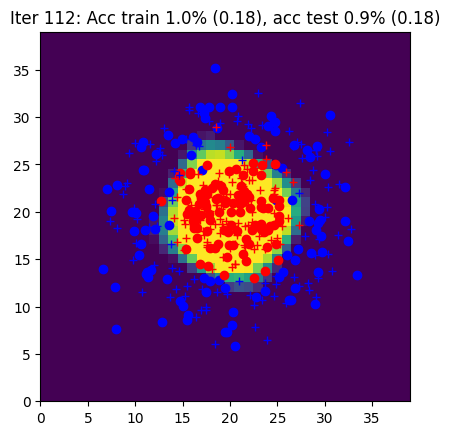

Iter 113: Acc train 1.0% (0.18), acc test 0.9% (0.18)


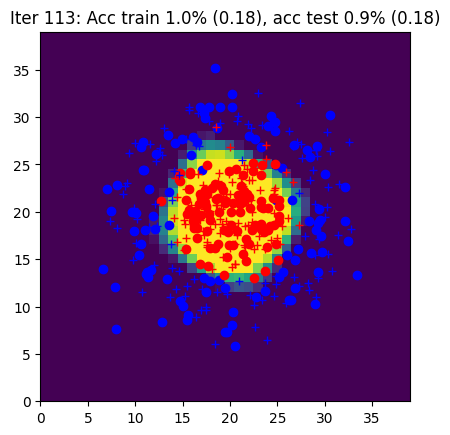

Iter 114: Acc train 1.0% (0.18), acc test 0.9% (0.18)


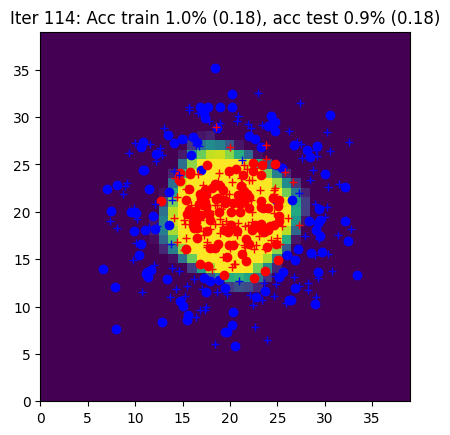

Iter 115: Acc train 1.0% (0.17), acc test 0.9% (0.18)


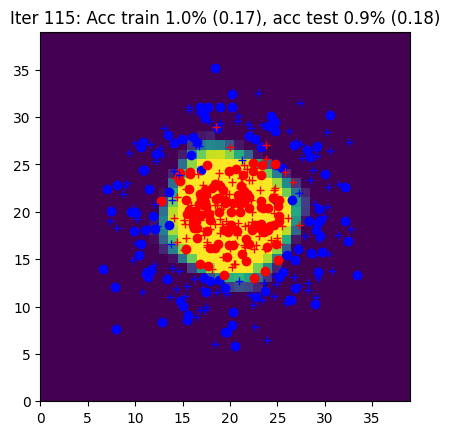

Iter 116: Acc train 1.0% (0.17), acc test 0.9% (0.18)


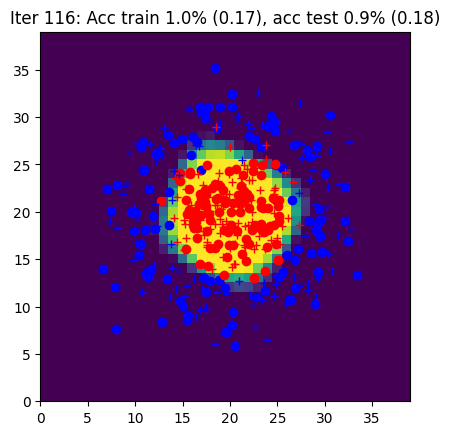

Iter 117: Acc train 1.0% (0.17), acc test 0.9% (0.18)


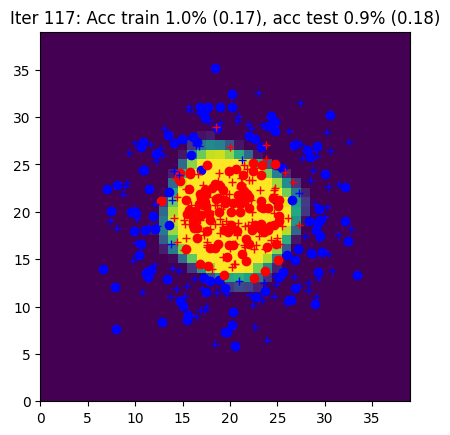

Iter 118: Acc train 1.0% (0.17), acc test 0.9% (0.18)


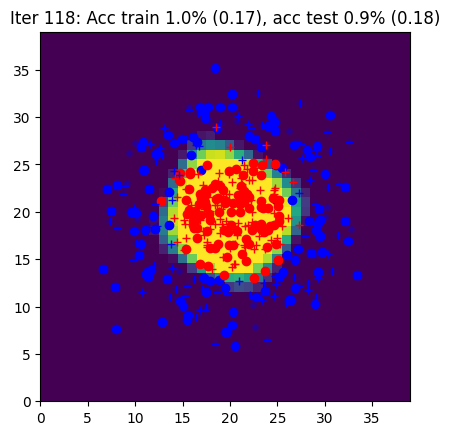

Iter 119: Acc train 1.0% (0.17), acc test 0.9% (0.18)


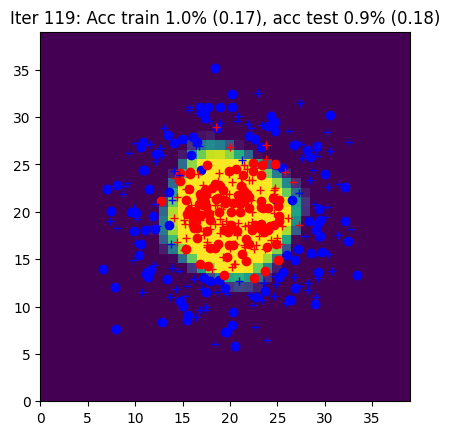

Iter 120: Acc train 1.0% (0.17), acc test 0.9% (0.18)


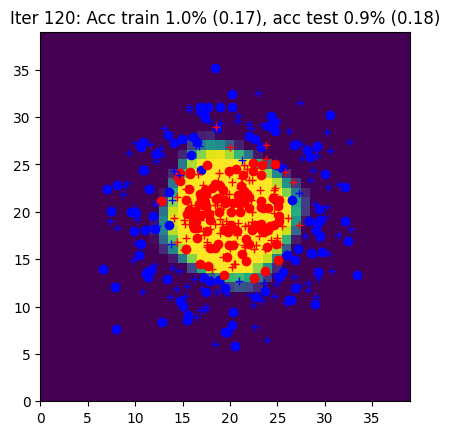

Iter 121: Acc train 0.9% (0.17), acc test 0.9% (0.18)


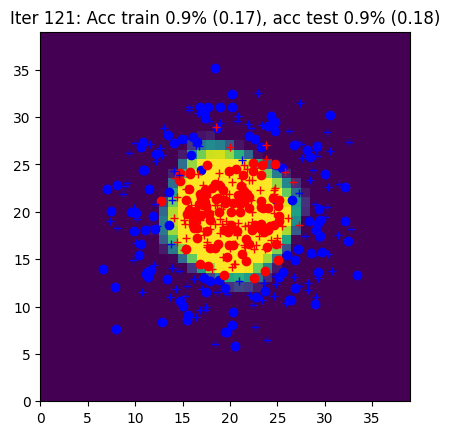

Iter 122: Acc train 1.0% (0.17), acc test 0.9% (0.18)


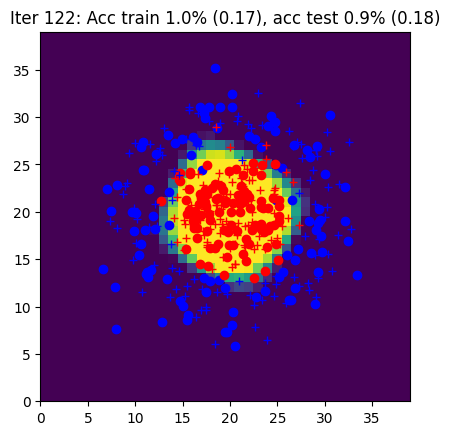

Iter 123: Acc train 1.0% (0.17), acc test 0.9% (0.18)


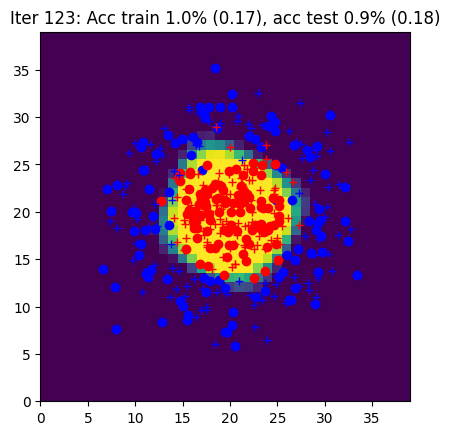

Iter 124: Acc train 1.0% (0.17), acc test 0.9% (0.18)


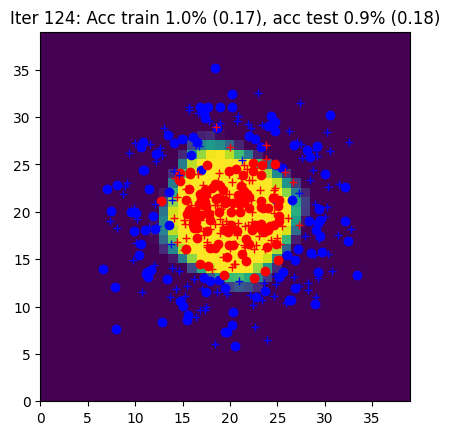

Iter 125: Acc train 0.9% (0.17), acc test 0.9% (0.18)


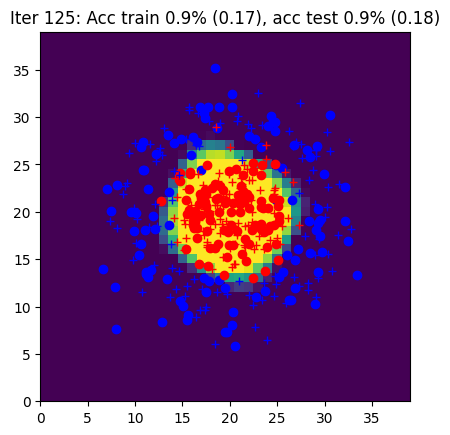

Iter 126: Acc train 0.9% (0.17), acc test 0.9% (0.18)


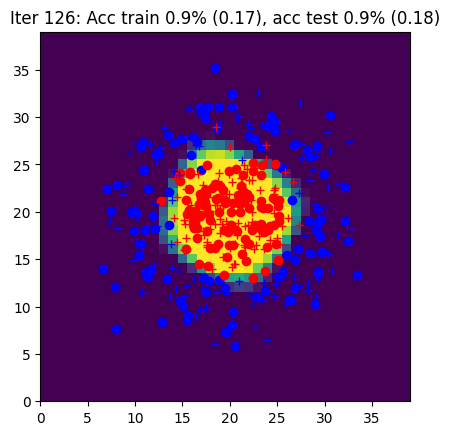

Iter 127: Acc train 0.9% (0.17), acc test 0.9% (0.18)


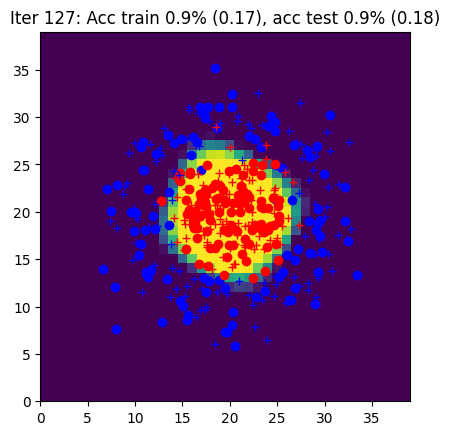

Iter 128: Acc train 0.9% (0.17), acc test 0.9% (0.18)


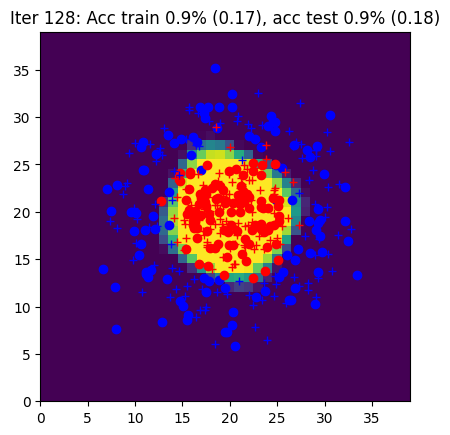

Iter 129: Acc train 0.9% (0.17), acc test 0.9% (0.18)


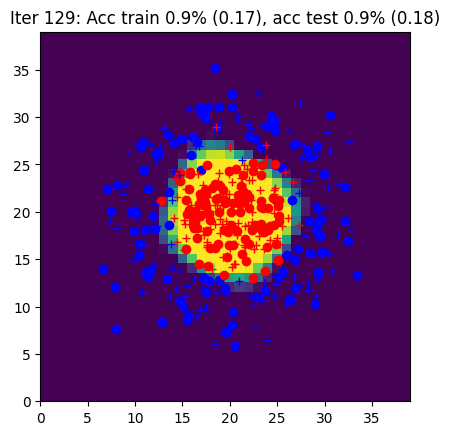

Iter 130: Acc train 0.9% (0.17), acc test 0.9% (0.18)


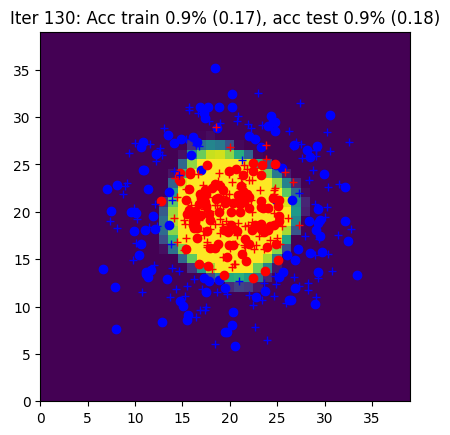

Iter 131: Acc train 1.0% (0.16), acc test 0.9% (0.17)


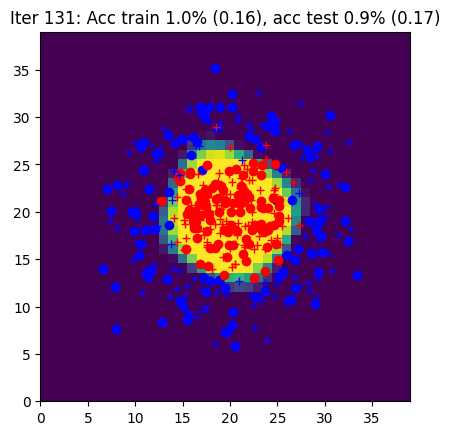

Iter 132: Acc train 1.0% (0.16), acc test 0.9% (0.17)


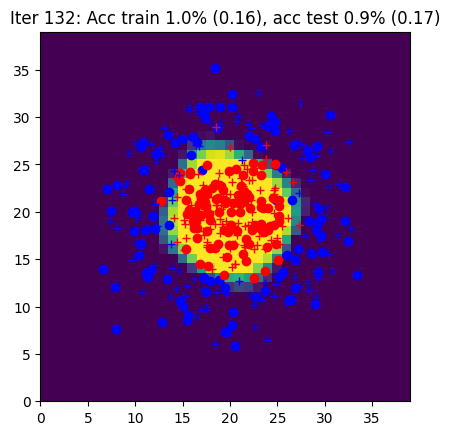

Iter 133: Acc train 1.0% (0.16), acc test 0.9% (0.17)


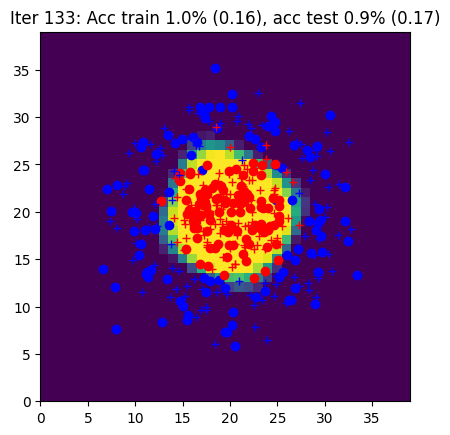

Iter 134: Acc train 1.0% (0.16), acc test 0.9% (0.17)


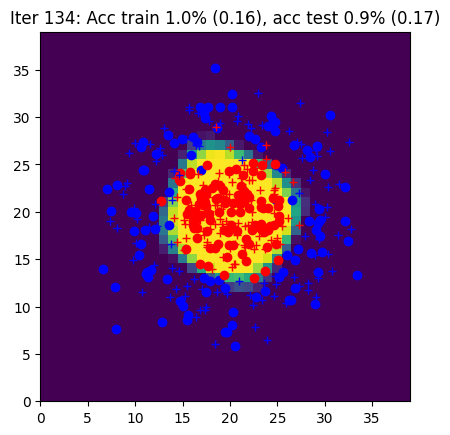

Iter 135: Acc train 1.0% (0.16), acc test 0.9% (0.17)


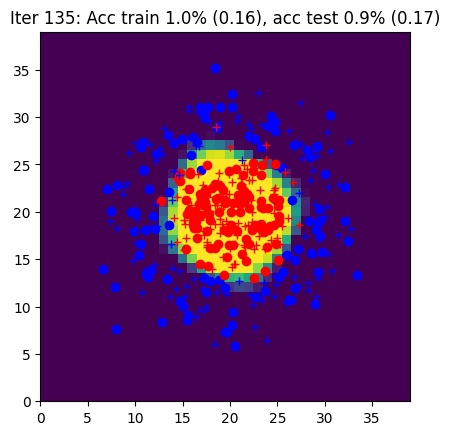

Iter 136: Acc train 1.0% (0.16), acc test 0.9% (0.17)


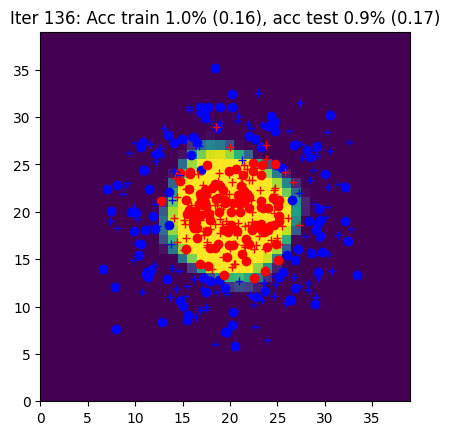

Iter 137: Acc train 1.0% (0.16), acc test 0.9% (0.17)


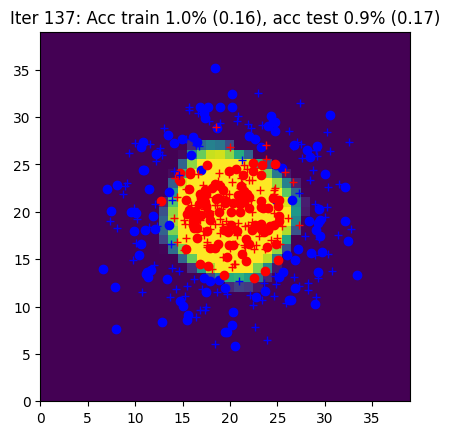

Iter 138: Acc train 1.0% (0.16), acc test 0.9% (0.17)


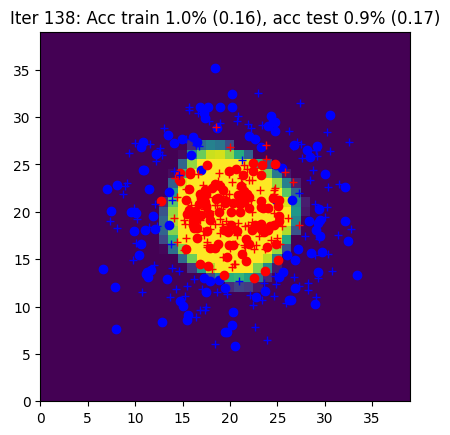

Iter 139: Acc train 1.0% (0.16), acc test 0.9% (0.17)


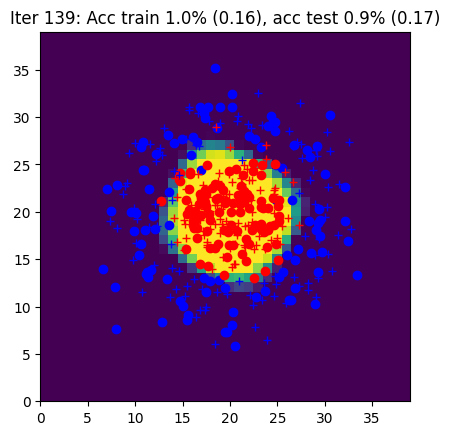

Iter 140: Acc train 1.0% (0.16), acc test 0.9% (0.17)


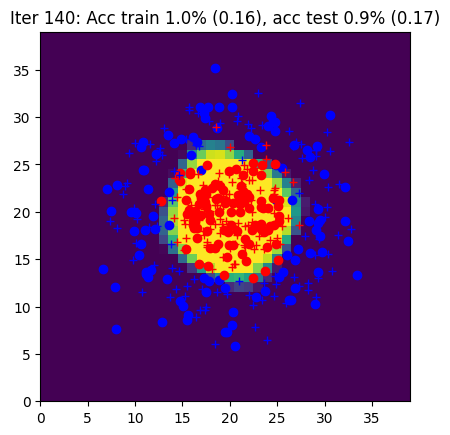

Iter 141: Acc train 1.0% (0.16), acc test 0.9% (0.17)


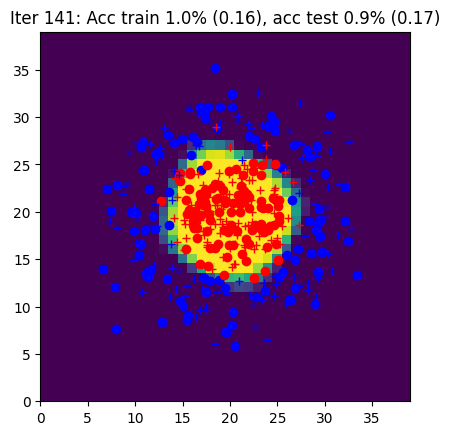

Iter 142: Acc train 1.0% (0.16), acc test 0.9% (0.17)


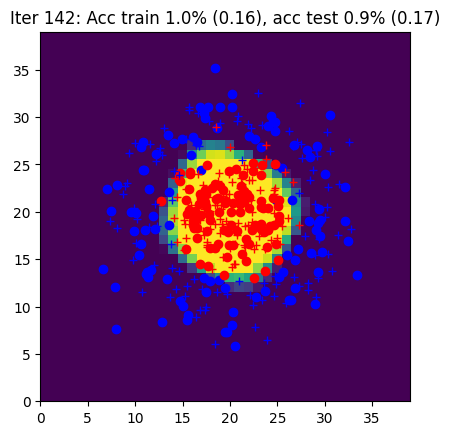

Iter 143: Acc train 1.0% (0.16), acc test 0.9% (0.17)


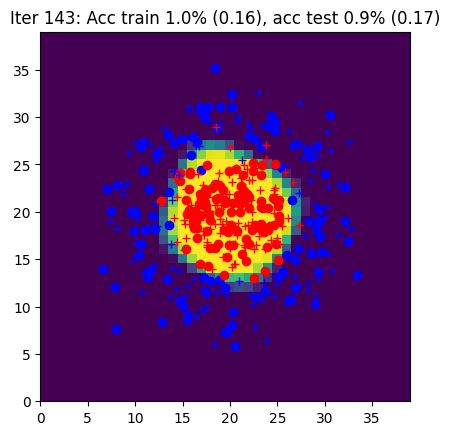

Iter 144: Acc train 1.0% (0.16), acc test 0.9% (0.17)


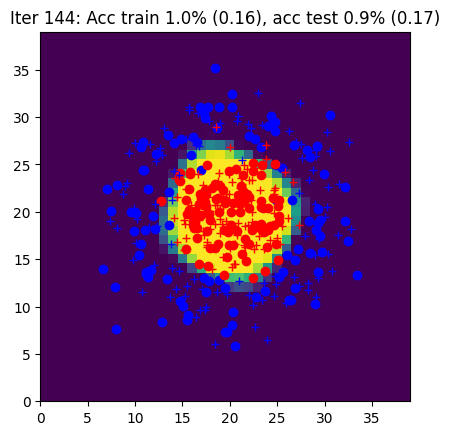

Iter 145: Acc train 1.0% (0.16), acc test 0.9% (0.17)


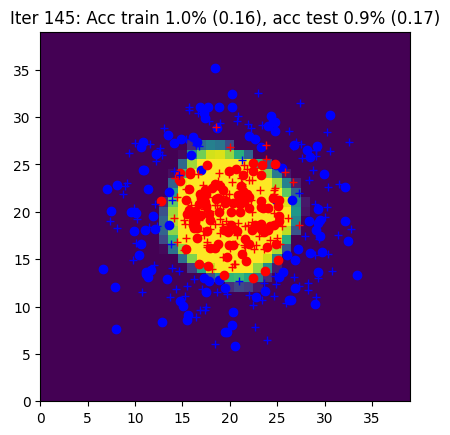

Iter 146: Acc train 1.0% (0.16), acc test 0.9% (0.17)


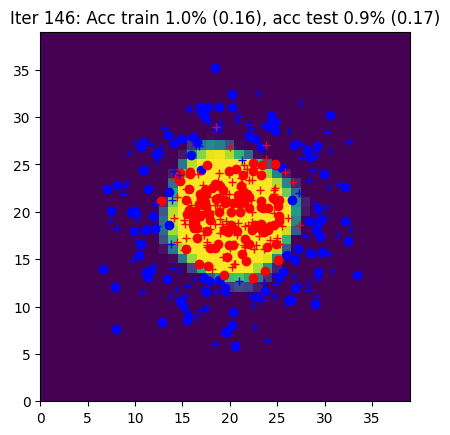

Iter 147: Acc train 1.0% (0.16), acc test 0.9% (0.17)


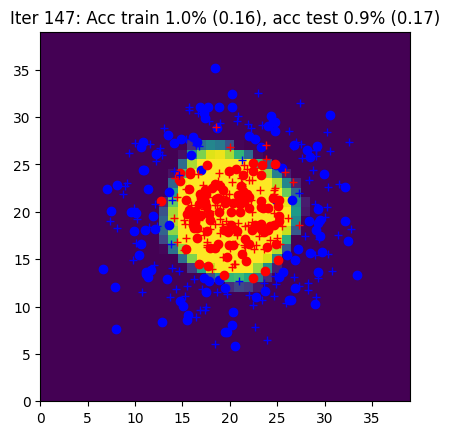

Iter 148: Acc train 1.0% (0.16), acc test 0.9% (0.17)


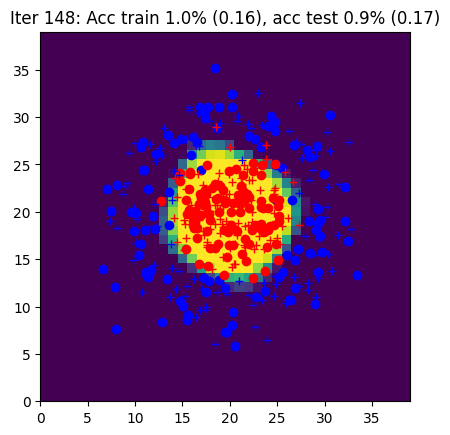

Iter 149: Acc train 1.0% (0.16), acc test 0.9% (0.17)


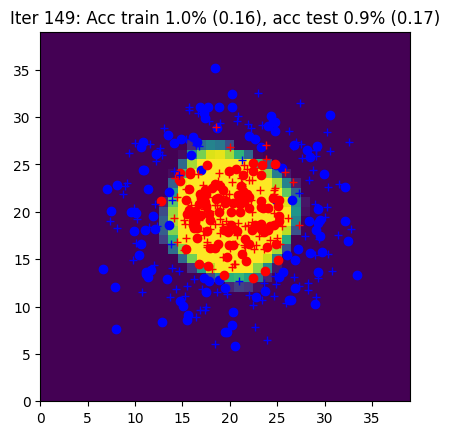

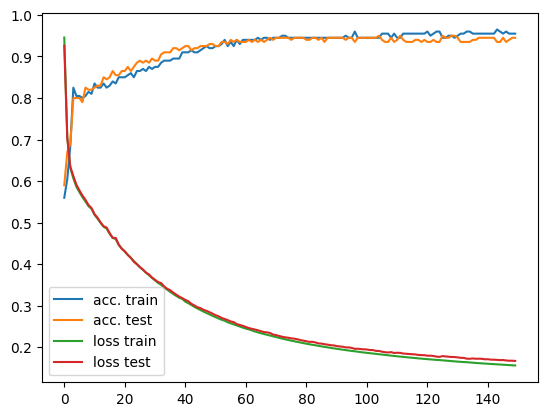

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, sgd
        # and the backward function with autograd

        Yhat, outputs = forward(params, X)
        L, acc = loss_accuracy(Yhat, Y)
        L.backward()
        params = sgd(params, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() is used to remove the predictions from the computational graph in autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.item())
    curves[3].append(Ltest.item())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

!!!! REMARK : here i used the cross entropy loss but it supposed y to be an index. That's why i dont use loss(Yhat, Y) in the following, but a modified version for it to work

In [ ]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )
    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      END        #
    ####################

    return model, loss

In [ ]:
def loss_accuracy(loss, Yhat, Y):

    #####################
    ## Your code here  ##
    #####################
    # call the loss function

    L = loss(Yhat, torch.argmax(Y, dim=1))
    Yhatpred = torch.argmax(Yhat, dim=1)
    Ytrue = torch.argmax(Y, dim=1)
    acc = torch.mean((Yhatpred == Ytrue).float())

    ####################
    ##      END        #
    ####################

    return L, acc

In [ ]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators

    with torch.no_grad():
        for p in model.parameters():
            p -= eta * p.grad
    model.zero_grad()

    ####################
    ##      END        #
    ####################
    return model

## Global learning procedure with autograd and `torch.nn`

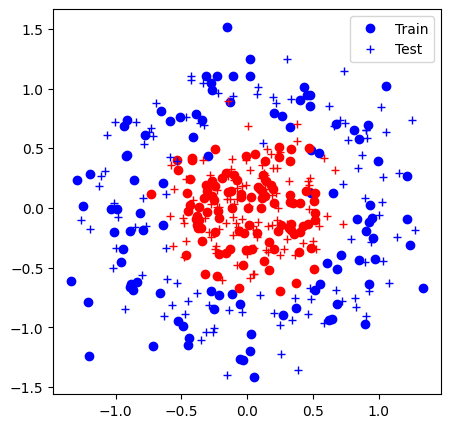

Iter 0: Acc train 0.5% (0.70), acc test 0.5% (0.71)


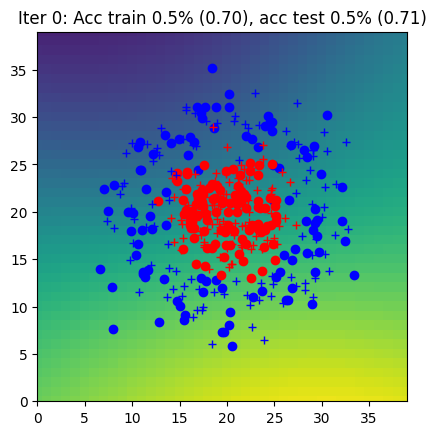

Iter 1: Acc train 0.5% (0.70), acc test 0.6% (0.70)


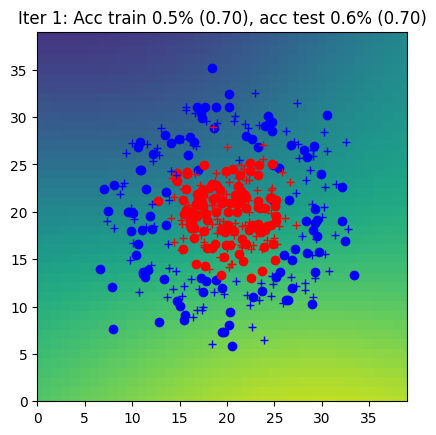

Iter 2: Acc train 0.6% (0.70), acc test 0.6% (0.70)


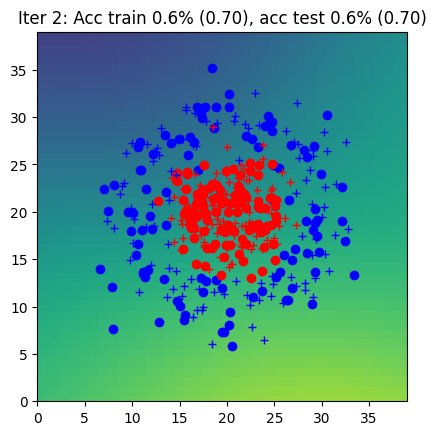

Iter 3: Acc train 0.6% (0.70), acc test 0.6% (0.70)


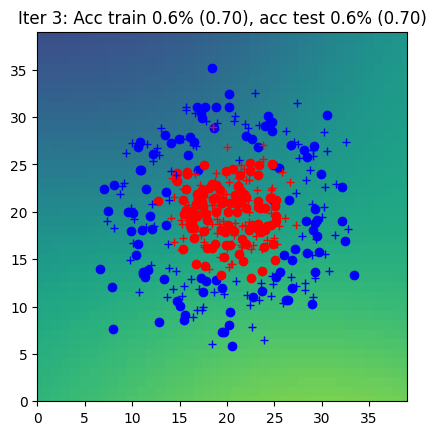

Iter 4: Acc train 0.6% (0.70), acc test 0.6% (0.70)


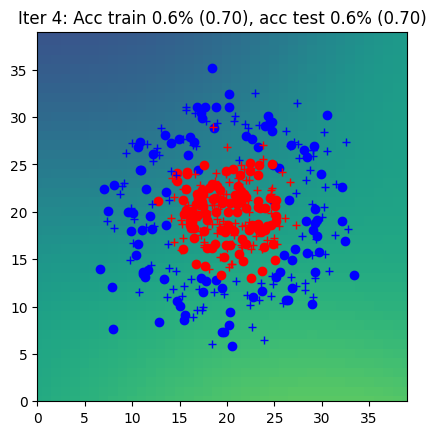

Iter 5: Acc train 0.5% (0.69), acc test 0.5% (0.70)


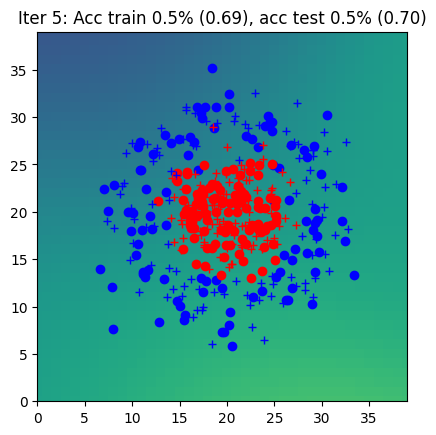

Iter 6: Acc train 0.6% (0.69), acc test 0.6% (0.69)


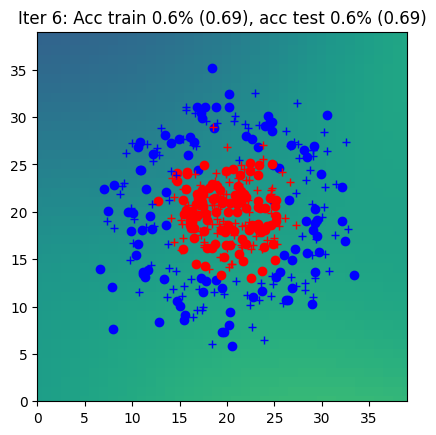

Iter 7: Acc train 0.6% (0.69), acc test 0.6% (0.69)


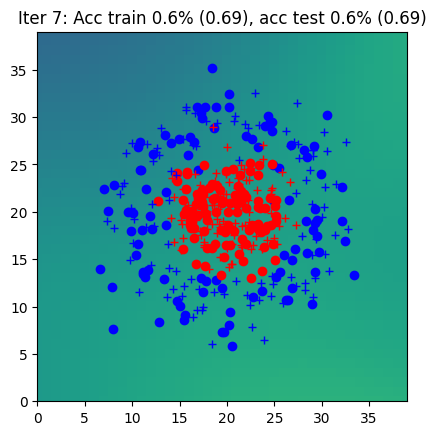

Iter 8: Acc train 0.6% (0.69), acc test 0.6% (0.69)


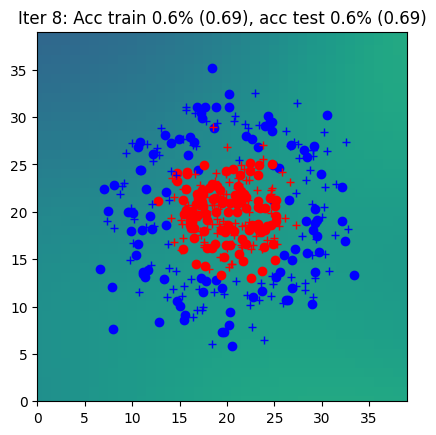

Iter 9: Acc train 0.6% (0.69), acc test 0.6% (0.69)


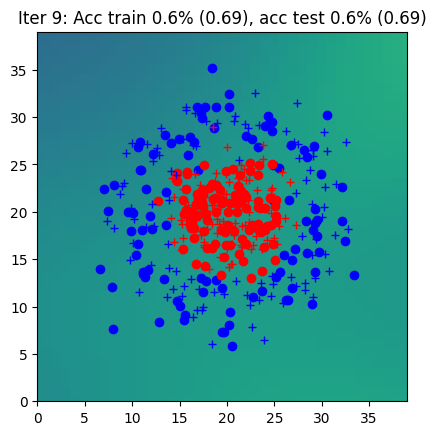

Iter 10: Acc train 0.6% (0.69), acc test 0.6% (0.69)


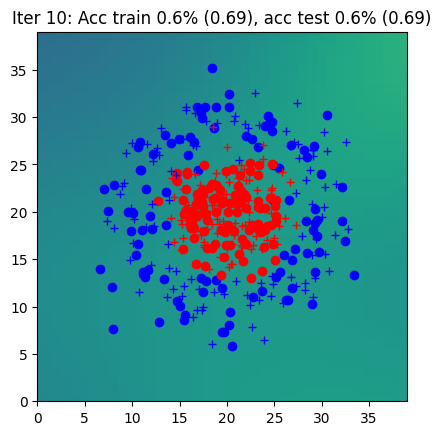

Iter 11: Acc train 0.6% (0.69), acc test 0.6% (0.69)


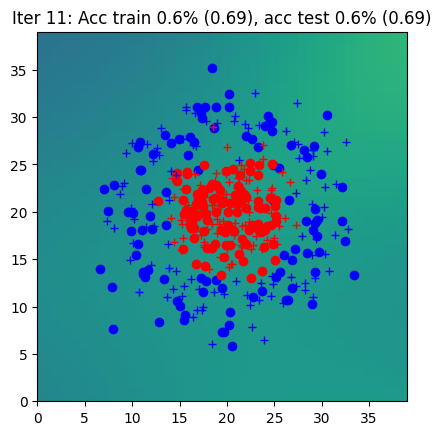

Iter 12: Acc train 0.5% (0.69), acc test 0.5% (0.69)


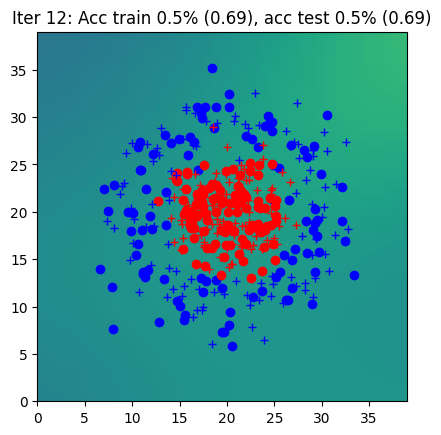

Iter 13: Acc train 0.6% (0.69), acc test 0.6% (0.69)


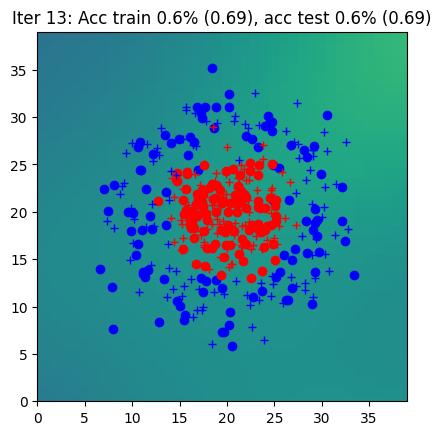

Iter 14: Acc train 0.6% (0.69), acc test 0.6% (0.69)


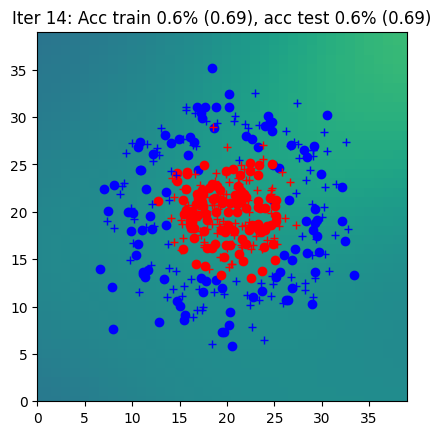

Iter 15: Acc train 0.7% (0.69), acc test 0.7% (0.69)


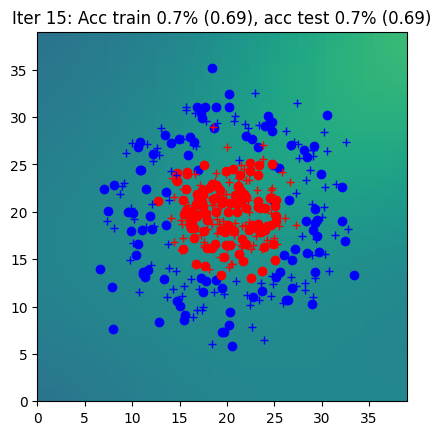

Iter 16: Acc train 0.7% (0.69), acc test 0.7% (0.69)


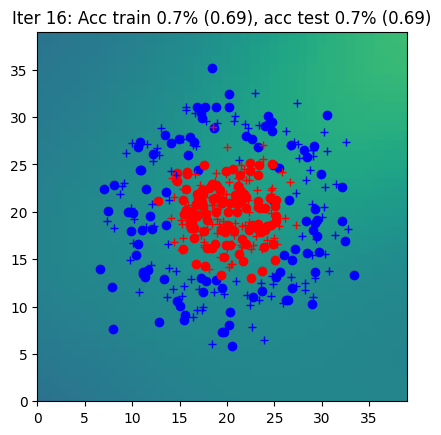

Iter 17: Acc train 0.7% (0.69), acc test 0.8% (0.69)


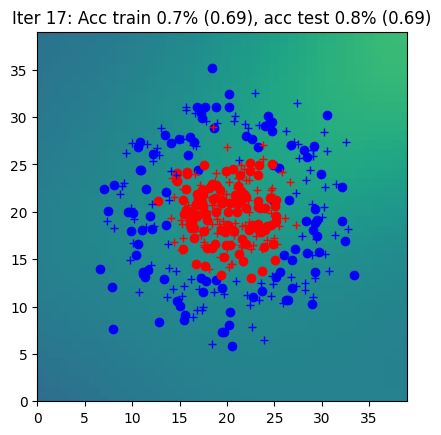

Iter 18: Acc train 0.7% (0.68), acc test 0.8% (0.69)


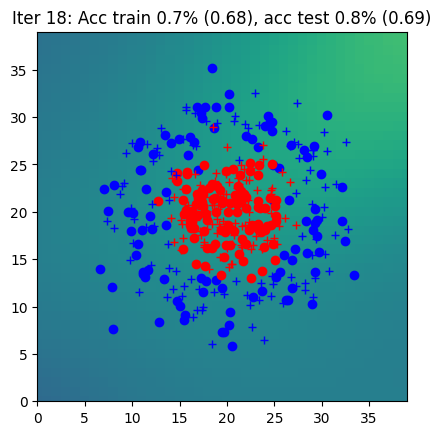

Iter 19: Acc train 0.7% (0.68), acc test 0.7% (0.68)


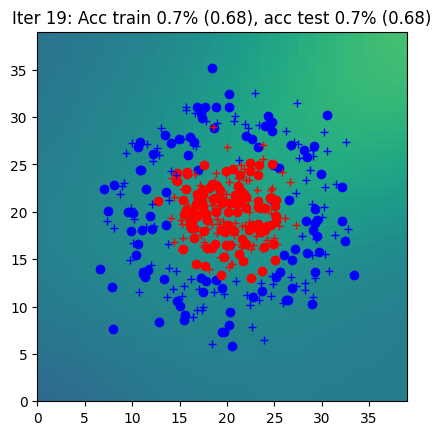

Iter 20: Acc train 0.7% (0.68), acc test 0.8% (0.68)


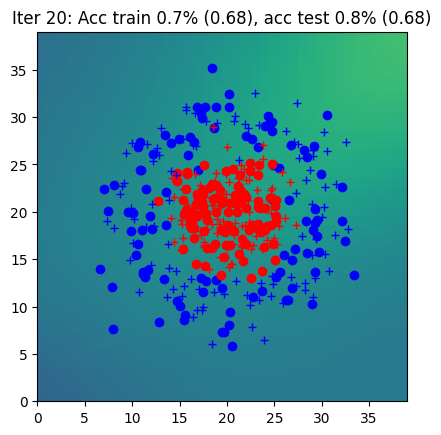

Iter 21: Acc train 0.7% (0.68), acc test 0.8% (0.68)


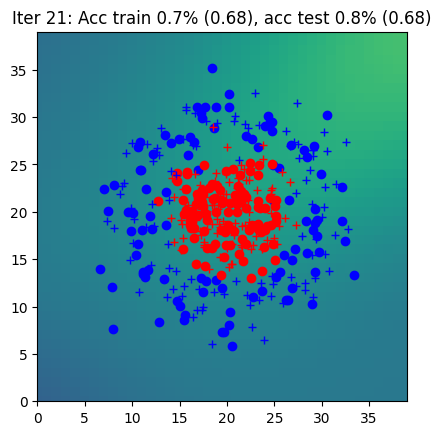

Iter 22: Acc train 0.7% (0.68), acc test 0.8% (0.68)


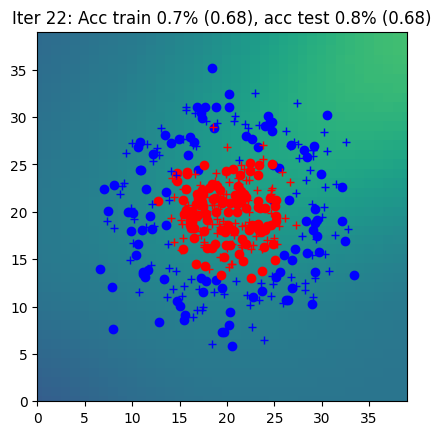

Iter 23: Acc train 0.7% (0.68), acc test 0.7% (0.68)


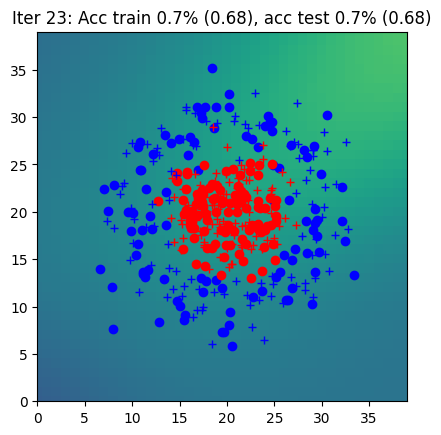

Iter 24: Acc train 0.7% (0.68), acc test 0.8% (0.68)


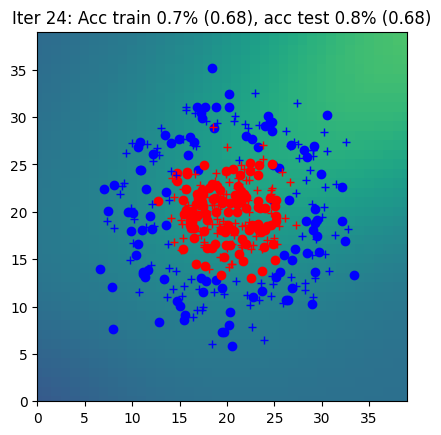

Iter 25: Acc train 0.7% (0.68), acc test 0.8% (0.68)


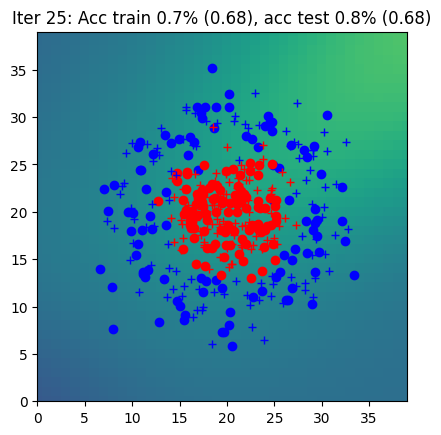

Iter 26: Acc train 0.7% (0.68), acc test 0.8% (0.68)


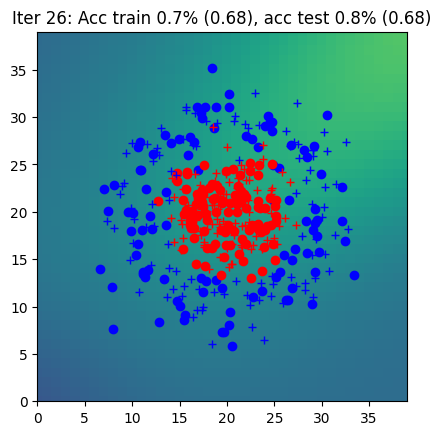

Iter 27: Acc train 0.7% (0.68), acc test 0.7% (0.68)


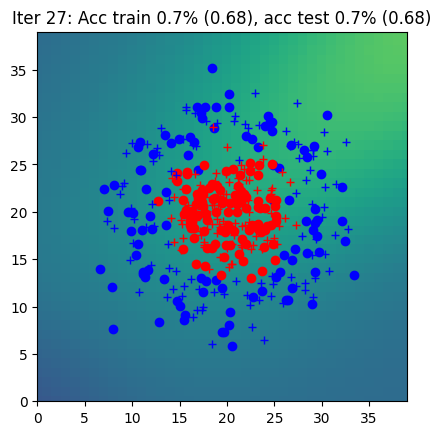

Iter 28: Acc train 0.7% (0.68), acc test 0.8% (0.68)


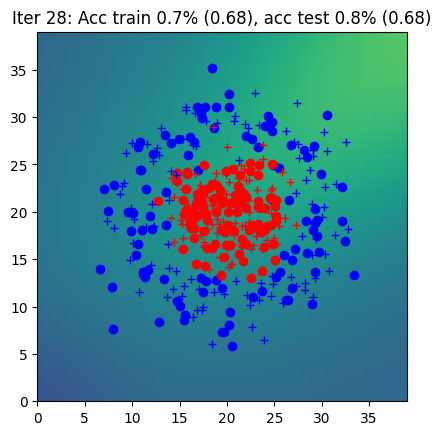

Iter 29: Acc train 0.7% (0.68), acc test 0.8% (0.68)


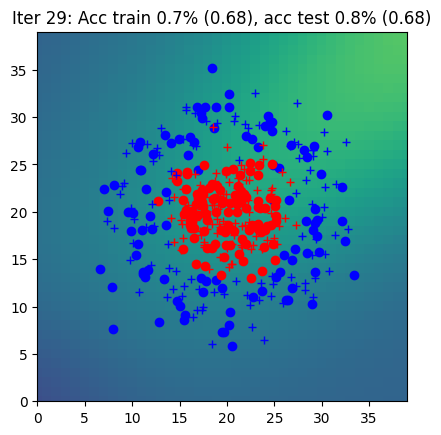

Iter 30: Acc train 0.7% (0.68), acc test 0.7% (0.68)


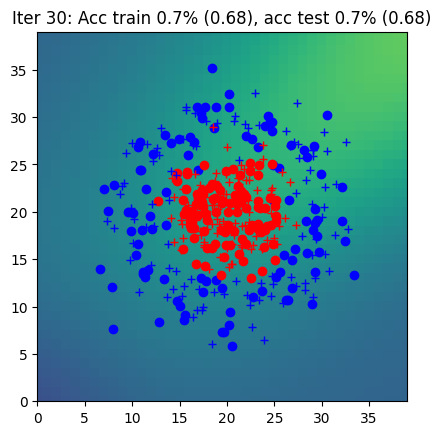

Iter 31: Acc train 0.7% (0.67), acc test 0.8% (0.68)


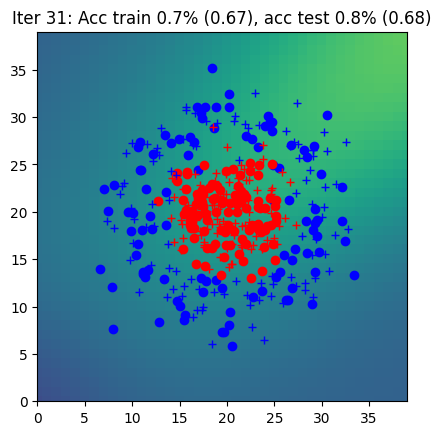

Iter 32: Acc train 0.8% (0.67), acc test 0.8% (0.67)


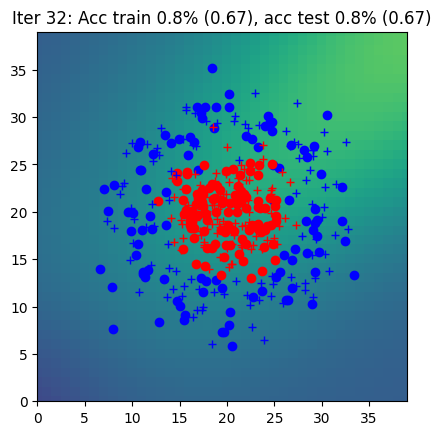

Iter 33: Acc train 0.8% (0.67), acc test 0.8% (0.67)


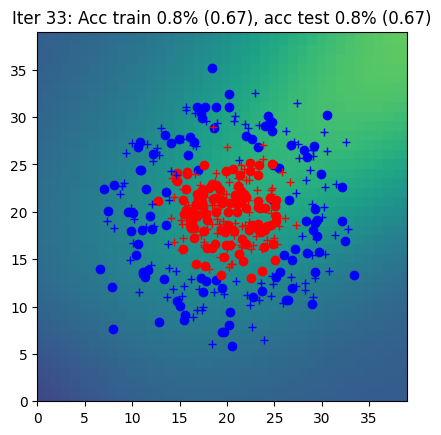

Iter 34: Acc train 0.8% (0.67), acc test 0.8% (0.67)


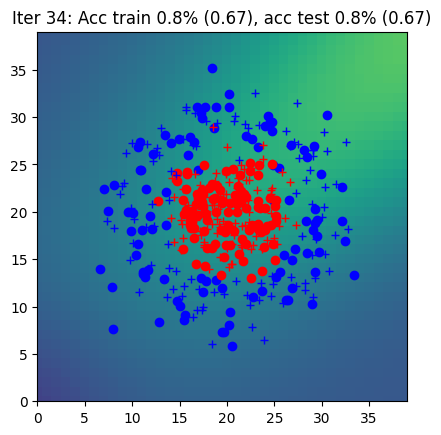

Iter 35: Acc train 0.8% (0.67), acc test 0.8% (0.67)


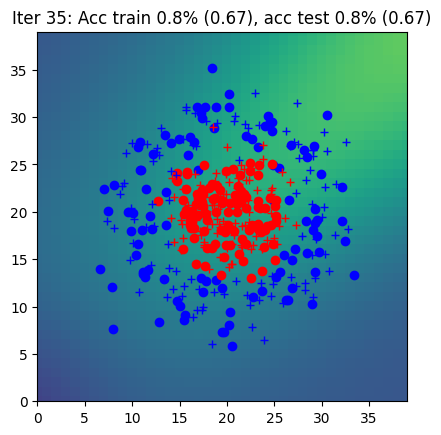

Iter 36: Acc train 0.8% (0.67), acc test 0.8% (0.67)


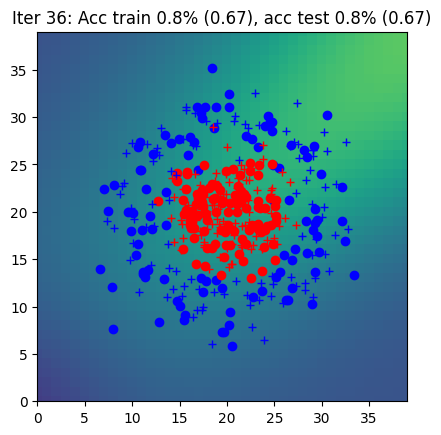

Iter 37: Acc train 0.8% (0.67), acc test 0.8% (0.67)


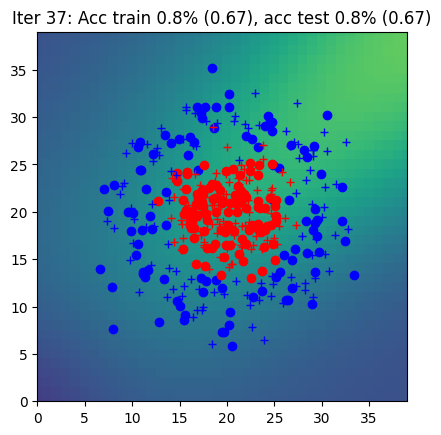

Iter 38: Acc train 0.8% (0.67), acc test 0.8% (0.67)


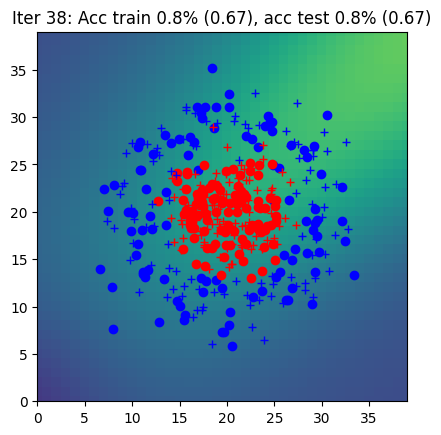

Iter 39: Acc train 0.8% (0.67), acc test 0.8% (0.67)


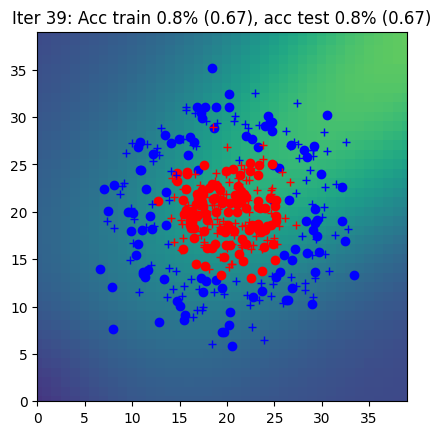

Iter 40: Acc train 0.8% (0.66), acc test 0.8% (0.66)


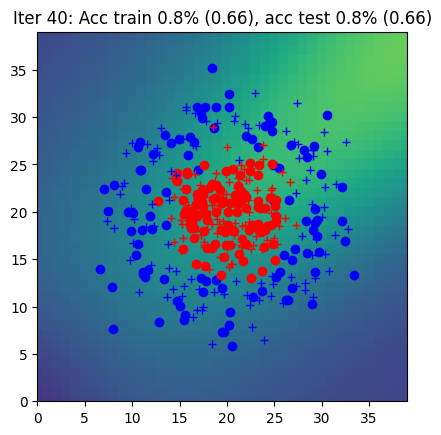

Iter 41: Acc train 0.8% (0.66), acc test 0.8% (0.66)


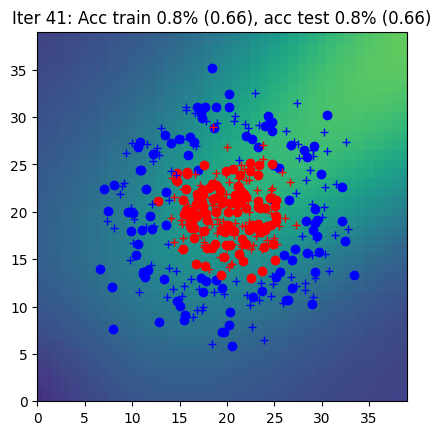

Iter 42: Acc train 0.8% (0.66), acc test 0.8% (0.66)


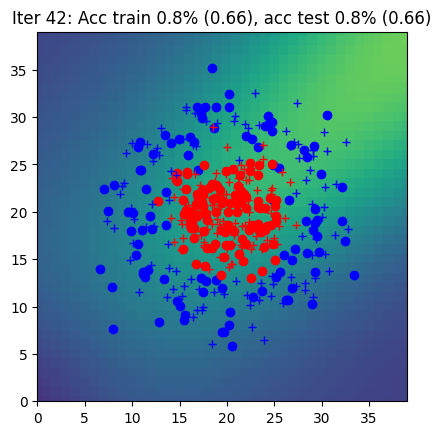

Iter 43: Acc train 0.8% (0.66), acc test 0.8% (0.66)


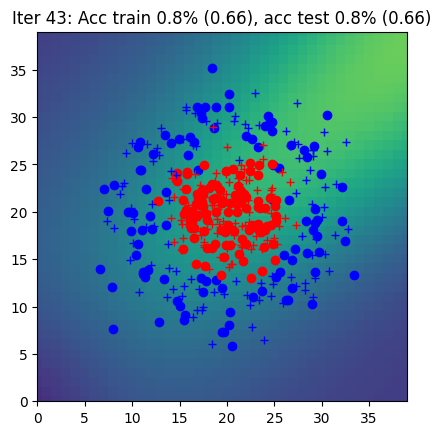

Iter 44: Acc train 0.8% (0.66), acc test 0.8% (0.66)


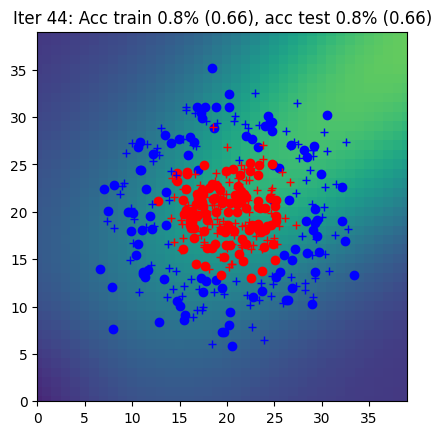

Iter 45: Acc train 0.8% (0.66), acc test 0.8% (0.66)


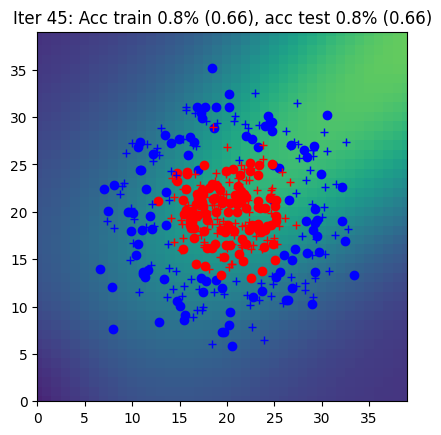

Iter 46: Acc train 0.8% (0.65), acc test 0.8% (0.65)


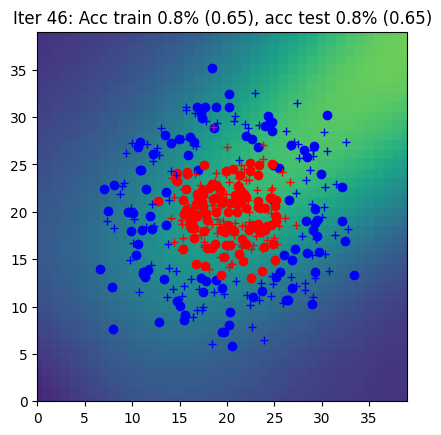

Iter 47: Acc train 0.8% (0.65), acc test 0.8% (0.65)


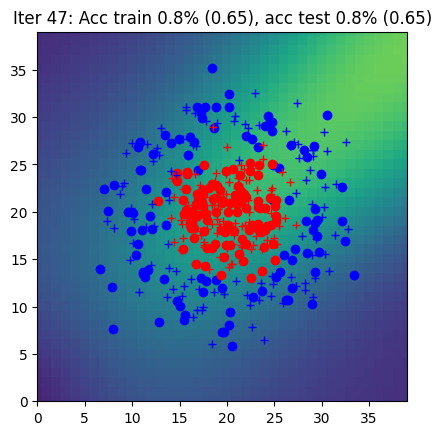

Iter 48: Acc train 0.8% (0.65), acc test 0.8% (0.65)


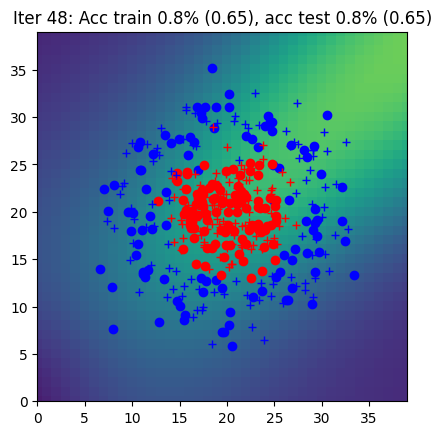

Iter 49: Acc train 0.8% (0.65), acc test 0.8% (0.65)


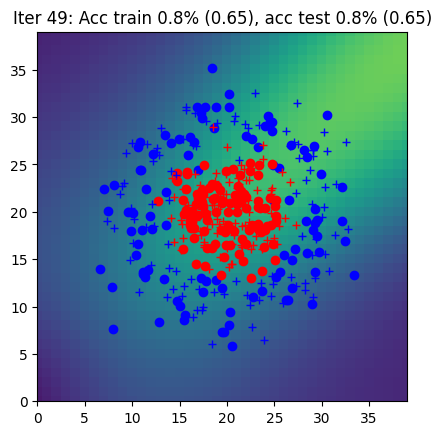

Iter 50: Acc train 0.8% (0.65), acc test 0.8% (0.65)


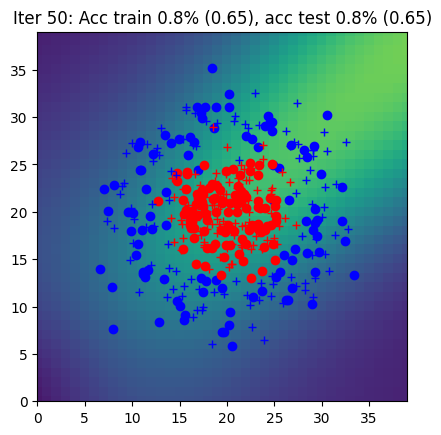

Iter 51: Acc train 0.8% (0.64), acc test 0.8% (0.64)


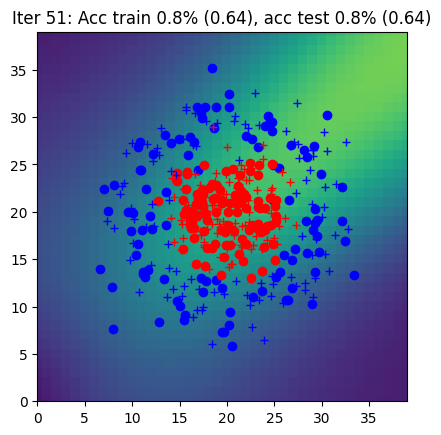

Iter 52: Acc train 0.8% (0.64), acc test 0.8% (0.64)


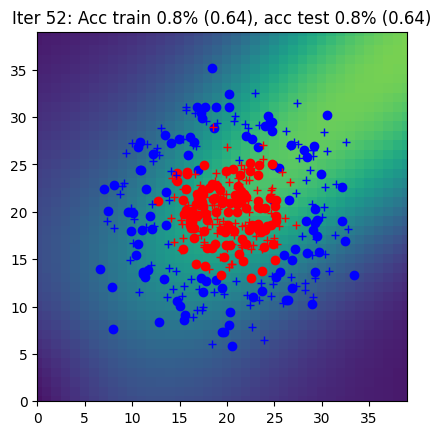

Iter 53: Acc train 0.8% (0.64), acc test 0.8% (0.64)


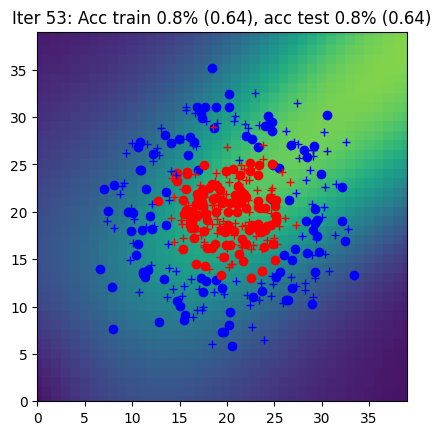

Iter 54: Acc train 0.8% (0.64), acc test 0.8% (0.64)


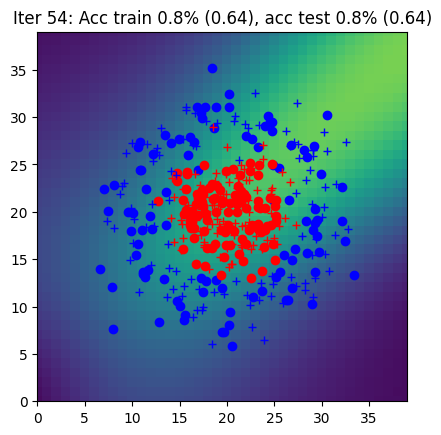

Iter 55: Acc train 0.8% (0.63), acc test 0.8% (0.64)


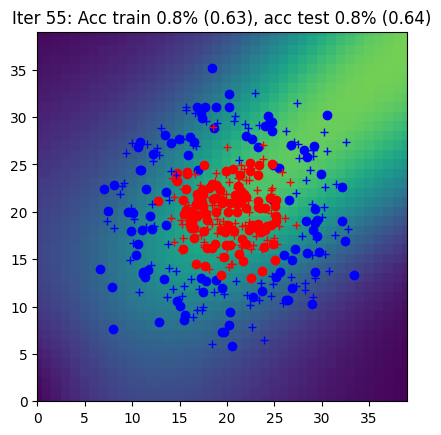

Iter 56: Acc train 0.8% (0.63), acc test 0.8% (0.63)


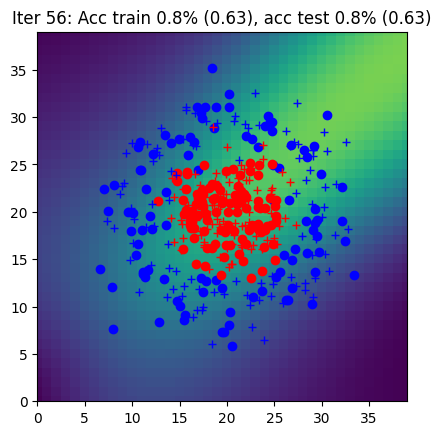

Iter 57: Acc train 0.8% (0.63), acc test 0.8% (0.63)


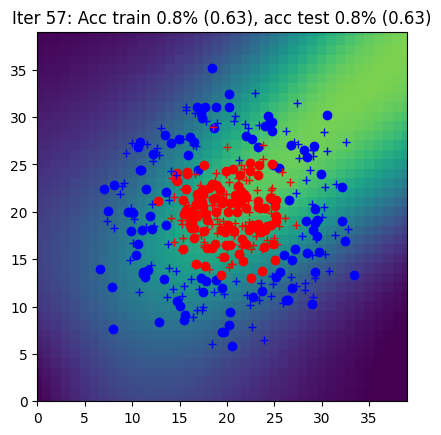

Iter 58: Acc train 0.8% (0.63), acc test 0.8% (0.63)


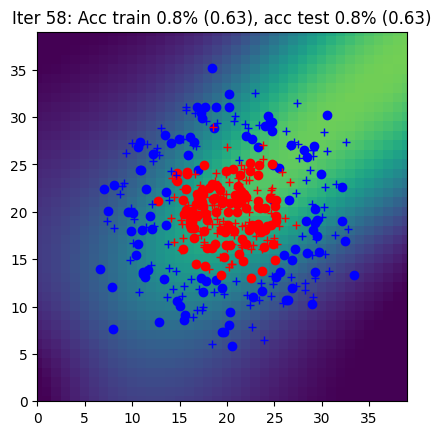

Iter 59: Acc train 0.8% (0.62), acc test 0.8% (0.62)


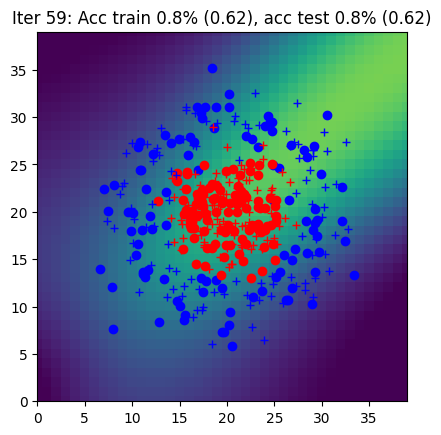

Iter 60: Acc train 0.8% (0.62), acc test 0.8% (0.62)


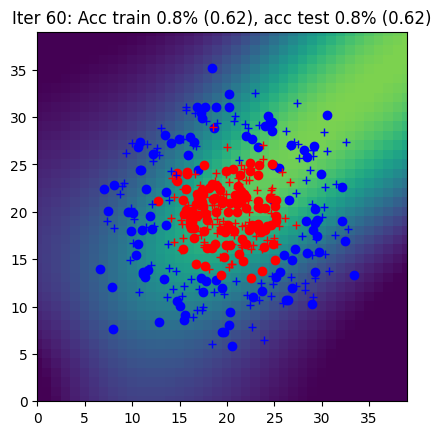

Iter 61: Acc train 0.8% (0.62), acc test 0.8% (0.62)


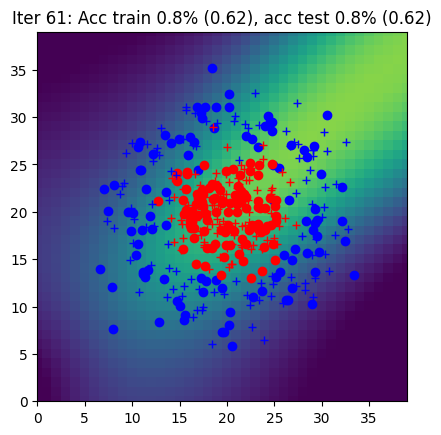

Iter 62: Acc train 0.8% (0.61), acc test 0.8% (0.61)


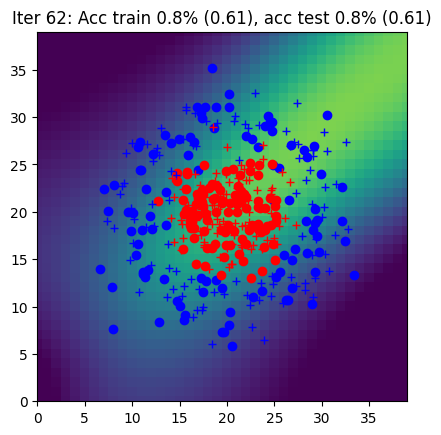

Iter 63: Acc train 0.8% (0.61), acc test 0.8% (0.61)


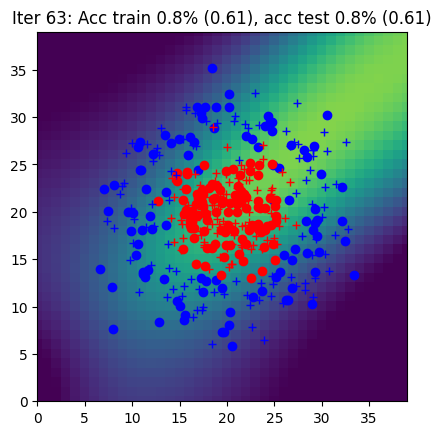

Iter 64: Acc train 0.8% (0.61), acc test 0.8% (0.61)


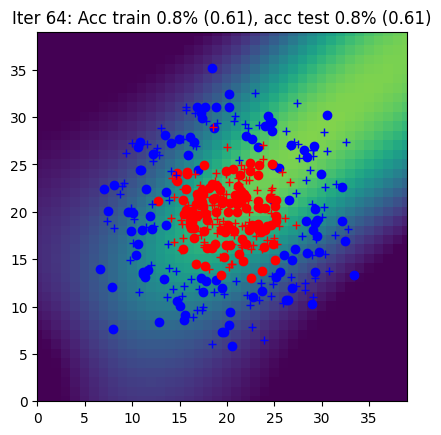

Iter 65: Acc train 0.8% (0.60), acc test 0.8% (0.60)


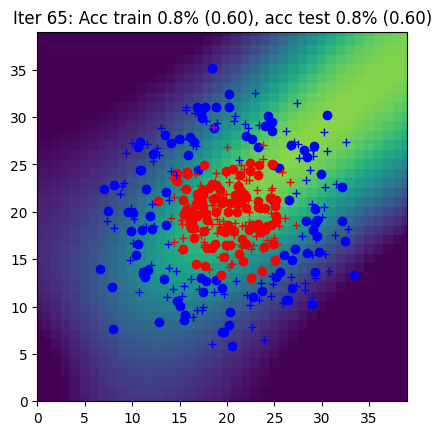

Iter 66: Acc train 0.8% (0.60), acc test 0.8% (0.60)


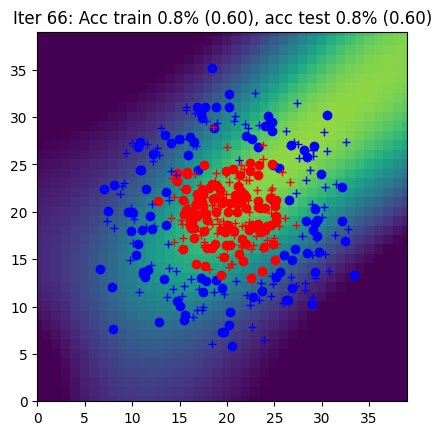

Iter 67: Acc train 0.8% (0.60), acc test 0.8% (0.60)


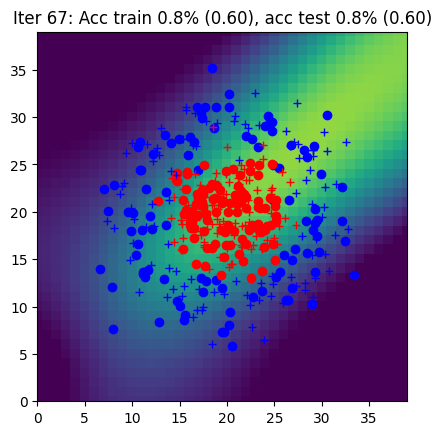

Iter 68: Acc train 0.8% (0.59), acc test 0.8% (0.59)


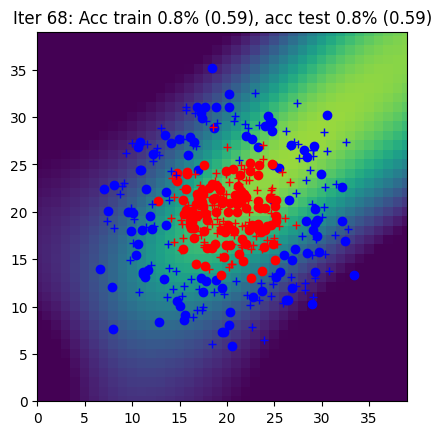

Iter 69: Acc train 0.8% (0.59), acc test 0.8% (0.59)


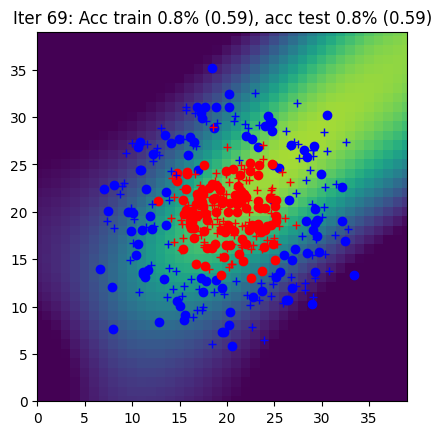

Iter 70: Acc train 0.8% (0.59), acc test 0.8% (0.59)


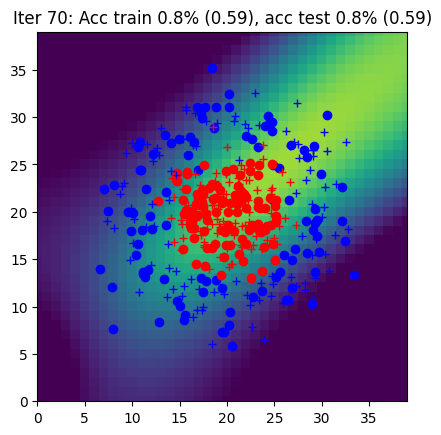

Iter 71: Acc train 0.8% (0.58), acc test 0.8% (0.58)


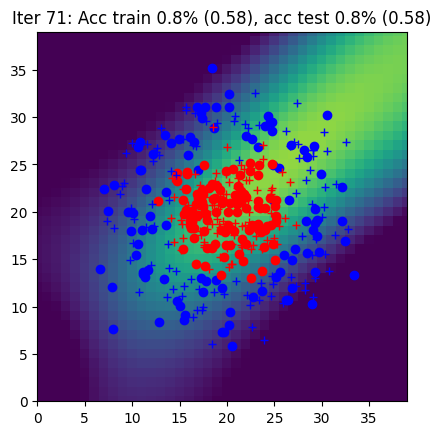

Iter 72: Acc train 0.8% (0.58), acc test 0.8% (0.58)


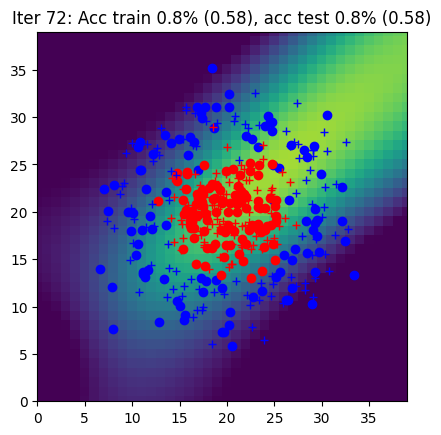

Iter 73: Acc train 0.8% (0.58), acc test 0.8% (0.58)


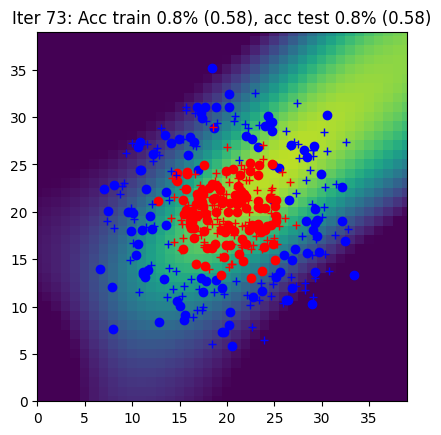

Iter 74: Acc train 0.8% (0.57), acc test 0.8% (0.57)


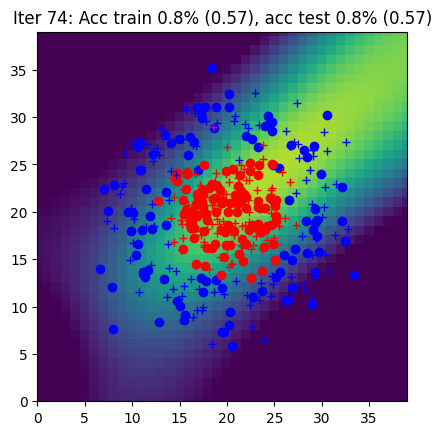

Iter 75: Acc train 0.8% (0.57), acc test 0.8% (0.57)


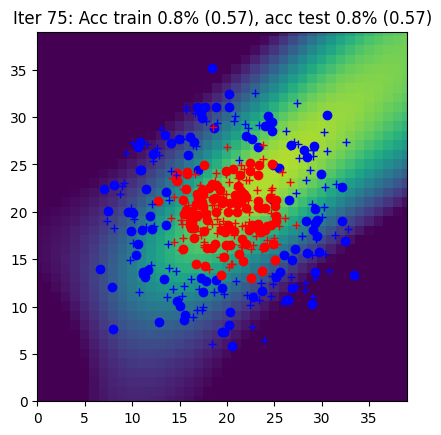

Iter 76: Acc train 0.8% (0.56), acc test 0.8% (0.56)


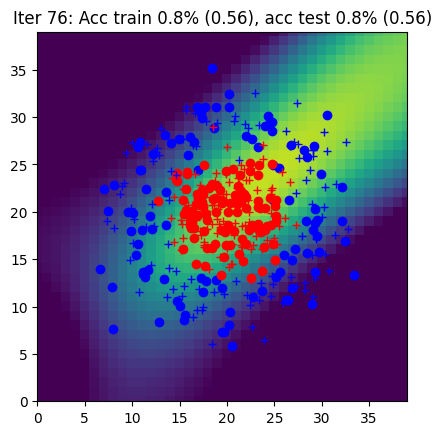

Iter 77: Acc train 0.8% (0.56), acc test 0.8% (0.56)


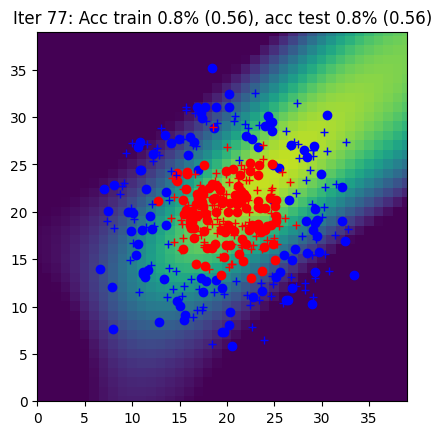

Iter 78: Acc train 0.8% (0.56), acc test 0.8% (0.56)


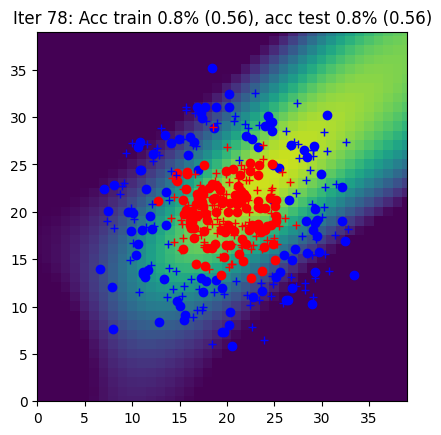

Iter 79: Acc train 0.8% (0.55), acc test 0.8% (0.55)


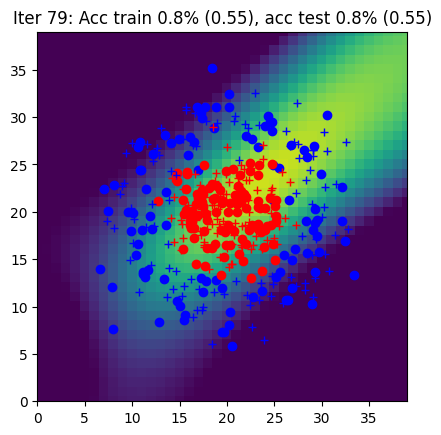

Iter 80: Acc train 0.8% (0.55), acc test 0.8% (0.55)


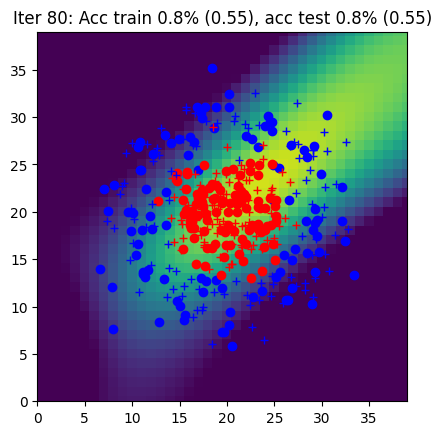

Iter 81: Acc train 0.8% (0.55), acc test 0.8% (0.55)


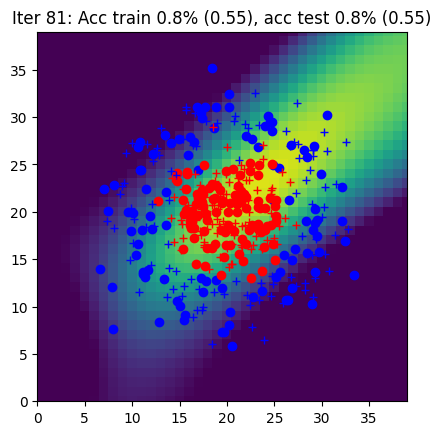

Iter 82: Acc train 0.8% (0.54), acc test 0.8% (0.54)


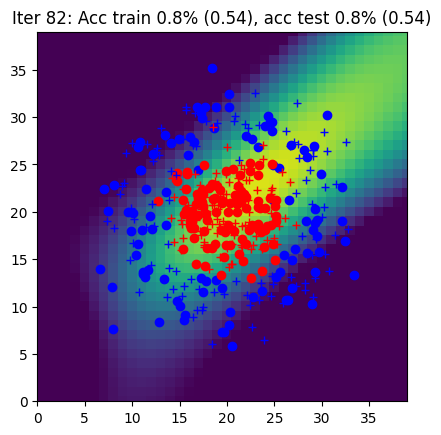

Iter 83: Acc train 0.8% (0.54), acc test 0.8% (0.54)


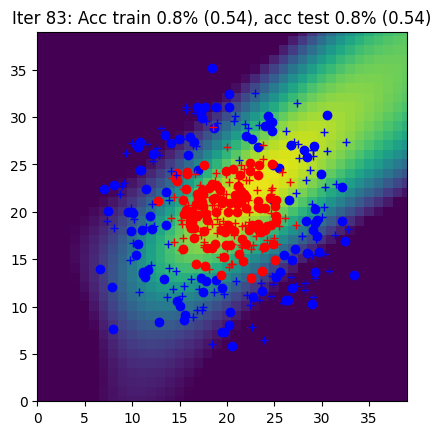

Iter 84: Acc train 0.8% (0.53), acc test 0.8% (0.53)


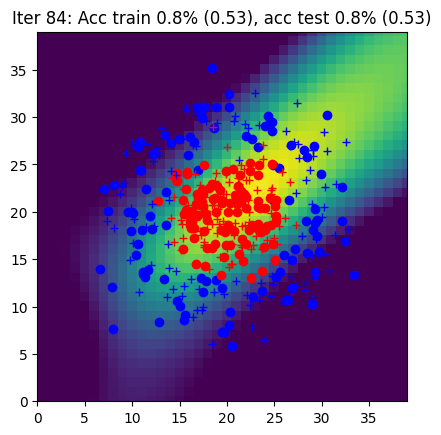

Iter 85: Acc train 0.8% (0.53), acc test 0.8% (0.53)


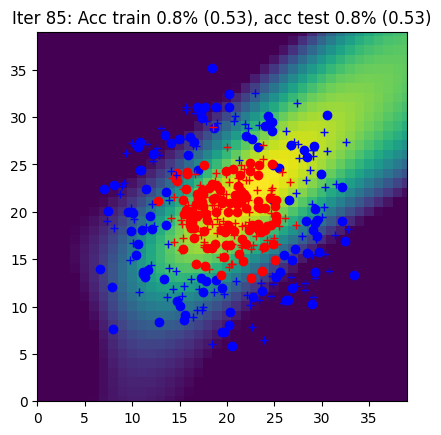

Iter 86: Acc train 0.8% (0.53), acc test 0.8% (0.53)


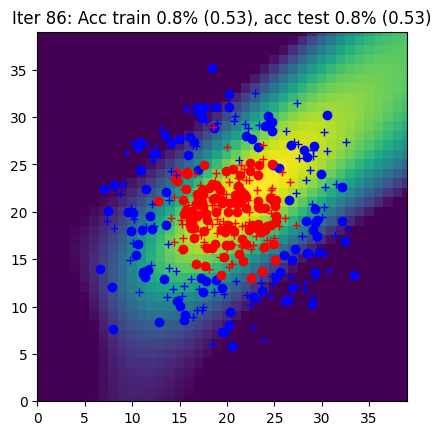

Iter 87: Acc train 0.8% (0.52), acc test 0.8% (0.52)


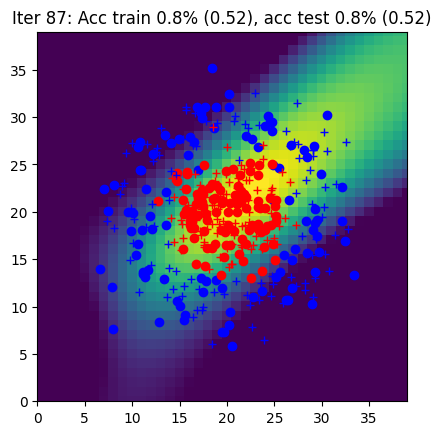

Iter 88: Acc train 0.8% (0.52), acc test 0.8% (0.52)


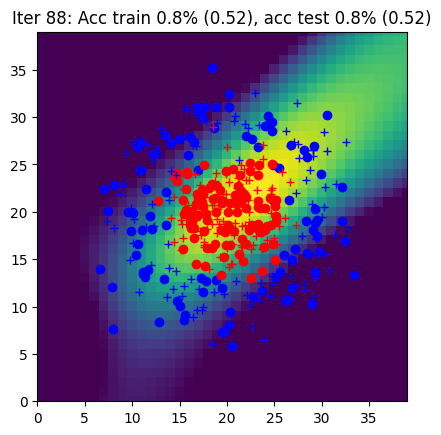

Iter 89: Acc train 0.8% (0.51), acc test 0.8% (0.51)


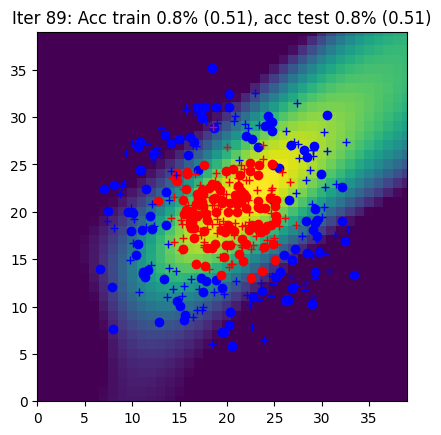

Iter 90: Acc train 0.8% (0.51), acc test 0.8% (0.51)


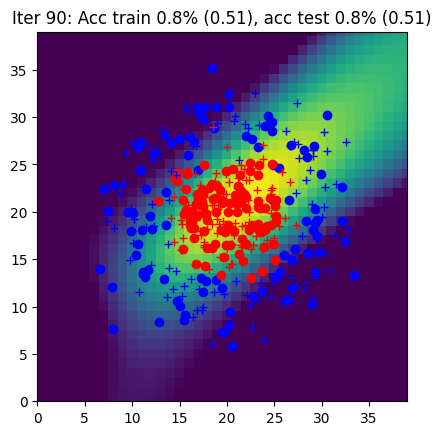

Iter 91: Acc train 0.8% (0.51), acc test 0.8% (0.51)


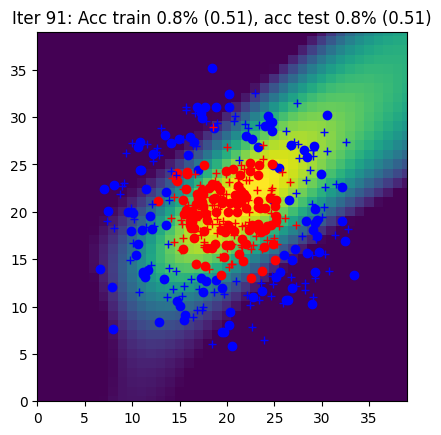

Iter 92: Acc train 0.8% (0.50), acc test 0.8% (0.50)


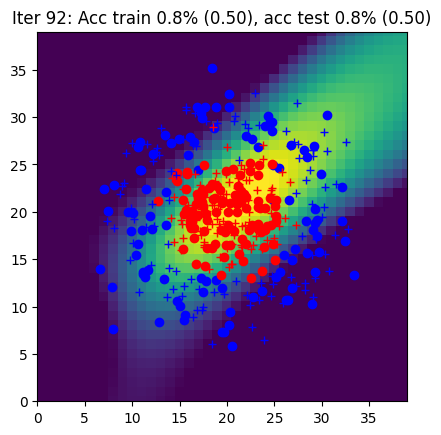

Iter 93: Acc train 0.8% (0.50), acc test 0.8% (0.50)


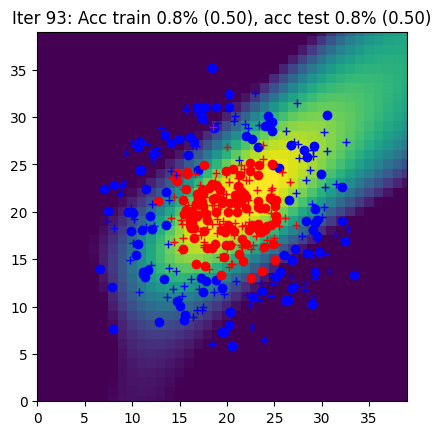

Iter 94: Acc train 0.8% (0.50), acc test 0.8% (0.49)


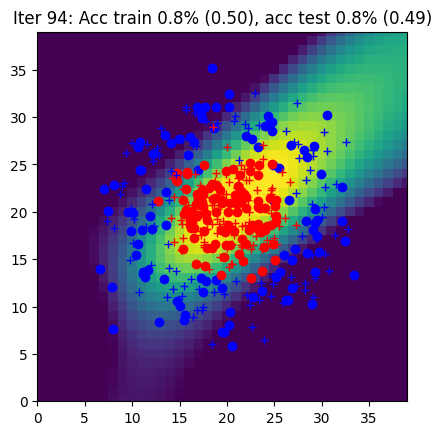

Iter 95: Acc train 0.8% (0.49), acc test 0.8% (0.49)


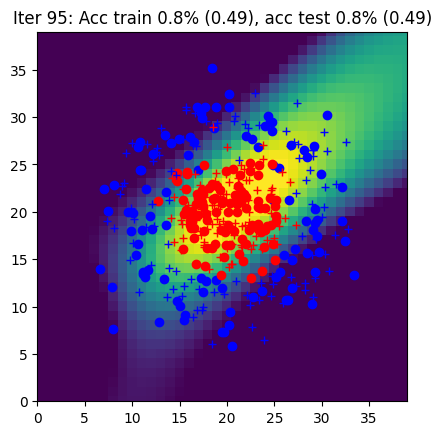

Iter 96: Acc train 0.8% (0.49), acc test 0.8% (0.49)


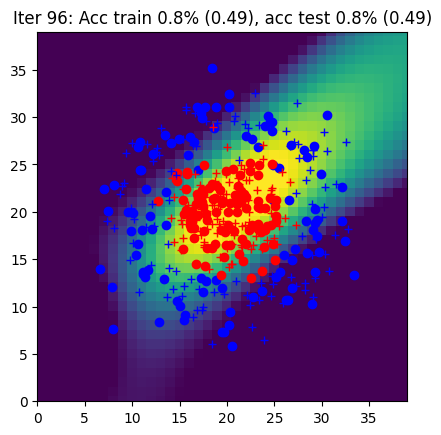

Iter 97: Acc train 0.8% (0.48), acc test 0.8% (0.48)


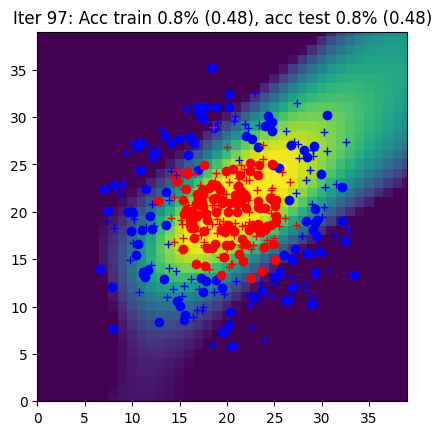

Iter 98: Acc train 0.8% (0.48), acc test 0.8% (0.48)


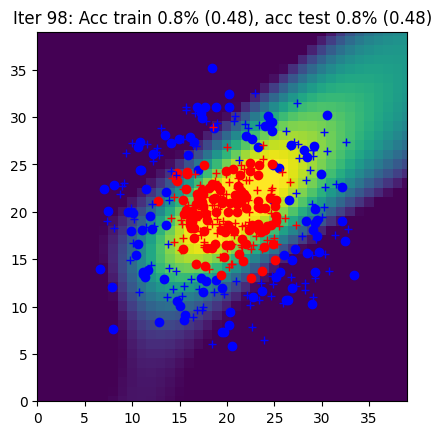

Iter 99: Acc train 0.8% (0.48), acc test 0.8% (0.47)


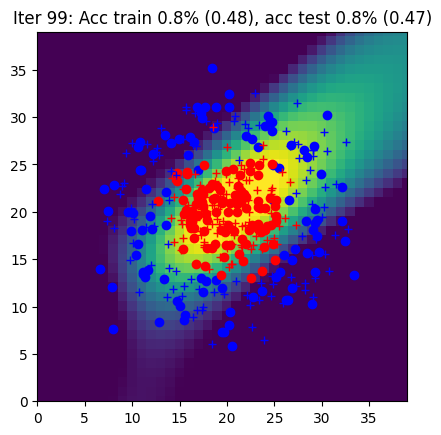

Iter 100: Acc train 0.8% (0.47), acc test 0.8% (0.47)


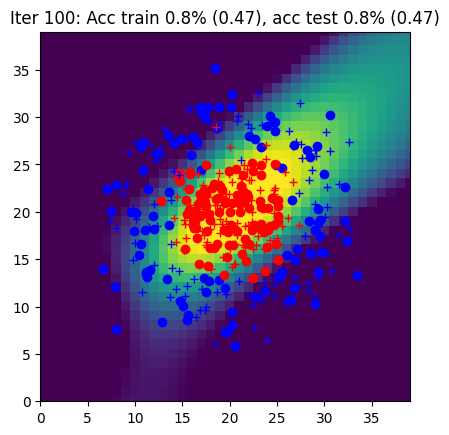

Iter 101: Acc train 0.8% (0.47), acc test 0.8% (0.46)


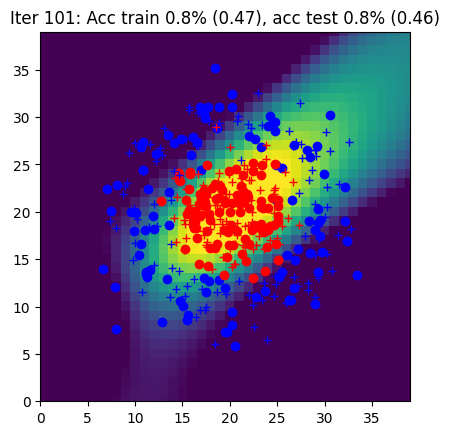

Iter 102: Acc train 0.8% (0.46), acc test 0.8% (0.46)


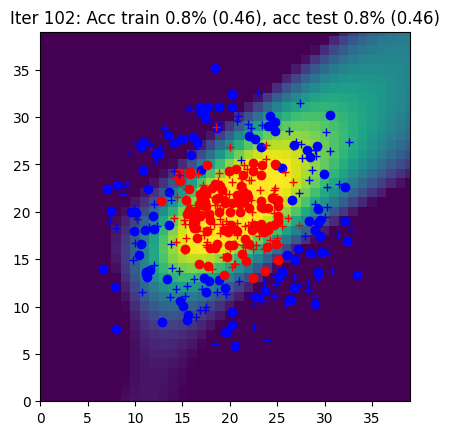

Iter 103: Acc train 0.8% (0.46), acc test 0.8% (0.46)


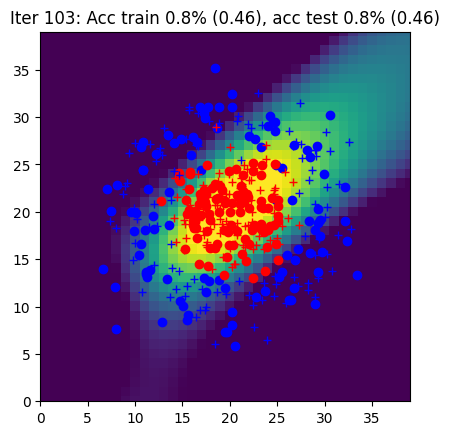

Iter 104: Acc train 0.8% (0.45), acc test 0.8% (0.45)


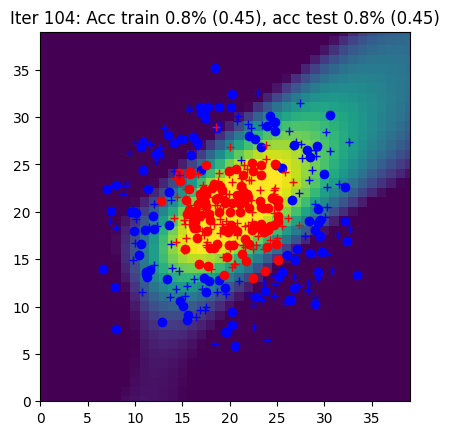

Iter 105: Acc train 0.8% (0.45), acc test 0.8% (0.45)


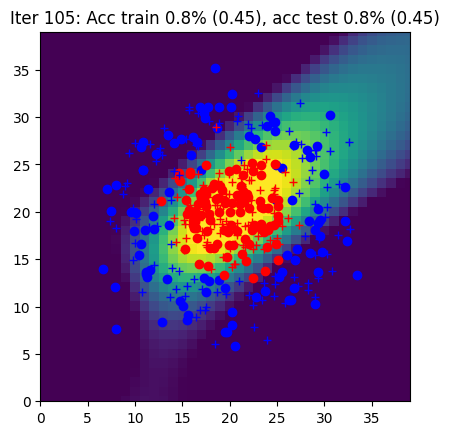

Iter 106: Acc train 0.8% (0.45), acc test 0.9% (0.44)


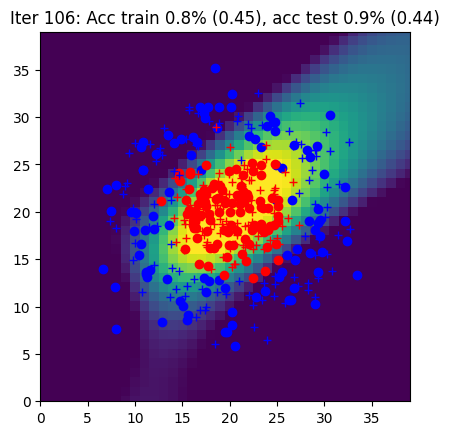

Iter 107: Acc train 0.8% (0.44), acc test 0.9% (0.44)


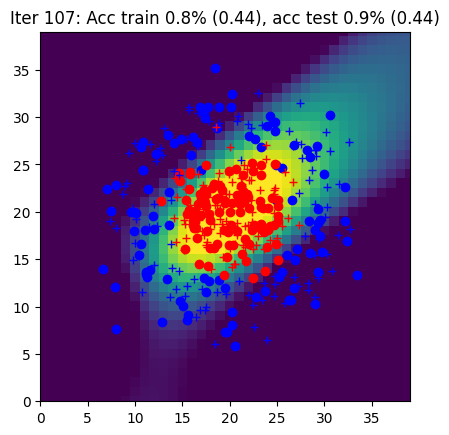

Iter 108: Acc train 0.8% (0.44), acc test 0.9% (0.43)


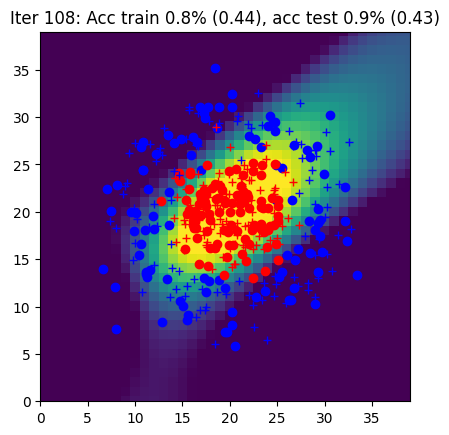

Iter 109: Acc train 0.8% (0.43), acc test 0.9% (0.43)


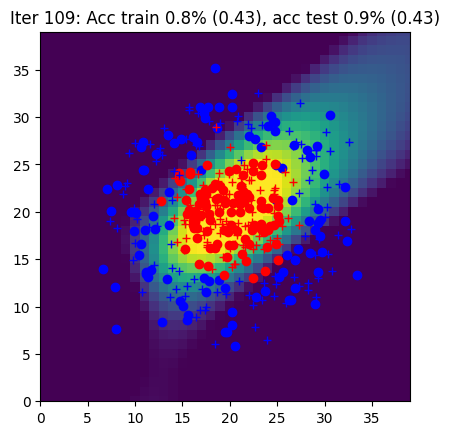

Iter 110: Acc train 0.9% (0.43), acc test 0.9% (0.43)


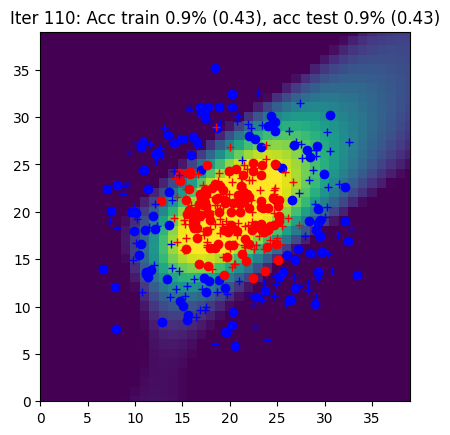

Iter 111: Acc train 0.8% (0.42), acc test 0.9% (0.42)


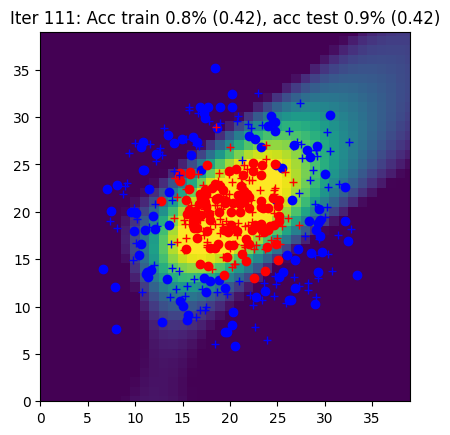

Iter 112: Acc train 0.9% (0.42), acc test 0.9% (0.42)


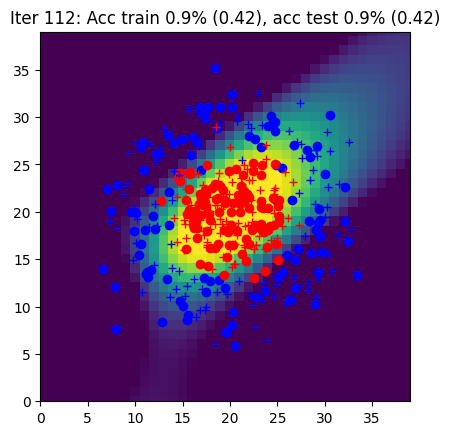

Iter 113: Acc train 0.9% (0.42), acc test 0.9% (0.41)


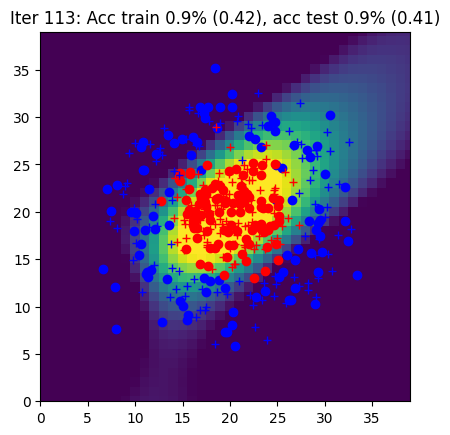

Iter 114: Acc train 0.9% (0.41), acc test 0.9% (0.41)


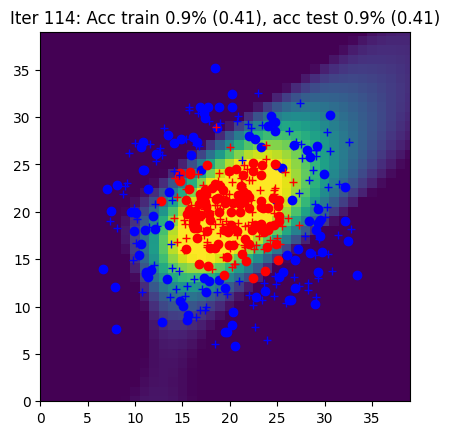

Iter 115: Acc train 0.9% (0.41), acc test 0.9% (0.40)


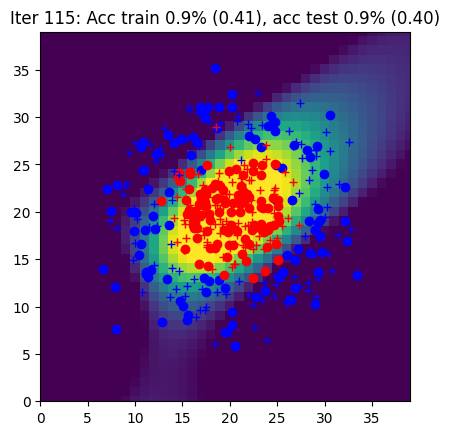

Iter 116: Acc train 0.9% (0.40), acc test 0.9% (0.40)


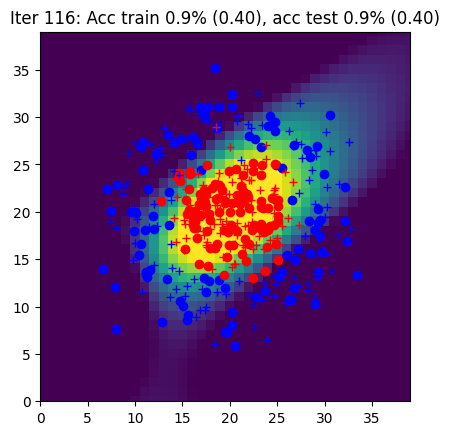

Iter 117: Acc train 0.9% (0.40), acc test 0.9% (0.39)


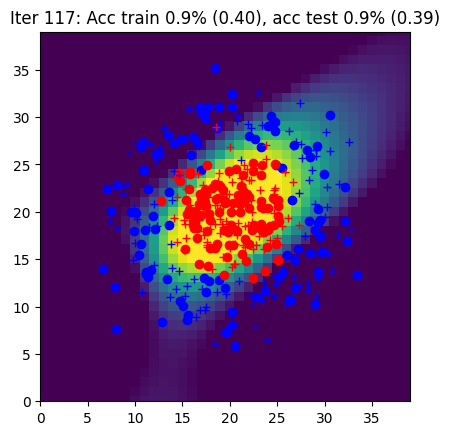

Iter 118: Acc train 0.9% (0.39), acc test 0.9% (0.39)


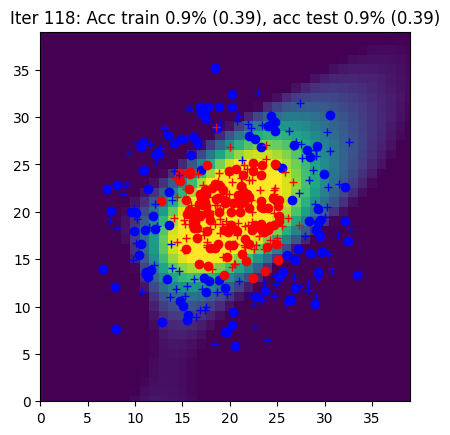

Iter 119: Acc train 0.9% (0.39), acc test 0.9% (0.39)


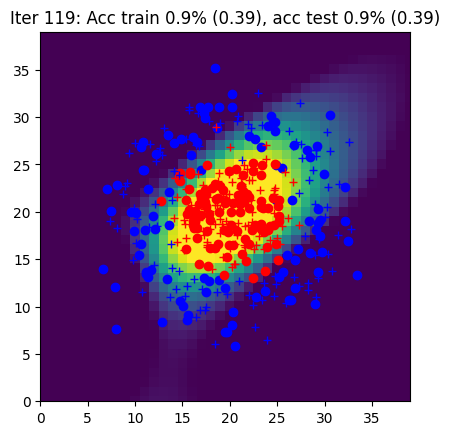

Iter 120: Acc train 0.9% (0.39), acc test 0.9% (0.38)


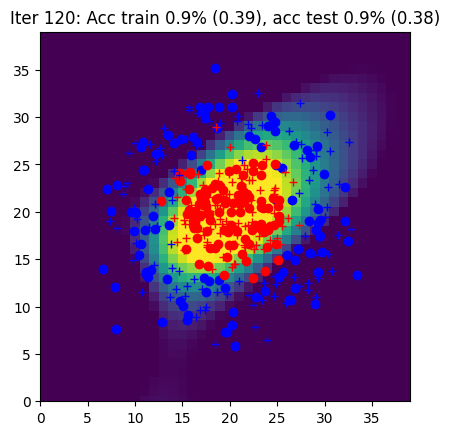

Iter 121: Acc train 0.9% (0.38), acc test 0.9% (0.38)


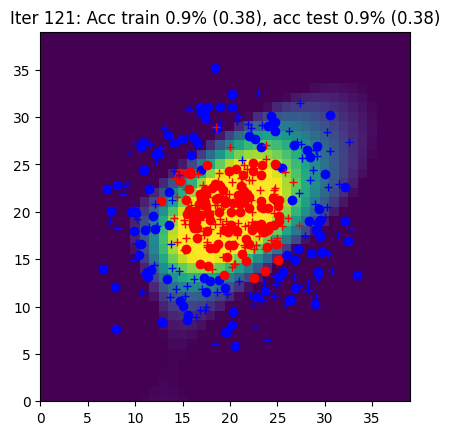

Iter 122: Acc train 0.9% (0.38), acc test 0.9% (0.37)


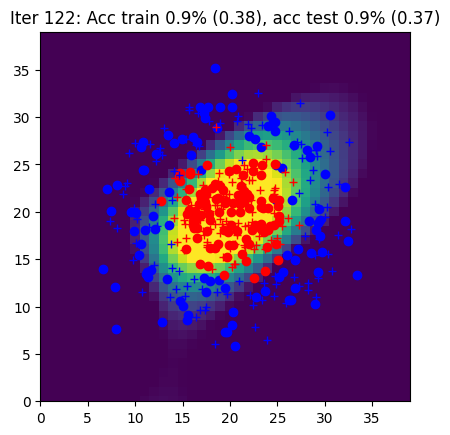

Iter 123: Acc train 0.9% (0.37), acc test 0.9% (0.37)


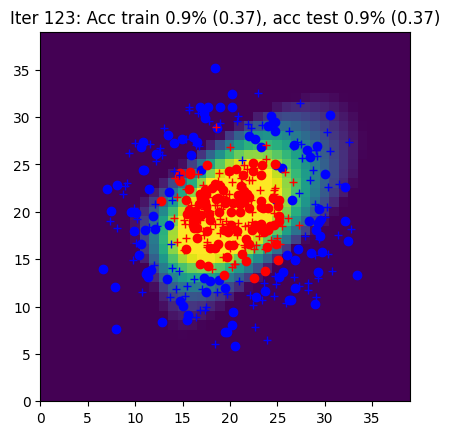

Iter 124: Acc train 0.9% (0.37), acc test 0.9% (0.36)


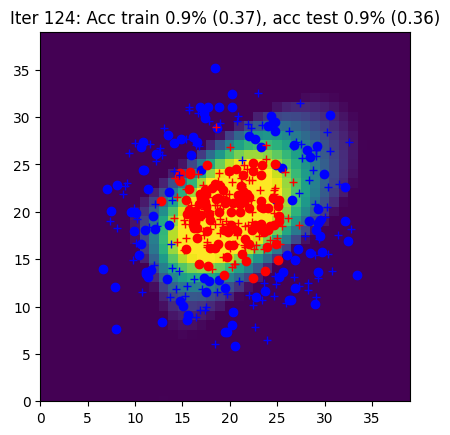

Iter 125: Acc train 0.9% (0.36), acc test 0.9% (0.36)


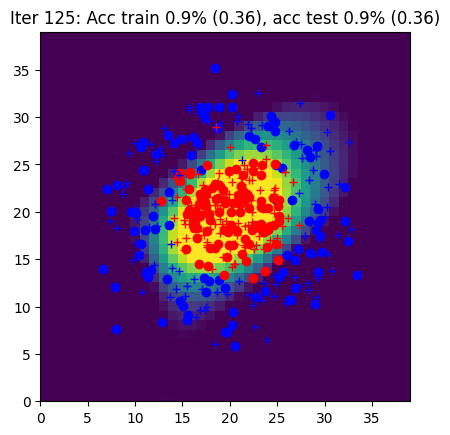

Iter 126: Acc train 0.9% (0.36), acc test 0.9% (0.35)


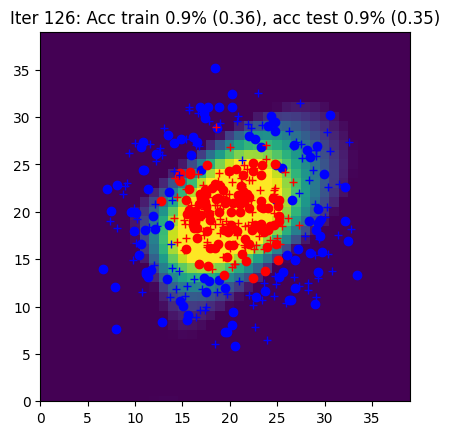

Iter 127: Acc train 0.9% (0.35), acc test 0.9% (0.35)


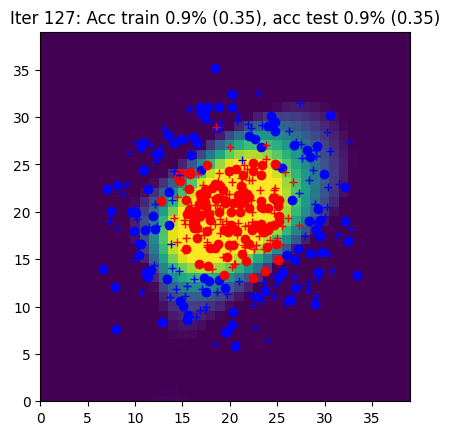

Iter 128: Acc train 0.9% (0.35), acc test 0.9% (0.35)


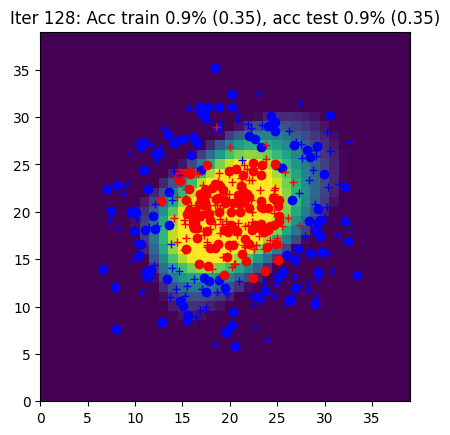

Iter 129: Acc train 0.9% (0.35), acc test 0.9% (0.34)


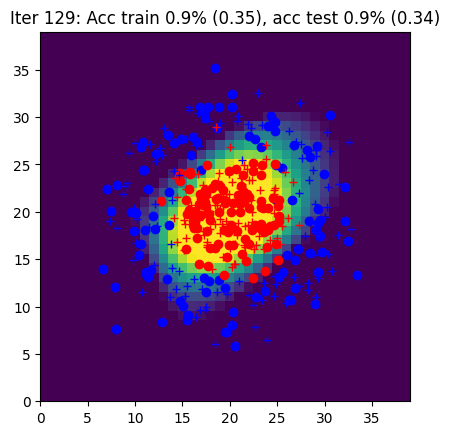

Iter 130: Acc train 0.9% (0.34), acc test 0.9% (0.34)


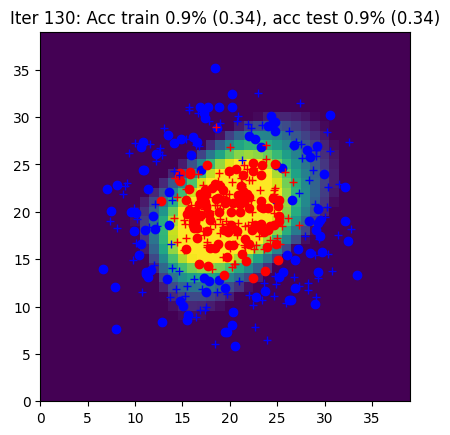

Iter 131: Acc train 0.9% (0.34), acc test 0.9% (0.33)


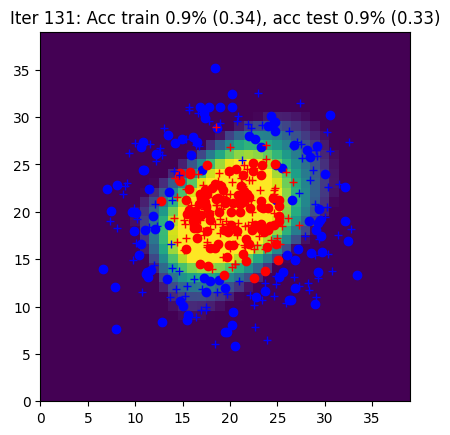

Iter 132: Acc train 0.9% (0.33), acc test 0.9% (0.33)


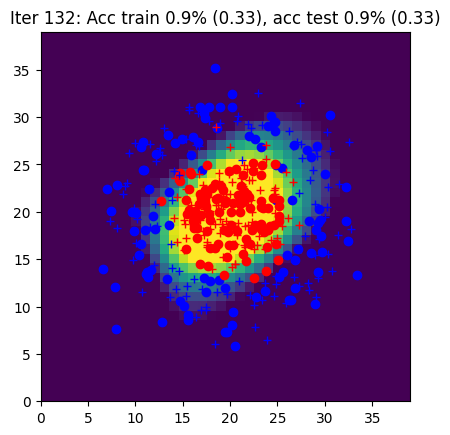

Iter 133: Acc train 0.9% (0.33), acc test 0.9% (0.33)


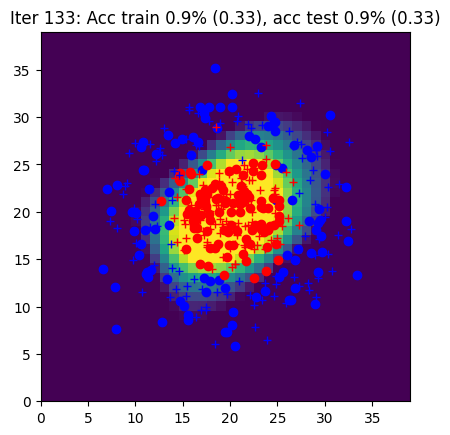

Iter 134: Acc train 0.9% (0.33), acc test 1.0% (0.32)


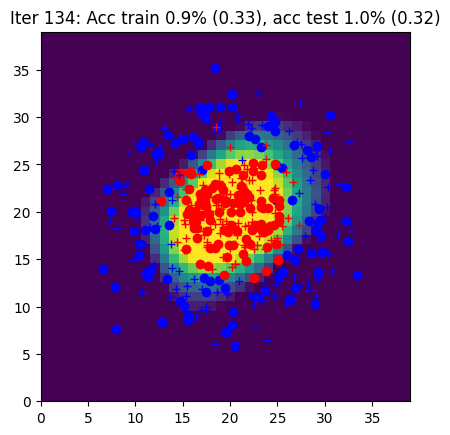

Iter 135: Acc train 0.9% (0.32), acc test 1.0% (0.32)


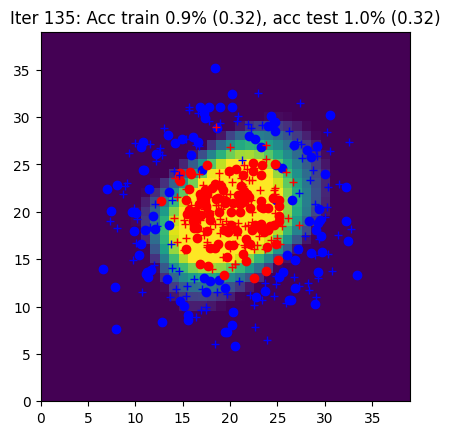

Iter 136: Acc train 0.9% (0.32), acc test 1.0% (0.32)


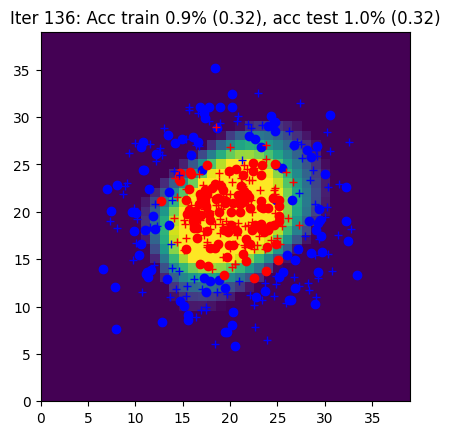

Iter 137: Acc train 0.9% (0.31), acc test 1.0% (0.31)


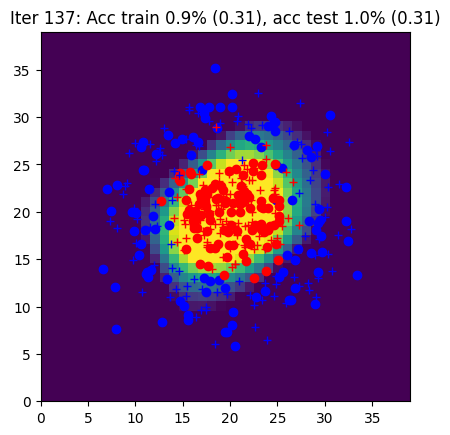

Iter 138: Acc train 0.9% (0.31), acc test 1.0% (0.31)


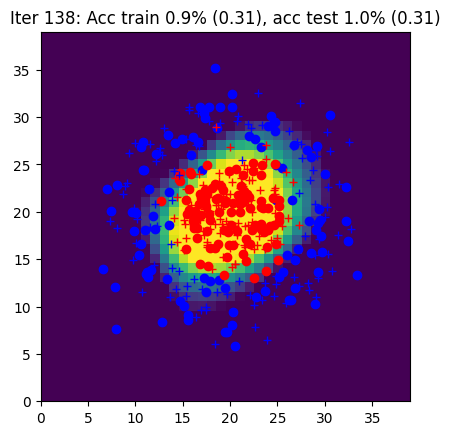

Iter 139: Acc train 0.9% (0.31), acc test 1.0% (0.30)


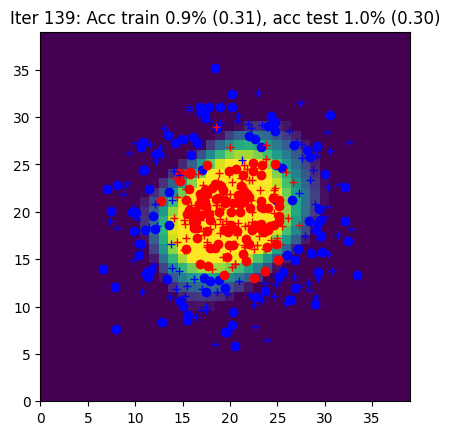

Iter 140: Acc train 0.9% (0.30), acc test 1.0% (0.30)


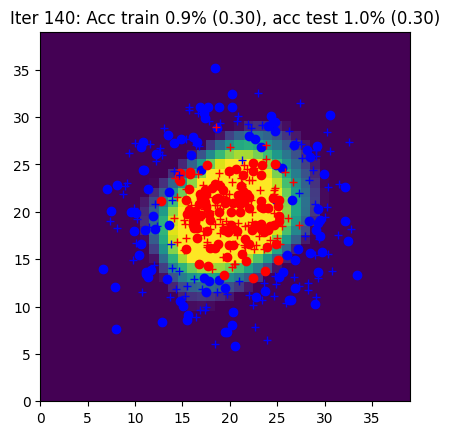

Iter 141: Acc train 0.9% (0.30), acc test 1.0% (0.30)


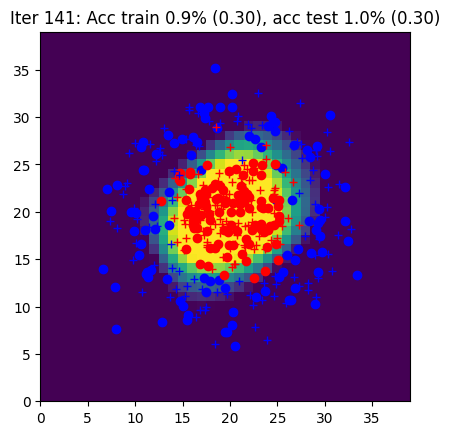

Iter 142: Acc train 0.9% (0.30), acc test 1.0% (0.29)


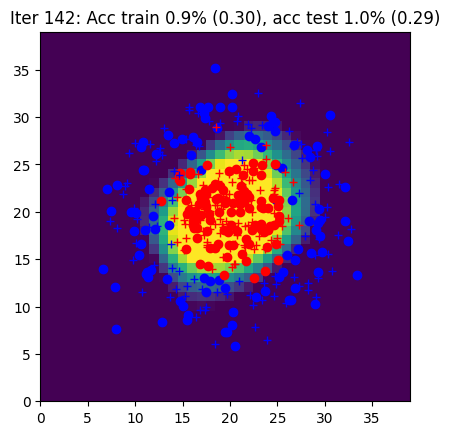

Iter 143: Acc train 0.9% (0.29), acc test 1.0% (0.29)


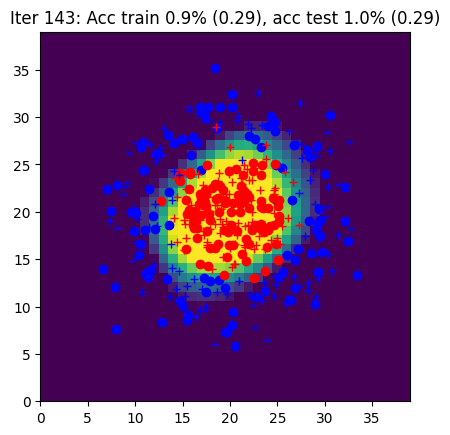

Iter 144: Acc train 0.9% (0.29), acc test 1.0% (0.29)


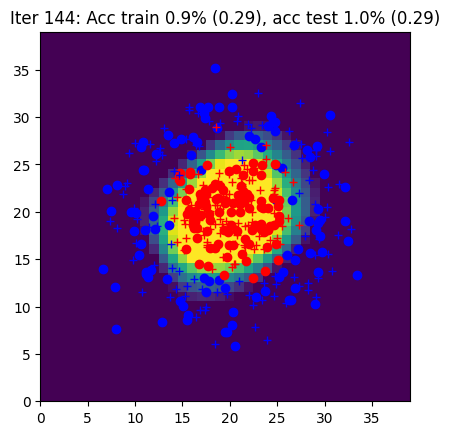

Iter 145: Acc train 0.9% (0.29), acc test 1.0% (0.29)


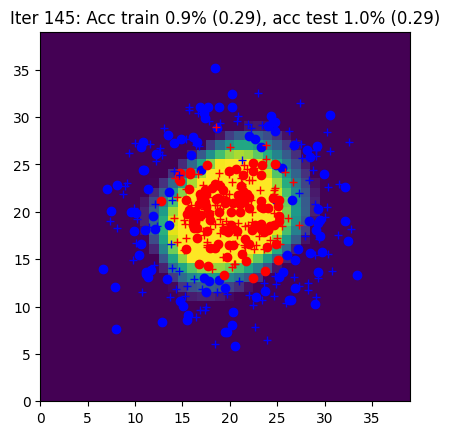

Iter 146: Acc train 0.9% (0.28), acc test 1.0% (0.28)


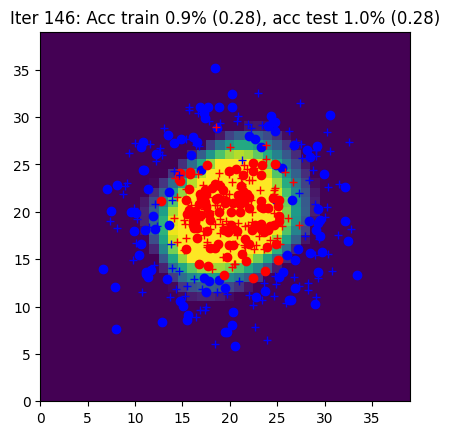

Iter 147: Acc train 0.9% (0.28), acc test 1.0% (0.28)


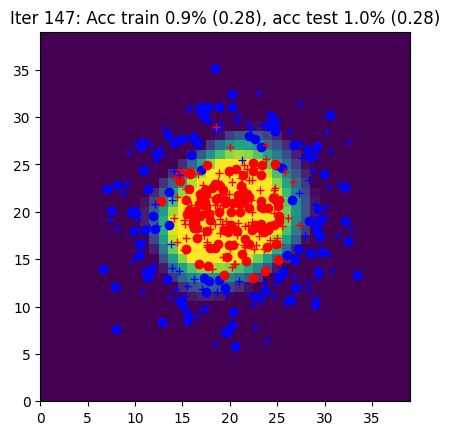

Iter 148: Acc train 0.9% (0.28), acc test 1.0% (0.28)


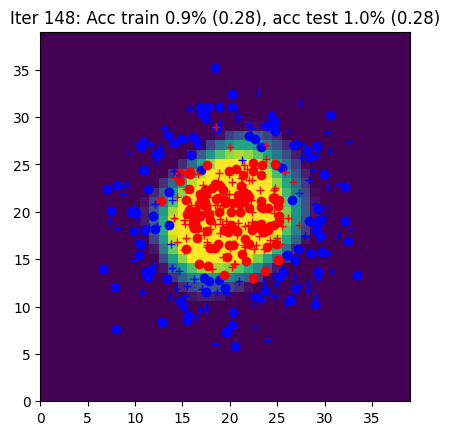

Iter 149: Acc train 0.9% (0.28), acc test 1.0% (0.27)


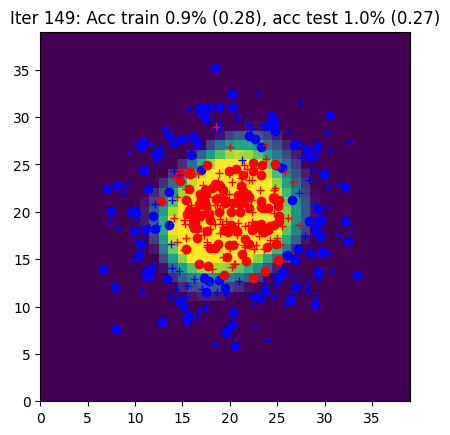

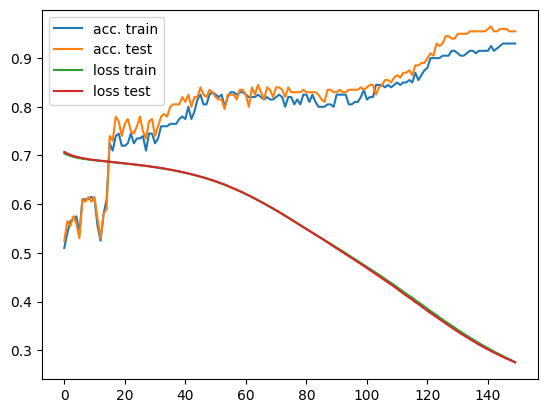

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd

        Yhat = model(X)
        L, acc = loss_accuracy(loss, Yhat, Y)
        L.backward()
        model = sgd(model, eta)

    ####################
    ##      END        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.item())
    curves[3].append(Ltest.item())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [ ]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )
    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

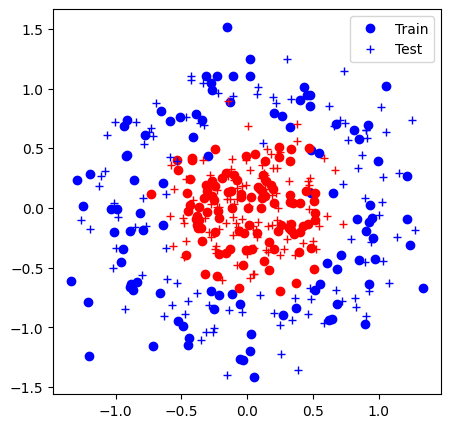

Iter 0: Acc train 0.6% (0.71), acc test 0.6% (0.70)


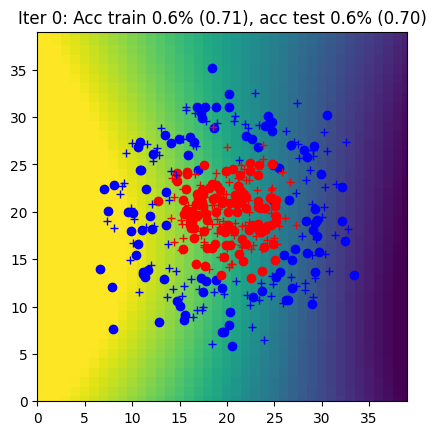

Iter 1: Acc train 0.6% (0.70), acc test 0.6% (0.69)


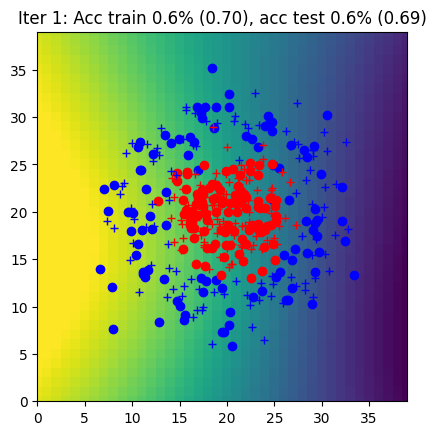

Iter 2: Acc train 0.6% (0.70), acc test 0.6% (0.69)


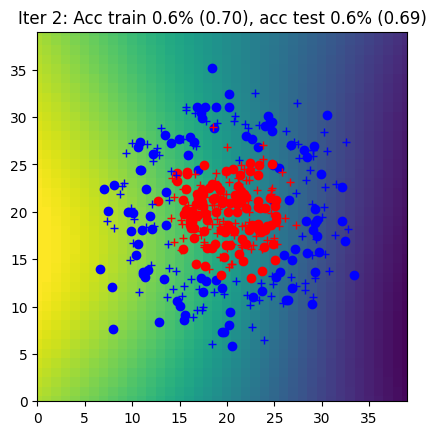

Iter 3: Acc train 0.6% (0.69), acc test 0.6% (0.69)


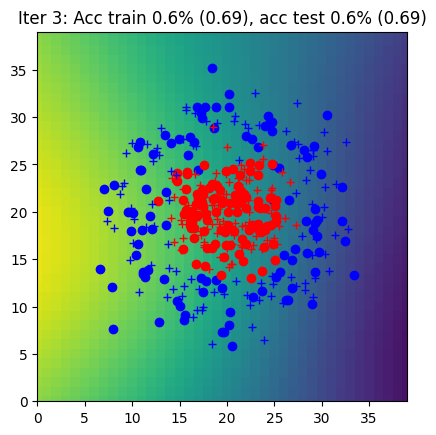

Iter 4: Acc train 0.6% (0.69), acc test 0.6% (0.69)


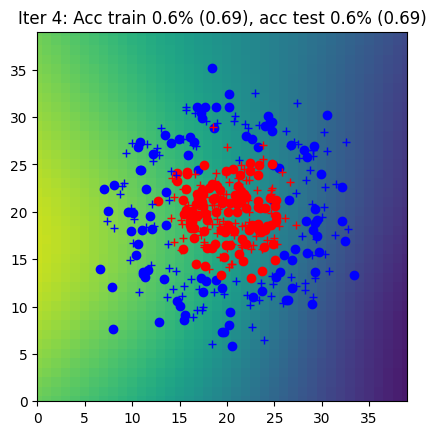

Iter 5: Acc train 0.6% (0.69), acc test 0.6% (0.68)


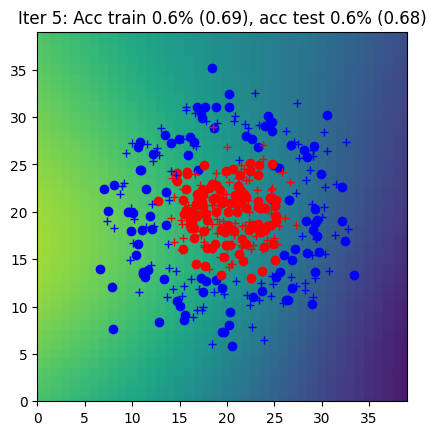

Iter 6: Acc train 0.6% (0.69), acc test 0.6% (0.68)


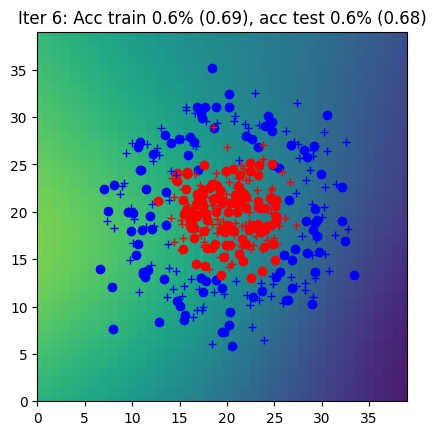

Iter 7: Acc train 0.6% (0.68), acc test 0.6% (0.68)


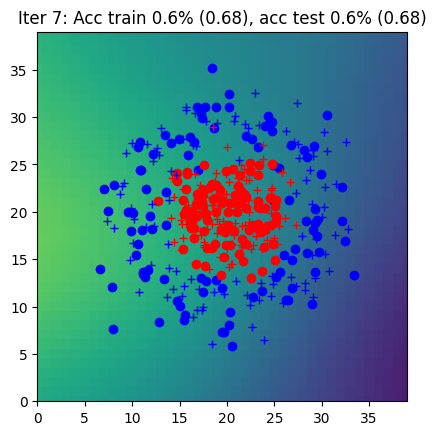

Iter 8: Acc train 0.6% (0.68), acc test 0.7% (0.68)


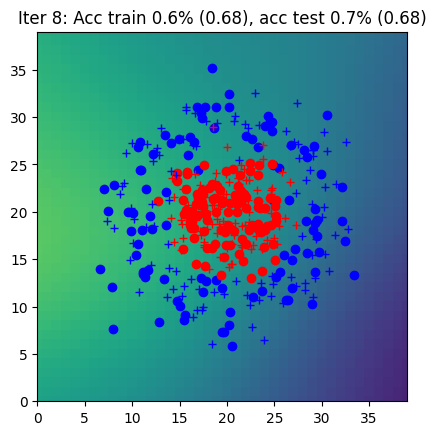

Iter 9: Acc train 0.6% (0.68), acc test 0.7% (0.68)


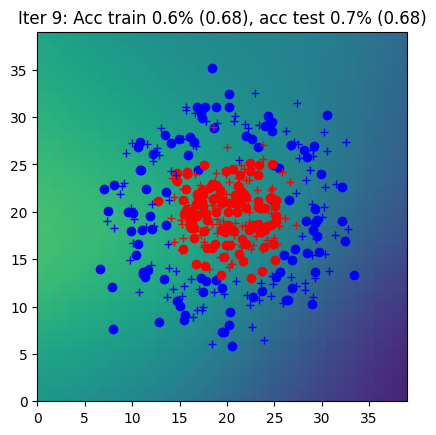

Iter 10: Acc train 0.6% (0.68), acc test 0.7% (0.68)


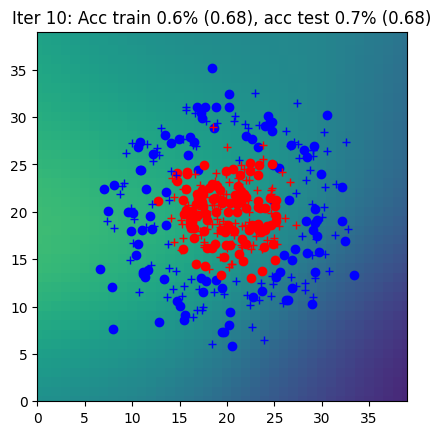

Iter 11: Acc train 0.7% (0.68), acc test 0.7% (0.68)


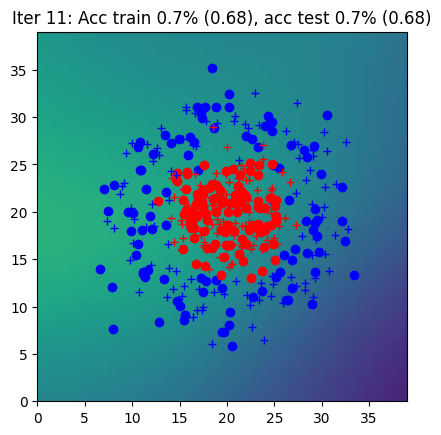

Iter 12: Acc train 0.7% (0.68), acc test 0.7% (0.67)


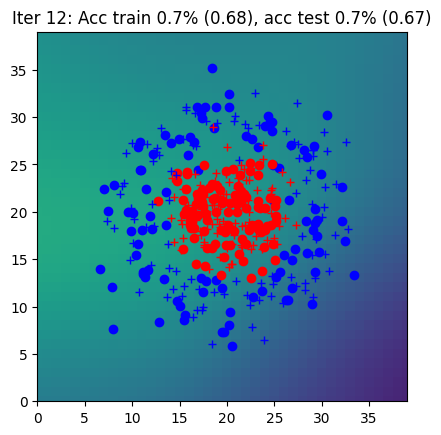

Iter 13: Acc train 0.7% (0.68), acc test 0.7% (0.67)


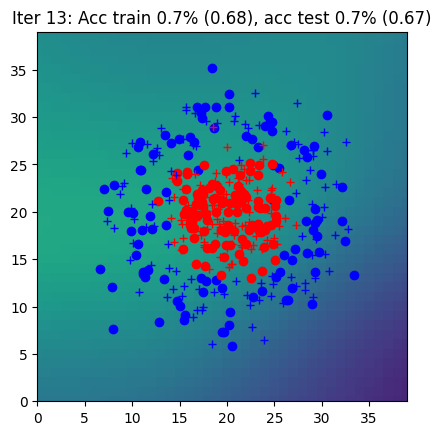

Iter 14: Acc train 0.7% (0.67), acc test 0.7% (0.67)


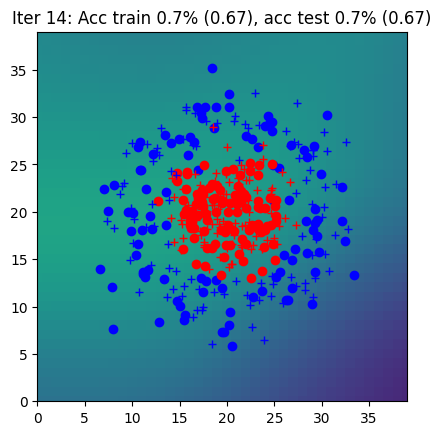

Iter 15: Acc train 0.7% (0.67), acc test 0.7% (0.67)


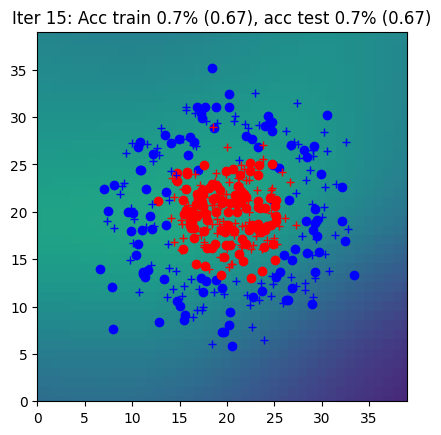

Iter 16: Acc train 0.7% (0.67), acc test 0.7% (0.67)


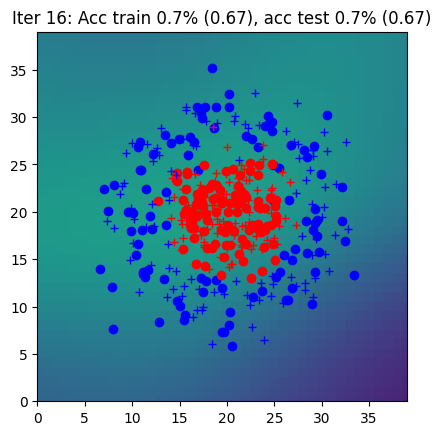

Iter 17: Acc train 0.6% (0.67), acc test 0.7% (0.67)


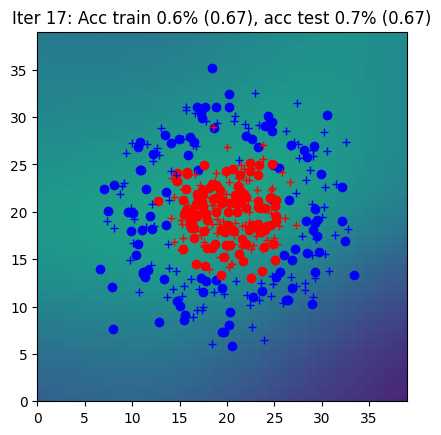

Iter 18: Acc train 0.7% (0.67), acc test 0.7% (0.67)


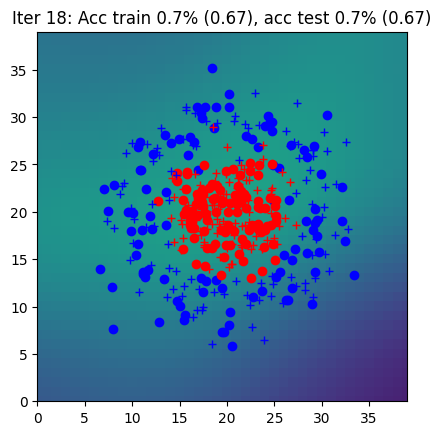

Iter 19: Acc train 0.8% (0.67), acc test 0.7% (0.67)


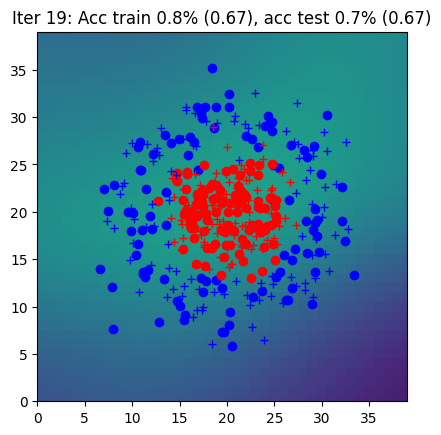

Iter 20: Acc train 0.8% (0.67), acc test 0.8% (0.66)


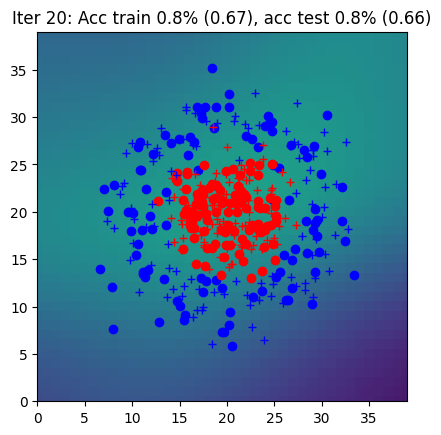

Iter 21: Acc train 0.8% (0.66), acc test 0.8% (0.66)


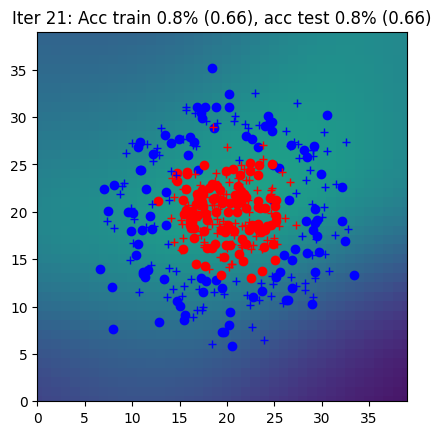

Iter 22: Acc train 0.7% (0.66), acc test 0.7% (0.66)


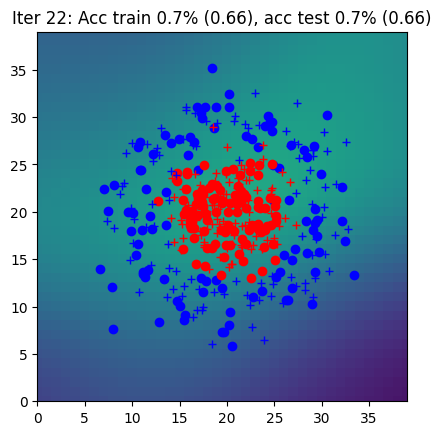

Iter 23: Acc train 0.7% (0.66), acc test 0.7% (0.66)


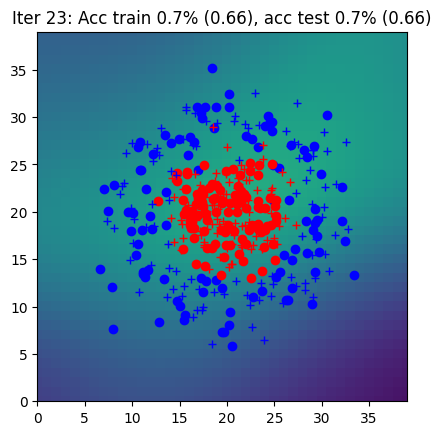

Iter 24: Acc train 0.7% (0.66), acc test 0.7% (0.66)


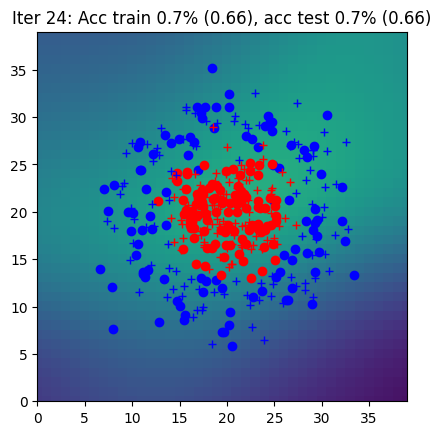

Iter 25: Acc train 0.7% (0.66), acc test 0.7% (0.66)


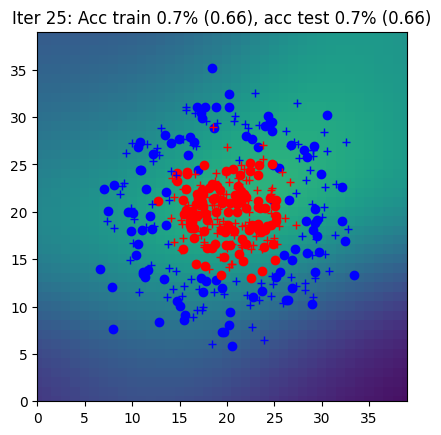

Iter 26: Acc train 0.7% (0.65), acc test 0.7% (0.65)


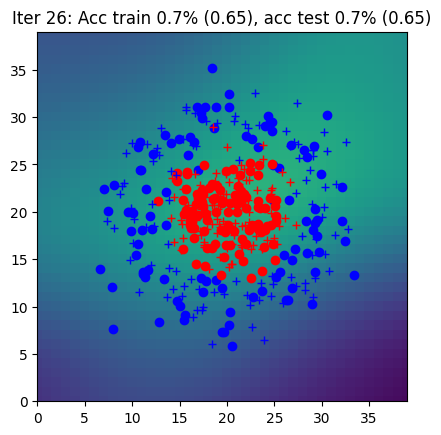

Iter 27: Acc train 0.7% (0.65), acc test 0.7% (0.65)


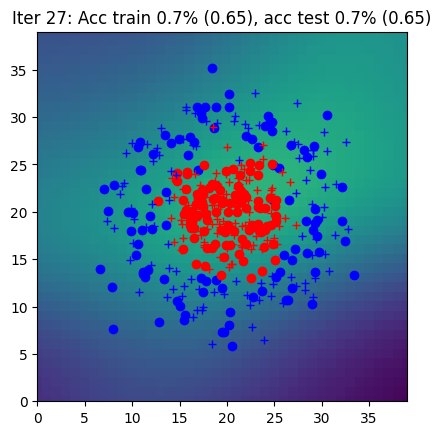

Iter 28: Acc train 0.8% (0.65), acc test 0.8% (0.65)


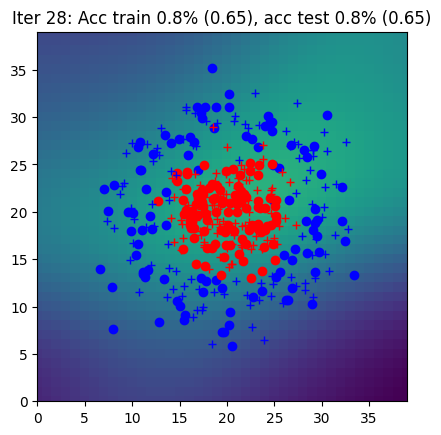

Iter 29: Acc train 0.8% (0.65), acc test 0.8% (0.65)


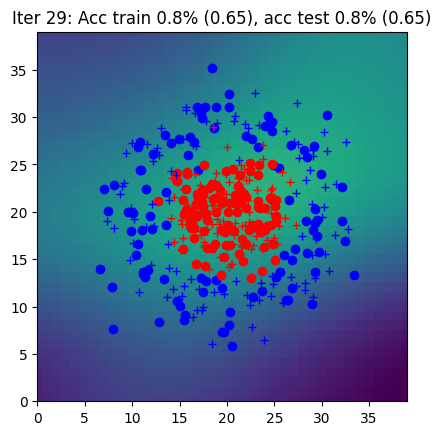

Iter 30: Acc train 0.8% (0.65), acc test 0.8% (0.65)


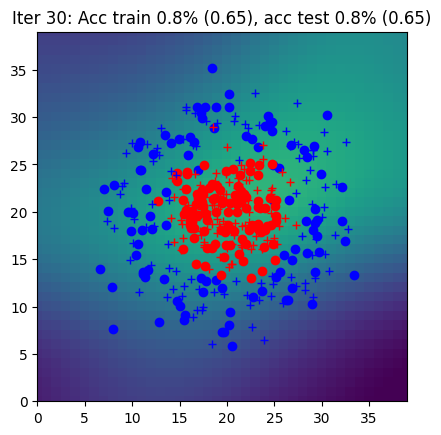

Iter 31: Acc train 0.8% (0.64), acc test 0.8% (0.64)


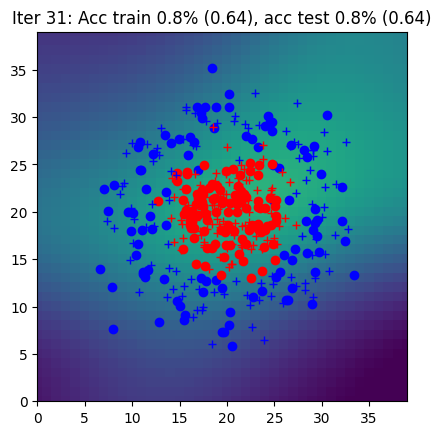

Iter 32: Acc train 0.8% (0.64), acc test 0.8% (0.64)


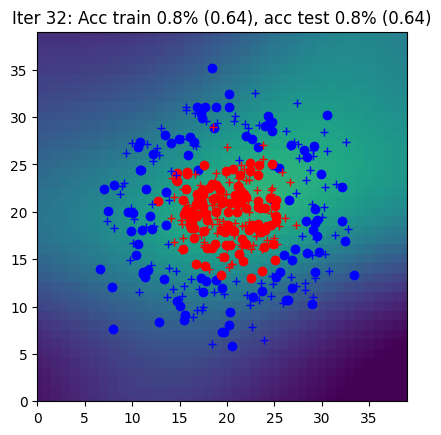

Iter 33: Acc train 0.8% (0.64), acc test 0.8% (0.64)


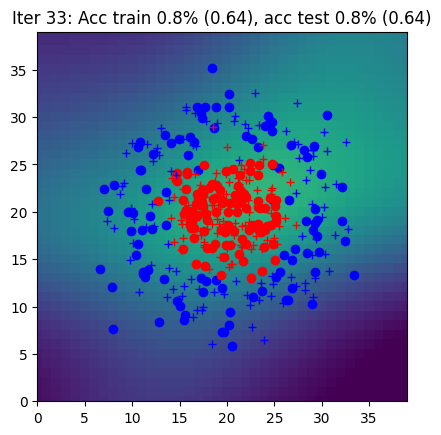

Iter 34: Acc train 0.8% (0.64), acc test 0.8% (0.64)


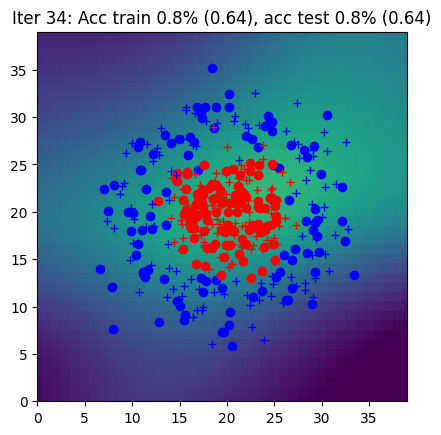

Iter 35: Acc train 0.8% (0.63), acc test 0.8% (0.63)


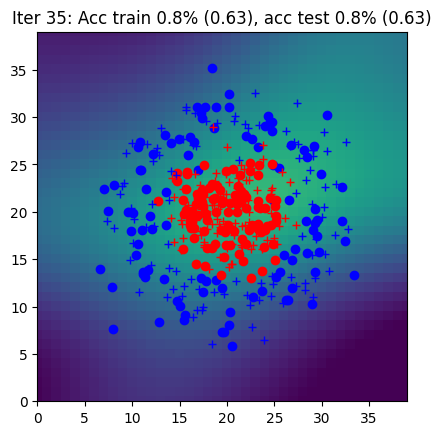

Iter 36: Acc train 0.8% (0.63), acc test 0.8% (0.63)


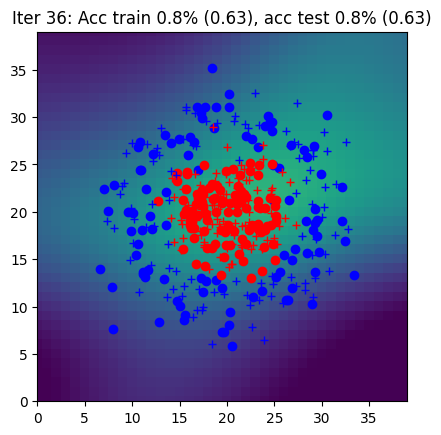

Iter 37: Acc train 0.8% (0.63), acc test 0.8% (0.63)


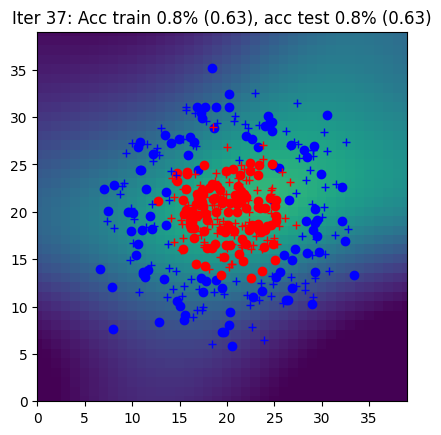

Iter 38: Acc train 0.8% (0.62), acc test 0.8% (0.62)


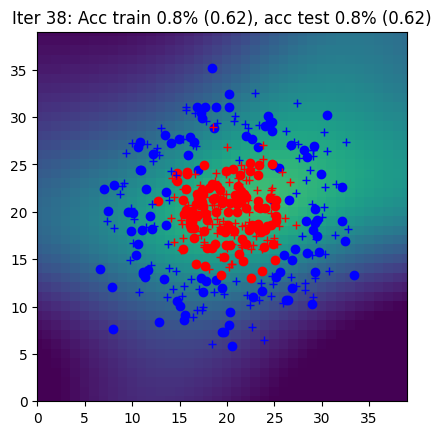

Iter 39: Acc train 0.8% (0.62), acc test 0.8% (0.62)


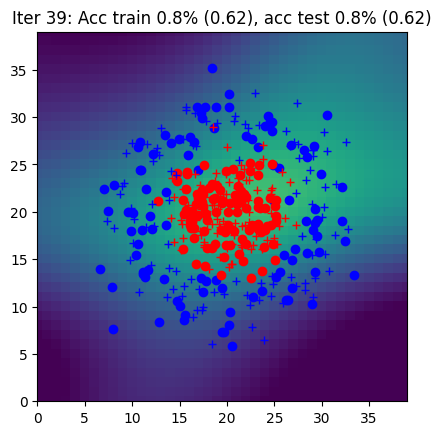

Iter 40: Acc train 0.8% (0.62), acc test 0.8% (0.62)


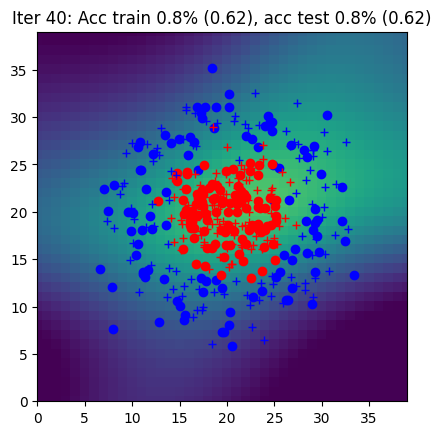

Iter 41: Acc train 0.8% (0.61), acc test 0.9% (0.61)


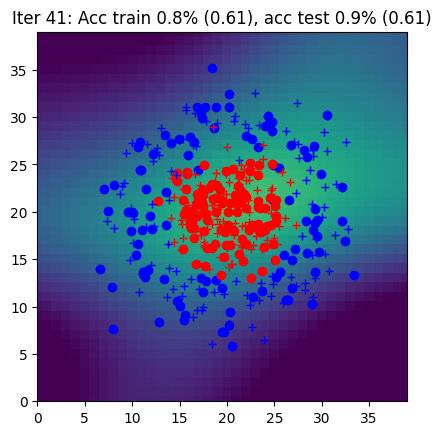

Iter 42: Acc train 0.8% (0.61), acc test 0.8% (0.61)


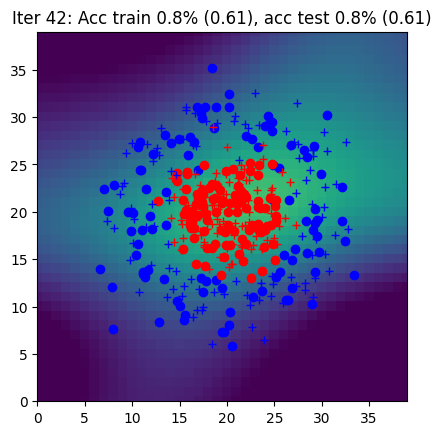

Iter 43: Acc train 0.8% (0.61), acc test 0.8% (0.61)


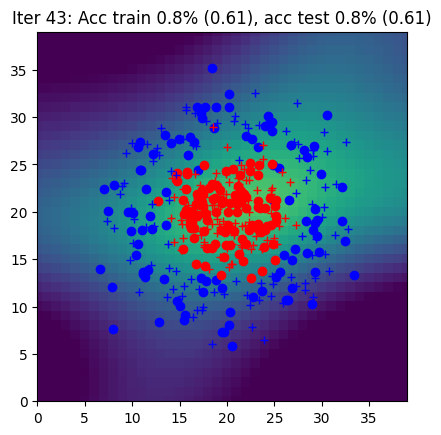

Iter 44: Acc train 0.8% (0.60), acc test 0.9% (0.60)


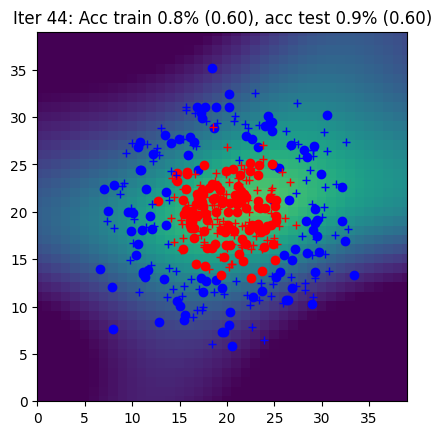

Iter 45: Acc train 0.8% (0.60), acc test 0.8% (0.60)


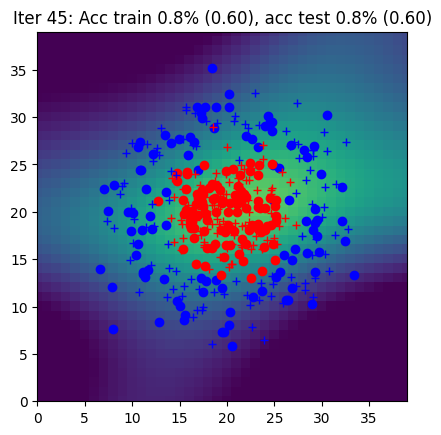

Iter 46: Acc train 0.8% (0.59), acc test 0.8% (0.59)


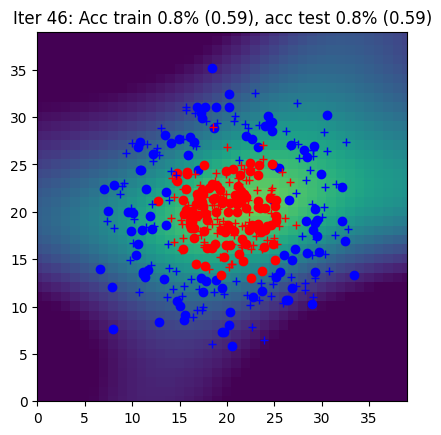

Iter 47: Acc train 0.8% (0.59), acc test 0.8% (0.59)


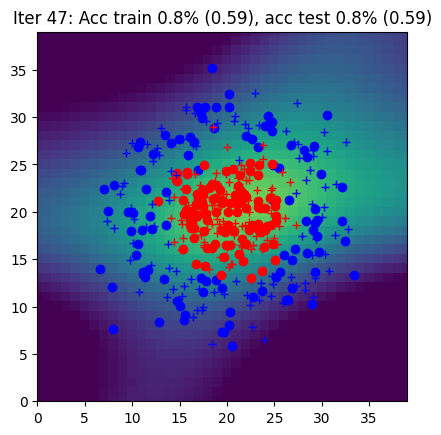

Iter 48: Acc train 0.8% (0.59), acc test 0.9% (0.59)


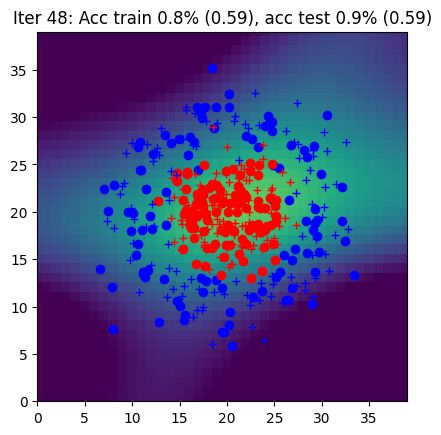

Iter 49: Acc train 0.8% (0.58), acc test 0.9% (0.58)


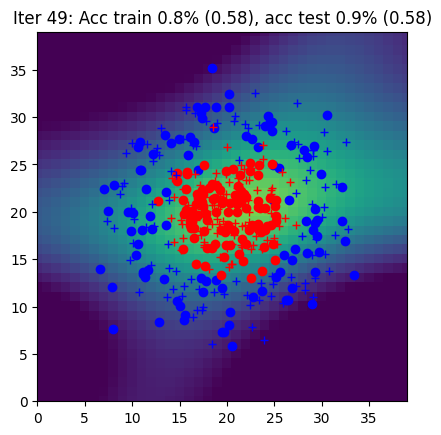

Iter 50: Acc train 0.8% (0.58), acc test 0.9% (0.58)


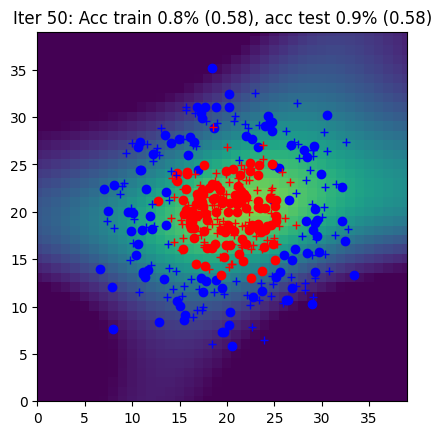

Iter 51: Acc train 0.8% (0.57), acc test 0.9% (0.57)


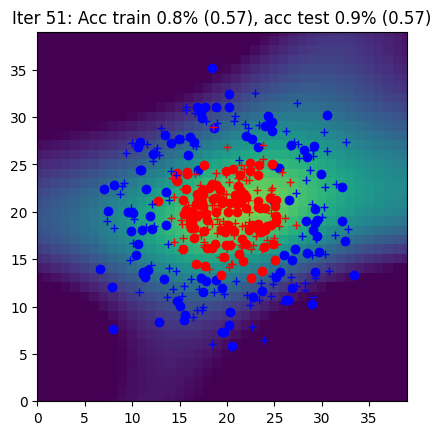

Iter 52: Acc train 0.8% (0.57), acc test 0.9% (0.57)


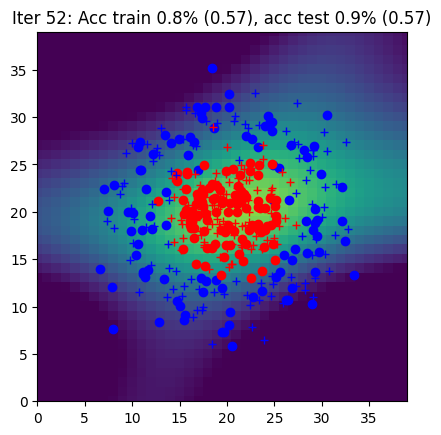

Iter 53: Acc train 0.8% (0.56), acc test 0.8% (0.56)


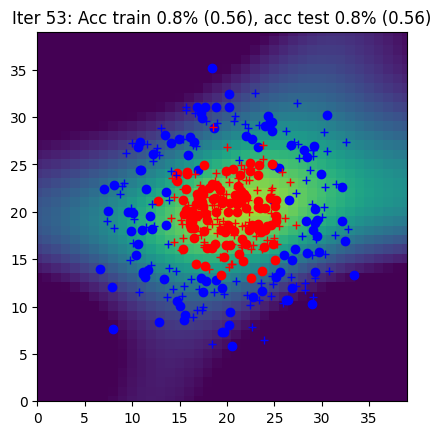

Iter 54: Acc train 0.8% (0.56), acc test 0.8% (0.56)


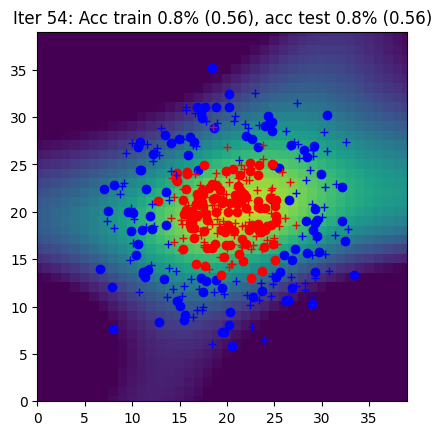

Iter 55: Acc train 0.8% (0.55), acc test 0.9% (0.55)


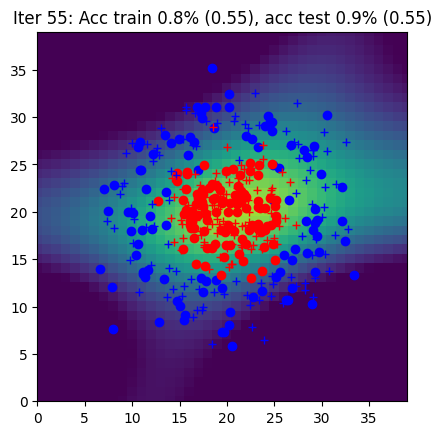

Iter 56: Acc train 0.9% (0.55), acc test 0.9% (0.55)


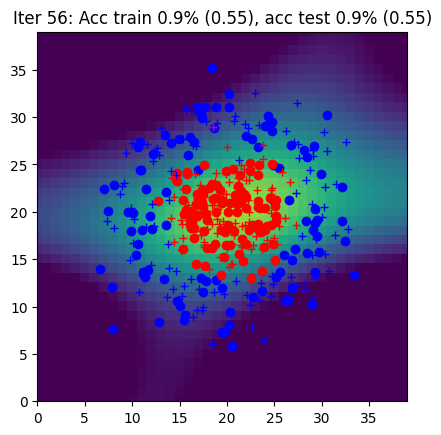

Iter 57: Acc train 0.8% (0.54), acc test 0.9% (0.54)


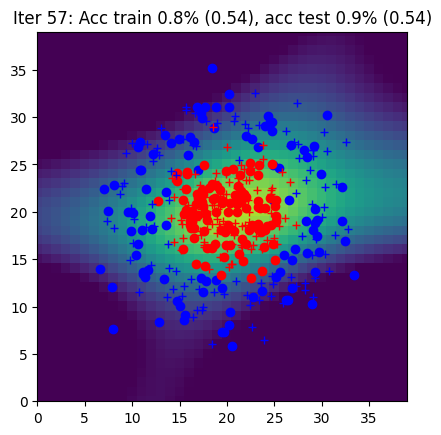

Iter 58: Acc train 0.8% (0.54), acc test 0.9% (0.54)


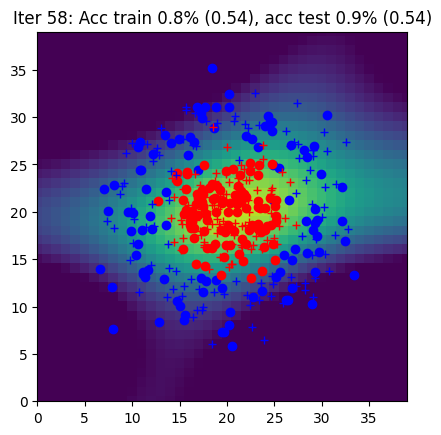

Iter 59: Acc train 0.8% (0.53), acc test 0.9% (0.53)


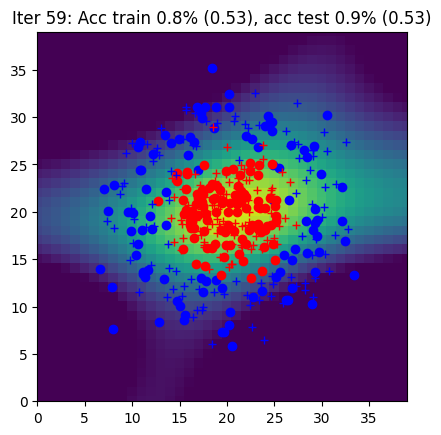

Iter 60: Acc train 0.8% (0.53), acc test 0.9% (0.52)


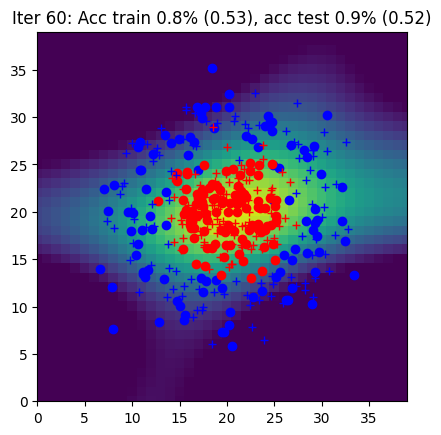

Iter 61: Acc train 0.8% (0.52), acc test 0.8% (0.52)


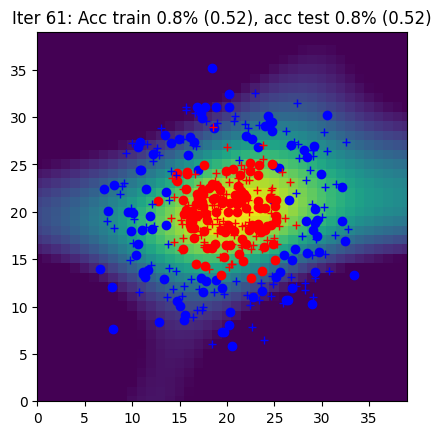

Iter 62: Acc train 0.8% (0.52), acc test 0.9% (0.51)


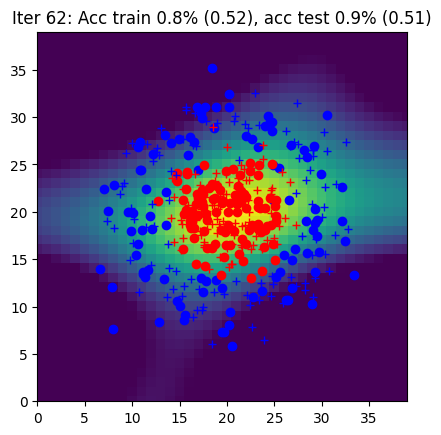

Iter 63: Acc train 0.8% (0.51), acc test 0.9% (0.51)


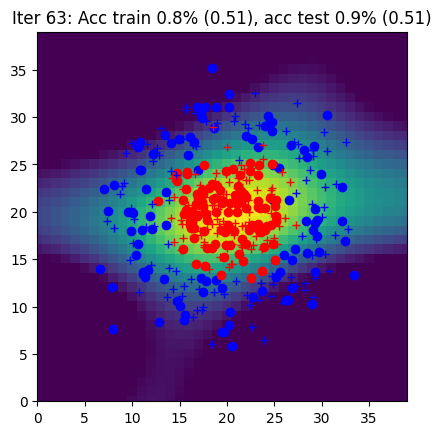

Iter 64: Acc train 0.9% (0.51), acc test 0.9% (0.50)


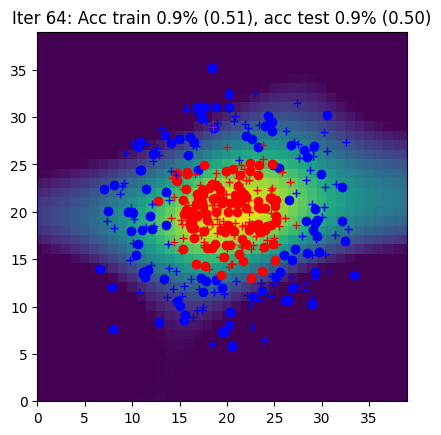

Iter 65: Acc train 0.9% (0.50), acc test 0.9% (0.50)


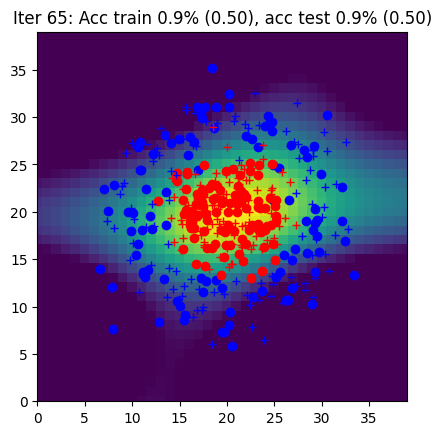

Iter 66: Acc train 0.9% (0.49), acc test 0.9% (0.49)


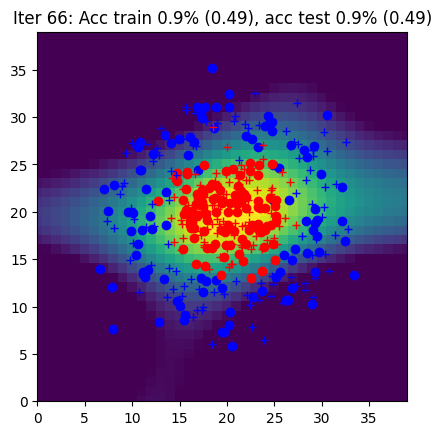

Iter 67: Acc train 0.9% (0.49), acc test 0.9% (0.49)


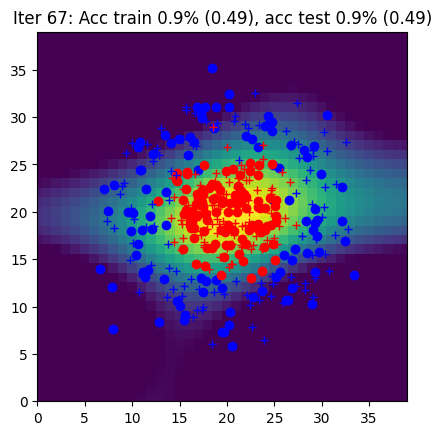

Iter 68: Acc train 0.9% (0.48), acc test 0.9% (0.48)


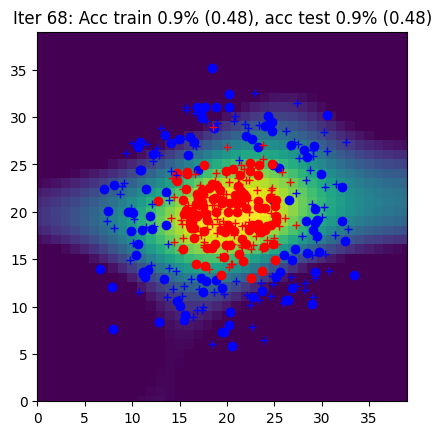

Iter 69: Acc train 0.9% (0.48), acc test 0.9% (0.47)


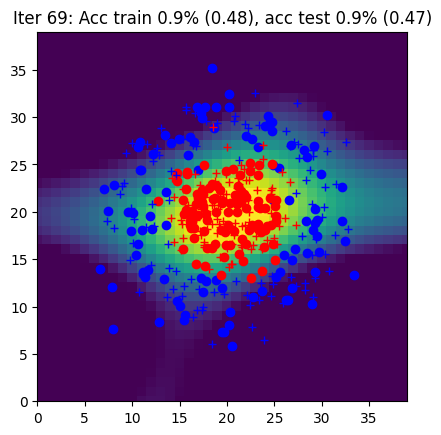

Iter 70: Acc train 0.9% (0.47), acc test 0.9% (0.47)


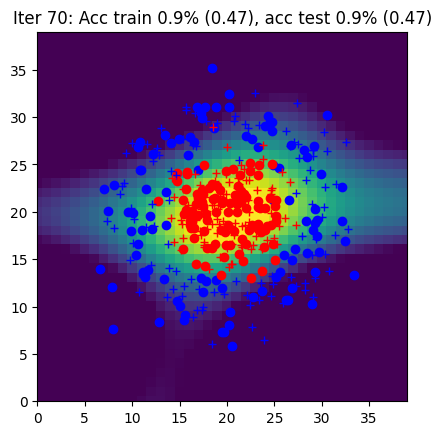

Iter 71: Acc train 0.9% (0.47), acc test 0.9% (0.46)


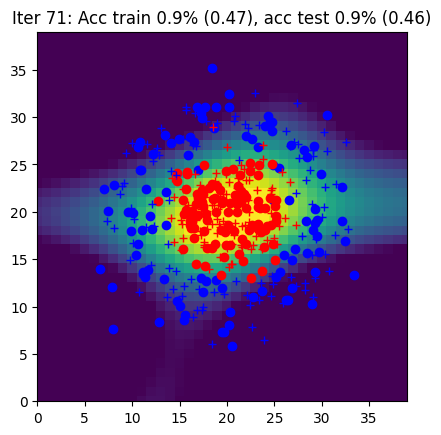

Iter 72: Acc train 0.9% (0.46), acc test 0.9% (0.46)


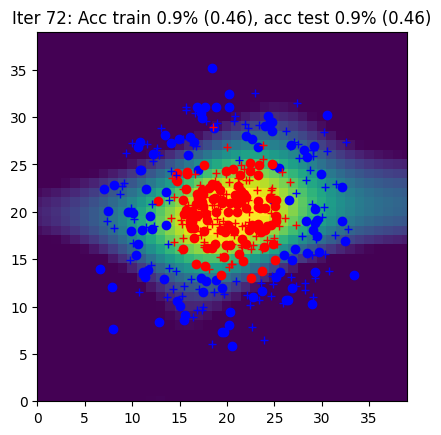

Iter 73: Acc train 0.9% (0.46), acc test 0.9% (0.45)


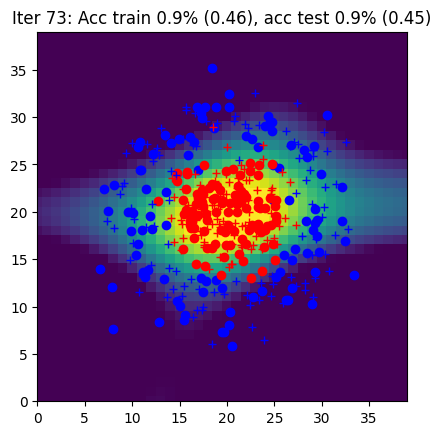

Iter 74: Acc train 0.9% (0.45), acc test 0.9% (0.45)


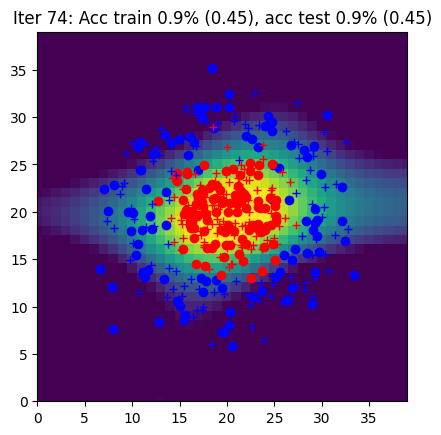

Iter 75: Acc train 0.9% (0.45), acc test 0.9% (0.44)


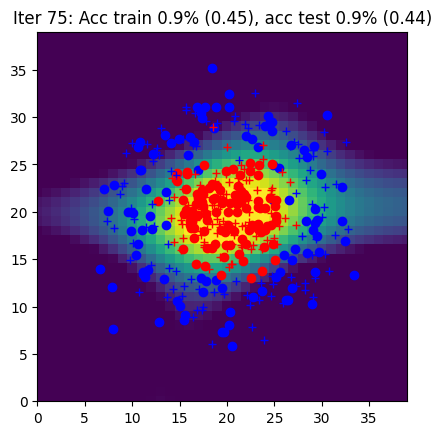

Iter 76: Acc train 0.9% (0.44), acc test 0.9% (0.43)


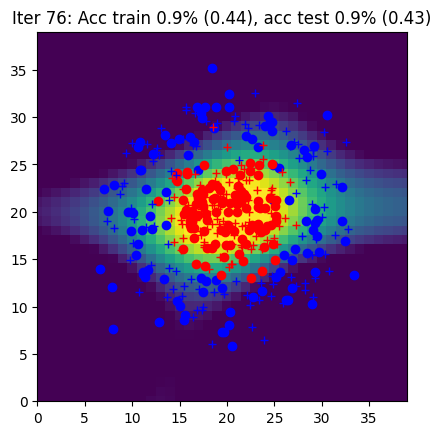

Iter 77: Acc train 0.9% (0.44), acc test 0.9% (0.43)


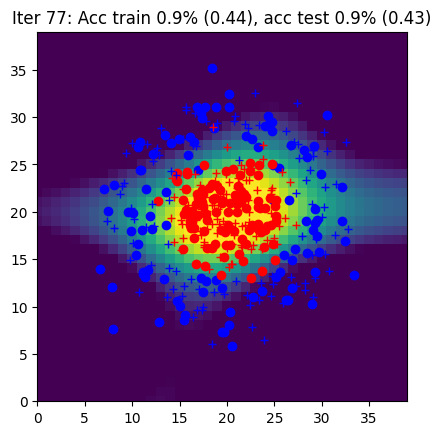

Iter 78: Acc train 0.9% (0.43), acc test 0.9% (0.42)


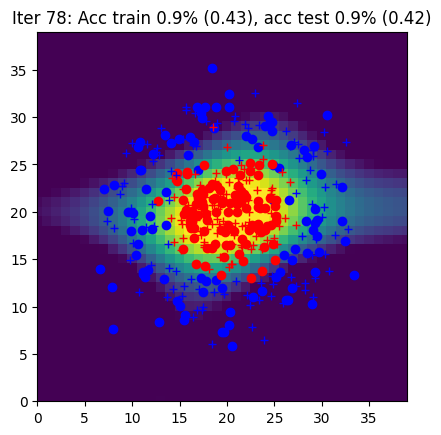

Iter 79: Acc train 0.9% (0.42), acc test 0.9% (0.42)


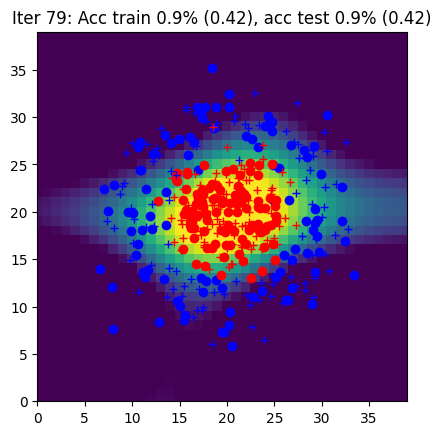

Iter 80: Acc train 0.9% (0.42), acc test 0.9% (0.41)


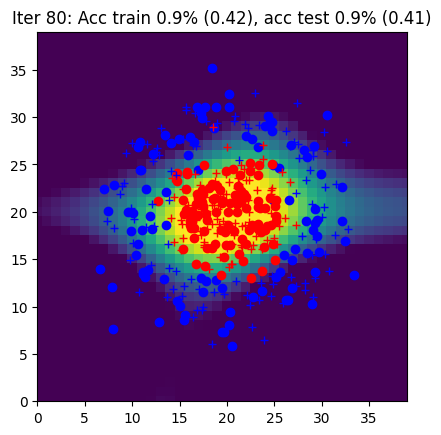

Iter 81: Acc train 0.9% (0.41), acc test 0.9% (0.41)


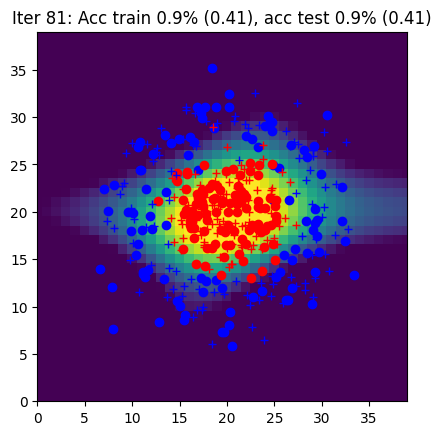

Iter 82: Acc train 0.9% (0.41), acc test 0.9% (0.40)


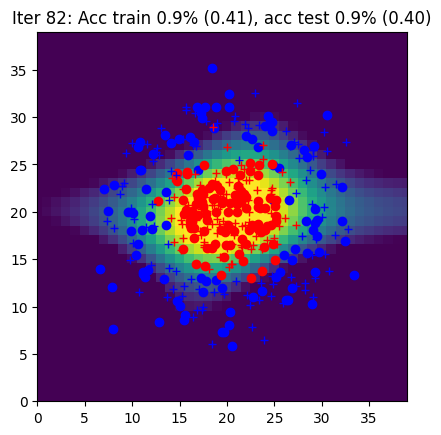

Iter 83: Acc train 0.9% (0.40), acc test 0.9% (0.40)


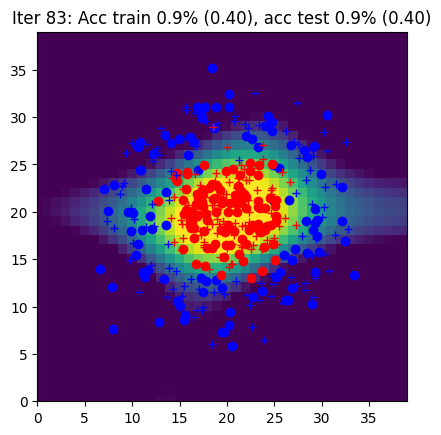

Iter 84: Acc train 0.9% (0.40), acc test 0.9% (0.39)


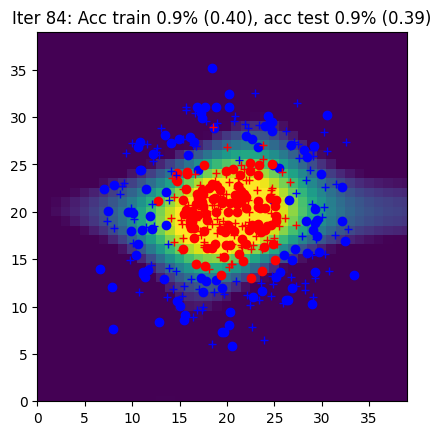

Iter 85: Acc train 0.9% (0.39), acc test 0.9% (0.39)


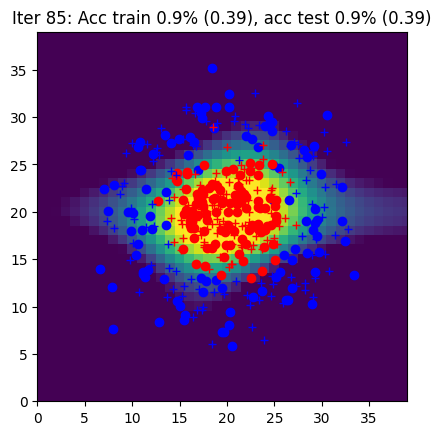

Iter 86: Acc train 0.9% (0.39), acc test 0.9% (0.38)


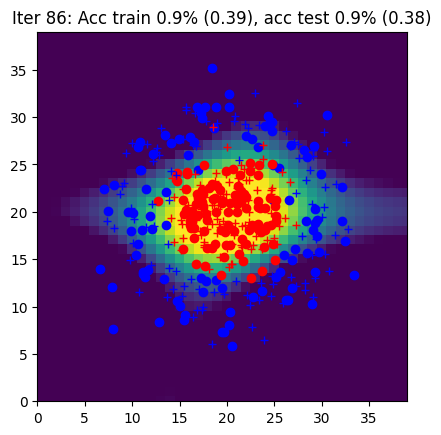

Iter 87: Acc train 0.9% (0.39), acc test 0.9% (0.38)


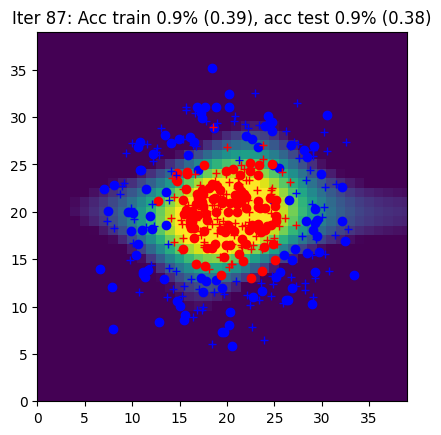

Iter 88: Acc train 0.9% (0.38), acc test 0.9% (0.37)


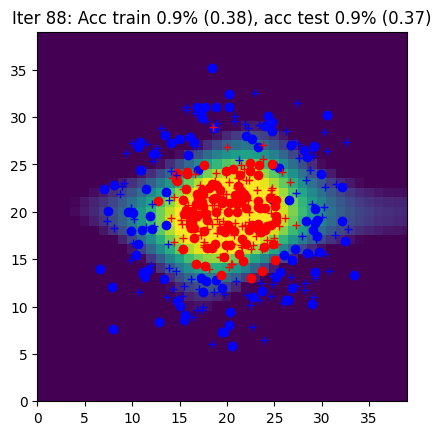

Iter 89: Acc train 0.9% (0.38), acc test 0.9% (0.37)


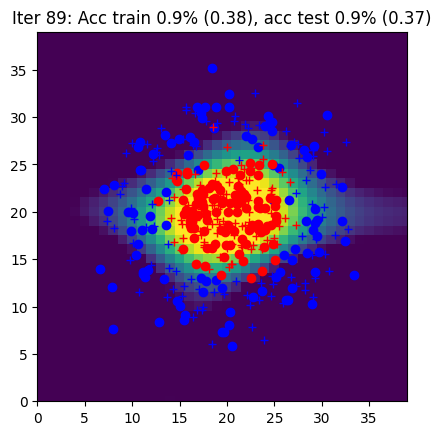

Iter 90: Acc train 0.9% (0.37), acc test 0.9% (0.36)


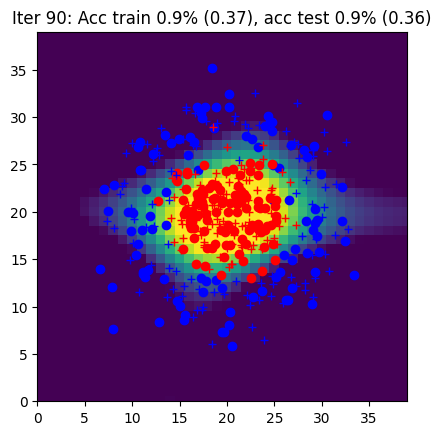

Iter 91: Acc train 0.9% (0.37), acc test 0.9% (0.36)


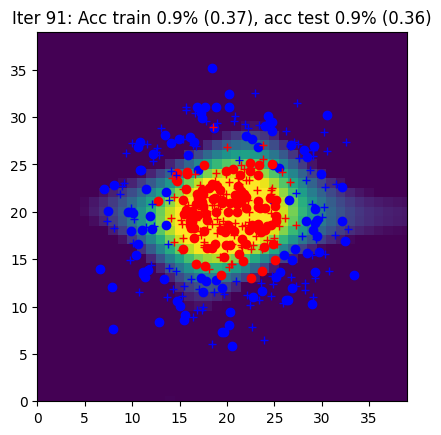

Iter 92: Acc train 0.9% (0.36), acc test 0.9% (0.35)


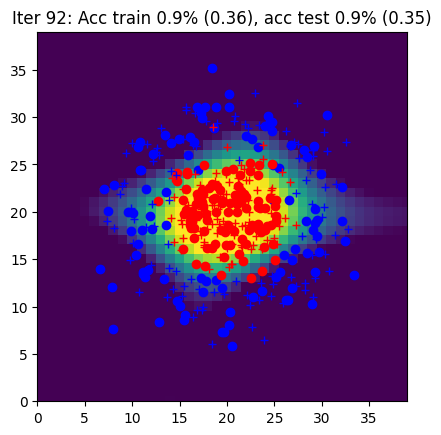

Iter 93: Acc train 0.9% (0.36), acc test 0.9% (0.35)


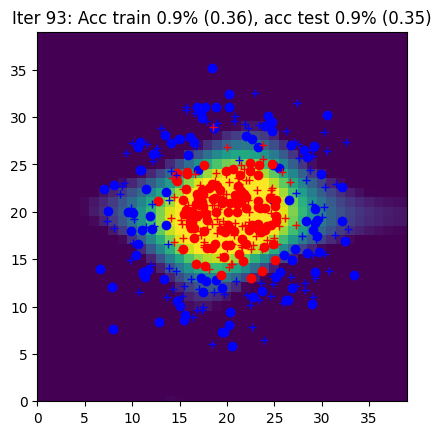

Iter 94: Acc train 0.9% (0.35), acc test 0.9% (0.34)


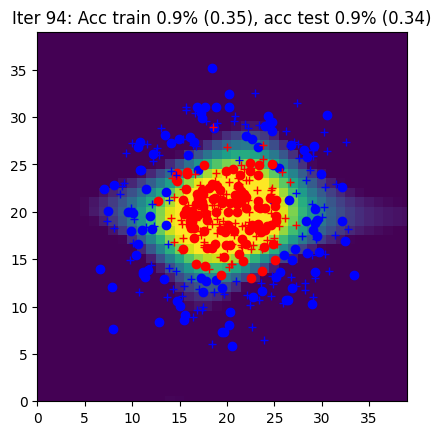

Iter 95: Acc train 0.9% (0.35), acc test 0.9% (0.34)


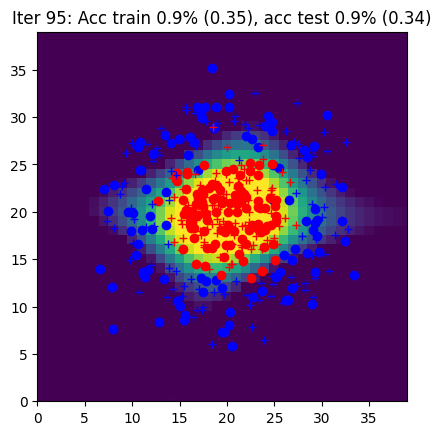

Iter 96: Acc train 0.9% (0.35), acc test 0.9% (0.34)


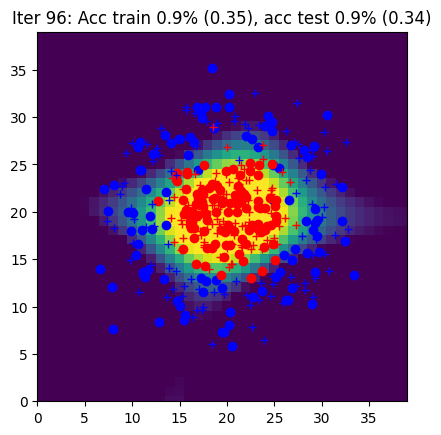

Iter 97: Acc train 0.9% (0.34), acc test 0.9% (0.33)


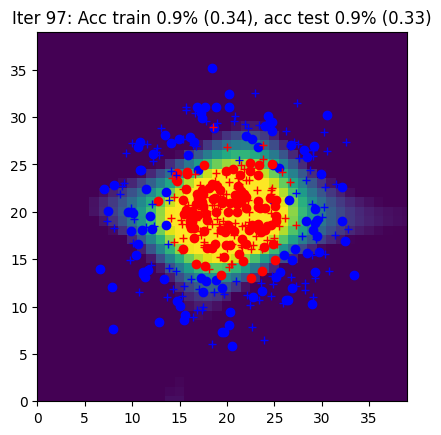

Iter 98: Acc train 0.9% (0.34), acc test 0.9% (0.33)


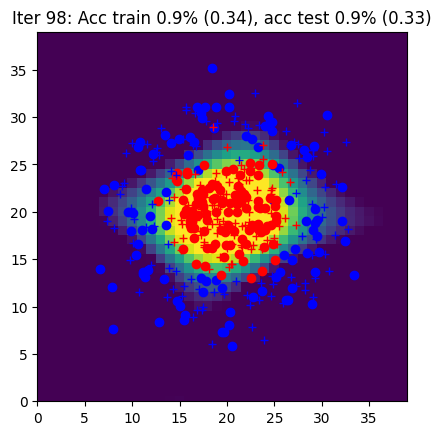

Iter 99: Acc train 0.9% (0.33), acc test 0.9% (0.32)


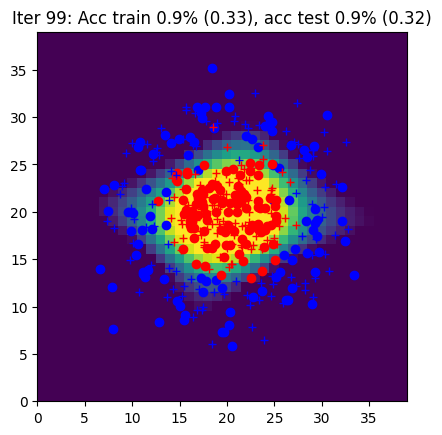

Iter 100: Acc train 0.9% (0.33), acc test 0.9% (0.32)


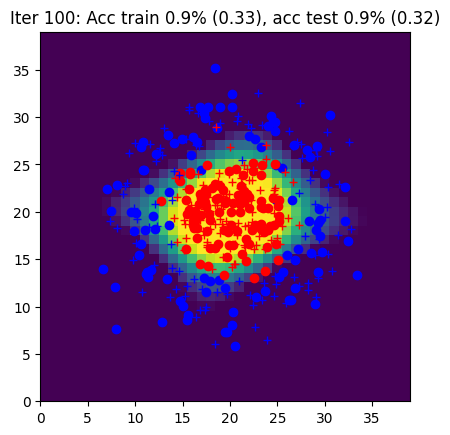

Iter 101: Acc train 0.9% (0.33), acc test 0.9% (0.32)


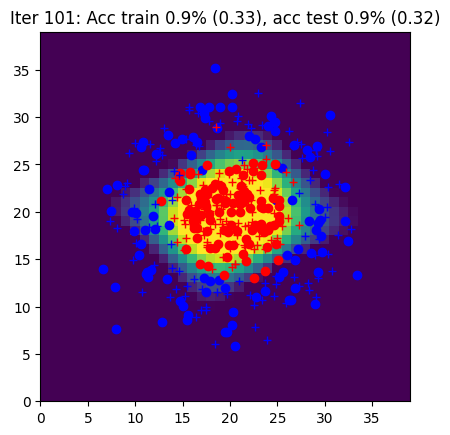

Iter 102: Acc train 0.9% (0.32), acc test 0.9% (0.31)


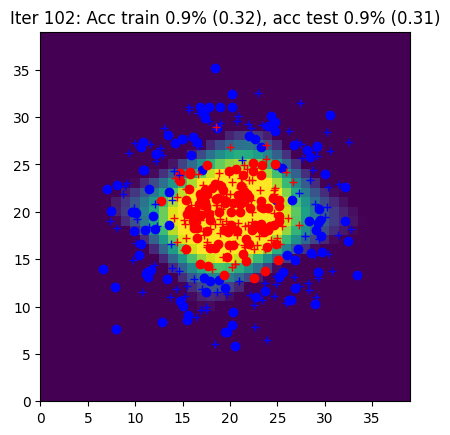

Iter 103: Acc train 0.9% (0.32), acc test 0.9% (0.31)


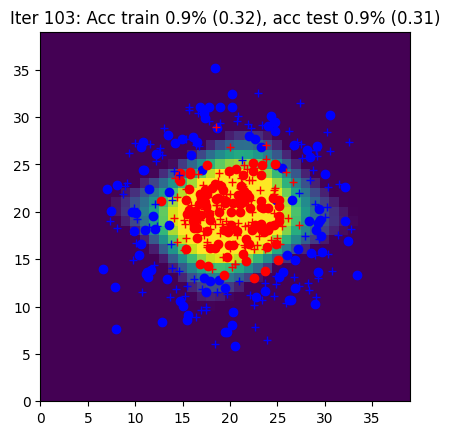

Iter 104: Acc train 0.9% (0.32), acc test 0.9% (0.31)


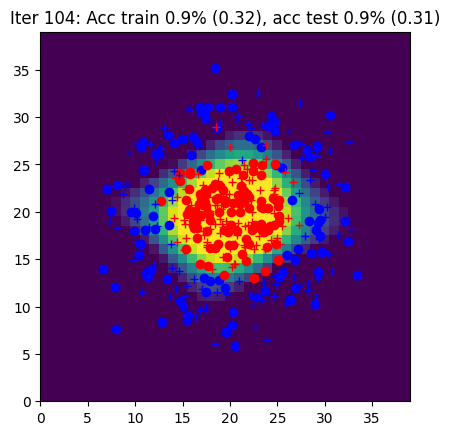

Iter 105: Acc train 0.9% (0.31), acc test 0.9% (0.30)


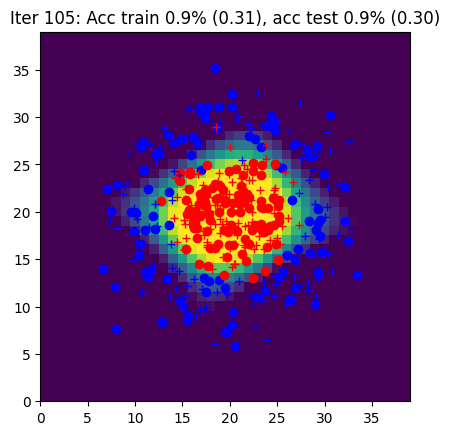

Iter 106: Acc train 0.9% (0.31), acc test 0.9% (0.30)


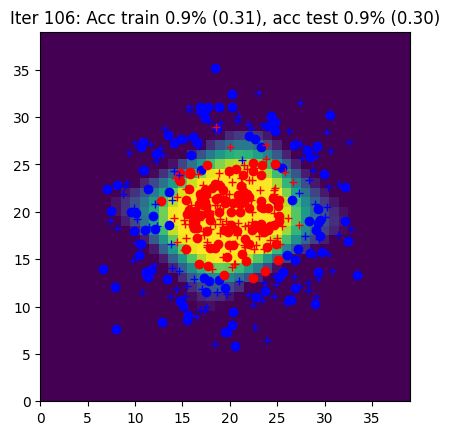

Iter 107: Acc train 0.9% (0.30), acc test 0.9% (0.30)


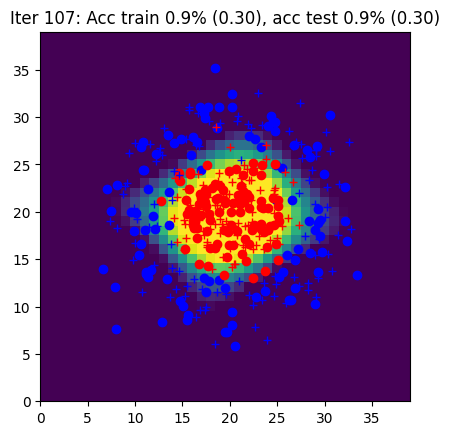

Iter 108: Acc train 0.9% (0.30), acc test 0.9% (0.29)


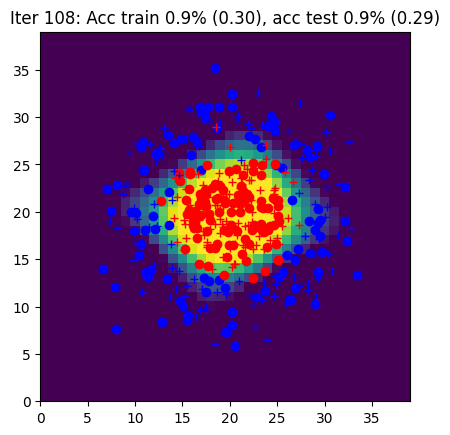

Iter 109: Acc train 0.9% (0.30), acc test 0.9% (0.29)


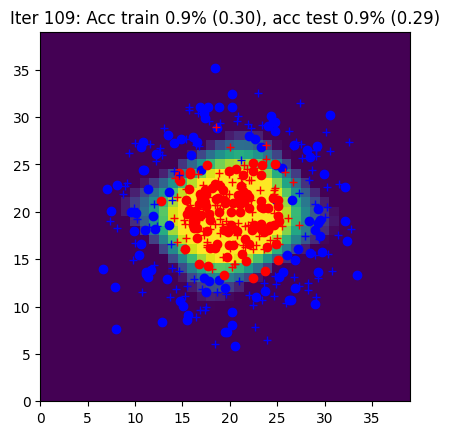

Iter 110: Acc train 0.9% (0.30), acc test 0.9% (0.29)


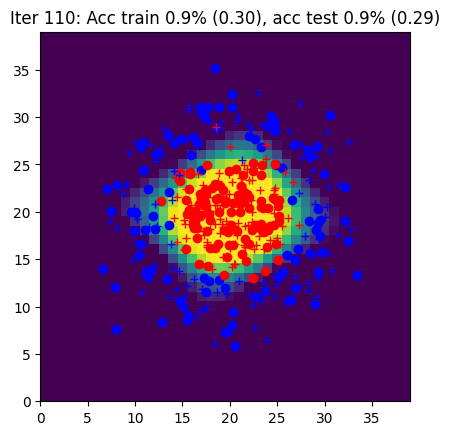

Iter 111: Acc train 0.9% (0.29), acc test 0.9% (0.28)


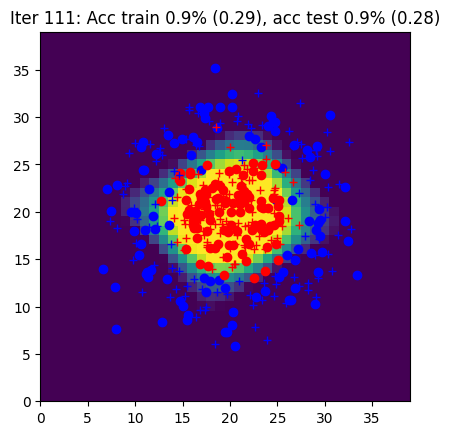

Iter 112: Acc train 0.9% (0.29), acc test 0.9% (0.28)


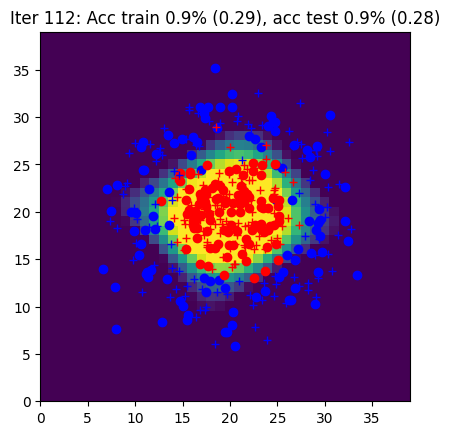

Iter 113: Acc train 0.9% (0.29), acc test 0.9% (0.28)


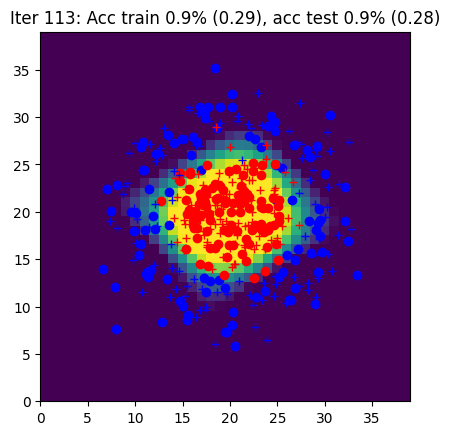

Iter 114: Acc train 0.9% (0.28), acc test 0.9% (0.27)


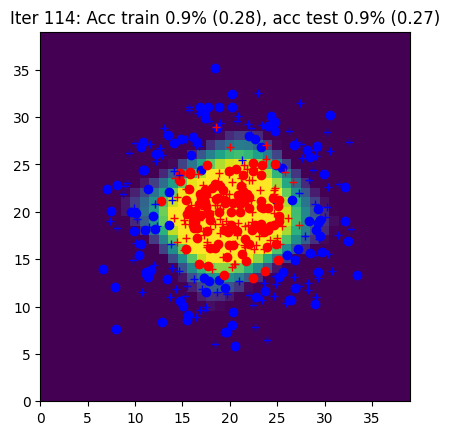

Iter 115: Acc train 0.9% (0.28), acc test 0.9% (0.27)


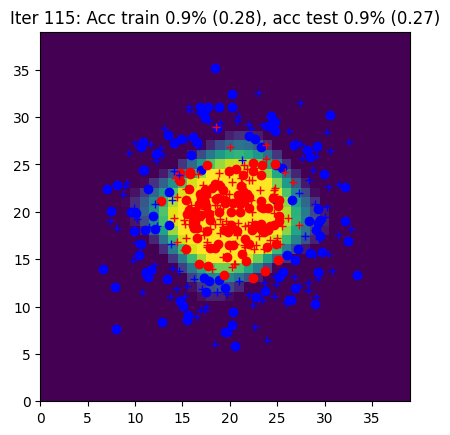

Iter 116: Acc train 0.9% (0.28), acc test 0.9% (0.27)


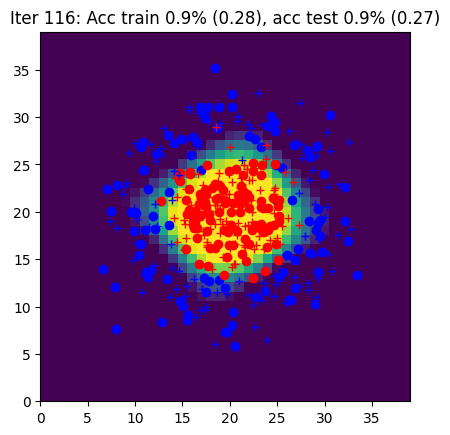

Iter 117: Acc train 0.9% (0.27), acc test 1.0% (0.27)


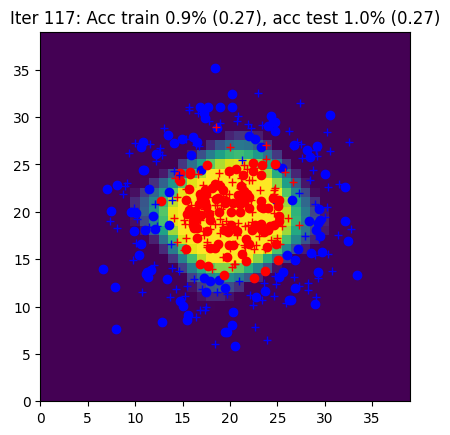

Iter 118: Acc train 0.9% (0.27), acc test 1.0% (0.26)


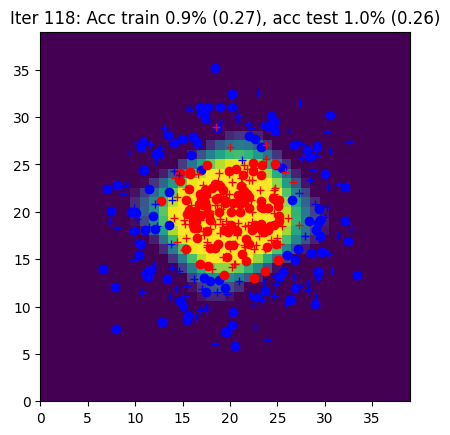

Iter 119: Acc train 0.9% (0.27), acc test 0.9% (0.26)


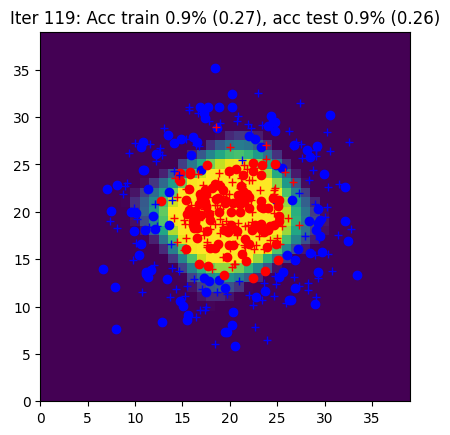

Iter 120: Acc train 0.9% (0.27), acc test 0.9% (0.26)


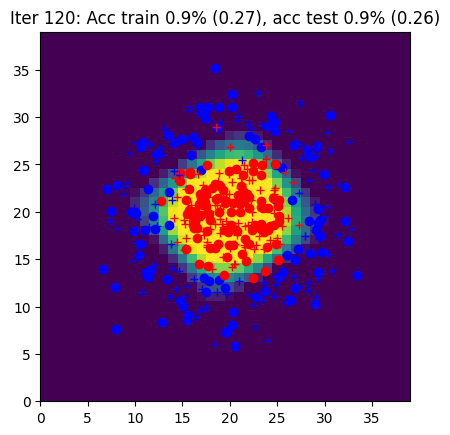

Iter 121: Acc train 0.9% (0.26), acc test 1.0% (0.26)


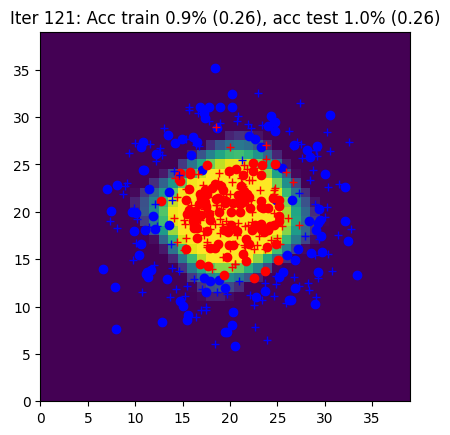

Iter 122: Acc train 0.9% (0.26), acc test 0.9% (0.25)


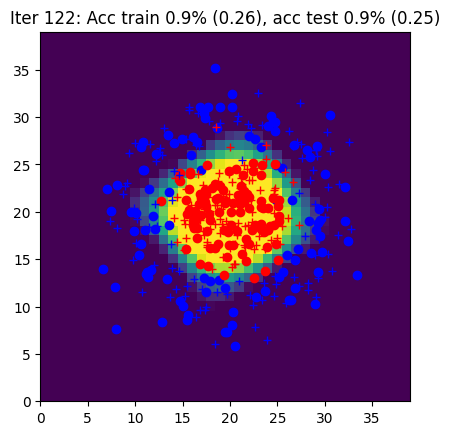

Iter 123: Acc train 0.9% (0.26), acc test 0.9% (0.25)


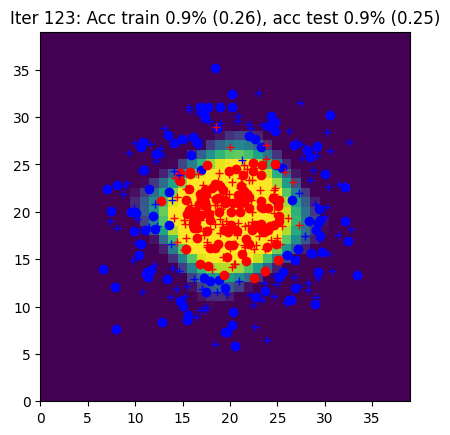

Iter 124: Acc train 0.9% (0.26), acc test 1.0% (0.25)


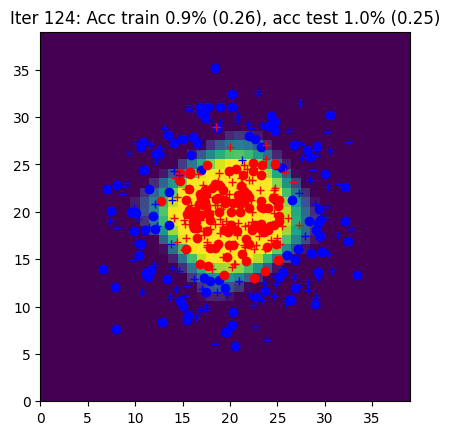

Iter 125: Acc train 0.9% (0.25), acc test 1.0% (0.25)


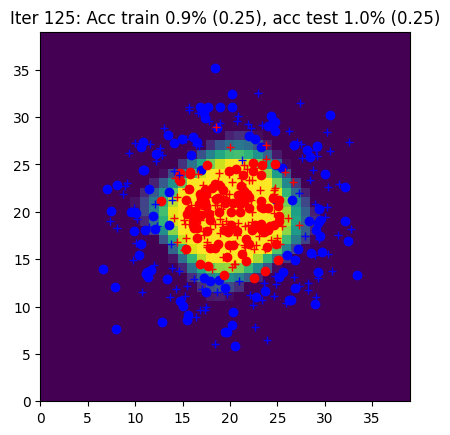

Iter 126: Acc train 0.9% (0.25), acc test 1.0% (0.25)


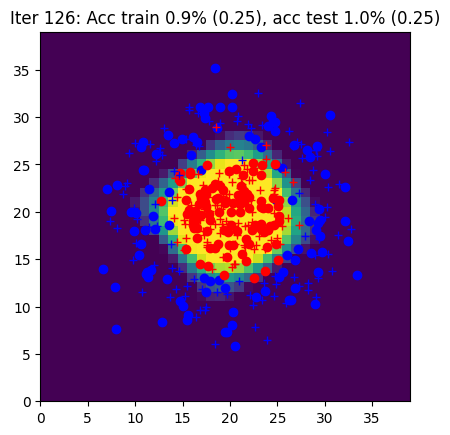

Iter 127: Acc train 0.9% (0.25), acc test 1.0% (0.24)


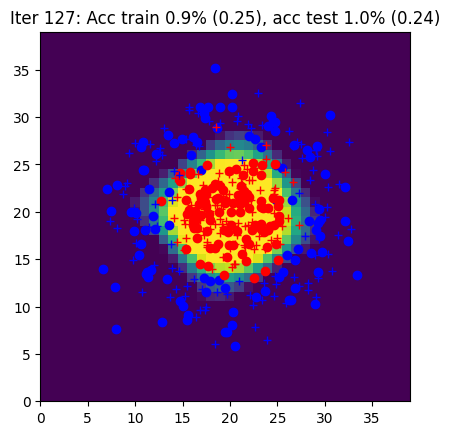

Iter 128: Acc train 0.9% (0.25), acc test 1.0% (0.24)


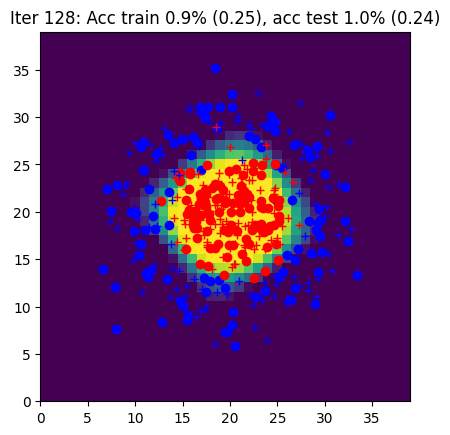

Iter 129: Acc train 0.9% (0.25), acc test 1.0% (0.24)


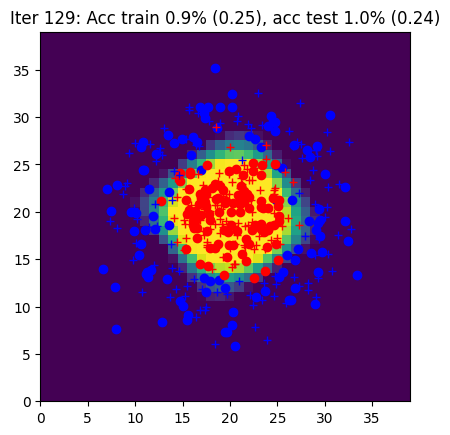

Iter 130: Acc train 0.9% (0.24), acc test 1.0% (0.24)


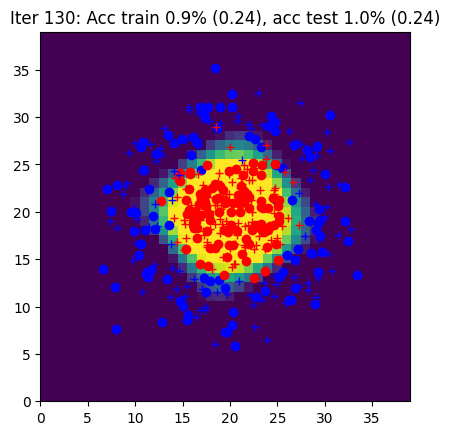

Iter 131: Acc train 0.9% (0.24), acc test 0.9% (0.24)


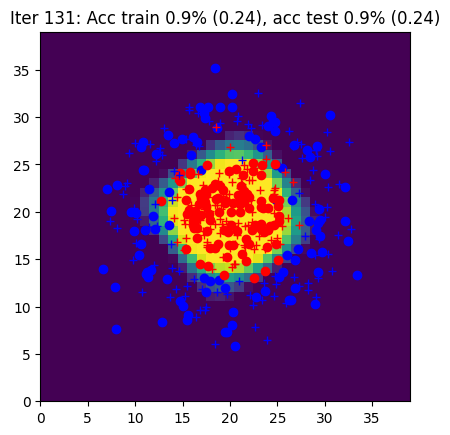

Iter 132: Acc train 0.9% (0.24), acc test 0.9% (0.24)


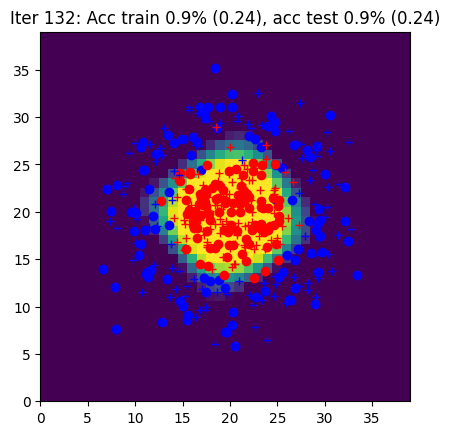

Iter 133: Acc train 0.9% (0.24), acc test 0.9% (0.23)


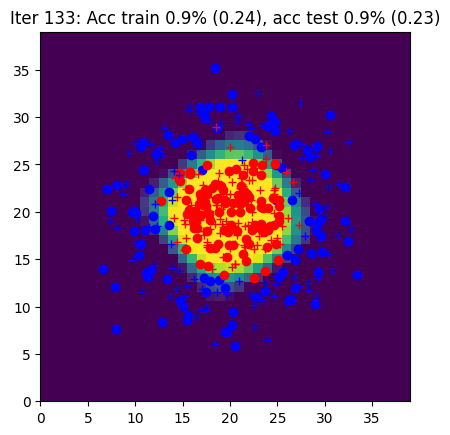

Iter 134: Acc train 0.9% (0.24), acc test 0.9% (0.23)


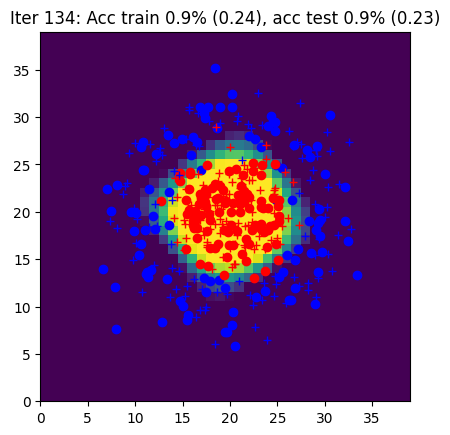

Iter 135: Acc train 0.9% (0.23), acc test 0.9% (0.23)


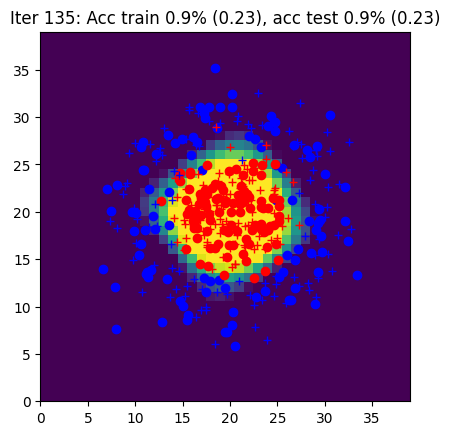

Iter 136: Acc train 0.9% (0.23), acc test 0.9% (0.23)


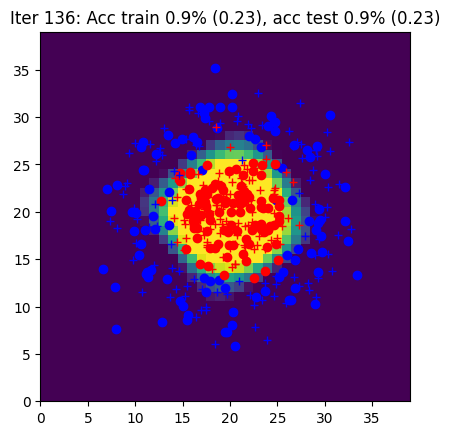

Iter 137: Acc train 0.9% (0.23), acc test 0.9% (0.23)


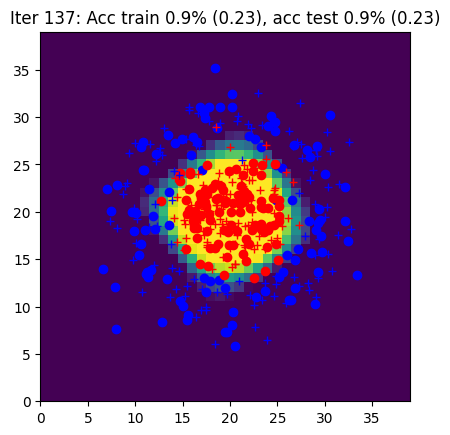

Iter 138: Acc train 0.9% (0.23), acc test 0.9% (0.22)


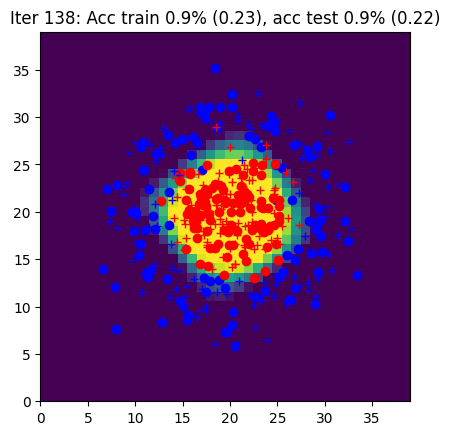

Iter 139: Acc train 0.9% (0.23), acc test 0.9% (0.22)


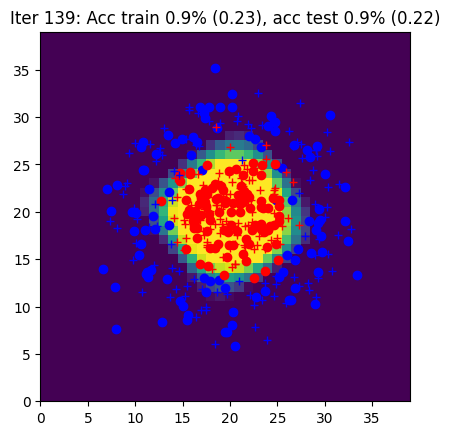

Iter 140: Acc train 0.9% (0.23), acc test 0.9% (0.22)


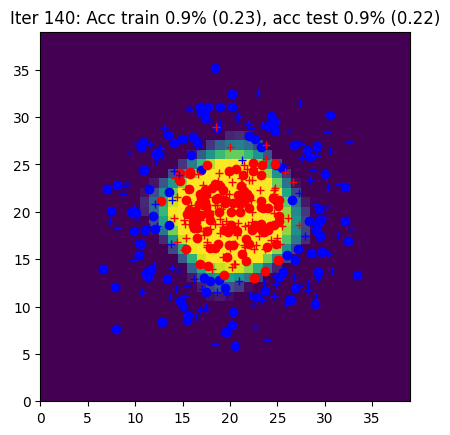

Iter 141: Acc train 0.9% (0.22), acc test 0.9% (0.22)


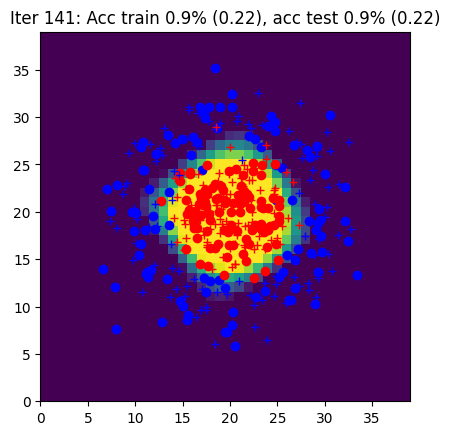

Iter 142: Acc train 1.0% (0.22), acc test 0.9% (0.22)


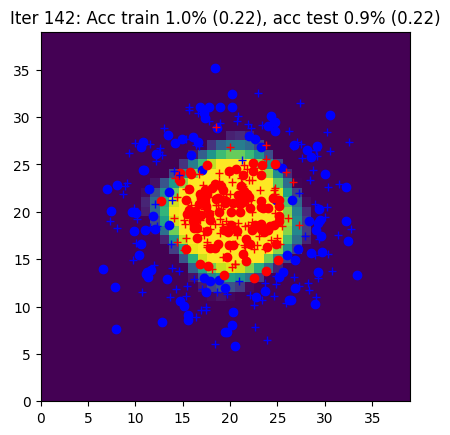

Iter 143: Acc train 0.9% (0.22), acc test 0.9% (0.22)


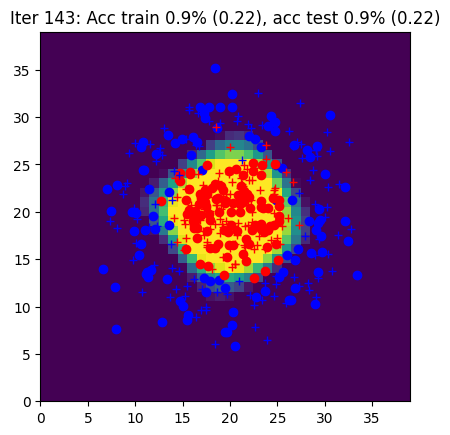

Iter 144: Acc train 1.0% (0.22), acc test 0.9% (0.22)


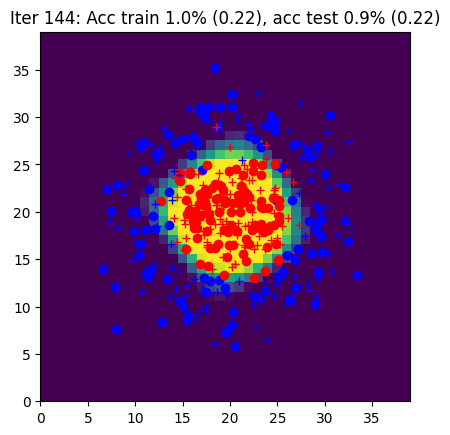

Iter 145: Acc train 1.0% (0.22), acc test 0.9% (0.22)


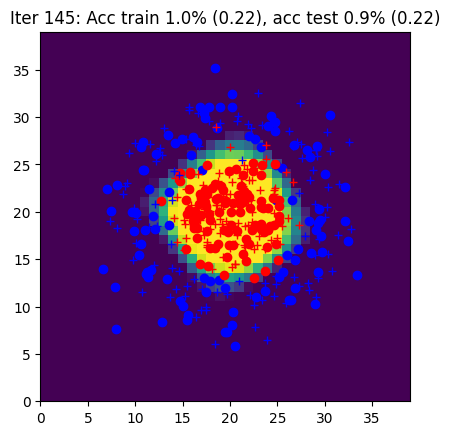

Iter 146: Acc train 1.0% (0.22), acc test 0.9% (0.21)


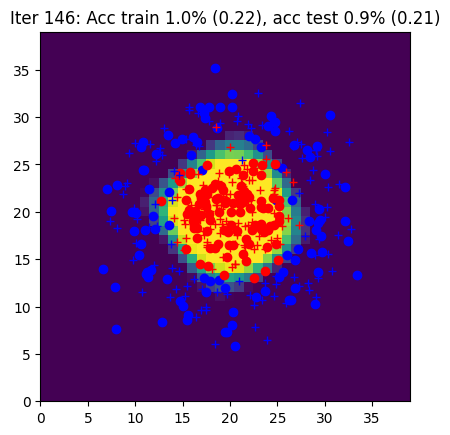

Iter 147: Acc train 1.0% (0.21), acc test 0.9% (0.21)


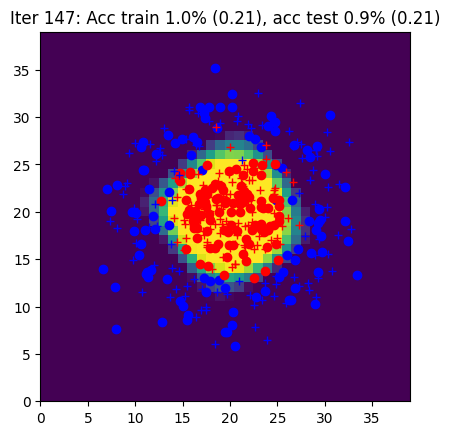

Iter 148: Acc train 0.9% (0.21), acc test 0.9% (0.21)


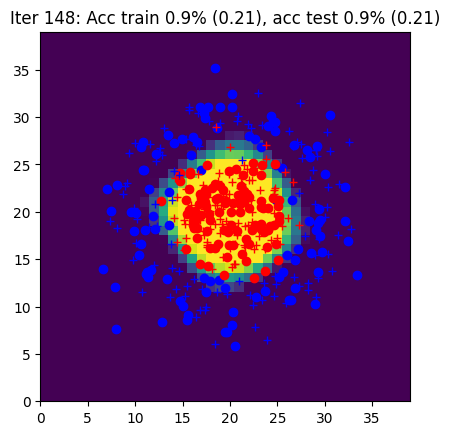

Iter 149: Acc train 0.9% (0.21), acc test 0.9% (0.21)


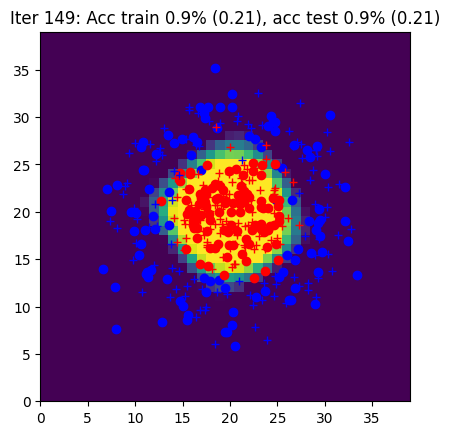

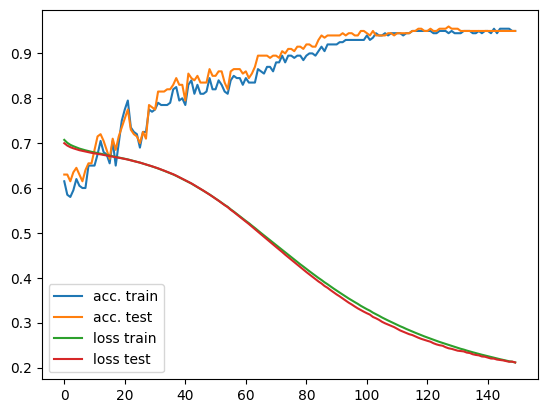

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step

        optim.zero_grad()
        Yhat = model(X)
        L, acc = loss_accuracy(loss, Yhat, Y)
        L.backward()
        optim.step()

    ####################
    ##      FIN        #
    ####################


    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain.item())
    curves[3].append(Ltest.item())

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

In [ ]:
data = MNISTData()
print(data.Xtrain.shape, data.Ytrain.shape)

torch.Size([60000, 784]) torch.Size([60000, 10])


Epoch 1: Train Acc=88.58% (Loss=0.436) | Test Acc=89.05% (Loss=0.417)
Epoch 2: Train Acc=90.16% (Loss=0.349) | Test Acc=90.61% (Loss=0.335)
Epoch 3: Train Acc=91.28% (Loss=0.309) | Test Acc=91.63% (Loss=0.297)
Epoch 4: Train Acc=92.01% (Loss=0.283) | Test Acc=92.40% (Loss=0.273)
Epoch 5: Train Acc=92.59% (Loss=0.261) | Test Acc=92.79% (Loss=0.256)
Epoch 6: Train Acc=93.22% (Loss=0.242) | Test Acc=93.43% (Loss=0.238)
Epoch 7: Train Acc=93.68% (Loss=0.226) | Test Acc=93.80% (Loss=0.224)
Epoch 8: Train Acc=94.10% (Loss=0.212) | Test Acc=94.05% (Loss=0.210)
Epoch 9: Train Acc=94.47% (Loss=0.199) | Test Acc=94.32% (Loss=0.199)
Epoch 10: Train Acc=94.67% (Loss=0.189) | Test Acc=94.61% (Loss=0.191)


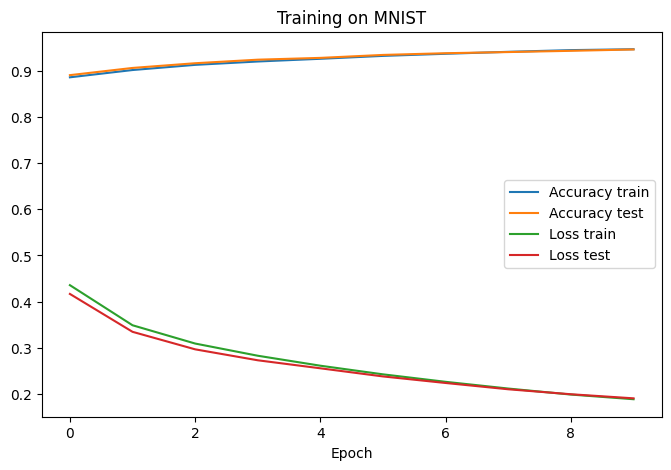

In [ ]:
# init
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03
data.Xtrain = data.Xtrain / 255.0
data.Xtest = data.Xtest / 255.0

import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt

def init_model(nx, nh, ny, eta):
    model = nn.Sequential(
        nn.Linear(nx, nh),
        nn.ReLU(),
        nn.Linear(nh, ny)
    )

    loss = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=eta)
    return model, loss, optimizer

def loss_accuracy(loss_fn, Yhat, Y):
    # Convert one-hot targets back to class indices if necessary
    Ytrue = torch.argmax(Y, dim=1)
    L = loss_fn(Yhat, Ytrue)
    preds = torch.argmax(Yhat, dim=1)
    acc = (preds == Ytrue).float().mean()
    return L, acc

model, loss_fn, optimizer = init_model(nx, nh, ny, eta)

curves = [[], [], [], []]

for epoch in range(10):
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    for j in range(N // Nbatch):
        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        optimizer.zero_grad()
        Yhat = model(X)
        Ytrue = torch.argmax(Y, dim=1)
        L = loss_fn(Yhat, Ytrue)
        L.backward()
        optimizer.step()

    with torch.no_grad():
        Yhat_train = model(data.Xtrain)
        Yhat_test = model(data.Xtest)
        Ltrain, acctrain = loss_accuracy(loss_fn, Yhat_train, data.Ytrain)
        Ltest, acctest = loss_accuracy(loss_fn, Yhat_test, data.Ytest)

    # Log
    print(f"Epoch {epoch+1}: "
          f"Train Acc={acctrain*100:.2f}% (Loss={Ltrain:.3f}) | "
          f"Test Acc={acctest*100:.2f}% (Loss={Ltest:.3f})")

    curves[0].append(float(acctrain))
    curves[1].append(float(acctest))
    curves[2].append(Ltrain.item())
    curves[3].append(Ltest.item())

plt.figure(figsize=(8, 5))
plt.plot(curves[0], label="Accuracy train")
plt.plot(curves[1], label="Accuracy test")
plt.plot(curves[2], label="Loss train")
plt.plot(curves[3], label="Loss test")
plt.legend()
plt.xlabel("Epoch")
plt.title("Training on MNIST")
plt.show()


# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [ ]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

In [ ]:
import sklearn.svm

############################
### Your code here   #######
### Train the SVM    #######
## See https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## and https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

svm = None

###########################

In [ ]:
## Print results

Ytest_pred = svm.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}")
Ygrid_pred = svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)